# Setup

In [ ]:
from google.colab import drive
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
def calculate_daily_long_trade_return_percentage(predicted_prices, true_prices):
  def generate_daily_trade_signals_long_only(predicted_prices, true_prices):
    signals = torch.zeros_like(predicted_prices)
    signals[:-1] = torch.where(predicted_prices[1:] > predicted_prices[:-1], 1, 0)  # Buy if tomorrow's predicted price > today's
    return signals

  signals = generate_daily_trade_signals_long_only(predicted_prices, true_prices)

  # Calculate price differences and percentage change
  price_diff = true_prices[1:] - true_prices[:-1]
  percentage_returns = (price_diff / true_prices[:-1])  # Convert to percentage change
  # Calculate returns based on signals
  returns = signals[:-1] * percentage_returns

  # Step 1: Calculate cumulative returns
  cumulative_returns = torch.cumprod(1 + returns, dim=0)

  # Step 2: Calculate running maximum of cumulative returns
  running_max, _ = torch.cummax(cumulative_returns, dim=0)

  # Step 3: Calculate drawdowns
  drawdowns = (cumulative_returns - running_max) / running_max

  # Step 4: Find the maximum drawdown
  max_drawdown = drawdowns.min()

  print("Return:", cumulative_returns[-1].item() - 1)
  print("Max Drawdown:", max_drawdown.item())
  return cumulative_returns[-1].item() - 1, max_drawdown.item()

In [ ]:
def calculate_daily_short_trade_return_percentage(predicted_prices, true_prices):
  def generate_daily_trade_signals_short_only(predicted_prices, true_prices):
    signals = torch.zeros_like(predicted_prices)
    # Generate a short signal (-1) if tomorrow's predicted price is lower than today's predicted price
    signals[:-1] = torch.where(predicted_prices[1:] < predicted_prices[:-1], 1, 0)
    return signals

  signals = generate_daily_trade_signals_short_only(predicted_prices, true_prices)

  # Calculate price differences and percentage change
  price_diff = true_prices[:-1] - true_prices[1:]  # Since this is a short trade, we reverse the diff
  percentage_returns = (price_diff / true_prices[:-1])  # Convert to percentage change
  # Calculate returns based on signals
  returns = signals[:-1] * percentage_returns
  # Step 1: Calculate cumulative returns
  cumulative_returns = torch.cumprod(1 + returns, dim=0)

  # Step 2: Calculate running maximum of cumulative returns
  running_max, _ = torch.cummax(cumulative_returns, dim=0)

  # Step 3: Calculate drawdowns
  drawdowns = (cumulative_returns - running_max) / running_max

  # Step 4: Find the maximum drawdown
  max_drawdown = drawdowns.min()

  print("Return:", cumulative_returns[-1].item() - 1)
  print("Max Drawdown:", max_drawdown.item())

# Data Pipeline


In [ ]:
drive.mount("/content/drive")

Mounted at /content/drive


In [ ]:

file_path = "/content/drive/MyDrive/24fall_dlProject/data/BTC-USD_stock_data.csv"

data = pd.read_csv(file_path,index_col='Date',parse_dates=['Date'])

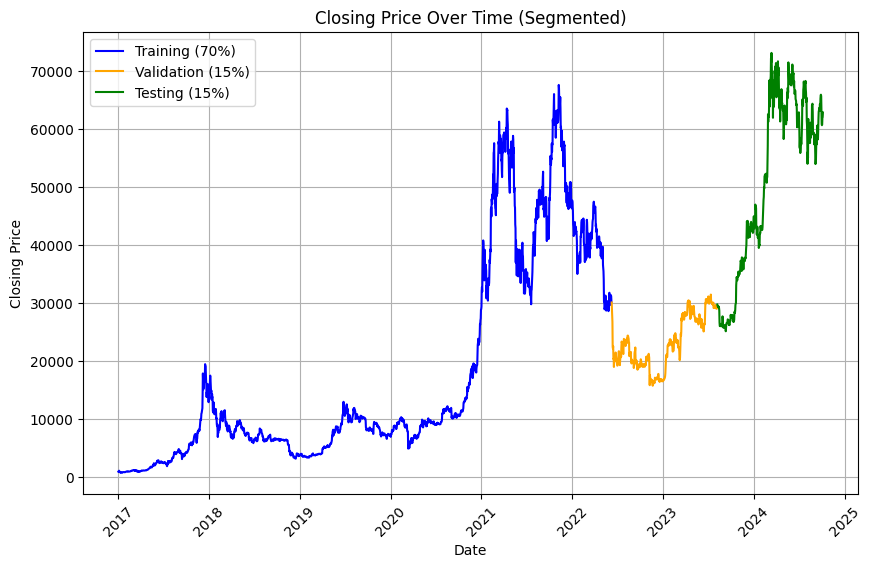

In [ ]:
close_data = data['Close'].values  # Get 'Close' data as a NumPy array
total_data_points = len(close_data)
segment1_end = int(total_data_points * 0.7)
segment2_end = int(total_data_points * (0.7 + 0.15))

plt.figure(figsize=(10, 6))

# Plotting segments with different colors
plt.plot(data.index[:segment1_end], close_data[:segment1_end], label='Training (70%)', color='blue')
plt.plot(data.index[segment1_end:segment2_end], close_data[segment1_end:segment2_end], label='Validation (15%)', color='orange')
plt.plot(data.index[segment2_end:], close_data[segment2_end:], label='Testing (15%)', color='green')

plt.xlabel('Date')
plt.ylabel('Closing Price')
plt.title('Closing Price Over Time (Segmented)')
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

In [ ]:
def data_preprocessing_with_closed_price_and_min_max_scaler(data, seq_length=60):
    train_ratio = 0.7
    val_ratio = 0.15
    close_data = data["Close"].values.reshape(-1, 1)
    scaler = MinMaxScaler(feature_range=(0, 10))
    data_scaled = scaler.fit_transform(close_data)
    data_scaled = pd.DataFrame(data_scaled, columns=["Close"])

    def create_feature_datasets(data, x_size):
        x_datasets = []
        y_datasets = []
        for i in range(len(data) - x_size):
            x = data[i:i + x_size].values.reshape(-1, 1)
            y = data[i + x_size:i + x_size + 1].values.reshape(1)
            x_datasets.append(x)
            y_datasets.append(y)
        X = np.array(x_datasets)
        y = np.array(y_datasets)
        X_train =  X[:int(len(X) * train_ratio)]
        y_train = y[:int(len(y) * train_ratio)]
        X_val = X[int(len(X) * train_ratio):int(len(X) * (train_ratio + val_ratio))]
        y_val = y[int(len(y) * train_ratio):int(len(y) * (train_ratio + val_ratio))]
        X_test = X[int(len(X) * (train_ratio + val_ratio)):]
        y_test = y[int(len(y) * (train_ratio + val_ratio)):]

        indices = np.arange(X_train.shape[0])
        np.random.shuffle(indices)
        X_train_shuffled = X_train[indices]
        y_train_shuffled = y_train[indices]

        return torch.Tensor(X_train_shuffled).to(device), torch.Tensor(X_val).to(device), torch.Tensor(X_test).to(device), torch.Tensor(y_train_shuffled).to(device), torch.Tensor(y_val).to(device), torch.Tensor(y_test).to(device)

    return create_feature_datasets(data_scaled, seq_length), scaler

(X_train, X_val, X_test, y_train, y_val, y_test), min_max_scaler = data_preprocessing_with_closed_price_and_min_max_scaler(data, 60)

# Baseline Model

In [ ]:
# LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True, dropout=dropout)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h_0 = torch.zeros(num_layers, x.size(0), hidden_size).to(device)  # Initial hidden state
        c_0 = torch.zeros(num_layers, x.size(0), hidden_size).to(device)  # Initial cell state
        out, _ = self.lstm(x, (h_0, c_0))
        out = self.fc(out[:, -1, :])  # Get the output from the last time step
        return out

# Training

In [ ]:
# create a nn class (just-for-fun choice :-)
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self,yhat,y):
        return torch.sqrt(self.mse(yhat,y))

In [ ]:
# Hyperparameters
input_size = 1
hidden_size = 128
num_layers = 2
dropout = 0.1
output_size = 1
learning_rate = 0.00001
num_epochs = 200
batch_size = 128

# Create dataset and DataLoader for batching
dataset = TensorDataset(X_train, y_train)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Model, loss, optimizer
model = LSTMModel(input_size, hidden_size, num_layers, output_size, dropout)
model = model.to(device)
criterion = RMSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

epoch_losses = []

# Training loop with batching
for epoch in range(num_epochs):
    model.train()
    for batch_idx, (batch_x, batch_y) in enumerate(dataloader):
        optimizer.zero_grad()
        outputs = model(batch_x)
        loss = criterion(outputs, batch_y)
        loss.backward()
        optimizer.step()

    epoch_losses.append(loss.item())
    if (epoch + 1) % 5 == 0:
        print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')


Epoch [5/200], Loss: 3.4835
Epoch [10/200], Loss: 3.5612
Epoch [15/200], Loss: 3.1892
Epoch [20/200], Loss: 3.4003
Epoch [25/200], Loss: 2.4551
Epoch [30/200], Loss: 1.5877
Epoch [35/200], Loss: 1.1022


KeyboardInterrupt: 

# Visualization

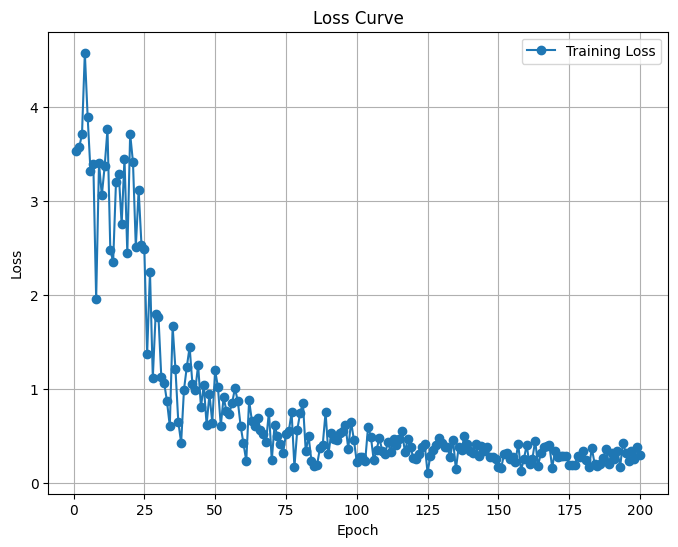

In [ ]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, num_epochs + 1), epoch_losses, marker='o', label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss Curve')
plt.legend()
plt.grid()
plt.show()

In [ ]:
model.eval()
with torch.no_grad():
    predictions = model(X_train)
    print(f'Predicted value for the first sample: {predictions[0].item():.4f}')
rmse = torch.sqrt(torch.mean((predictions - y_train) ** 2))
print(f"Training Loss Scaling Unreversed: {rmse.item()}")

if device == torch.device("cuda"):
    predictions_cpu = predictions.cpu()
    y_train_cpu = y_train.cpu()

# Reverse the scaling
predictions_reversed = torch.Tensor(min_max_scaler.inverse_transform(predictions_cpu.numpy()))
y_train_reversed = torch.Tensor(min_max_scaler.inverse_transform(y_train_cpu.numpy()))
rmse_reversed = torch.sqrt(torch.mean((predictions_reversed - y_train_reversed) ** 2))
print(f"Training Loss Scaling Reversed: {rmse_reversed.item()}")

Predicted value for the first sample: 1.3580
Training Loss Scaling Unreversed: 0.25514382123947144
Training Loss Scaling Reversed: 1844.83642578125


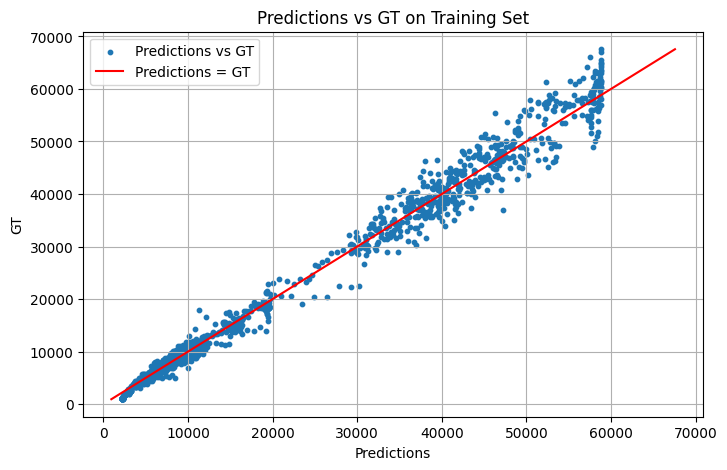

In [ ]:

# Convert tensors to 1D for plotting
tensor1 = predictions_reversed.view(-1)
tensor2 = y_train_reversed.view(-1)

# Plotting the line chart
plt.figure(figsize=(8, 5))
plt.scatter(tensor1.numpy(), tensor2.numpy(), label='Predictions vs GT', marker='o', s=10)

min_val = min(tensor1.min(), tensor2.min())
max_val = max(tensor1.max(), tensor2.max())
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='-', label='Predictions = GT')

plt.title('Predictions vs GT on Training Set')
plt.xlabel('Predictions')
plt.ylabel('GT')
plt.legend()
plt.grid(True)
plt.show()

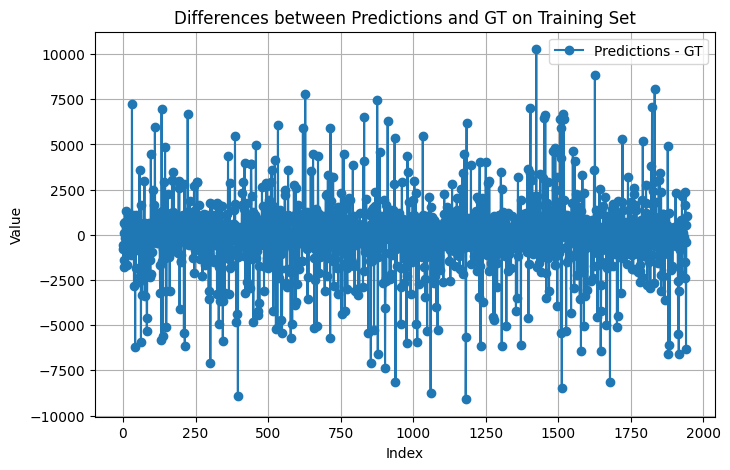

In [ ]:
# Convert tensors to 1D for plotting
tensor1 = predictions_reversed.view(-1)
tensor2 = y_train_reversed.view(-1)

# Plotting the line chart
plt.figure(figsize=(8, 5))
plt.plot(tensor1.numpy() - tensor2.numpy(), label='Predictions - GT', marker='o')
plt.title('Differences between Predictions and GT on Training Set')
plt.xlabel('Index')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
model.eval()
with torch.no_grad():
    predictions = model(X_val)
    print(f'Predicted value for the first sample: {predictions[0].item():.4f}')
rmse = torch.sqrt(torch.mean((predictions - y_val) ** 2))
print(f"Validation Loss Scaling Unreversed: {rmse.item()}")

if device == torch.device("cuda"):
    predictions_cpu = predictions.cpu()
    y_val_cpu = y_val.cpu()

# Reverse the scaling
predictions_reversed = torch.Tensor(min_max_scaler.inverse_transform(predictions_cpu.numpy()))
y_val_reversed = torch.Tensor(min_max_scaler.inverse_transform(y_val_cpu.numpy()))
rmse_reversed = torch.sqrt(torch.mean((predictions_reversed - y_val_reversed) ** 2))
print(f"Validation Loss Scaling Reversed: {rmse_reversed.item()}")

Predicted value for the first sample: 2.6594
Validation Loss Scaling Unreversed: 0.16435427963733673
Validation Loss Scaling Reversed: 1188.3758544921875


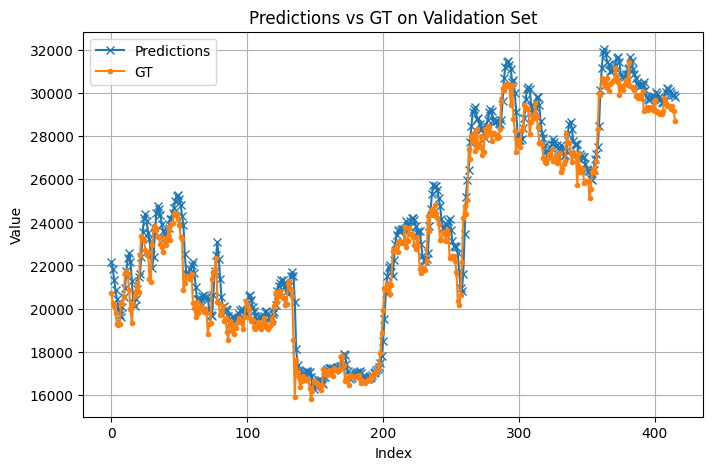

In [ ]:
# Convert tensors to 1D for plotting
tensor1 = predictions_reversed.view(-1)
tensor2 = y_val_reversed.view(-1)

# Plotting the line chart
plt.figure(figsize=(8, 5))
plt.plot(tensor1.numpy(), label='Predictions', marker='x')
plt.plot(tensor2.numpy(), label='GT', marker='.')
plt.title('Predictions vs GT on Validation Set')
plt.xlabel('Index')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

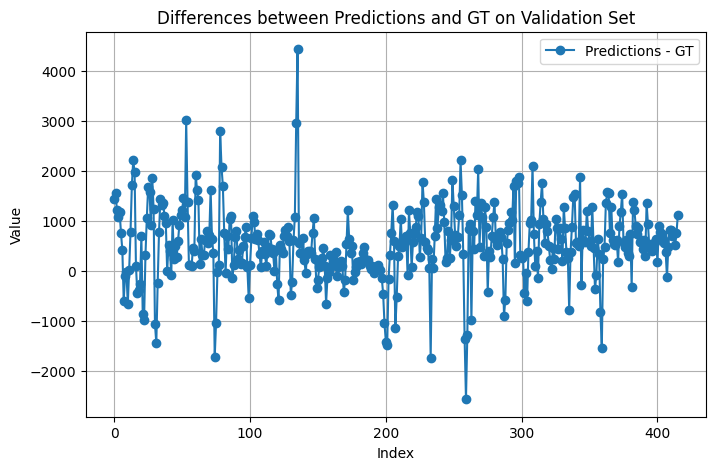

In [ ]:
# Convert tensors to 1D for plotting
tensor1 = predictions_reversed.view(-1)
tensor2 = y_val_reversed.view(-1)

# Plotting the line chart
plt.figure(figsize=(8, 5))
plt.plot(tensor1.numpy() - tensor2.numpy(), label='Predictions - GT', marker='o')
plt.title('Differences between Predictions and GT on Validation Set')
plt.xlabel('Index')
plt.ylabel('Value')
plt.legend()
plt.grid(True)
plt.show()

# Return

In [ ]:
# Example usage:
predicted_prices = predictions_reversed.view(-1)
true_prices = y_val_reversed.view(-1)

calculate_daily_long_trade_return_percentage(predicted_prices, true_prices)

Return: -0.1447926163673401
Max Drawdown: -0.3683604896068573


(-0.1447926163673401, -0.3683604896068573)

In [ ]:
# Example usage:
predicted_prices = predictions_reversed.view(-1)
true_prices = y_val_reversed.view(-1)

calculate_daily_short_trade_return_percentage(predicted_prices, true_prices)

Return: -0.47295081615448
Max Drawdown: -0.4820118248462677


# Tuning

In [ ]:
def train_model(batch_size, hidden_size, num_layers, dropout, learning_rate, input_size=1, output_size=1, num_epochs=200):
  dataset = TensorDataset(X_train, y_train)
  dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

  # Model, loss, optimizer
  model = LSTMModel(input_size, hidden_size, num_layers, output_size, dropout)
  model = model.to(device)
  criterion = RMSELoss()
  optimizer = optim.Adam(model.parameters(), lr=learning_rate)

  epoch_losses = []

  # Training loop with batching
  for epoch in range(num_epochs):
      model.train()
      for batch_idx, (batch_x, batch_y) in enumerate(dataloader):
          optimizer.zero_grad()
          outputs = model(batch_x)
          loss = criterion(outputs, batch_y)
          loss.backward()
          optimizer.step()

      epoch_losses.append(loss.item())
      if (epoch + 1) % 5 == 0:
          print(f'Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}')

  # Visualization
  plt.figure(figsize=(8, 6))
  plt.plot(range(1, num_epochs + 1), epoch_losses, marker='o', label='Training Loss')
  plt.xlabel('Epoch')
  plt.ylabel('Loss')
  plt.title('Loss Curve')
  plt.legend()
  plt.grid()
  plt.show()

  model.eval()
  with torch.no_grad():
      predictions = model(X_train)
      print(f'Predicted value for the first sample: {predictions[0].item():.4f}')
  rmse = torch.sqrt(torch.mean((predictions - y_train) ** 2))
  print(f"Training Loss Scaling Unreversed: {rmse.item()}")

  if device == torch.device("cuda"):
      predictions_cpu = predictions.cpu()
      y_train_cpu = y_train.cpu()

  # Reverse the scaling
  predictions_reversed = torch.Tensor(min_max_scaler.inverse_transform(predictions_cpu.numpy()))
  y_train_reversed = torch.Tensor(min_max_scaler.inverse_transform(y_train_cpu.numpy()))
  rmse_reversed = torch.sqrt(torch.mean((predictions_reversed - y_train_reversed) ** 2))
  print(f"Training Loss Scaling Reversed: {rmse_reversed.item()}")

  # Convert tensors to 1D for plotting
  tensor1 = predictions_reversed.view(-1)
  tensor2 = y_train_reversed.view(-1)

  # Plotting the line chart
  plt.figure(figsize=(8, 5))
  plt.plot(tensor1.numpy() - tensor2.numpy(), label='Predictions - GT', marker='o')
  plt.title('Differences between Predictions and GT on Training Set')
  plt.xlabel('Index')
  plt.ylabel('Value')
  plt.legend()
  plt.grid(True)
  plt.show()

  model.eval()
  with torch.no_grad():
      predictions = model(X_val)
      print(f'Predicted value for the first sample: {predictions[0].item():.4f}')
  rmse_val = torch.sqrt(torch.mean((predictions - y_val) ** 2))
  print(f"Validation Loss Scaling Unreversed: {rmse_val.item()}")

  if device == torch.device("cuda"):
      predictions_cpu = predictions.cpu()
      y_val_cpu = y_val.cpu()

  # Reverse the scaling
  predictions_reversed = torch.Tensor(min_max_scaler.inverse_transform(predictions_cpu.numpy()))
  y_val_reversed = torch.Tensor(min_max_scaler.inverse_transform(y_val_cpu.numpy()))
  rmse_reversed_val = torch.sqrt(torch.mean((predictions_reversed - y_val_reversed) ** 2))
  print(f"Validation Loss Scaling Reversed: {rmse_reversed_val.item()}")

  # Convert tensors to 1D for plotting
  tensor1 = predictions_reversed.view(-1)
  tensor2 = y_val_reversed.view(-1)

  # Plotting the line chart
  plt.figure(figsize=(8, 5))
  plt.plot(tensor1.numpy(), label='Predictions', marker='x')
  plt.plot(tensor2.numpy(), label='GT', marker='.')
  plt.title('Predictions vs GT on Validation Set')
  plt.xlabel('Index')
  plt.ylabel('Value')
  plt.legend()
  plt.grid(True)
  plt.show()

  # Convert tensors to 1D for plotting
  tensor1 = predictions_reversed.view(-1)
  tensor2 = y_val_reversed.view(-1)

  # Plotting the line chart
  plt.figure(figsize=(8, 5))
  plt.plot(tensor1.numpy() - tensor2.numpy(), label='Predictions - GT', marker='o')
  plt.title('Differences between Predictions and GT on Validation Set')
  plt.xlabel('Index')
  plt.ylabel('Value')
  plt.legend()
  plt.grid(True)
  plt.show()

  # Example usage:
  predicted_prices = predictions_reversed.view(-1)
  true_prices = y_val_reversed.view(-1)

  r, m = calculate_daily_long_trade_return_percentage(predicted_prices, true_prices)

  return rmse_val, rmse_reversed_val, rmse, rmse_reversed, r, m

Epoch [5/200], Loss: 0.3600
Epoch [10/200], Loss: 0.0675
Epoch [15/200], Loss: 0.0798
Epoch [20/200], Loss: 0.3827
Epoch [25/200], Loss: 0.3185
Epoch [30/200], Loss: 0.1046
Epoch [35/200], Loss: 0.1664
Epoch [40/200], Loss: 0.0046
Epoch [45/200], Loss: 0.1273
Epoch [50/200], Loss: 0.0292
Epoch [55/200], Loss: 0.3817
Epoch [60/200], Loss: 0.2298
Epoch [65/200], Loss: 0.2028
Epoch [70/200], Loss: 0.4313
Epoch [75/200], Loss: 0.0787
Epoch [80/200], Loss: 0.0540
Epoch [85/200], Loss: 0.0741
Epoch [90/200], Loss: 0.0600
Epoch [95/200], Loss: 0.0728
Epoch [100/200], Loss: 0.0648
Epoch [105/200], Loss: 0.0628
Epoch [110/200], Loss: 0.1238
Epoch [115/200], Loss: 0.0229
Epoch [120/200], Loss: 0.0882
Epoch [125/200], Loss: 0.0192
Epoch [130/200], Loss: 0.0409
Epoch [135/200], Loss: 0.1258
Epoch [140/200], Loss: 0.0345
Epoch [145/200], Loss: 0.0515
Epoch [150/200], Loss: 0.0329
Epoch [155/200], Loss: 0.0119
Epoch [160/200], Loss: 0.1398
Epoch [165/200], Loss: 0.0563
Epoch [170/200], Loss: 0.0363


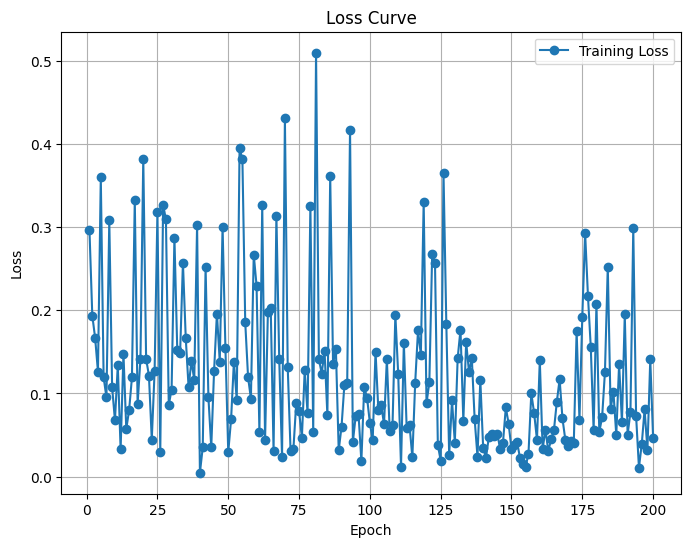

Predicted value for the first sample: 1.8116
Training Loss Scaling Unreversed: 0.1320820301771164
Training Loss Scaling Reversed: 955.0288696289062


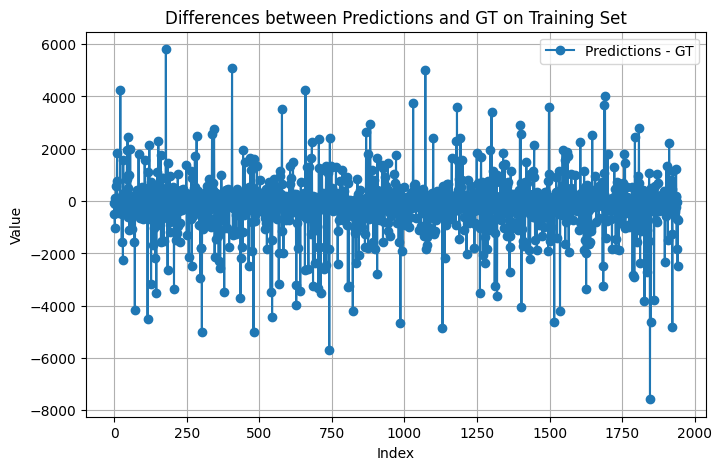

Predicted value for the first sample: 2.9050
Validation Loss Scaling Unreversed: 0.5549803972244263
Validation Loss Scaling Reversed: 4012.826904296875


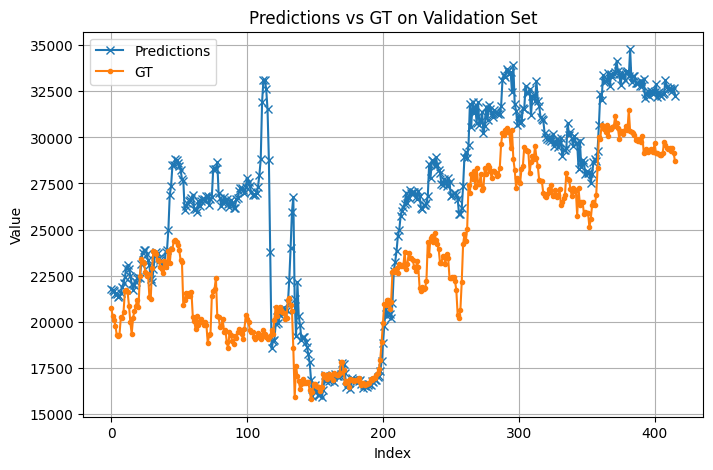

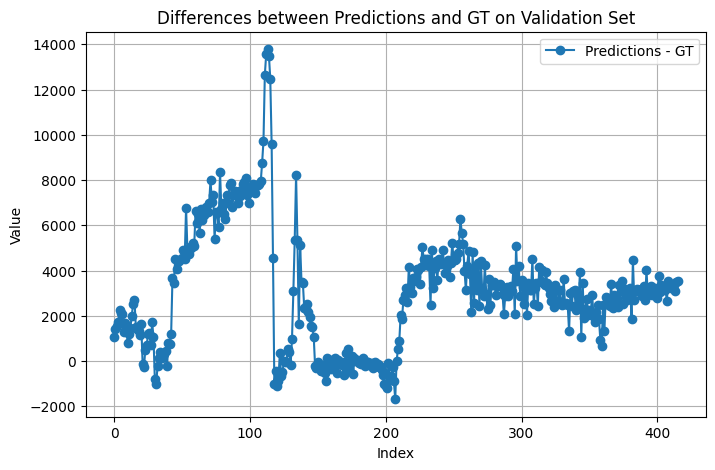

Return: 0.653255820274353
Max Drawdown: -0.17894849181175232
Epoch [5/200], Loss: 0.7633
Epoch [10/200], Loss: 0.0287
Epoch [15/200], Loss: 0.1190
Epoch [20/200], Loss: 0.0698
Epoch [25/200], Loss: 0.2637
Epoch [30/200], Loss: 0.1585
Epoch [35/200], Loss: 0.1898
Epoch [40/200], Loss: 0.0479
Epoch [45/200], Loss: 0.1079
Epoch [50/200], Loss: 0.0777
Epoch [55/200], Loss: 0.0430
Epoch [60/200], Loss: 0.3311
Epoch [65/200], Loss: 0.0975
Epoch [70/200], Loss: 0.0455
Epoch [75/200], Loss: 0.0348
Epoch [80/200], Loss: 0.3412
Epoch [85/200], Loss: 0.1472
Epoch [90/200], Loss: 0.0811
Epoch [95/200], Loss: 0.0370
Epoch [100/200], Loss: 0.0635
Epoch [105/200], Loss: 0.0247
Epoch [110/200], Loss: 0.2233
Epoch [115/200], Loss: 0.0206
Epoch [120/200], Loss: 0.1201
Epoch [125/200], Loss: 0.0349
Epoch [130/200], Loss: 0.1471
Epoch [135/200], Loss: 0.0940
Epoch [140/200], Loss: 0.0400
Epoch [145/200], Loss: 0.1973
Epoch [150/200], Loss: 0.4800
Epoch [155/200], Loss: 0.1076
Epoch [160/200], Loss: 0.2147

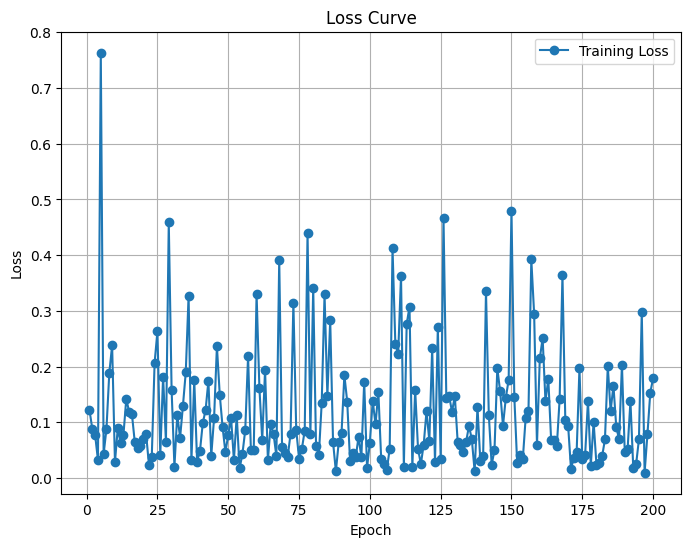

Predicted value for the first sample: 1.8802
Training Loss Scaling Unreversed: 0.13723553717136383
Training Loss Scaling Reversed: 992.2916870117188


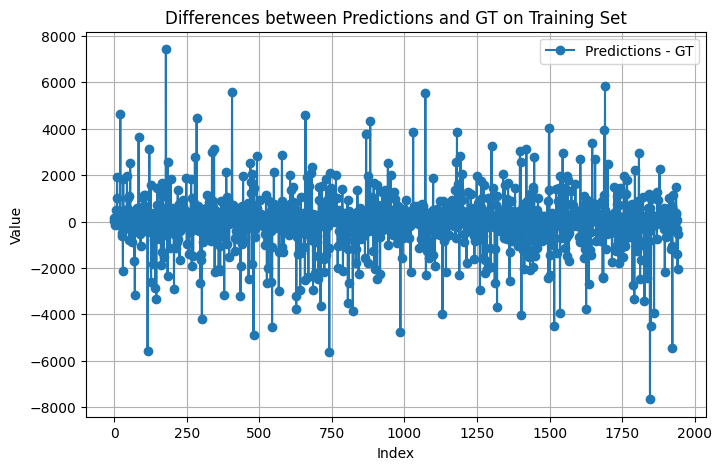

Predicted value for the first sample: 2.9284
Validation Loss Scaling Unreversed: 0.1515023112297058
Validation Loss Scaling Reversed: 1095.44873046875


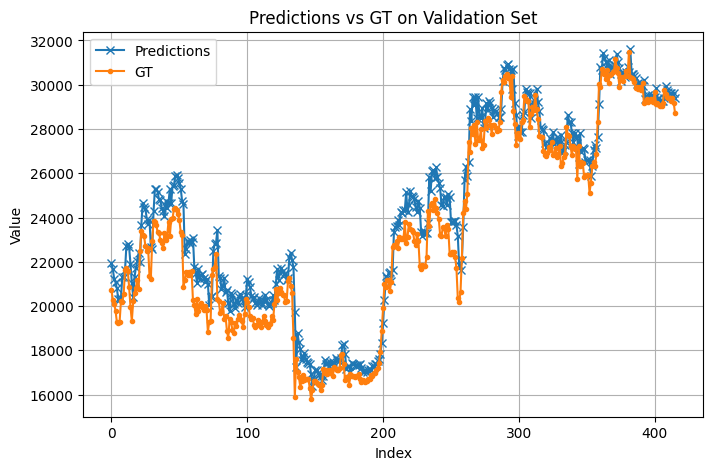

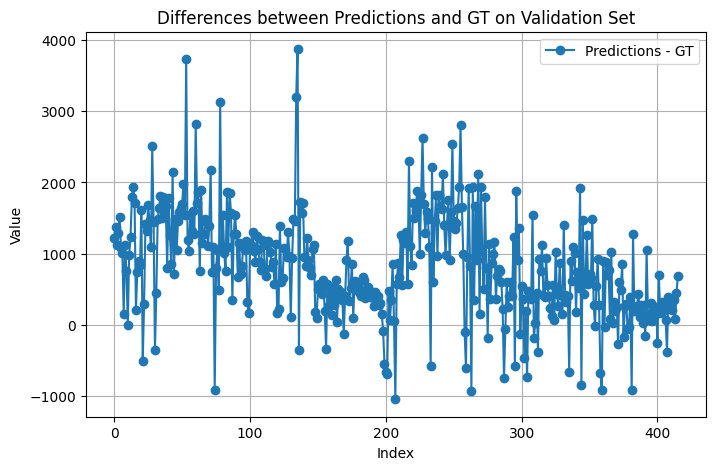

Return: 0.4451742172241211
Max Drawdown: -0.1992715299129486
Epoch [5/200], Loss: 3.1511
Epoch [10/200], Loss: 3.1130
Epoch [15/200], Loss: 1.2319
Epoch [20/200], Loss: 0.0712
Epoch [25/200], Loss: 0.2841
Epoch [30/200], Loss: 1.5518
Epoch [35/200], Loss: 1.3404
Epoch [40/200], Loss: 0.0230
Epoch [45/200], Loss: 0.0711
Epoch [50/200], Loss: 0.0331
Epoch [55/200], Loss: 0.0662
Epoch [60/200], Loss: 0.3691
Epoch [65/200], Loss: 0.2507
Epoch [70/200], Loss: 0.0799
Epoch [75/200], Loss: 0.0181
Epoch [80/200], Loss: 0.2134
Epoch [85/200], Loss: 0.1385
Epoch [90/200], Loss: 0.0332
Epoch [95/200], Loss: 0.0456
Epoch [100/200], Loss: 0.0556
Epoch [105/200], Loss: 0.0321
Epoch [110/200], Loss: 0.1309
Epoch [115/200], Loss: 0.5296
Epoch [120/200], Loss: 0.5187
Epoch [125/200], Loss: 0.0762
Epoch [130/200], Loss: 0.0577
Epoch [135/200], Loss: 0.1322
Epoch [140/200], Loss: 0.0621
Epoch [145/200], Loss: 0.3678
Epoch [150/200], Loss: 0.0862
Epoch [155/200], Loss: 0.0161
Epoch [160/200], Loss: 0.0372

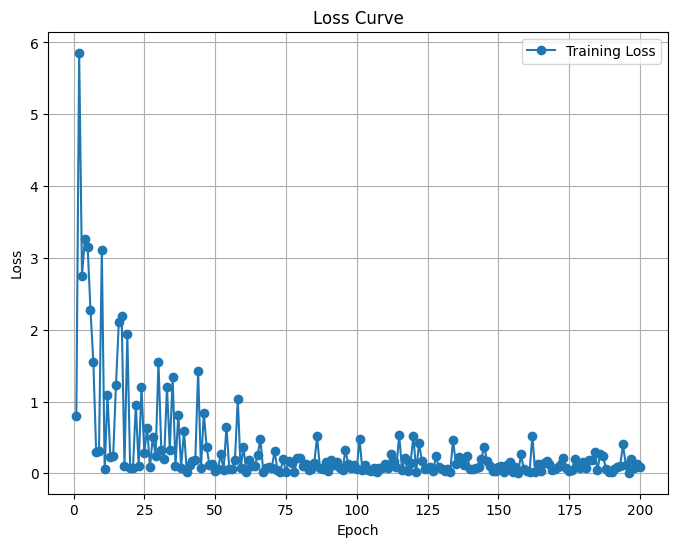

Predicted value for the first sample: 1.8037
Training Loss Scaling Unreversed: 0.1877416968345642
Training Loss Scaling Reversed: 1357.4801025390625


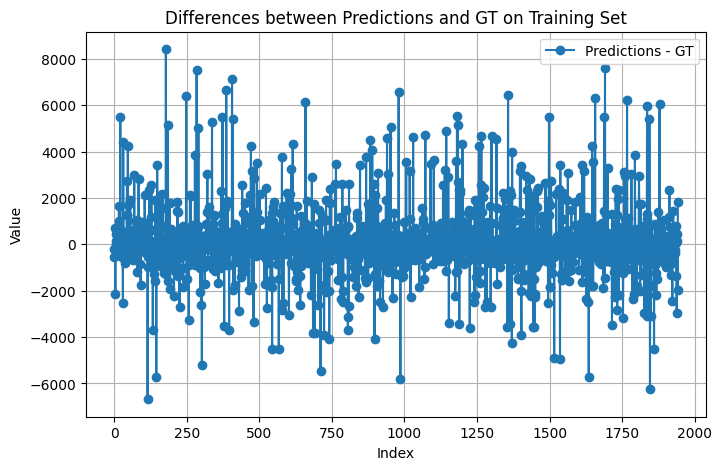

Predicted value for the first sample: 2.9970
Validation Loss Scaling Unreversed: 0.13591518998146057
Validation Loss Scaling Reversed: 982.7449340820312


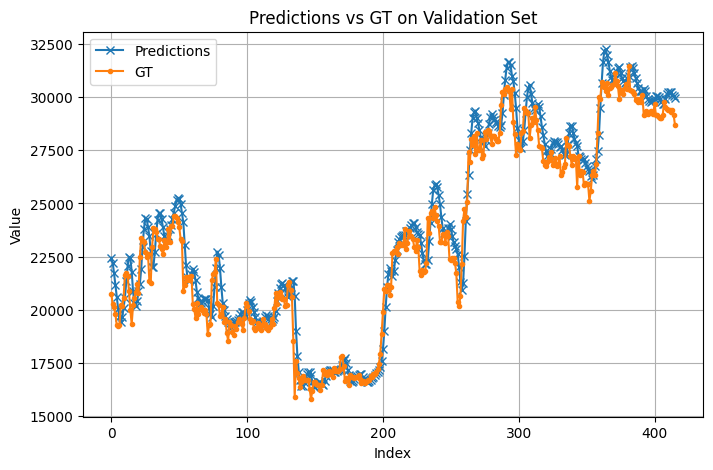

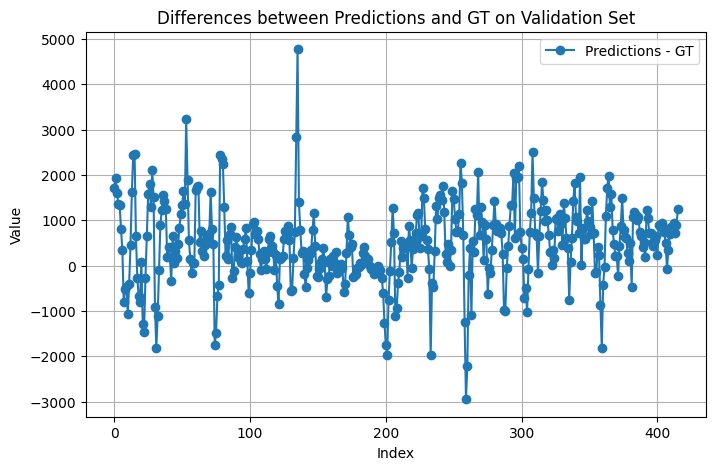

Return: 0.22456622123718262
Max Drawdown: -0.34089726209640503
Epoch [5/200], Loss: 0.2251
Epoch [10/200], Loss: 0.1962
Epoch [15/200], Loss: 0.1221
Epoch [20/200], Loss: 0.1700
Epoch [25/200], Loss: 0.1407
Epoch [30/200], Loss: 0.0321
Epoch [35/200], Loss: 0.4671
Epoch [40/200], Loss: 0.2219
Epoch [45/200], Loss: 0.2332
Epoch [50/200], Loss: 0.0756
Epoch [55/200], Loss: 0.1977
Epoch [60/200], Loss: 0.0290
Epoch [65/200], Loss: 0.1320
Epoch [70/200], Loss: 0.0615
Epoch [75/200], Loss: 0.1176
Epoch [80/200], Loss: 0.2113
Epoch [85/200], Loss: 0.0322
Epoch [90/200], Loss: 0.0589
Epoch [95/200], Loss: 0.0814
Epoch [100/200], Loss: 0.0266
Epoch [105/200], Loss: 0.2642
Epoch [110/200], Loss: 0.1125
Epoch [115/200], Loss: 0.0954
Epoch [120/200], Loss: 0.0488
Epoch [125/200], Loss: 0.2566
Epoch [130/200], Loss: 0.4098
Epoch [135/200], Loss: 0.0881
Epoch [140/200], Loss: 0.0561
Epoch [145/200], Loss: 0.4214
Epoch [150/200], Loss: 0.0535
Epoch [155/200], Loss: 0.0831
Epoch [160/200], Loss: 0.04

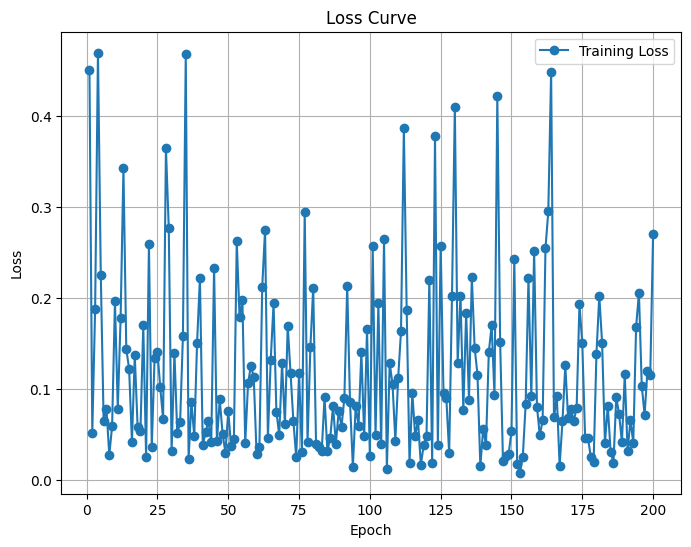

Predicted value for the first sample: 1.8508
Training Loss Scaling Unreversed: 0.13242526352405548
Training Loss Scaling Reversed: 957.5107421875


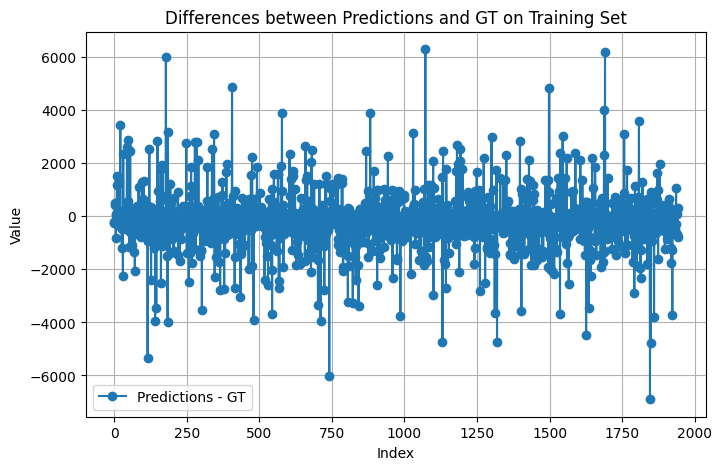

Predicted value for the first sample: 2.7501
Validation Loss Scaling Unreversed: 0.15720953047275543
Validation Loss Scaling Reversed: 1136.7152099609375


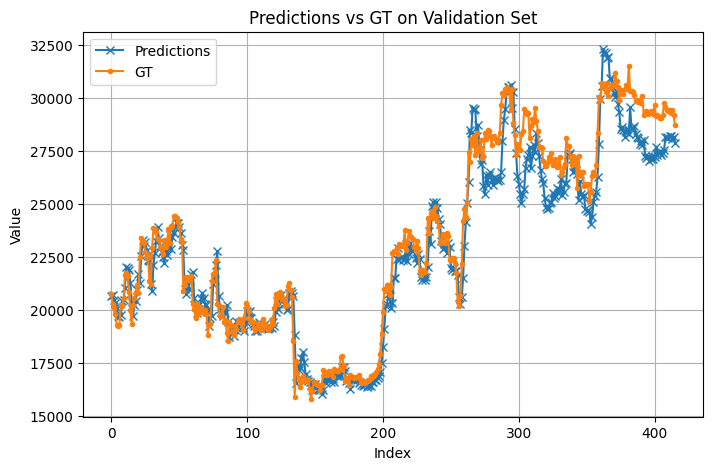

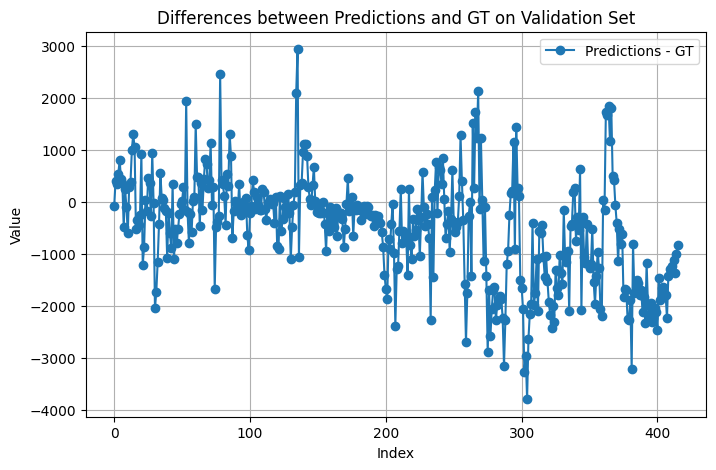

Return: 0.6181221008300781
Max Drawdown: -0.20289884507656097
Epoch [5/200], Loss: 1.0517
Epoch [10/200], Loss: 0.1508
Epoch [15/200], Loss: 0.4015
Epoch [20/200], Loss: 0.0867
Epoch [25/200], Loss: 0.1904
Epoch [30/200], Loss: 0.0477
Epoch [35/200], Loss: 0.0800
Epoch [40/200], Loss: 0.0551
Epoch [45/200], Loss: 0.3741
Epoch [50/200], Loss: 0.1035
Epoch [55/200], Loss: 0.3404
Epoch [60/200], Loss: 0.0498
Epoch [65/200], Loss: 0.1184
Epoch [70/200], Loss: 0.3547
Epoch [75/200], Loss: 0.0511
Epoch [80/200], Loss: 0.1456
Epoch [85/200], Loss: 0.0527
Epoch [90/200], Loss: 0.2395
Epoch [95/200], Loss: 0.2123
Epoch [100/200], Loss: 0.0712
Epoch [105/200], Loss: 0.0808
Epoch [110/200], Loss: 0.0742
Epoch [115/200], Loss: 0.0957
Epoch [120/200], Loss: 0.1315
Epoch [125/200], Loss: 0.0578
Epoch [130/200], Loss: 0.0290
Epoch [135/200], Loss: 0.1447
Epoch [140/200], Loss: 0.0081
Epoch [145/200], Loss: 0.0261
Epoch [150/200], Loss: 0.0704
Epoch [155/200], Loss: 0.0999
Epoch [160/200], Loss: 0.096

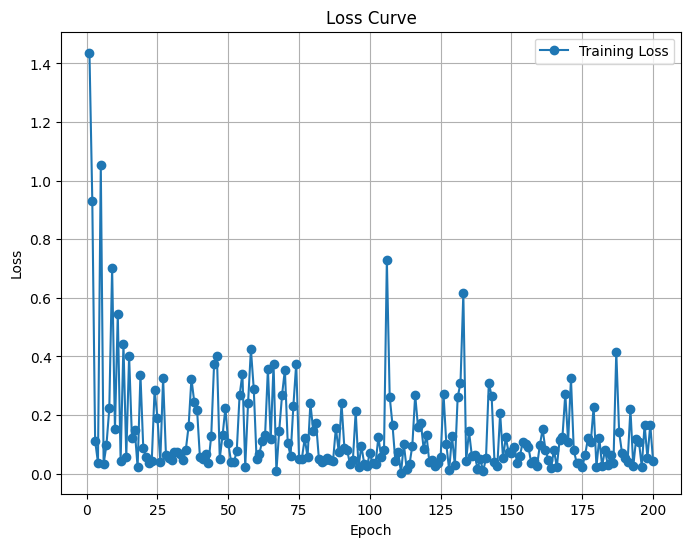

Predicted value for the first sample: 1.8427
Training Loss Scaling Unreversed: 0.13561061024665833
Training Loss Scaling Reversed: 980.54248046875


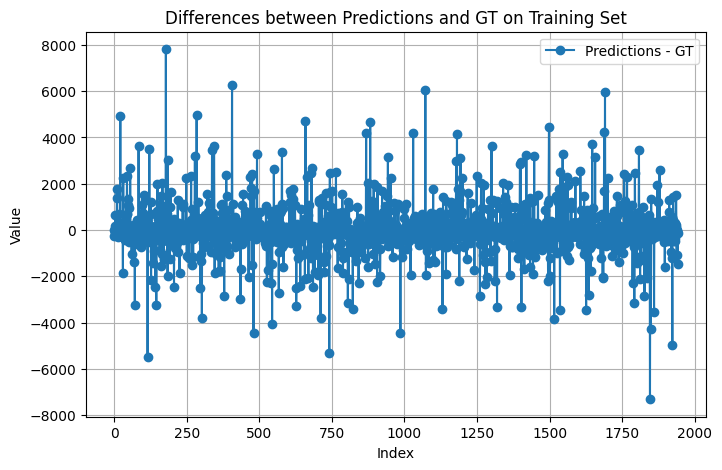

Predicted value for the first sample: 2.8845
Validation Loss Scaling Unreversed: 0.11127873510122299
Validation Loss Scaling Reversed: 804.6091918945312


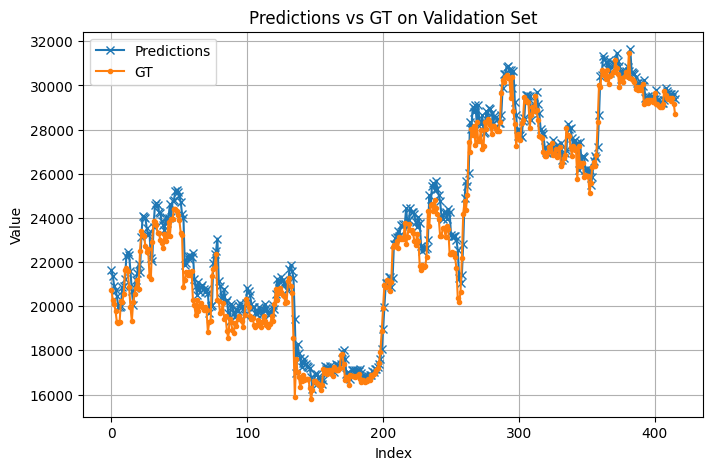

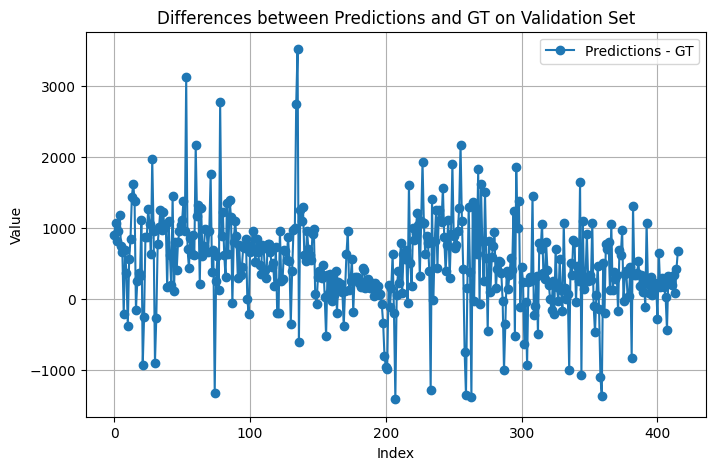

Return: 0.48537373542785645
Max Drawdown: -0.2172265201807022
Epoch [5/200], Loss: 3.9704
Epoch [10/200], Loss: 0.0994
Epoch [15/200], Loss: 0.1507
Epoch [20/200], Loss: 0.8151
Epoch [25/200], Loss: 0.0611
Epoch [30/200], Loss: 0.3537
Epoch [35/200], Loss: 0.9975
Epoch [40/200], Loss: 0.2612
Epoch [45/200], Loss: 0.0890
Epoch [50/200], Loss: 0.1206
Epoch [55/200], Loss: 0.5901
Epoch [60/200], Loss: 0.3570
Epoch [65/200], Loss: 0.2280
Epoch [70/200], Loss: 0.7105
Epoch [75/200], Loss: 0.1346
Epoch [80/200], Loss: 0.3889
Epoch [85/200], Loss: 0.5382
Epoch [90/200], Loss: 0.2902
Epoch [95/200], Loss: 0.1419
Epoch [100/200], Loss: 0.1332
Epoch [105/200], Loss: 0.1569
Epoch [110/200], Loss: 0.0777
Epoch [115/200], Loss: 0.1918
Epoch [120/200], Loss: 0.3701
Epoch [125/200], Loss: 0.1288
Epoch [130/200], Loss: 0.0399
Epoch [135/200], Loss: 0.1187
Epoch [140/200], Loss: 0.0634
Epoch [145/200], Loss: 0.0589
Epoch [150/200], Loss: 0.1083
Epoch [155/200], Loss: 0.0473
Epoch [160/200], Loss: 0.390

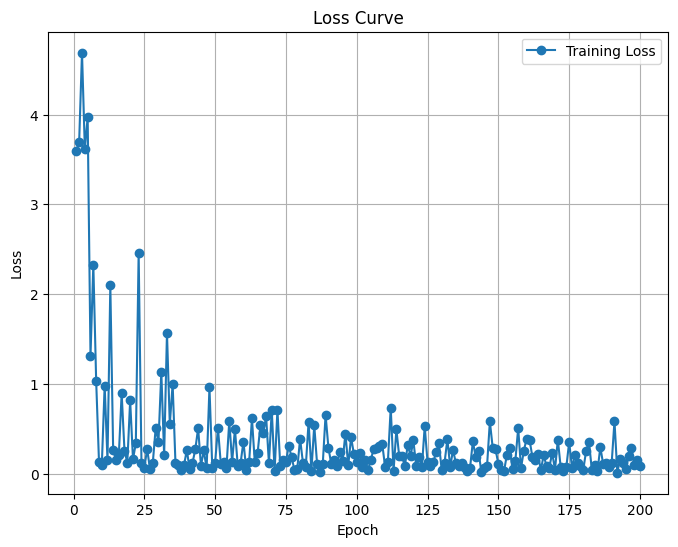

Predicted value for the first sample: 1.8422
Training Loss Scaling Unreversed: 0.197602778673172
Training Loss Scaling Reversed: 1428.7816162109375


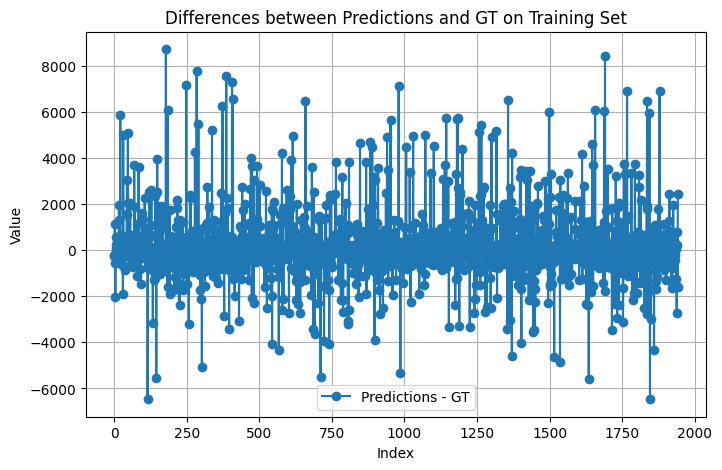

Predicted value for the first sample: 2.9057
Validation Loss Scaling Unreversed: 0.13472463190555573
Validation Loss Scaling Reversed: 974.1364135742188


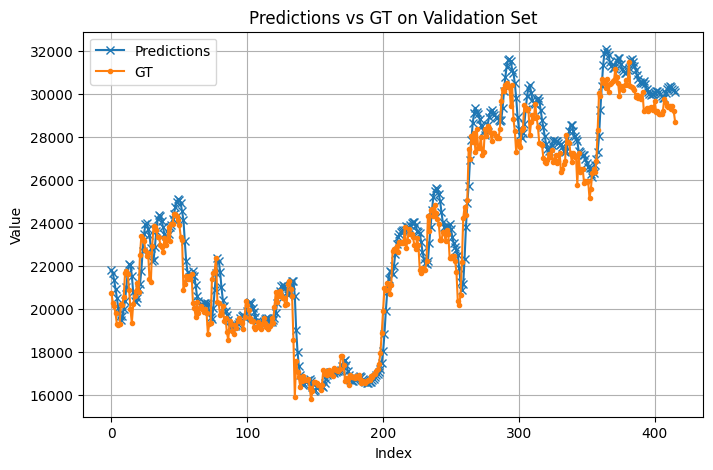

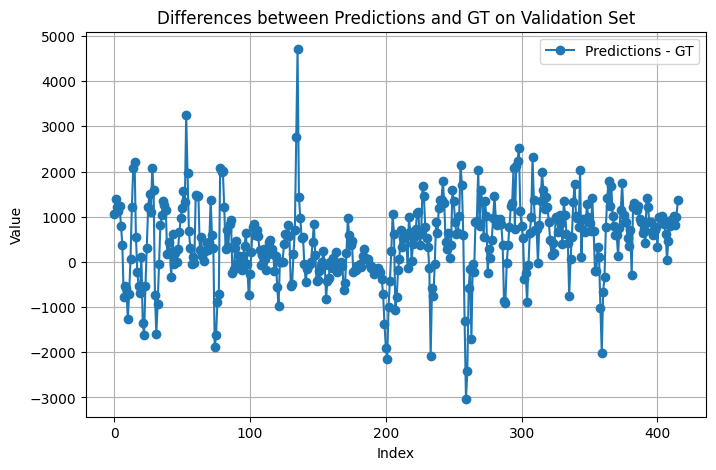

Return: 0.4364163875579834
Max Drawdown: -0.2664231061935425
Epoch [5/200], Loss: 0.3142
Epoch [10/200], Loss: 0.2532
Epoch [15/200], Loss: 0.0674
Epoch [20/200], Loss: 0.0354
Epoch [25/200], Loss: 0.2251
Epoch [30/200], Loss: 0.3781
Epoch [35/200], Loss: 0.1060
Epoch [40/200], Loss: 0.0388
Epoch [45/200], Loss: 0.0570
Epoch [50/200], Loss: 0.0611
Epoch [55/200], Loss: 0.1025
Epoch [60/200], Loss: 0.1987
Epoch [65/200], Loss: 0.0448
Epoch [70/200], Loss: 0.2460
Epoch [75/200], Loss: 0.0827
Epoch [80/200], Loss: 0.0570
Epoch [85/200], Loss: 0.0232
Epoch [90/200], Loss: 0.1028
Epoch [95/200], Loss: 0.0520
Epoch [100/200], Loss: 0.2935
Epoch [105/200], Loss: 0.1058
Epoch [110/200], Loss: 0.0377
Epoch [115/200], Loss: 0.1564
Epoch [120/200], Loss: 0.0375
Epoch [125/200], Loss: 0.1592
Epoch [130/200], Loss: 0.1067
Epoch [135/200], Loss: 0.1671
Epoch [140/200], Loss: 0.2945
Epoch [145/200], Loss: 0.0170
Epoch [150/200], Loss: 0.0430
Epoch [155/200], Loss: 0.6300
Epoch [160/200], Loss: 0.1302

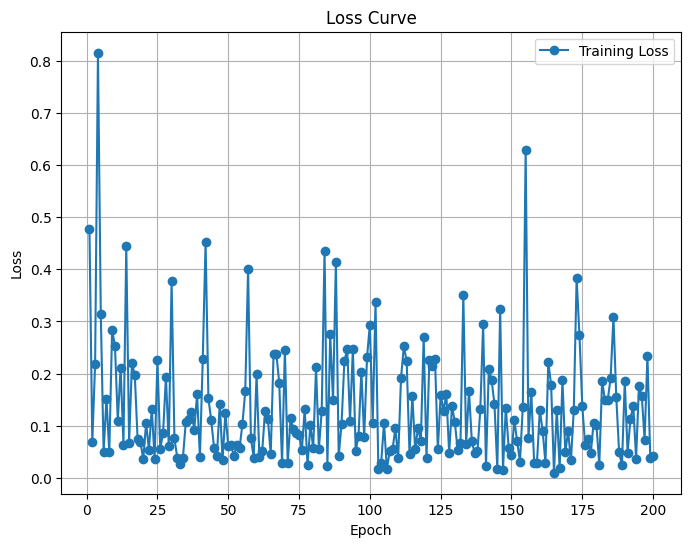

Predicted value for the first sample: 1.8296
Training Loss Scaling Unreversed: 0.136708602309227
Training Loss Scaling Reversed: 988.481689453125


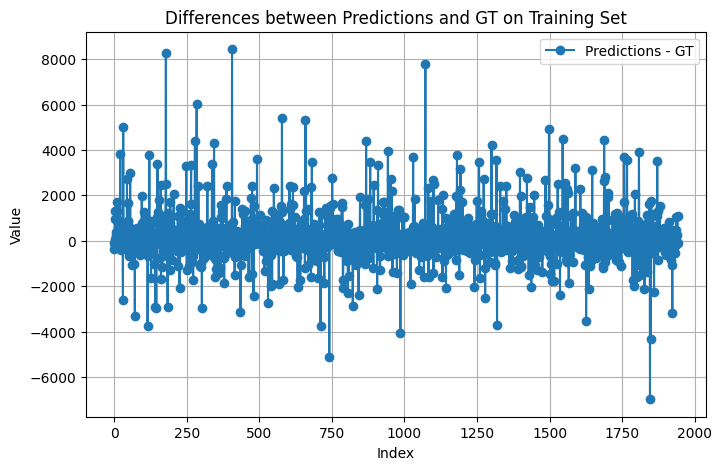

Predicted value for the first sample: 2.7167
Validation Loss Scaling Unreversed: 0.32894396781921387
Validation Loss Scaling Reversed: 2378.453857421875


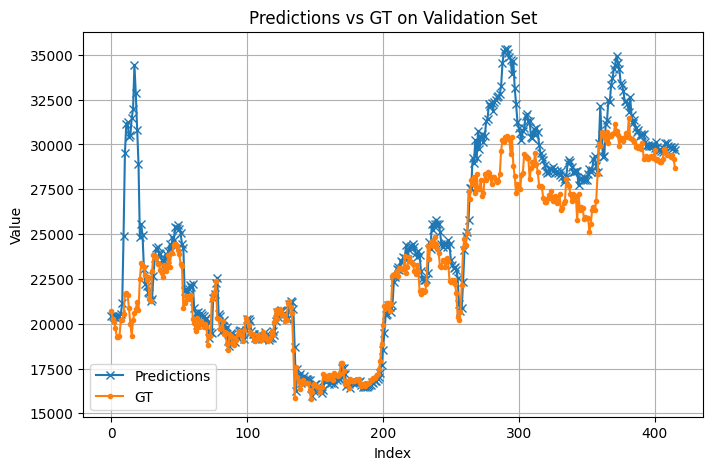

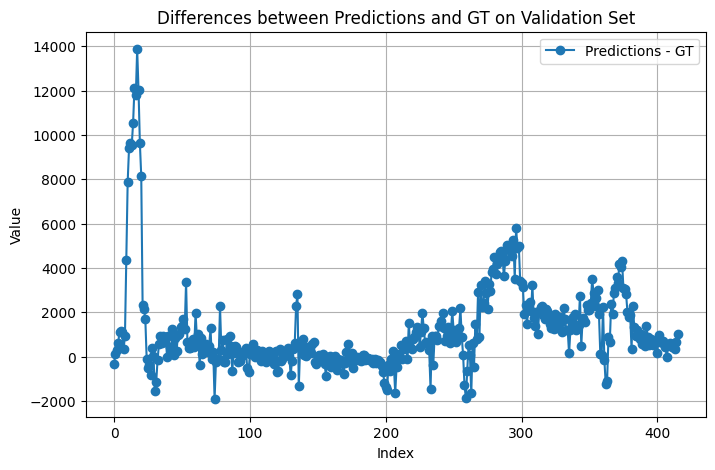

Return: 0.631711483001709
Max Drawdown: -0.20802229642868042
Epoch [5/200], Loss: 0.3390
Epoch [10/200], Loss: 0.2217
Epoch [15/200], Loss: 0.2341
Epoch [20/200], Loss: 0.2047
Epoch [25/200], Loss: 0.0496
Epoch [30/200], Loss: 0.2044
Epoch [35/200], Loss: 0.1052
Epoch [40/200], Loss: 0.0866
Epoch [45/200], Loss: 0.3015
Epoch [50/200], Loss: 0.1130
Epoch [55/200], Loss: 0.0508
Epoch [60/200], Loss: 0.0408
Epoch [65/200], Loss: 0.1316
Epoch [70/200], Loss: 0.1210
Epoch [75/200], Loss: 0.0229
Epoch [80/200], Loss: 0.0495
Epoch [85/200], Loss: 0.0958
Epoch [90/200], Loss: 0.2047
Epoch [95/200], Loss: 0.0141
Epoch [100/200], Loss: 0.1053
Epoch [105/200], Loss: 0.0343
Epoch [110/200], Loss: 0.2029
Epoch [115/200], Loss: 0.0493
Epoch [120/200], Loss: 0.0139
Epoch [125/200], Loss: 0.0330
Epoch [130/200], Loss: 0.1386
Epoch [135/200], Loss: 0.0341
Epoch [140/200], Loss: 0.0257
Epoch [145/200], Loss: 0.1577
Epoch [150/200], Loss: 0.4168
Epoch [155/200], Loss: 0.1604
Epoch [160/200], Loss: 0.0837

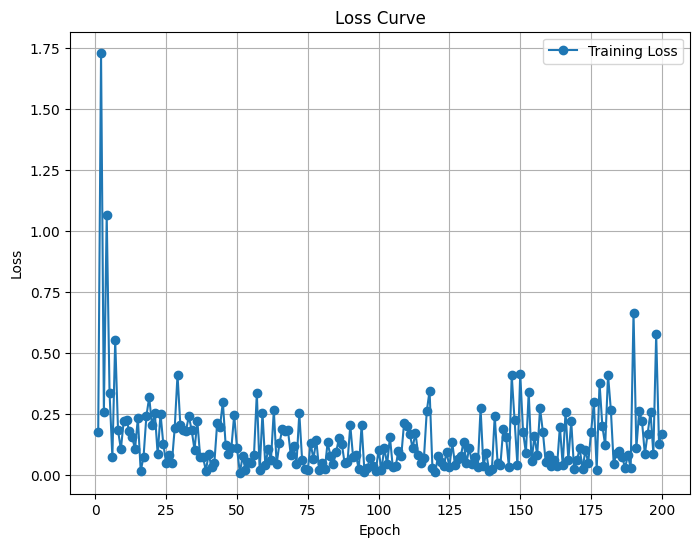

Predicted value for the first sample: 1.8469
Training Loss Scaling Unreversed: 0.1559571474790573
Training Loss Scaling Reversed: 1127.6595458984375


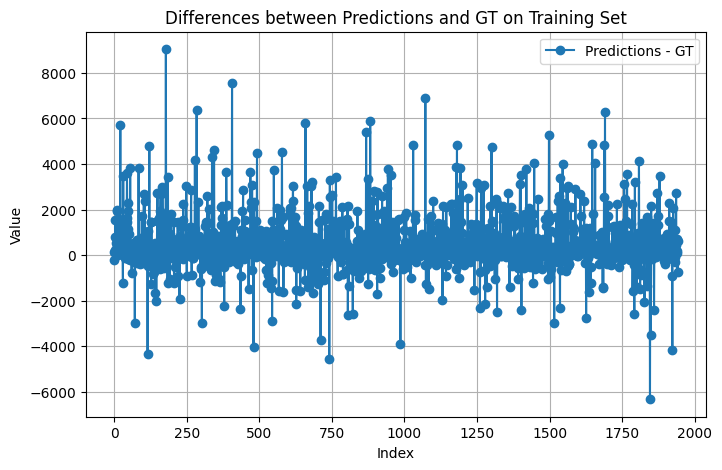

Predicted value for the first sample: 3.0071
Validation Loss Scaling Unreversed: 0.18345680832862854
Validation Loss Scaling Reversed: 1326.4981689453125


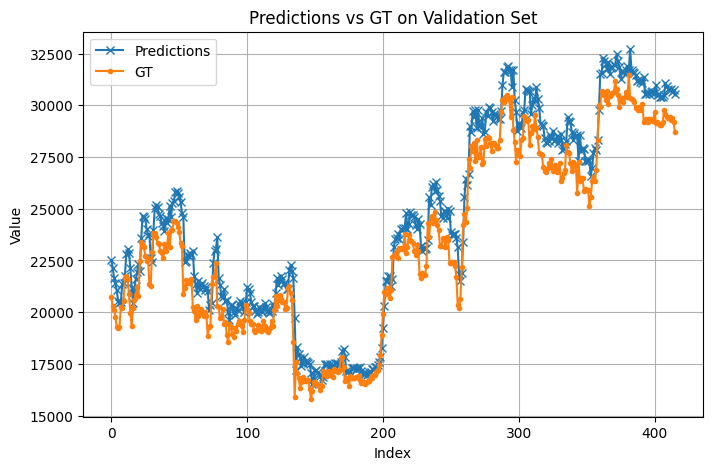

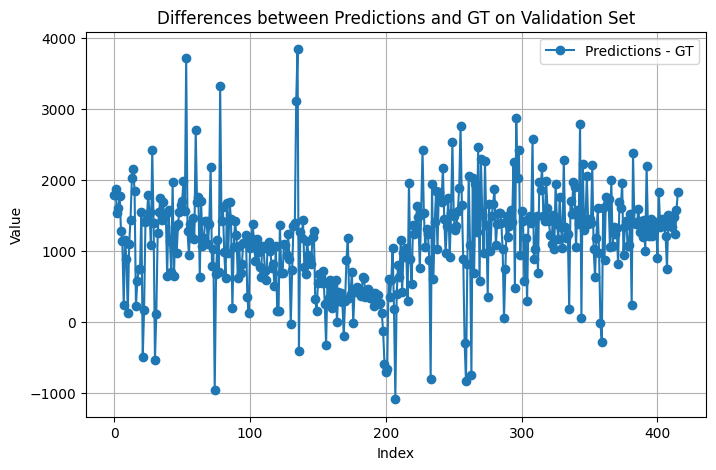

Return: 0.46633780002593994
Max Drawdown: -0.20307497680187225
Epoch [5/200], Loss: 3.5129
Epoch [10/200], Loss: 1.9853
Epoch [15/200], Loss: 0.2232
Epoch [20/200], Loss: 0.8548
Epoch [25/200], Loss: 1.9449
Epoch [30/200], Loss: 0.6446
Epoch [35/200], Loss: 0.6473
Epoch [40/200], Loss: 0.7133
Epoch [45/200], Loss: 0.1528
Epoch [50/200], Loss: 0.1282
Epoch [55/200], Loss: 0.1160
Epoch [60/200], Loss: 0.4023
Epoch [65/200], Loss: 0.1143
Epoch [70/200], Loss: 0.1287
Epoch [75/200], Loss: 0.0972
Epoch [80/200], Loss: 0.9562
Epoch [85/200], Loss: 0.4885
Epoch [90/200], Loss: 0.2838
Epoch [95/200], Loss: 0.1493
Epoch [100/200], Loss: 0.0464
Epoch [105/200], Loss: 0.0911
Epoch [110/200], Loss: 0.1204
Epoch [115/200], Loss: 0.1835
Epoch [120/200], Loss: 0.1371
Epoch [125/200], Loss: 0.0837
Epoch [130/200], Loss: 0.0430
Epoch [135/200], Loss: 0.5450
Epoch [140/200], Loss: 0.2123
Epoch [145/200], Loss: 0.4626
Epoch [150/200], Loss: 0.1410
Epoch [155/200], Loss: 0.3204
Epoch [160/200], Loss: 0.39

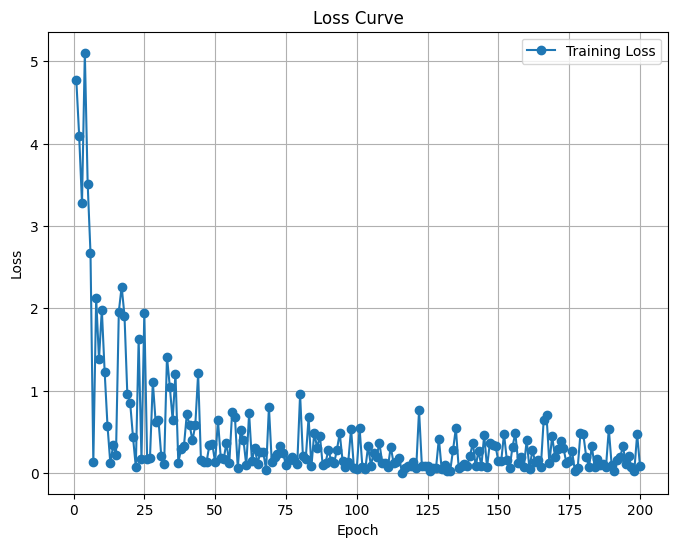

Predicted value for the first sample: 1.9295
Training Loss Scaling Unreversed: 0.20657162368297577
Training Loss Scaling Reversed: 1493.6314697265625


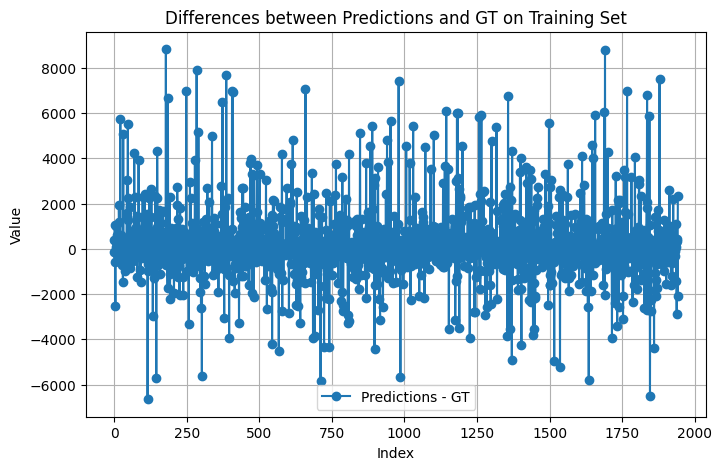

Predicted value for the first sample: 2.9158
Validation Loss Scaling Unreversed: 0.16126255691051483
Validation Loss Scaling Reversed: 1166.0208740234375


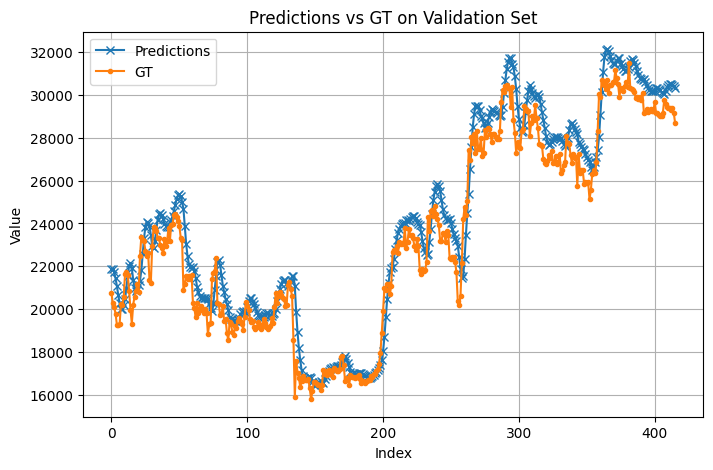

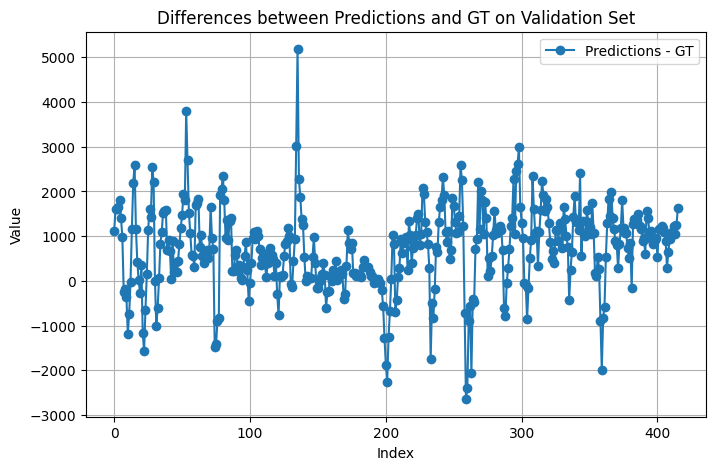

Return: 0.19715440273284912
Max Drawdown: -0.3380352258682251
Epoch [5/200], Loss: 0.1263
Epoch [10/200], Loss: 0.0520
Epoch [15/200], Loss: 0.2692
Epoch [20/200], Loss: 0.1545
Epoch [25/200], Loss: 0.1372
Epoch [30/200], Loss: 0.0557
Epoch [35/200], Loss: 0.2604
Epoch [40/200], Loss: 0.3329
Epoch [45/200], Loss: 0.1666
Epoch [50/200], Loss: 0.2070
Epoch [55/200], Loss: 0.0958
Epoch [60/200], Loss: 0.0406
Epoch [65/200], Loss: 0.1946
Epoch [70/200], Loss: 0.0648
Epoch [75/200], Loss: 0.0874
Epoch [80/200], Loss: 0.1436
Epoch [85/200], Loss: 0.1423
Epoch [90/200], Loss: 0.1301
Epoch [95/200], Loss: 0.1112
Epoch [100/200], Loss: 0.2932
Epoch [105/200], Loss: 0.1617
Epoch [110/200], Loss: 0.1176
Epoch [115/200], Loss: 0.1938
Epoch [120/200], Loss: 0.0377
Epoch [125/200], Loss: 0.0635
Epoch [130/200], Loss: 0.1191
Epoch [135/200], Loss: 0.0435
Epoch [140/200], Loss: 0.1991
Epoch [145/200], Loss: 0.1600
Epoch [150/200], Loss: 0.0689
Epoch [155/200], Loss: 0.2766
Epoch [160/200], Loss: 0.069

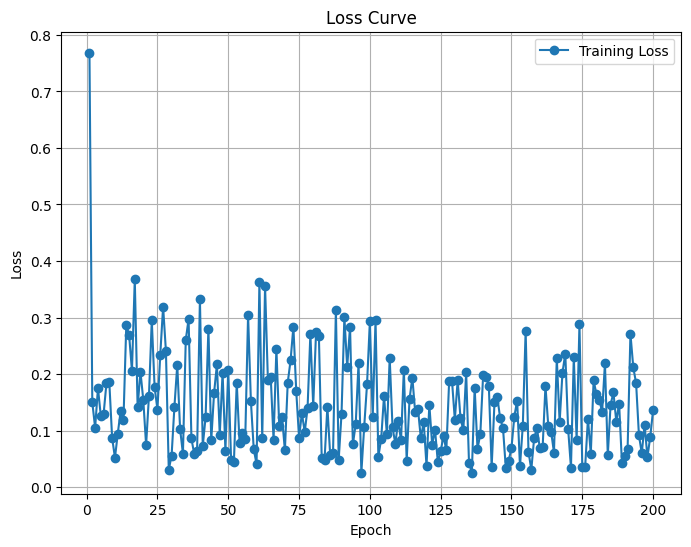

Predicted value for the first sample: 1.8719
Training Loss Scaling Unreversed: 0.13429568707942963
Training Loss Scaling Reversed: 971.0348510742188


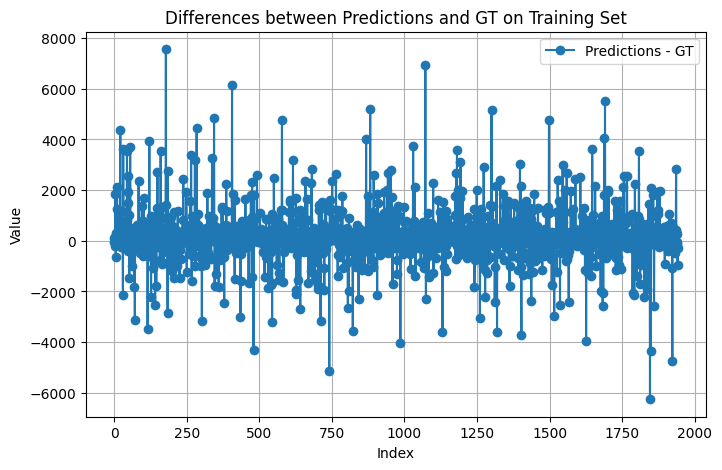

Predicted value for the first sample: 2.7880
Validation Loss Scaling Unreversed: 0.1003936305642128
Validation Loss Scaling Reversed: 725.9036865234375


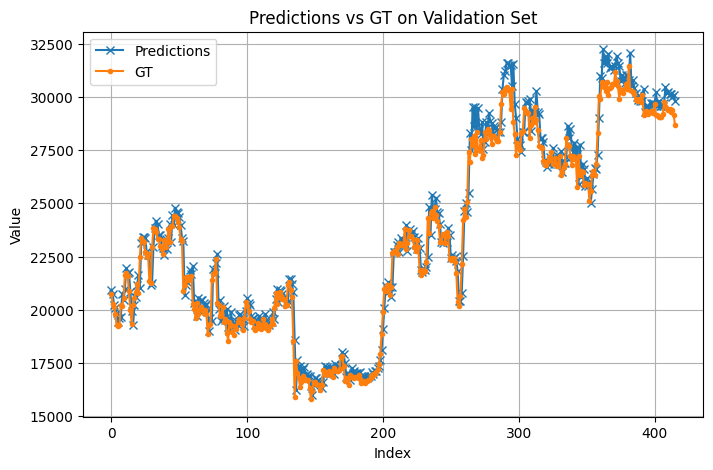

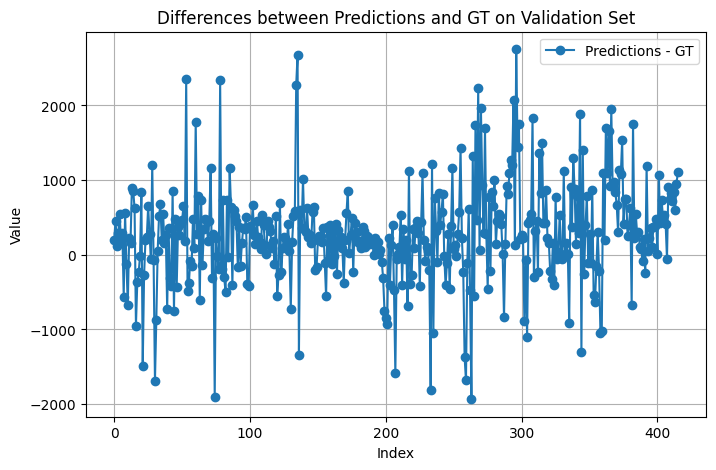

Return: 0.38959407806396484
Max Drawdown: -0.24834097921848297
Epoch [5/200], Loss: 0.2949
Epoch [10/200], Loss: 0.1441
Epoch [15/200], Loss: 0.1874
Epoch [20/200], Loss: 0.6691
Epoch [25/200], Loss: 0.1600
Epoch [30/200], Loss: 0.1853
Epoch [35/200], Loss: 0.3226
Epoch [40/200], Loss: 0.0531
Epoch [45/200], Loss: 0.0754
Epoch [50/200], Loss: 0.0332
Epoch [55/200], Loss: 0.1207
Epoch [60/200], Loss: 0.0792
Epoch [65/200], Loss: 0.2368
Epoch [70/200], Loss: 0.1887
Epoch [75/200], Loss: 0.1396
Epoch [80/200], Loss: 0.0447
Epoch [85/200], Loss: 0.1573
Epoch [90/200], Loss: 0.0974
Epoch [95/200], Loss: 0.3047
Epoch [100/200], Loss: 0.1069
Epoch [105/200], Loss: 0.1212
Epoch [110/200], Loss: 0.2299
Epoch [115/200], Loss: 0.0751
Epoch [120/200], Loss: 0.3549
Epoch [125/200], Loss: 0.2217
Epoch [130/200], Loss: 0.1314
Epoch [135/200], Loss: 0.2397
Epoch [140/200], Loss: 0.1144
Epoch [145/200], Loss: 0.1472
Epoch [150/200], Loss: 0.0499
Epoch [155/200], Loss: 0.1908
Epoch [160/200], Loss: 0.10

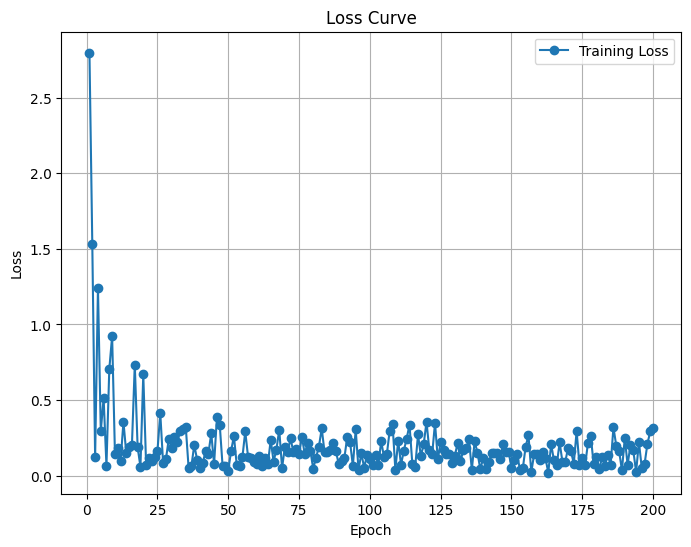

Predicted value for the first sample: 1.8327
Training Loss Scaling Unreversed: 0.13708357512950897
Training Loss Scaling Reversed: 991.1929321289062


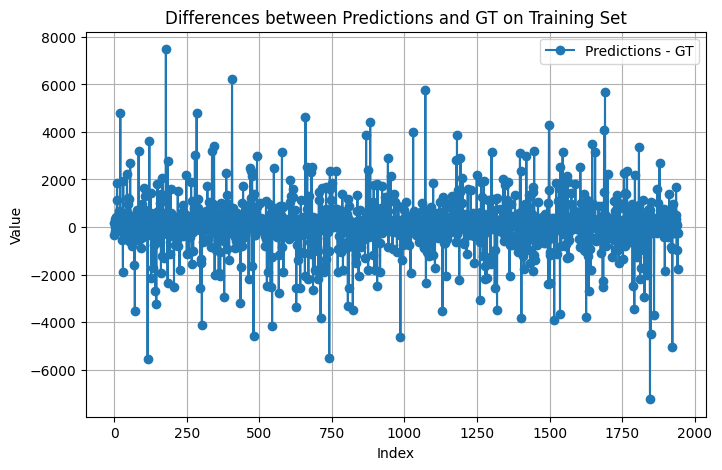

Predicted value for the first sample: 2.9321
Validation Loss Scaling Unreversed: 0.12183333188295364
Validation Loss Scaling Reversed: 880.9249877929688


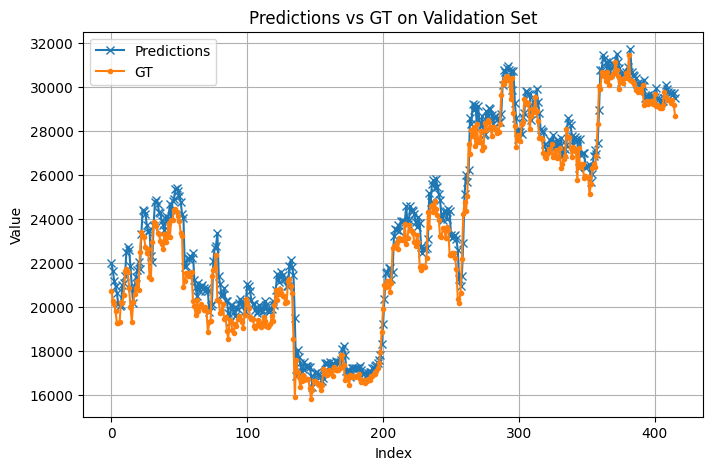

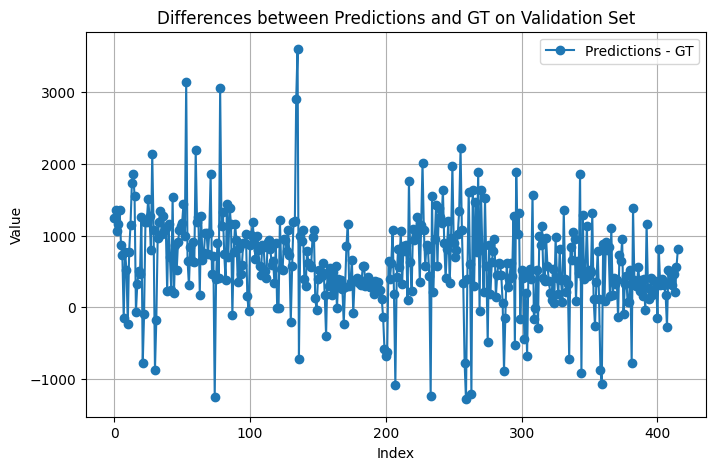

Return: 0.5154703855514526
Max Drawdown: -0.17946486175060272
Epoch [5/200], Loss: 3.7255
Epoch [10/200], Loss: 3.9882
Epoch [15/200], Loss: 2.7487
Epoch [20/200], Loss: 1.0400
Epoch [25/200], Loss: 2.2349
Epoch [30/200], Loss: 1.2713
Epoch [35/200], Loss: 0.8629
Epoch [40/200], Loss: 1.4605
Epoch [45/200], Loss: 1.2242
Epoch [50/200], Loss: 0.0841
Epoch [55/200], Loss: 0.1415
Epoch [60/200], Loss: 0.4982
Epoch [65/200], Loss: 1.2019
Epoch [70/200], Loss: 0.2094
Epoch [75/200], Loss: 0.9148
Epoch [80/200], Loss: 1.3270
Epoch [85/200], Loss: 0.1229
Epoch [90/200], Loss: 0.1874
Epoch [95/200], Loss: 1.1999
Epoch [100/200], Loss: 0.1323
Epoch [105/200], Loss: 0.2118
Epoch [110/200], Loss: 0.1320
Epoch [115/200], Loss: 0.4955
Epoch [120/200], Loss: 0.1704
Epoch [125/200], Loss: 0.0904
Epoch [130/200], Loss: 0.1397
Epoch [135/200], Loss: 0.1532
Epoch [140/200], Loss: 0.3699
Epoch [145/200], Loss: 0.4990
Epoch [150/200], Loss: 0.5694
Epoch [155/200], Loss: 0.5155
Epoch [160/200], Loss: 0.105

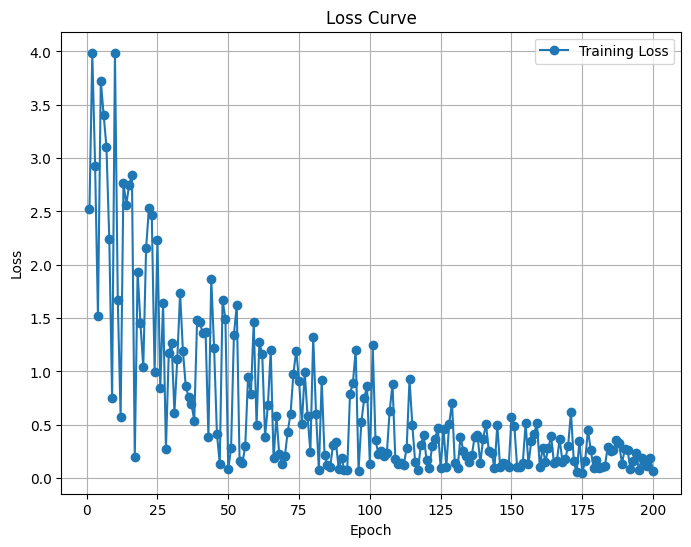

Predicted value for the first sample: 1.9467
Training Loss Scaling Unreversed: 0.24032802879810333
Training Loss Scaling Reversed: 1737.7095947265625


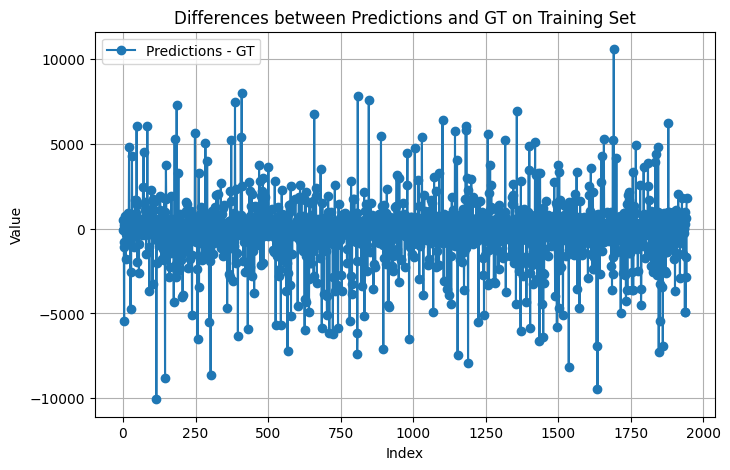

Predicted value for the first sample: 2.8086
Validation Loss Scaling Unreversed: 0.13477297127246857
Validation Loss Scaling Reversed: 974.4860229492188


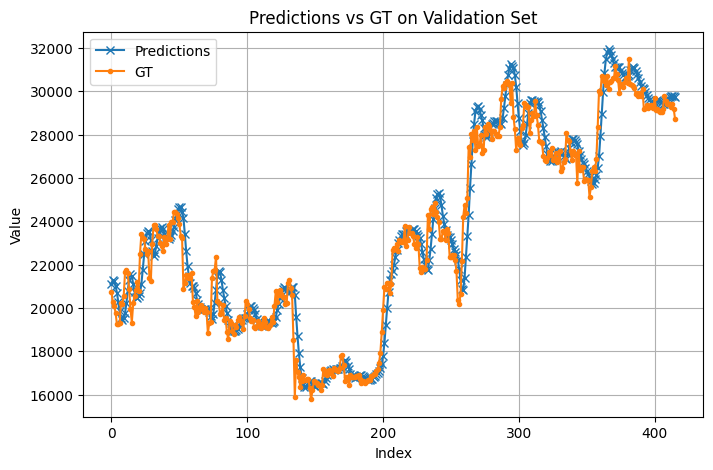

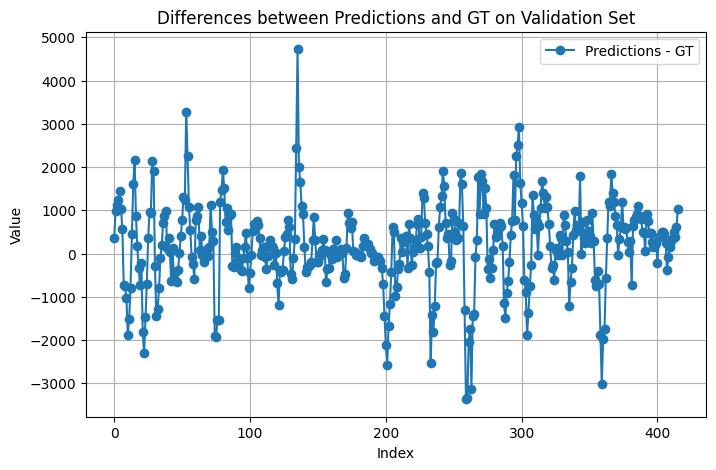

Return: -0.09970963001251221
Max Drawdown: -0.4023311138153076
Epoch [5/200], Loss: 0.2825
Epoch [10/200], Loss: 0.0687
Epoch [15/200], Loss: 0.2041
Epoch [20/200], Loss: 0.1059
Epoch [25/200], Loss: 0.1481
Epoch [30/200], Loss: 0.1901
Epoch [35/200], Loss: 0.1786
Epoch [40/200], Loss: 0.0480
Epoch [45/200], Loss: 0.0703
Epoch [50/200], Loss: 0.0389
Epoch [55/200], Loss: 0.0504
Epoch [60/200], Loss: 0.1857
Epoch [65/200], Loss: 0.0716
Epoch [70/200], Loss: 0.0316
Epoch [75/200], Loss: 0.2293
Epoch [80/200], Loss: 0.0712
Epoch [85/200], Loss: 0.1228
Epoch [90/200], Loss: 0.1041
Epoch [95/200], Loss: 0.1974
Epoch [100/200], Loss: 0.1010
Epoch [105/200], Loss: 0.2104
Epoch [110/200], Loss: 0.0703
Epoch [115/200], Loss: 0.1624
Epoch [120/200], Loss: 0.0989
Epoch [125/200], Loss: 0.0586
Epoch [130/200], Loss: 0.1925
Epoch [135/200], Loss: 0.0471
Epoch [140/200], Loss: 0.0751
Epoch [145/200], Loss: 0.0469
Epoch [150/200], Loss: 0.0455
Epoch [155/200], Loss: 0.0810
Epoch [160/200], Loss: 0.05

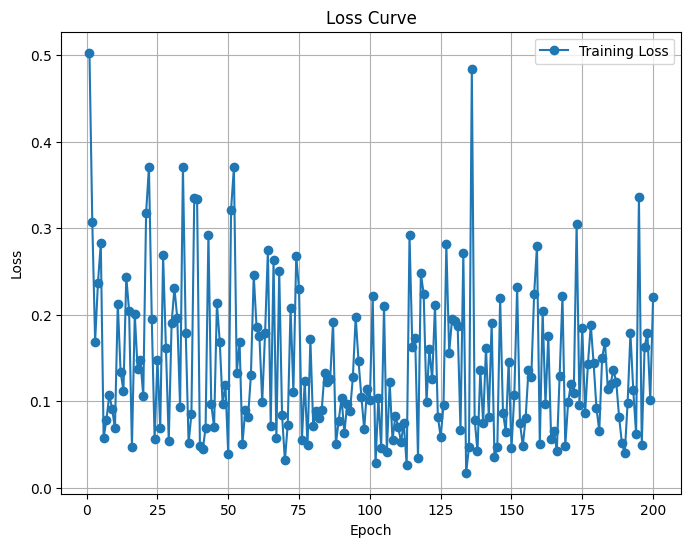

Predicted value for the first sample: 1.8880
Training Loss Scaling Unreversed: 0.13555926084518433
Training Loss Scaling Reversed: 980.1710815429688


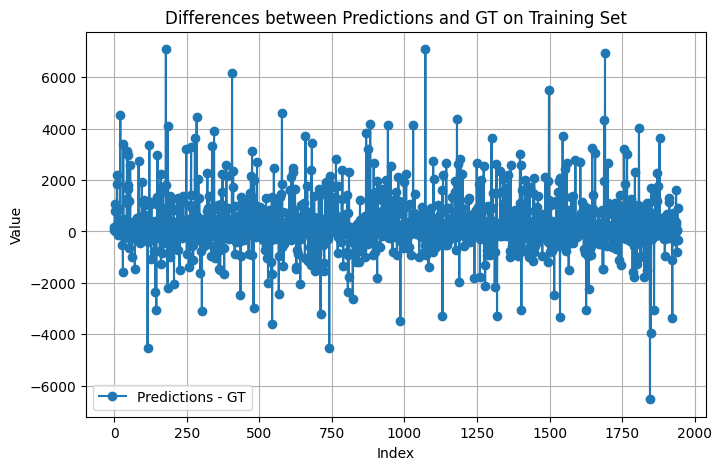

Predicted value for the first sample: 2.8098
Validation Loss Scaling Unreversed: 0.2021215558052063
Validation Loss Scaling Reversed: 1461.4549560546875


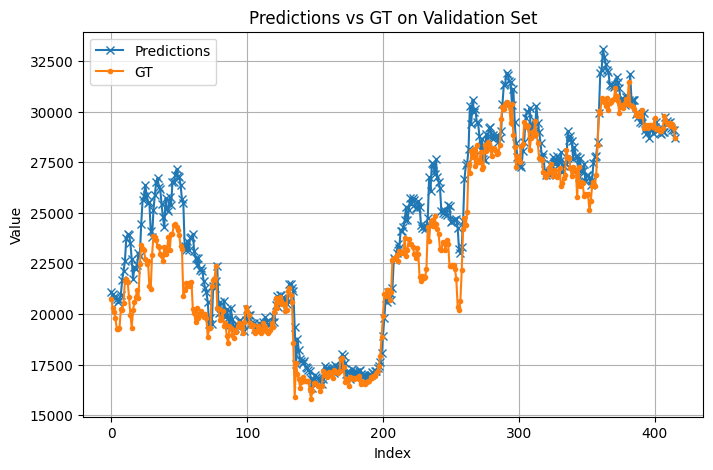

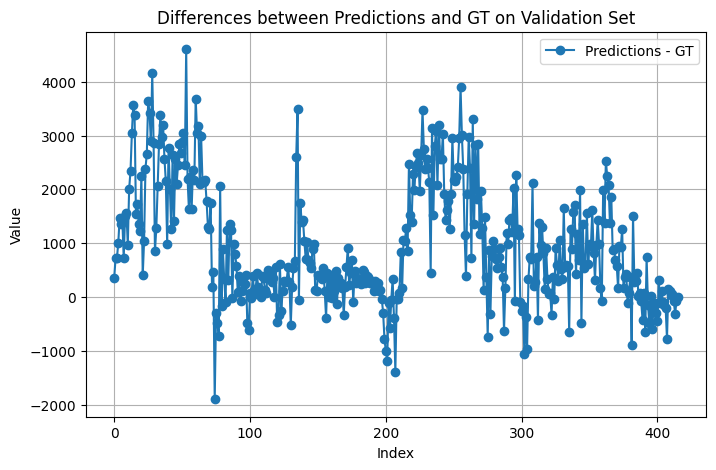

Return: 0.3556952476501465
Max Drawdown: -0.3115287125110626
Epoch [5/200], Loss: 0.7260
Epoch [10/200], Loss: 0.1050
Epoch [15/200], Loss: 0.3973
Epoch [20/200], Loss: 0.3216
Epoch [25/200], Loss: 0.4376
Epoch [30/200], Loss: 0.2631
Epoch [35/200], Loss: 0.3165
Epoch [40/200], Loss: 0.1026
Epoch [45/200], Loss: 0.3268
Epoch [50/200], Loss: 0.1283
Epoch [55/200], Loss: 0.1367
Epoch [60/200], Loss: 0.2504
Epoch [65/200], Loss: 0.1166
Epoch [70/200], Loss: 0.1199
Epoch [75/200], Loss: 0.1705
Epoch [80/200], Loss: 0.1231
Epoch [85/200], Loss: 0.0743
Epoch [90/200], Loss: 0.0735
Epoch [95/200], Loss: 0.0533
Epoch [100/200], Loss: 0.1413
Epoch [105/200], Loss: 0.1377
Epoch [110/200], Loss: 0.0750
Epoch [115/200], Loss: 0.1393
Epoch [120/200], Loss: 0.0591
Epoch [125/200], Loss: 0.3055
Epoch [130/200], Loss: 0.1448
Epoch [135/200], Loss: 0.1513
Epoch [140/200], Loss: 0.0626
Epoch [145/200], Loss: 0.1252
Epoch [150/200], Loss: 0.1260
Epoch [155/200], Loss: 0.0607
Epoch [160/200], Loss: 0.0977

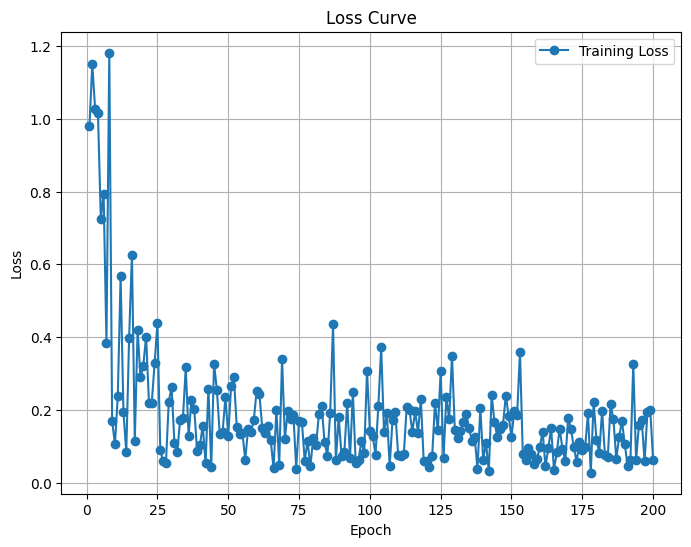

Predicted value for the first sample: 1.8273
Training Loss Scaling Unreversed: 0.14885446429252625
Training Loss Scaling Reversed: 1076.30322265625


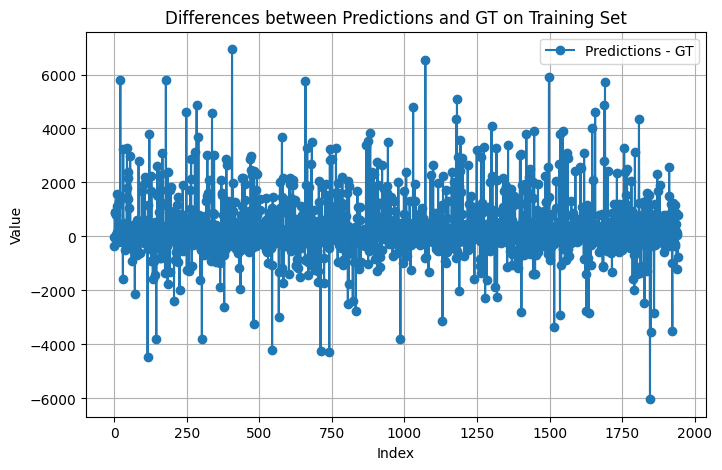

Predicted value for the first sample: 2.9831
Validation Loss Scaling Unreversed: 0.17586925625801086
Validation Loss Scaling Reversed: 1271.6357421875


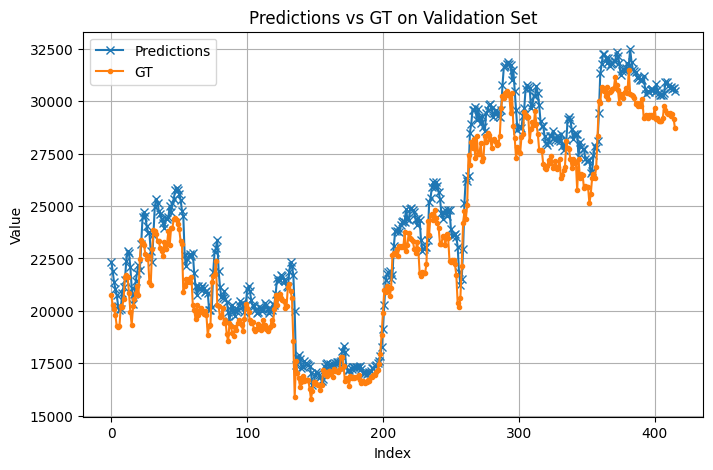

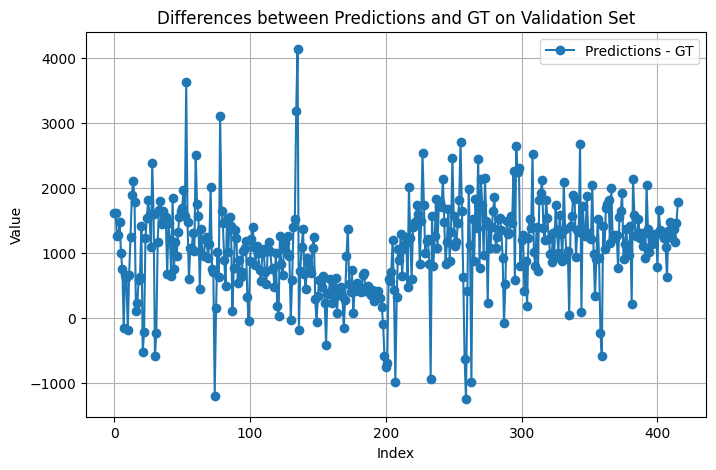

Return: 0.4973337650299072
Max Drawdown: -0.15130285918712616
Epoch [5/200], Loss: 3.0954
Epoch [10/200], Loss: 3.1859
Epoch [15/200], Loss: 2.1861
Epoch [20/200], Loss: 2.6021
Epoch [25/200], Loss: 0.8304
Epoch [30/200], Loss: 2.0315
Epoch [35/200], Loss: 2.1515
Epoch [40/200], Loss: 0.7184
Epoch [45/200], Loss: 1.0697
Epoch [50/200], Loss: 1.6940
Epoch [55/200], Loss: 0.1649
Epoch [60/200], Loss: 1.1757
Epoch [65/200], Loss: 1.2413
Epoch [70/200], Loss: 1.1714
Epoch [75/200], Loss: 0.1195
Epoch [80/200], Loss: 0.7292
Epoch [85/200], Loss: 0.9611
Epoch [90/200], Loss: 1.0838
Epoch [95/200], Loss: 0.8026
Epoch [100/200], Loss: 0.1663
Epoch [105/200], Loss: 0.8939
Epoch [110/200], Loss: 0.7253
Epoch [115/200], Loss: 0.2469
Epoch [120/200], Loss: 0.2454
Epoch [125/200], Loss: 0.5320
Epoch [130/200], Loss: 0.5427
Epoch [135/200], Loss: 0.5117
Epoch [140/200], Loss: 0.1012
Epoch [145/200], Loss: 0.2389
Epoch [150/200], Loss: 0.6432
Epoch [155/200], Loss: 0.0928
Epoch [160/200], Loss: 0.448

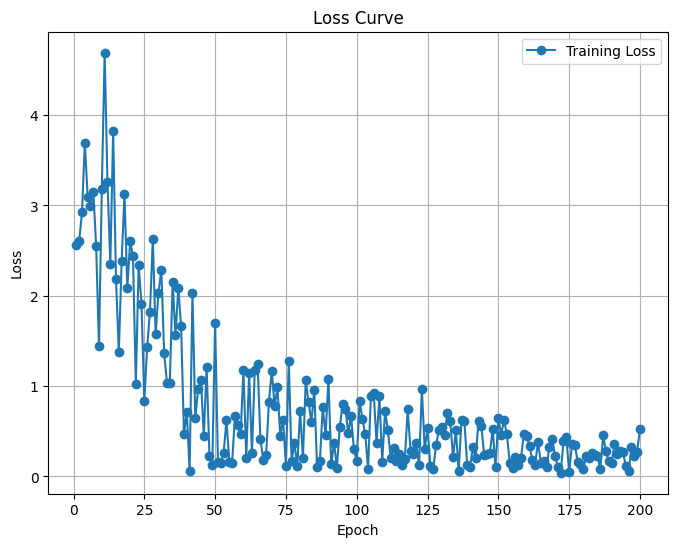

Predicted value for the first sample: 1.9156
Training Loss Scaling Unreversed: 0.2511438727378845
Training Loss Scaling Reversed: 1815.914306640625


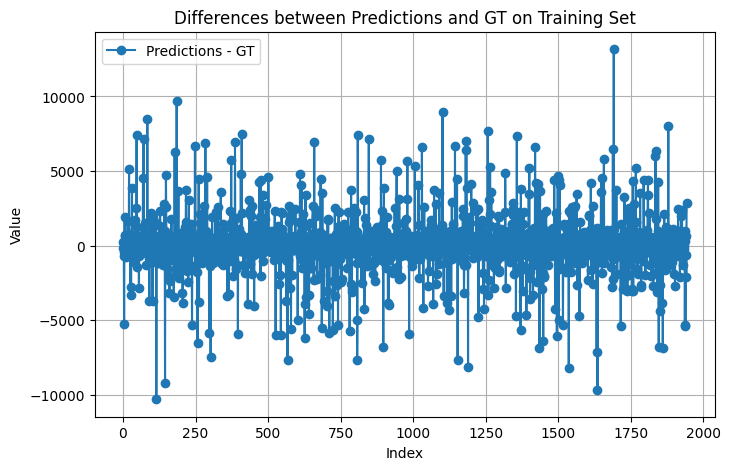

Predicted value for the first sample: 2.9254
Validation Loss Scaling Unreversed: 0.29896053671836853
Validation Loss Scaling Reversed: 2161.65625


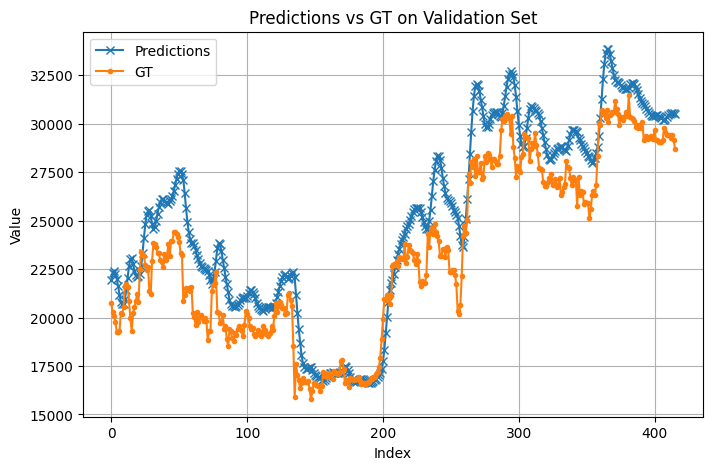

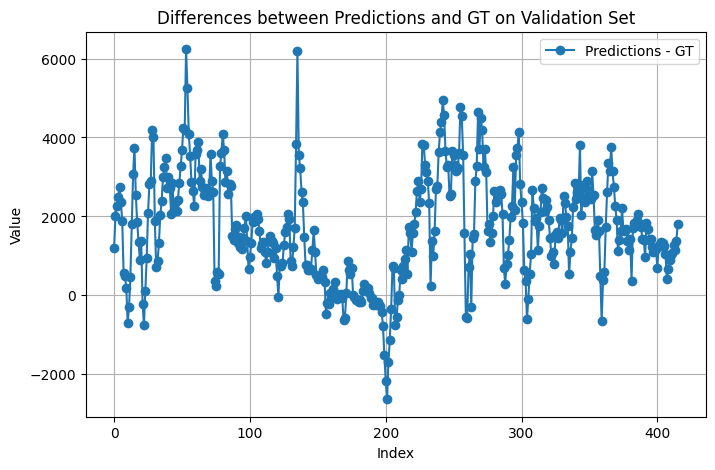

Return: -0.044642508029937744
Max Drawdown: -0.40083208680152893
Epoch [5/200], Loss: 0.3122
Epoch [10/200], Loss: 0.2600
Epoch [15/200], Loss: 0.1278
Epoch [20/200], Loss: 0.0877
Epoch [25/200], Loss: 0.3283
Epoch [30/200], Loss: 0.0709
Epoch [35/200], Loss: 0.0909
Epoch [40/200], Loss: 0.0384
Epoch [45/200], Loss: 0.0433
Epoch [50/200], Loss: 0.0633
Epoch [55/200], Loss: 0.1262
Epoch [60/200], Loss: 0.0822
Epoch [65/200], Loss: 0.0747
Epoch [70/200], Loss: 0.0780
Epoch [75/200], Loss: 0.0428
Epoch [80/200], Loss: 0.0542
Epoch [85/200], Loss: 0.1388
Epoch [90/200], Loss: 0.2187
Epoch [95/200], Loss: 0.0884
Epoch [100/200], Loss: 0.0710
Epoch [105/200], Loss: 0.1051
Epoch [110/200], Loss: 0.1543
Epoch [115/200], Loss: 0.1395
Epoch [120/200], Loss: 0.0891
Epoch [125/200], Loss: 0.1603
Epoch [130/200], Loss: 0.1546
Epoch [135/200], Loss: 0.0836
Epoch [140/200], Loss: 0.3207
Epoch [145/200], Loss: 0.0447
Epoch [150/200], Loss: 0.1981
Epoch [155/200], Loss: 0.1382
Epoch [160/200], Loss: 0.

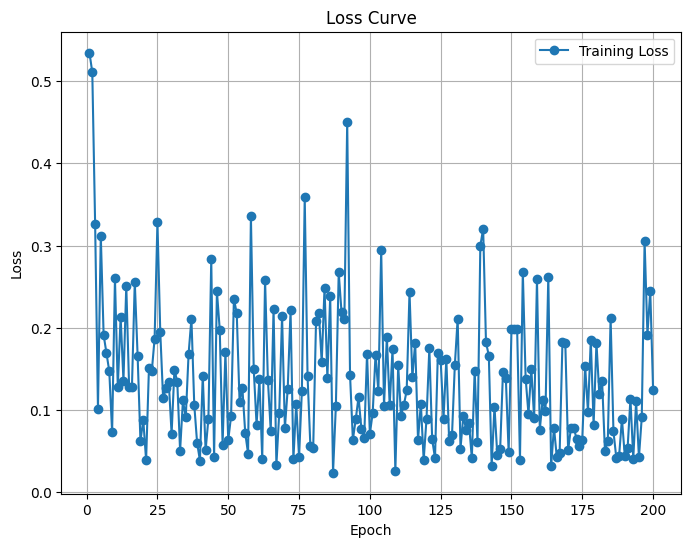

Predicted value for the first sample: 1.8798
Training Loss Scaling Unreversed: 0.13799317181110382
Training Loss Scaling Reversed: 997.7698364257812


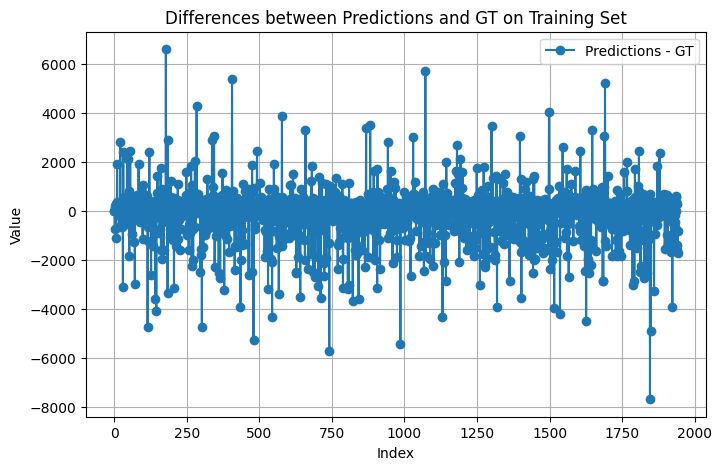

Predicted value for the first sample: 2.6737
Validation Loss Scaling Unreversed: 0.29253247380256653
Validation Loss Scaling Reversed: 2115.177734375


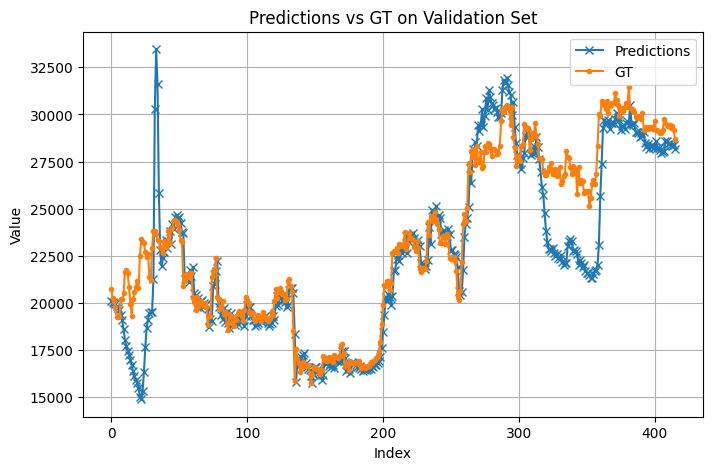

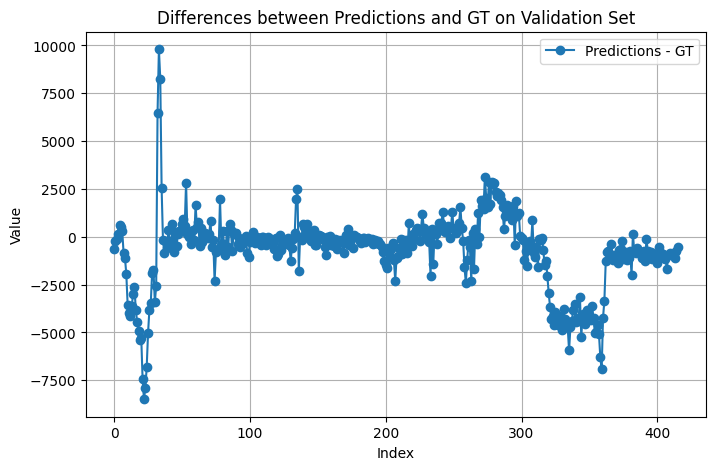

Return: 0.3262779712677002
Max Drawdown: -0.25214749574661255
Epoch [5/200], Loss: 1.1516
Epoch [10/200], Loss: 0.8049
Epoch [15/200], Loss: 0.1243
Epoch [20/200], Loss: 0.2956
Epoch [25/200], Loss: 0.3578
Epoch [30/200], Loss: 0.1110
Epoch [35/200], Loss: 0.3585
Epoch [40/200], Loss: 0.4239
Epoch [45/200], Loss: 0.3102
Epoch [50/200], Loss: 0.0688
Epoch [55/200], Loss: 0.1791
Epoch [60/200], Loss: 0.0799
Epoch [65/200], Loss: 0.0530
Epoch [70/200], Loss: 0.2611
Epoch [75/200], Loss: 0.3207
Epoch [80/200], Loss: 0.2255
Epoch [85/200], Loss: 0.2192
Epoch [90/200], Loss: 0.1138
Epoch [95/200], Loss: 0.2820
Epoch [100/200], Loss: 0.1243
Epoch [105/200], Loss: 0.1793
Epoch [110/200], Loss: 0.1651
Epoch [115/200], Loss: 0.0783
Epoch [120/200], Loss: 0.1343
Epoch [125/200], Loss: 0.1931
Epoch [130/200], Loss: 0.0684
Epoch [135/200], Loss: 0.1723
Epoch [140/200], Loss: 0.2572
Epoch [145/200], Loss: 0.0870
Epoch [150/200], Loss: 0.2900
Epoch [155/200], Loss: 0.1576
Epoch [160/200], Loss: 0.106

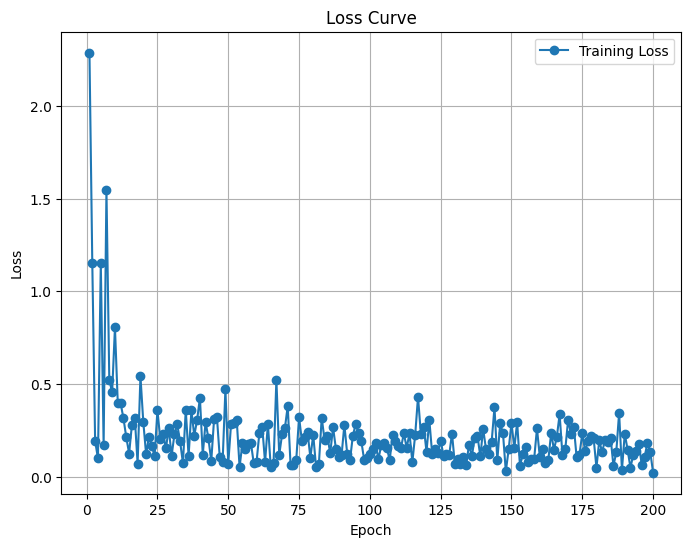

Predicted value for the first sample: 1.8232
Training Loss Scaling Unreversed: 0.15177874267101288
Training Loss Scaling Reversed: 1097.4473876953125


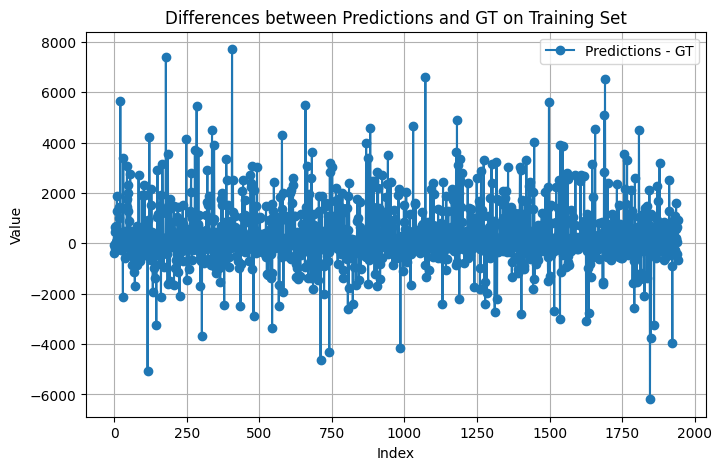

Predicted value for the first sample: 3.0173
Validation Loss Scaling Unreversed: 0.15793845057487488
Validation Loss Scaling Reversed: 1141.9857177734375


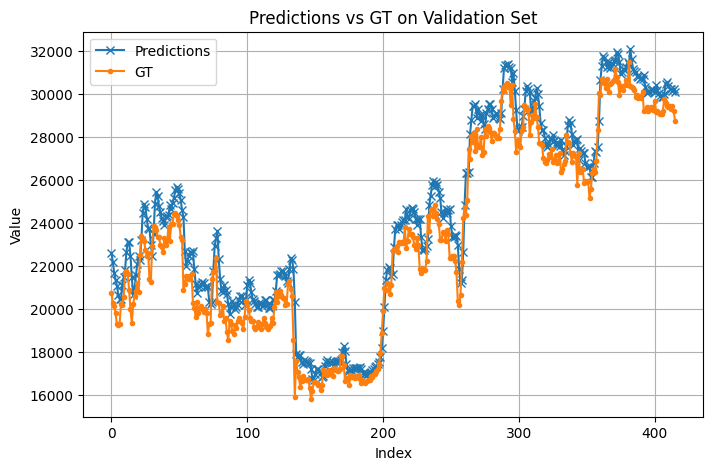

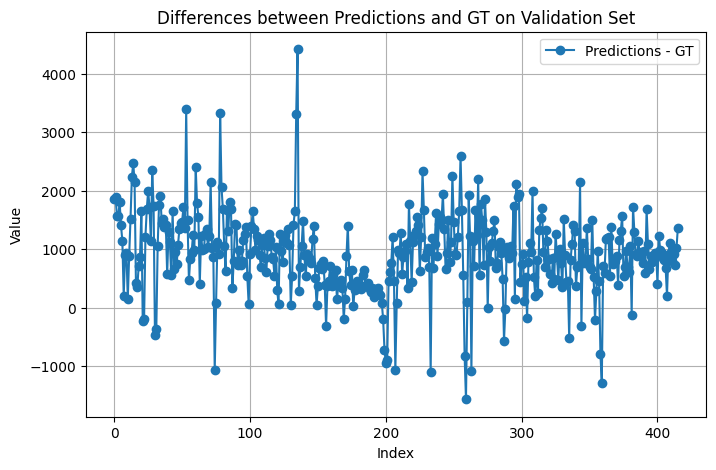

Return: 0.5195450782775879
Max Drawdown: -0.19590768218040466
Epoch [5/200], Loss: 2.3199
Epoch [10/200], Loss: 0.7022
Epoch [15/200], Loss: 3.1272
Epoch [20/200], Loss: 1.5756
Epoch [25/200], Loss: 2.1449
Epoch [30/200], Loss: 1.0703
Epoch [35/200], Loss: 2.3533
Epoch [40/200], Loss: 0.8891
Epoch [45/200], Loss: 1.5484
Epoch [50/200], Loss: 1.4711
Epoch [55/200], Loss: 0.5122
Epoch [60/200], Loss: 0.7360
Epoch [65/200], Loss: 0.1530
Epoch [70/200], Loss: 0.2121
Epoch [75/200], Loss: 0.4220
Epoch [80/200], Loss: 0.7974
Epoch [85/200], Loss: 0.5745
Epoch [90/200], Loss: 0.0997
Epoch [95/200], Loss: 0.4040
Epoch [100/200], Loss: 0.2759
Epoch [105/200], Loss: 0.8449
Epoch [110/200], Loss: 0.1404
Epoch [115/200], Loss: 0.6741
Epoch [120/200], Loss: 0.4060
Epoch [125/200], Loss: 0.3239
Epoch [130/200], Loss: 0.9205
Epoch [135/200], Loss: 0.0941
Epoch [140/200], Loss: 0.1821
Epoch [145/200], Loss: 0.3644
Epoch [150/200], Loss: 0.5922
Epoch [155/200], Loss: 0.2787
Epoch [160/200], Loss: 0.279

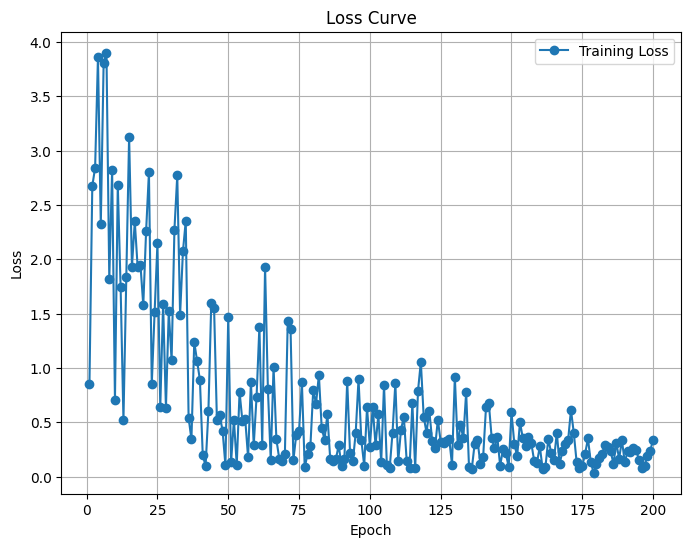

Predicted value for the first sample: 1.9298
Training Loss Scaling Unreversed: 0.24388039112091064
Training Loss Scaling Reversed: 1763.3951416015625


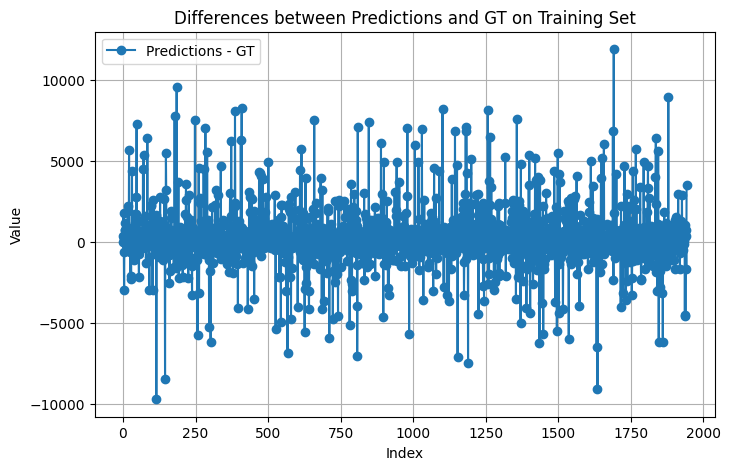

Predicted value for the first sample: 2.9012
Validation Loss Scaling Unreversed: 0.16510380804538727
Validation Loss Scaling Reversed: 1193.79541015625


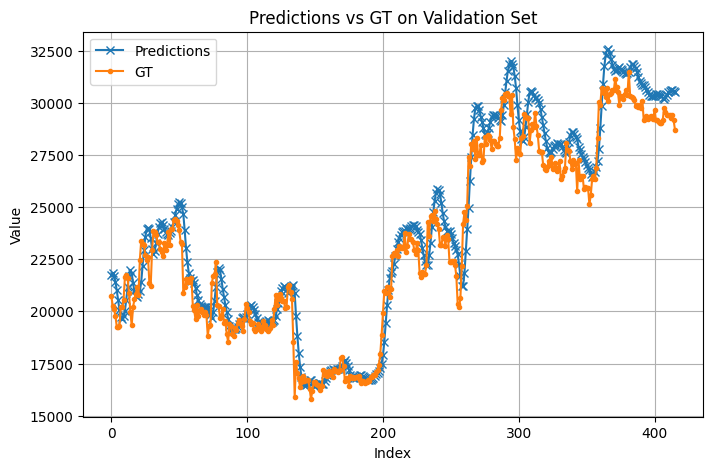

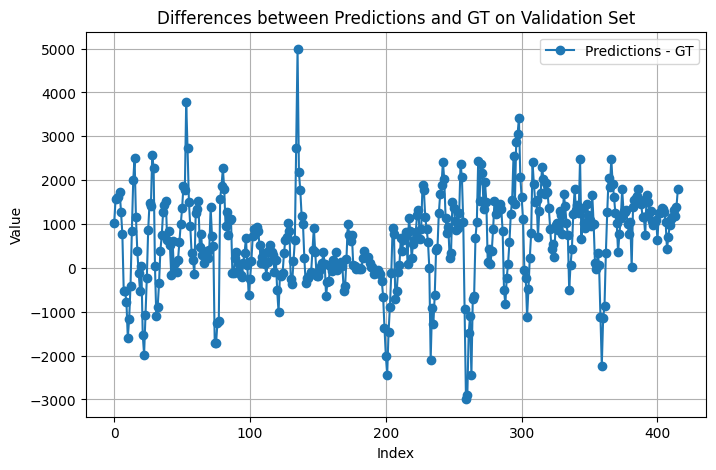

Return: -0.04631400108337402
Max Drawdown: -0.3602282702922821
Epoch [5/200], Loss: 0.4396
Epoch [10/200], Loss: 0.1995
Epoch [15/200], Loss: 0.1078
Epoch [20/200], Loss: 0.1581
Epoch [25/200], Loss: 0.1372
Epoch [30/200], Loss: 0.1362
Epoch [35/200], Loss: 0.1433
Epoch [40/200], Loss: 0.1120
Epoch [45/200], Loss: 0.1549
Epoch [50/200], Loss: 0.1132
Epoch [55/200], Loss: 0.0846
Epoch [60/200], Loss: 0.0840
Epoch [65/200], Loss: 0.1433
Epoch [70/200], Loss: 0.1606
Epoch [75/200], Loss: 0.1453
Epoch [80/200], Loss: 0.2313
Epoch [85/200], Loss: 0.2936
Epoch [90/200], Loss: 0.1195
Epoch [95/200], Loss: 0.0820
Epoch [100/200], Loss: 0.1092
Epoch [105/200], Loss: 0.0948
Epoch [110/200], Loss: 0.0849
Epoch [115/200], Loss: 0.0882
Epoch [120/200], Loss: 0.1922
Epoch [125/200], Loss: 0.1196
Epoch [130/200], Loss: 0.1344
Epoch [135/200], Loss: 0.1167
Epoch [140/200], Loss: 0.1555
Epoch [145/200], Loss: 0.1267
Epoch [150/200], Loss: 0.0964
Epoch [155/200], Loss: 0.1574
Epoch [160/200], Loss: 0.12

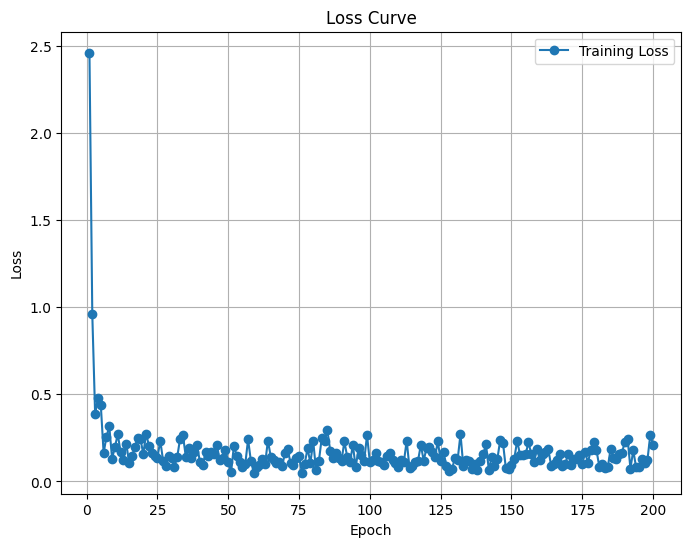

Predicted value for the first sample: 1.8571
Training Loss Scaling Unreversed: 0.13606981933116913
Training Loss Scaling Reversed: 983.8629150390625


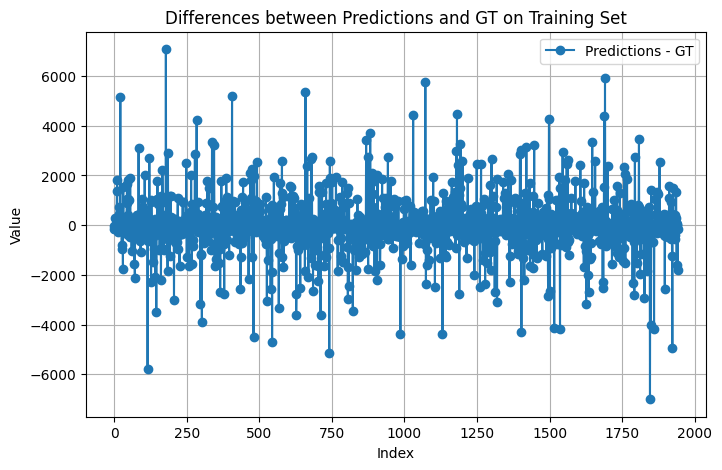

Predicted value for the first sample: 2.9048
Validation Loss Scaling Unreversed: 0.15935060381889343
Validation Loss Scaling Reversed: 1152.1962890625


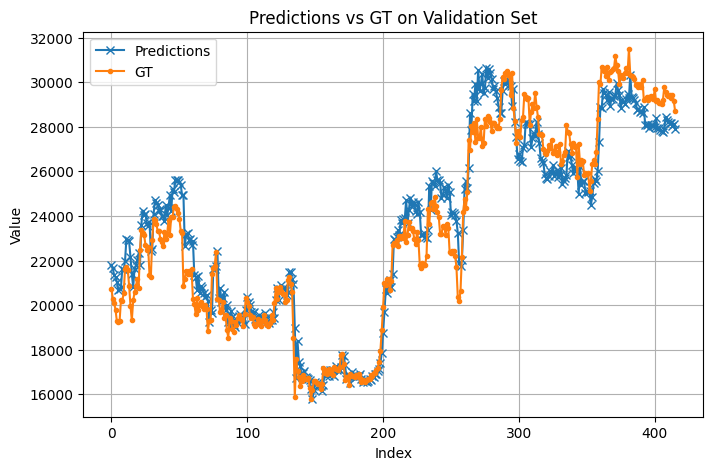

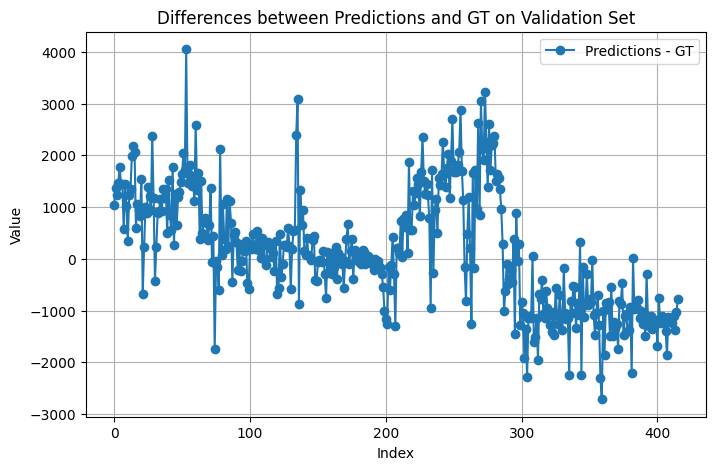

Return: 0.4054502248764038
Max Drawdown: -0.2376376837491989
Epoch [5/200], Loss: 1.7620
Epoch [10/200], Loss: 2.3222
Epoch [15/200], Loss: 1.8752
Epoch [20/200], Loss: 1.1636
Epoch [25/200], Loss: 0.8963
Epoch [30/200], Loss: 0.6585
Epoch [35/200], Loss: 0.4688
Epoch [40/200], Loss: 0.6303
Epoch [45/200], Loss: 0.3951
Epoch [50/200], Loss: 0.5536
Epoch [55/200], Loss: 0.3646
Epoch [60/200], Loss: 0.2020
Epoch [65/200], Loss: 0.2283
Epoch [70/200], Loss: 0.1690
Epoch [75/200], Loss: 0.3002
Epoch [80/200], Loss: 0.2028
Epoch [85/200], Loss: 0.1969
Epoch [90/200], Loss: 0.1220
Epoch [95/200], Loss: 0.1211
Epoch [100/200], Loss: 0.1891
Epoch [105/200], Loss: 0.2083
Epoch [110/200], Loss: 0.2275
Epoch [115/200], Loss: 0.1697
Epoch [120/200], Loss: 0.1282
Epoch [125/200], Loss: 0.0899
Epoch [130/200], Loss: 0.2247
Epoch [135/200], Loss: 0.2554
Epoch [140/200], Loss: 0.3232
Epoch [145/200], Loss: 0.1770
Epoch [150/200], Loss: 0.0903
Epoch [155/200], Loss: 0.2211
Epoch [160/200], Loss: 0.1721

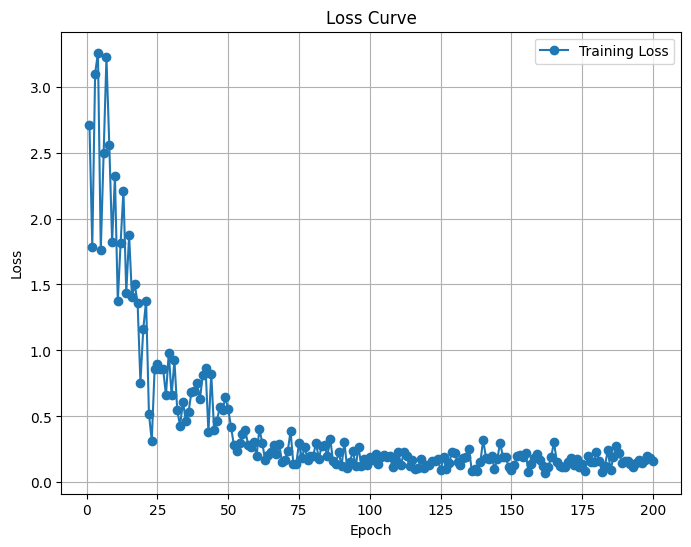

Predicted value for the first sample: 1.7842
Training Loss Scaling Unreversed: 0.1499299257993698
Training Loss Scaling Reversed: 1084.079345703125


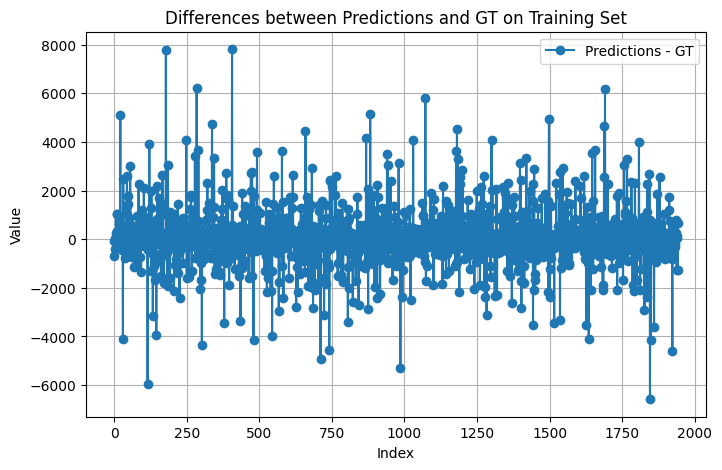

Predicted value for the first sample: 3.0353
Validation Loss Scaling Unreversed: 0.12964783608913422
Validation Loss Scaling Reversed: 937.4283447265625


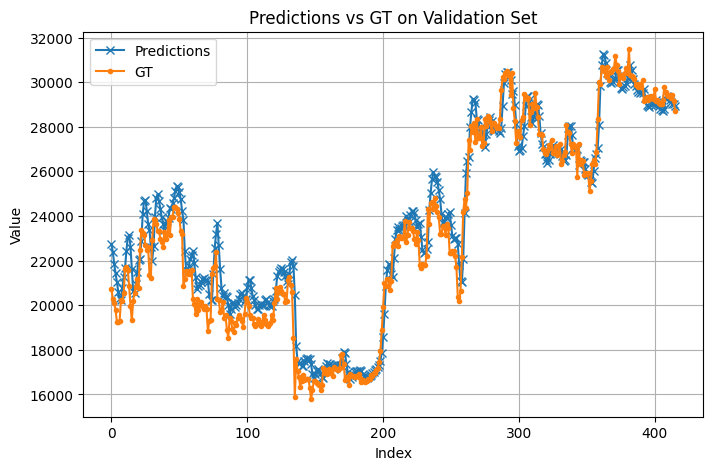

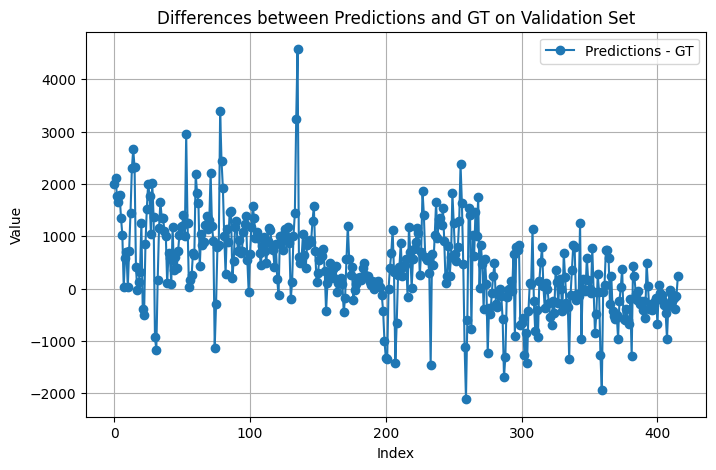

Return: 0.580650806427002
Max Drawdown: -0.15473860502243042
Epoch [5/200], Loss: 3.4676
Epoch [10/200], Loss: 1.8256
Epoch [15/200], Loss: 1.8375
Epoch [20/200], Loss: 3.9931
Epoch [25/200], Loss: 2.8781
Epoch [30/200], Loss: 1.9594
Epoch [35/200], Loss: 3.9736
Epoch [40/200], Loss: 2.8343
Epoch [45/200], Loss: 2.5633
Epoch [50/200], Loss: 1.5474
Epoch [55/200], Loss: 1.1476
Epoch [60/200], Loss: 2.5770
Epoch [65/200], Loss: 2.5207
Epoch [70/200], Loss: 1.7397
Epoch [75/200], Loss: 2.0095
Epoch [80/200], Loss: 1.2536
Epoch [85/200], Loss: 0.9118
Epoch [90/200], Loss: 1.8259
Epoch [95/200], Loss: 1.0494
Epoch [100/200], Loss: 1.8139
Epoch [105/200], Loss: 1.1944
Epoch [110/200], Loss: 1.0095
Epoch [115/200], Loss: 1.4172
Epoch [120/200], Loss: 1.0763
Epoch [125/200], Loss: 1.4191
Epoch [130/200], Loss: 1.4611
Epoch [135/200], Loss: 0.9183
Epoch [140/200], Loss: 1.1270
Epoch [145/200], Loss: 0.5208
Epoch [150/200], Loss: 1.0994
Epoch [155/200], Loss: 0.9741
Epoch [160/200], Loss: 0.8944

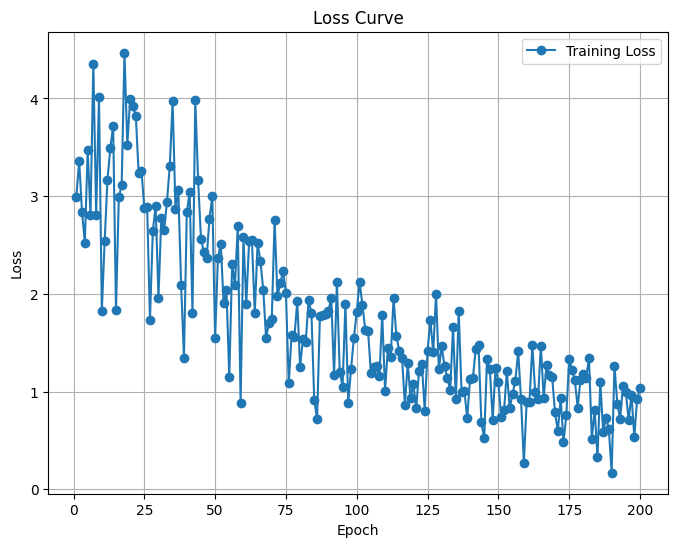

Predicted value for the first sample: 2.1077
Training Loss Scaling Unreversed: 0.8757311105728149
Training Loss Scaling Reversed: 6332.0380859375


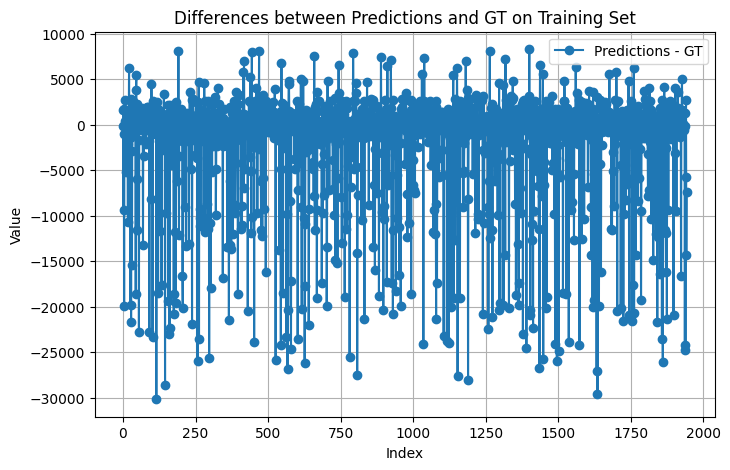

Predicted value for the first sample: 2.8026
Validation Loss Scaling Unreversed: 0.2332514375448227
Validation Loss Scaling Reversed: 1686.5418701171875


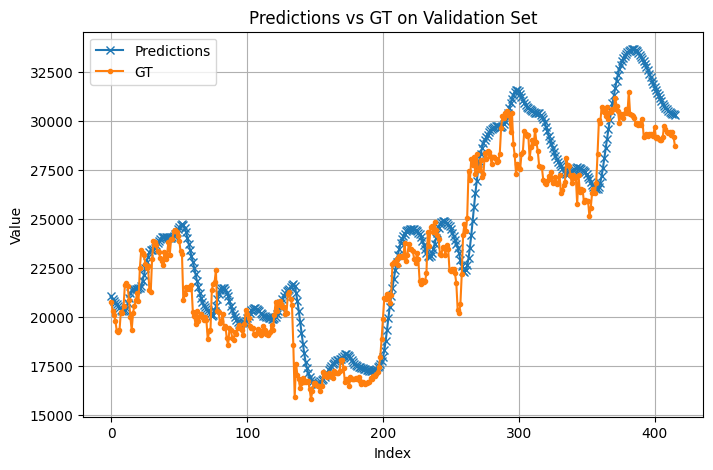

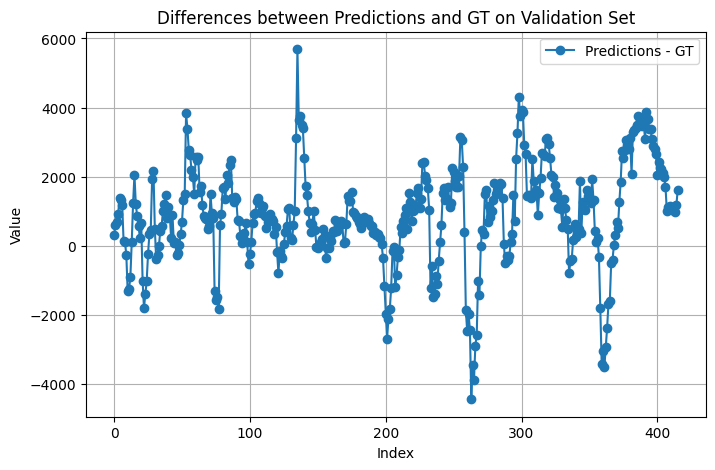

Return: 0.3488774299621582
Max Drawdown: -0.2318403720855713
Epoch [5/200], Loss: 0.4323
Epoch [10/200], Loss: 0.3256
Epoch [15/200], Loss: 0.1261
Epoch [20/200], Loss: 0.1216
Epoch [25/200], Loss: 0.0907
Epoch [30/200], Loss: 0.1803
Epoch [35/200], Loss: 0.0930
Epoch [40/200], Loss: 0.1743
Epoch [45/200], Loss: 0.1582
Epoch [50/200], Loss: 0.1310
Epoch [55/200], Loss: 0.1107
Epoch [60/200], Loss: 0.2273
Epoch [65/200], Loss: 0.1526
Epoch [70/200], Loss: 0.1693
Epoch [75/200], Loss: 0.1527
Epoch [80/200], Loss: 0.1998
Epoch [85/200], Loss: 0.1785
Epoch [90/200], Loss: 0.1960
Epoch [95/200], Loss: 0.0862
Epoch [100/200], Loss: 0.1457
Epoch [105/200], Loss: 0.0905
Epoch [110/200], Loss: 0.1952
Epoch [115/200], Loss: 0.1547
Epoch [120/200], Loss: 0.1925
Epoch [125/200], Loss: 0.1056
Epoch [130/200], Loss: 0.1305
Epoch [135/200], Loss: 0.1609
Epoch [140/200], Loss: 0.1117
Epoch [145/200], Loss: 0.1349
Epoch [150/200], Loss: 0.0751
Epoch [155/200], Loss: 0.1265
Epoch [160/200], Loss: 0.2005

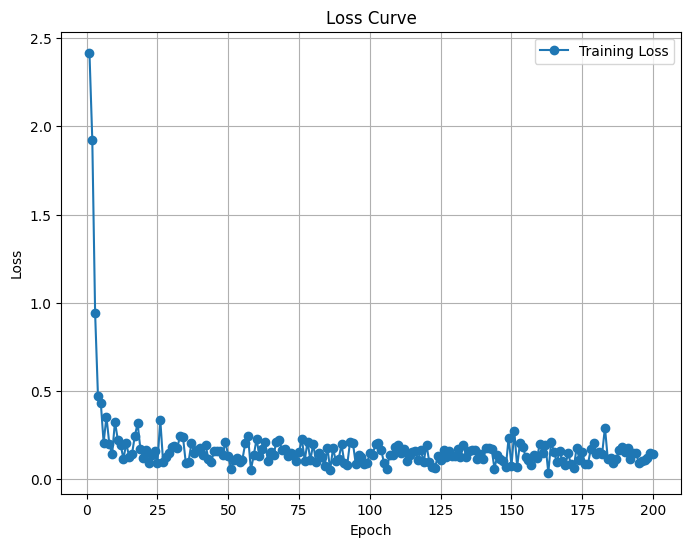

Predicted value for the first sample: 1.9010
Training Loss Scaling Unreversed: 0.14748047292232513
Training Loss Scaling Reversed: 1066.3685302734375


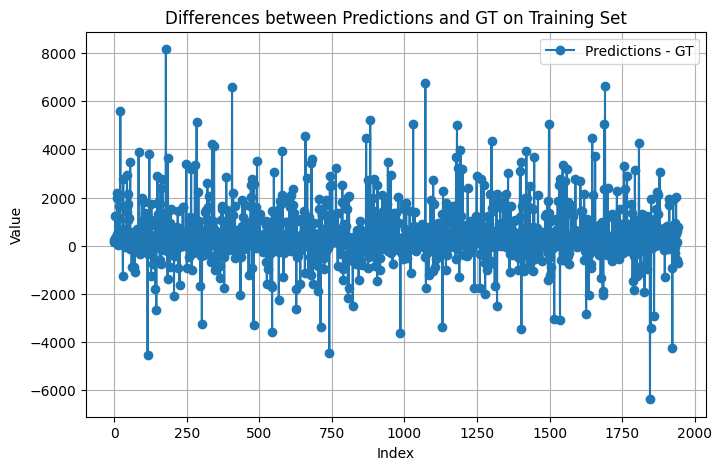

Predicted value for the first sample: 2.8008
Validation Loss Scaling Unreversed: 0.14521503448486328
Validation Loss Scaling Reversed: 1049.988037109375


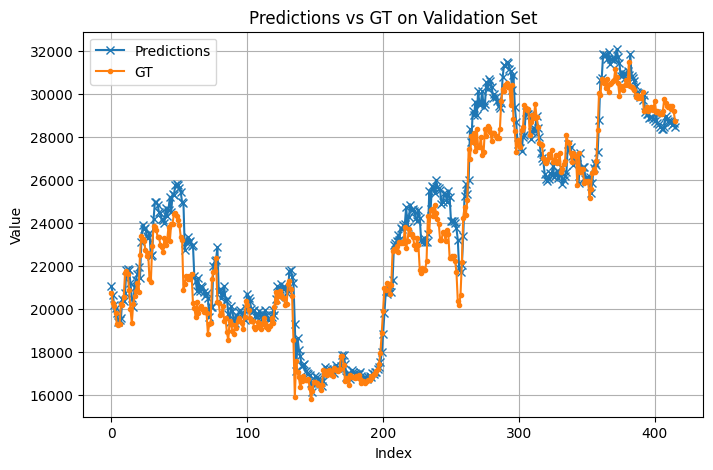

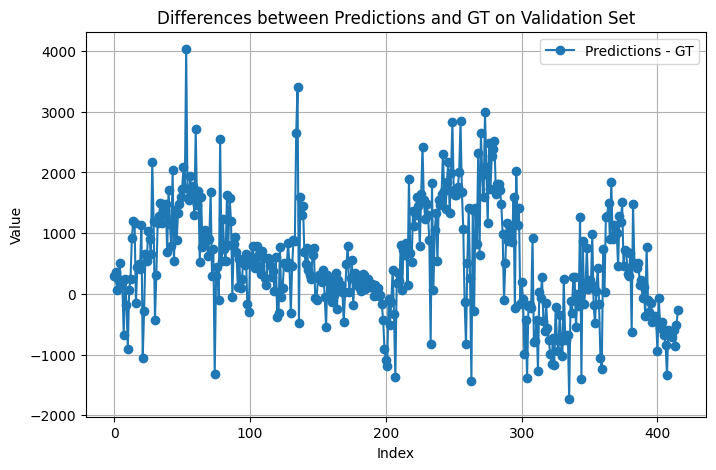

Return: 0.44952094554901123
Max Drawdown: -0.22944067418575287
Epoch [5/200], Loss: 2.8074
Epoch [10/200], Loss: 1.5176
Epoch [15/200], Loss: 0.6961
Epoch [20/200], Loss: 0.8554
Epoch [25/200], Loss: 0.7762
Epoch [30/200], Loss: 0.8237
Epoch [35/200], Loss: 0.7894
Epoch [40/200], Loss: 0.3920
Epoch [45/200], Loss: 0.5148
Epoch [50/200], Loss: 0.3327
Epoch [55/200], Loss: 0.1458
Epoch [60/200], Loss: 0.3542
Epoch [65/200], Loss: 0.2856
Epoch [70/200], Loss: 0.3668
Epoch [75/200], Loss: 0.2289
Epoch [80/200], Loss: 0.1908
Epoch [85/200], Loss: 0.0944
Epoch [90/200], Loss: 0.2713
Epoch [95/200], Loss: 0.1730
Epoch [100/200], Loss: 0.2771
Epoch [105/200], Loss: 0.1818
Epoch [110/200], Loss: 0.1233
Epoch [115/200], Loss: 0.1308
Epoch [120/200], Loss: 0.2322
Epoch [125/200], Loss: 0.1772
Epoch [130/200], Loss: 0.2861
Epoch [135/200], Loss: 0.2362
Epoch [140/200], Loss: 0.2859
Epoch [145/200], Loss: 0.2576
Epoch [150/200], Loss: 0.2813
Epoch [155/200], Loss: 0.1120
Epoch [160/200], Loss: 0.11

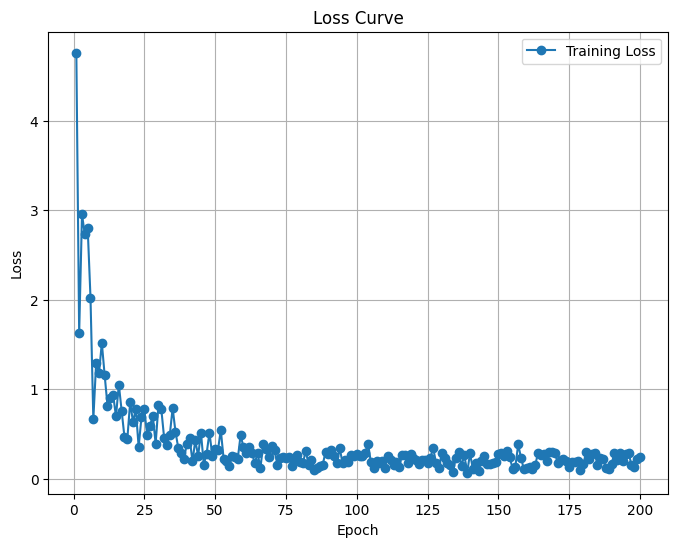

Predicted value for the first sample: 1.9157
Training Loss Scaling Unreversed: 0.19405236840248108
Training Loss Scaling Reversed: 1403.1099853515625


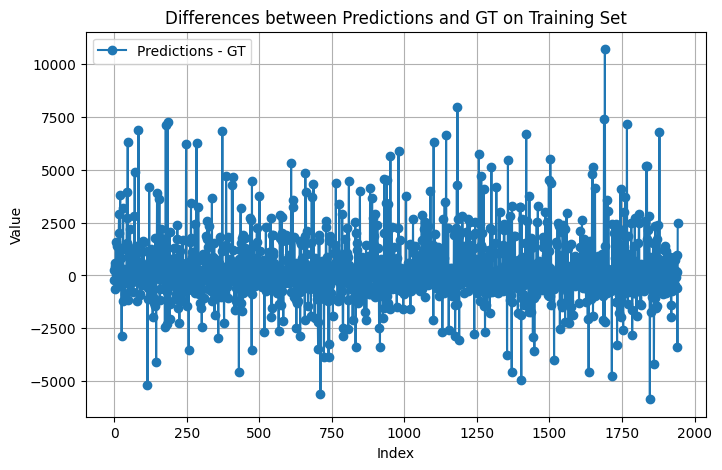

Predicted value for the first sample: 3.0765
Validation Loss Scaling Unreversed: 0.29258179664611816
Validation Loss Scaling Reversed: 2115.5341796875


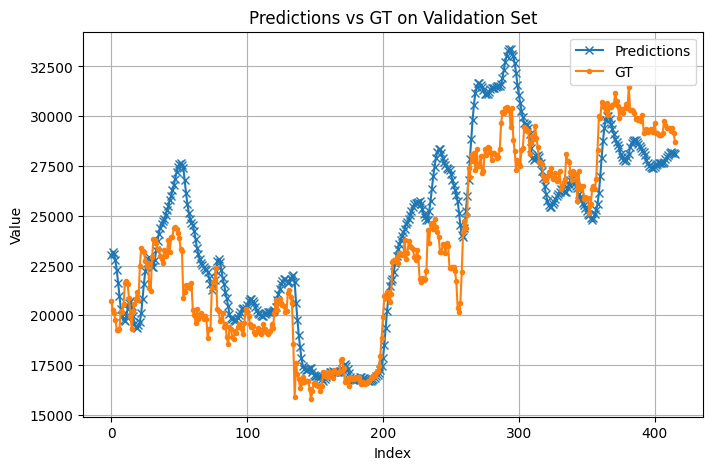

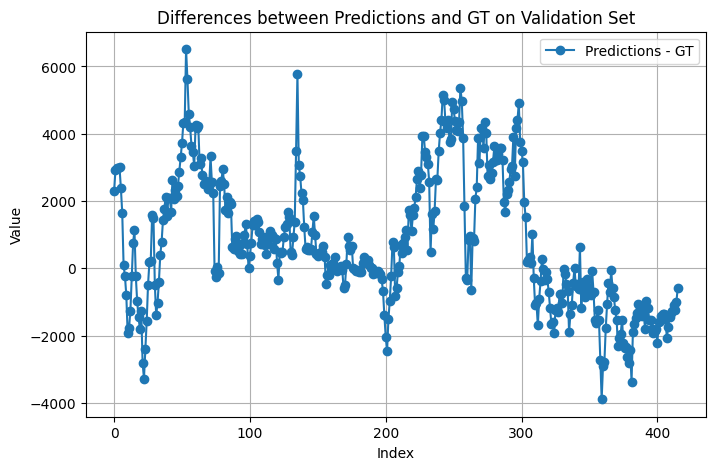

Return: 0.07322835922241211
Max Drawdown: -0.29680266976356506
Epoch [5/200], Loss: 3.4771
Epoch [10/200], Loss: 3.1603
Epoch [15/200], Loss: 3.1485
Epoch [20/200], Loss: 3.3747
Epoch [25/200], Loss: 2.8283
Epoch [30/200], Loss: 2.7791
Epoch [35/200], Loss: 3.0671
Epoch [40/200], Loss: 3.0192
Epoch [45/200], Loss: 1.7104
Epoch [50/200], Loss: 2.2784
Epoch [55/200], Loss: 1.9015
Epoch [60/200], Loss: 1.8258
Epoch [65/200], Loss: 1.9906
Epoch [70/200], Loss: 2.1908
Epoch [75/200], Loss: 1.3904
Epoch [80/200], Loss: 1.2669
Epoch [85/200], Loss: 2.2241
Epoch [90/200], Loss: 0.7214
Epoch [95/200], Loss: 1.1819
Epoch [100/200], Loss: 1.9798
Epoch [105/200], Loss: 1.5168
Epoch [110/200], Loss: 1.2735
Epoch [115/200], Loss: 0.9554
Epoch [120/200], Loss: 1.2096
Epoch [125/200], Loss: 1.3496
Epoch [130/200], Loss: 1.2057
Epoch [135/200], Loss: 1.0203
Epoch [140/200], Loss: 1.3889
Epoch [145/200], Loss: 1.4486
Epoch [150/200], Loss: 1.5570
Epoch [155/200], Loss: 1.2488
Epoch [160/200], Loss: 1.52

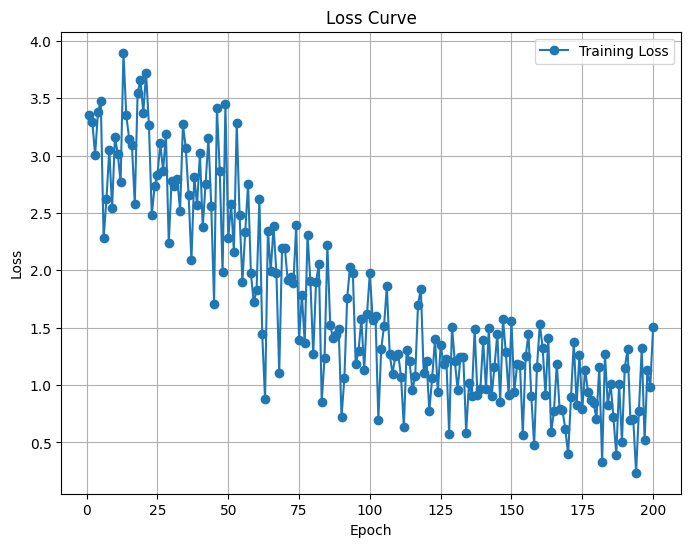

Predicted value for the first sample: 1.9273
Training Loss Scaling Unreversed: 0.8801938891410828
Training Loss Scaling Reversed: 6364.306640625


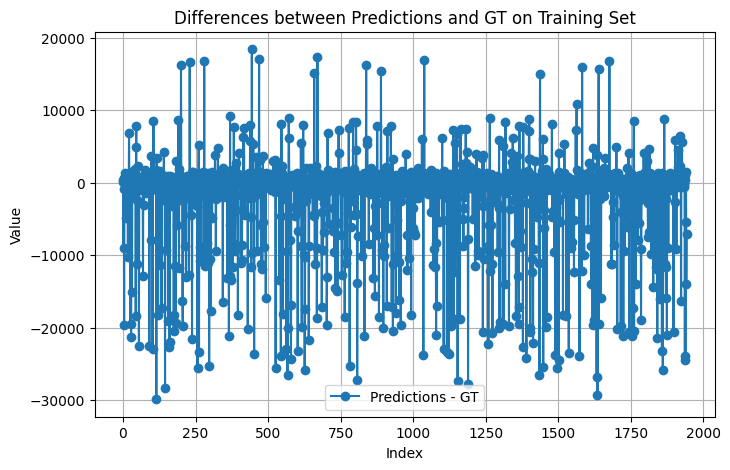

Predicted value for the first sample: 5.0326
Validation Loss Scaling Unreversed: 1.7927082777023315
Validation Loss Scaling Reversed: 12962.310546875


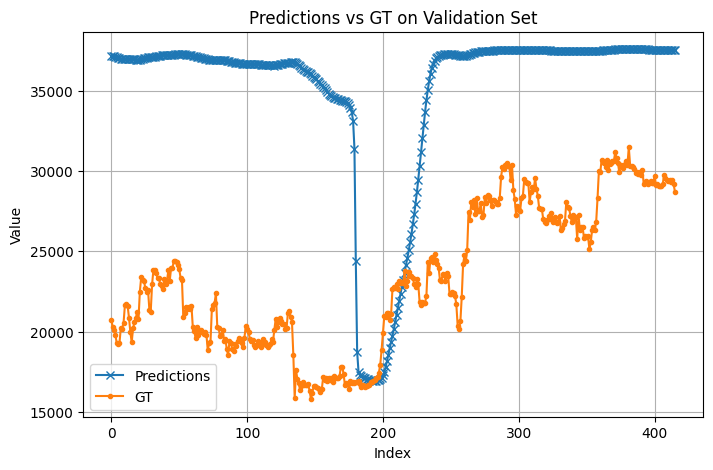

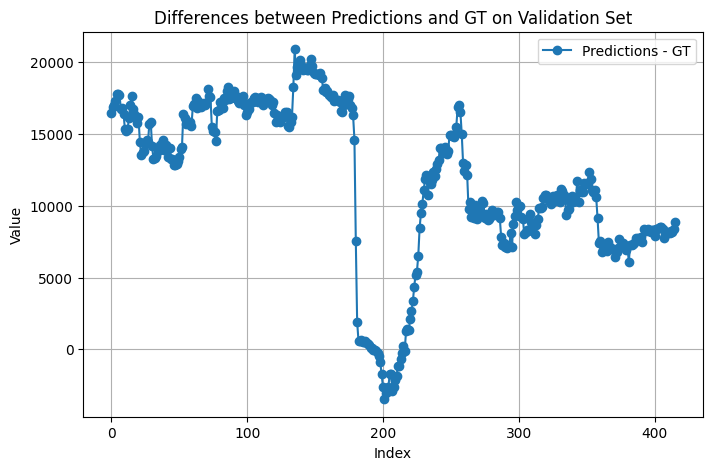

Return: 0.2131587266921997
Max Drawdown: -0.23891758918762207
Epoch [5/200], Loss: 0.2493
Epoch [10/200], Loss: 0.3162
Epoch [15/200], Loss: 0.1936
Epoch [20/200], Loss: 0.1631
Epoch [25/200], Loss: 0.2262
Epoch [30/200], Loss: 0.0941
Epoch [35/200], Loss: 0.1595
Epoch [40/200], Loss: 0.1499
Epoch [45/200], Loss: 0.2560
Epoch [50/200], Loss: 0.1537
Epoch [55/200], Loss: 0.1661
Epoch [60/200], Loss: 0.1576
Epoch [65/200], Loss: 0.2324
Epoch [70/200], Loss: 0.1118
Epoch [75/200], Loss: 0.1828
Epoch [80/200], Loss: 0.1865
Epoch [85/200], Loss: 0.1269
Epoch [90/200], Loss: 0.2089
Epoch [95/200], Loss: 0.1265
Epoch [100/200], Loss: 0.1701
Epoch [105/200], Loss: 0.1903
Epoch [110/200], Loss: 0.1818
Epoch [115/200], Loss: 0.1231
Epoch [120/200], Loss: 0.1488
Epoch [125/200], Loss: 0.1562
Epoch [130/200], Loss: 0.1812
Epoch [135/200], Loss: 0.1219
Epoch [140/200], Loss: 0.1471
Epoch [145/200], Loss: 0.2432
Epoch [150/200], Loss: 0.1331
Epoch [155/200], Loss: 0.1292
Epoch [160/200], Loss: 0.116

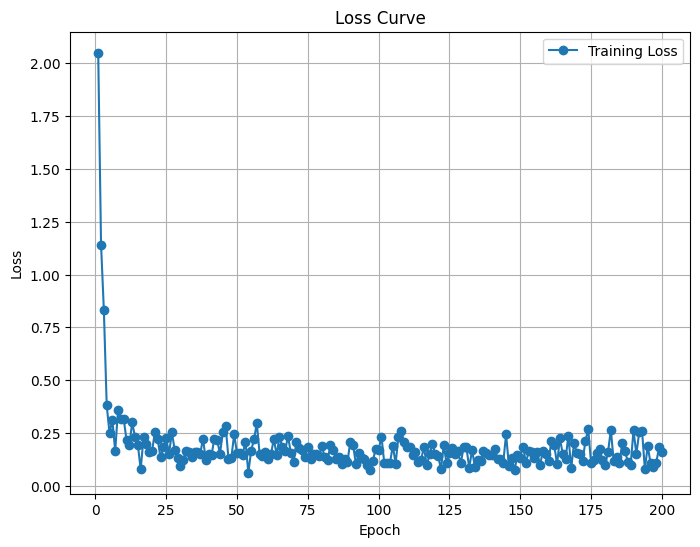

Predicted value for the first sample: 1.8495
Training Loss Scaling Unreversed: 0.1714346557855606
Training Loss Scaling Reversed: 1239.571044921875


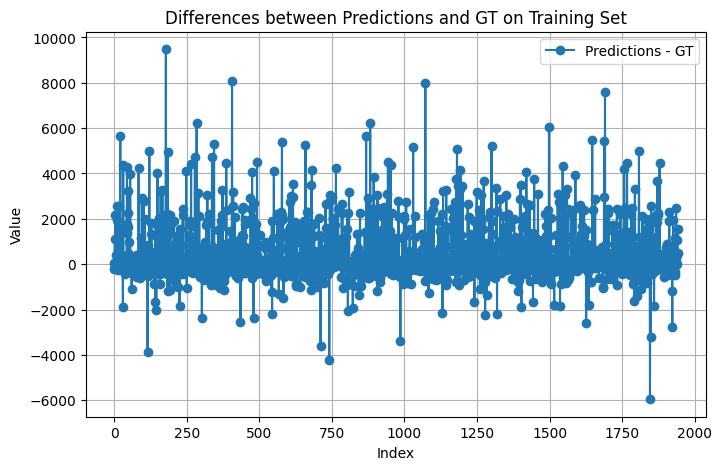

Predicted value for the first sample: 2.9454
Validation Loss Scaling Unreversed: 0.35288602113723755
Validation Loss Scaling Reversed: 2551.56884765625


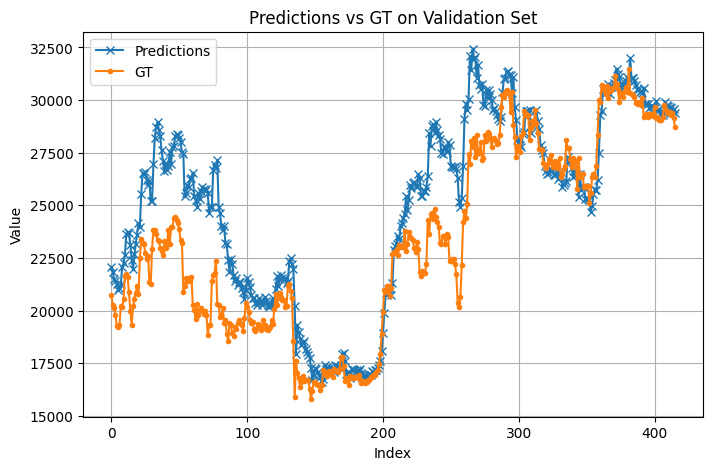

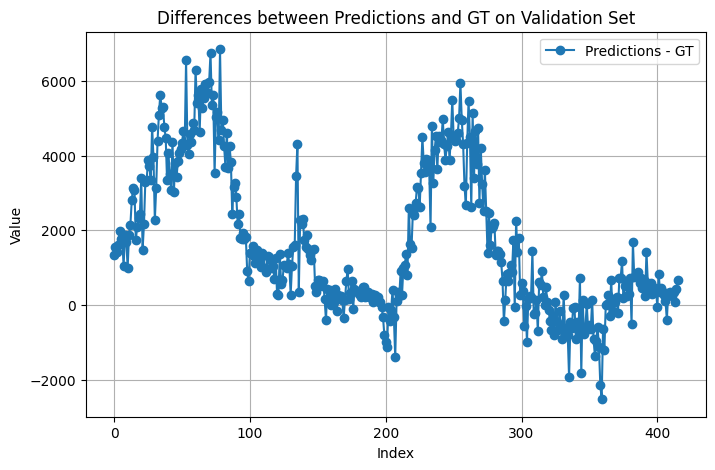

Return: 0.35391759872436523
Max Drawdown: -0.2417144775390625
Epoch [5/200], Loss: 3.2528
Epoch [10/200], Loss: 1.9071
Epoch [15/200], Loss: 0.8737
Epoch [20/200], Loss: 0.9103
Epoch [25/200], Loss: 0.3401
Epoch [30/200], Loss: 0.5311
Epoch [35/200], Loss: 0.3212
Epoch [40/200], Loss: 0.3612
Epoch [45/200], Loss: 0.1869
Epoch [50/200], Loss: 0.3023
Epoch [55/200], Loss: 0.4142
Epoch [60/200], Loss: 0.3990
Epoch [65/200], Loss: 0.1854
Epoch [70/200], Loss: 0.3082
Epoch [75/200], Loss: 0.2404
Epoch [80/200], Loss: 0.2869
Epoch [85/200], Loss: 0.3318
Epoch [90/200], Loss: 0.1689
Epoch [95/200], Loss: 0.1941
Epoch [100/200], Loss: 0.2185
Epoch [105/200], Loss: 0.3035
Epoch [110/200], Loss: 0.3353
Epoch [115/200], Loss: 0.1201
Epoch [120/200], Loss: 0.1883
Epoch [125/200], Loss: 0.1533
Epoch [130/200], Loss: 0.2178
Epoch [135/200], Loss: 0.1704
Epoch [140/200], Loss: 0.1289
Epoch [145/200], Loss: 0.2081
Epoch [150/200], Loss: 0.1425
Epoch [155/200], Loss: 0.1221
Epoch [160/200], Loss: 0.157

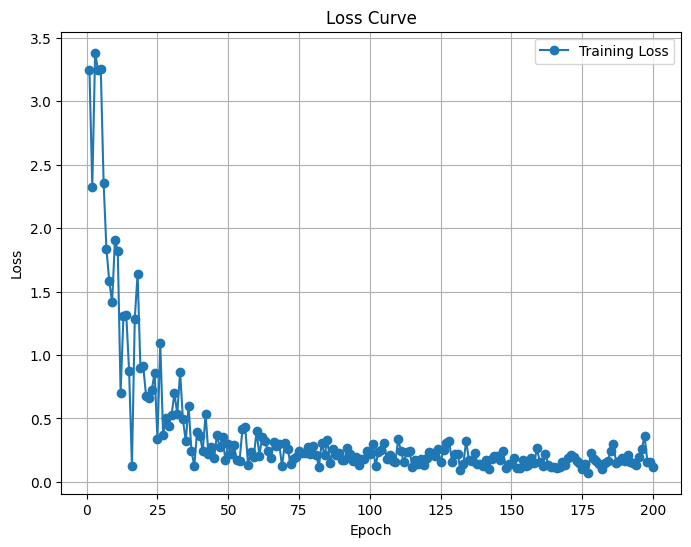

Predicted value for the first sample: 1.8070
Training Loss Scaling Unreversed: 0.1597757637500763
Training Loss Scaling Reversed: 1155.2705078125


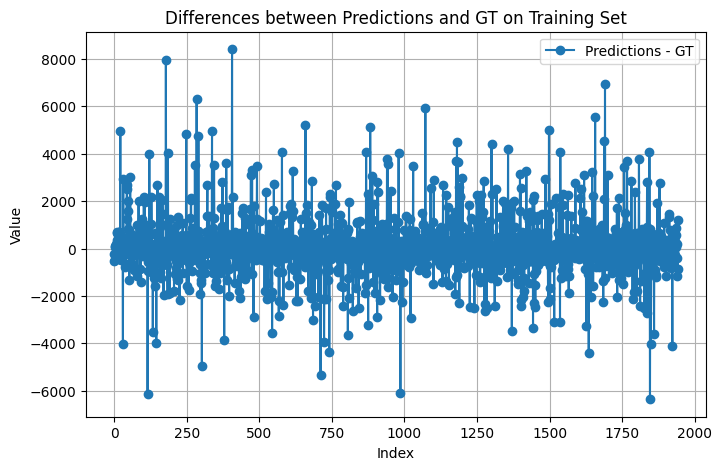

Predicted value for the first sample: 2.9592
Validation Loss Scaling Unreversed: 0.11477247625589371
Validation Loss Scaling Reversed: 829.8709106445312


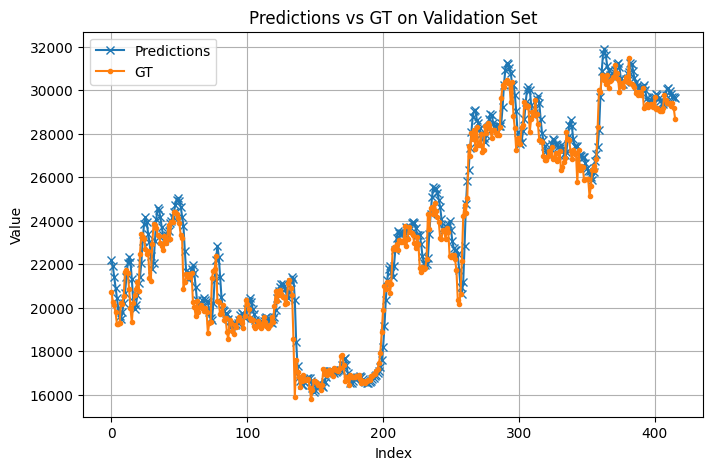

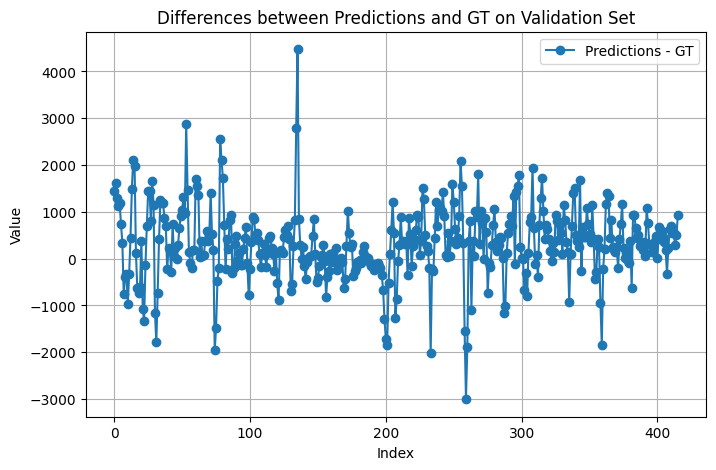

Return: 0.5189226865768433
Max Drawdown: -0.22937609255313873
Epoch [5/200], Loss: 2.4210
Epoch [10/200], Loss: 3.1455
Epoch [15/200], Loss: 4.4212
Epoch [20/200], Loss: 2.6770
Epoch [25/200], Loss: 2.7689
Epoch [30/200], Loss: 2.8499
Epoch [35/200], Loss: 3.0133
Epoch [40/200], Loss: 3.5027
Epoch [45/200], Loss: 2.1497
Epoch [50/200], Loss: 2.1672
Epoch [55/200], Loss: 3.0081
Epoch [60/200], Loss: 2.4936
Epoch [65/200], Loss: 1.9496
Epoch [70/200], Loss: 2.5128
Epoch [75/200], Loss: 1.7407
Epoch [80/200], Loss: 2.0033
Epoch [85/200], Loss: 2.5716
Epoch [90/200], Loss: 1.5746
Epoch [95/200], Loss: 1.8376
Epoch [100/200], Loss: 1.9893
Epoch [105/200], Loss: 1.4126
Epoch [110/200], Loss: 1.8629
Epoch [115/200], Loss: 1.4603
Epoch [120/200], Loss: 1.7546
Epoch [125/200], Loss: 1.7058
Epoch [130/200], Loss: 1.3048
Epoch [135/200], Loss: 2.1887
Epoch [140/200], Loss: 2.1052
Epoch [145/200], Loss: 1.3937
Epoch [150/200], Loss: 0.7212
Epoch [155/200], Loss: 0.9013
Epoch [160/200], Loss: 1.913

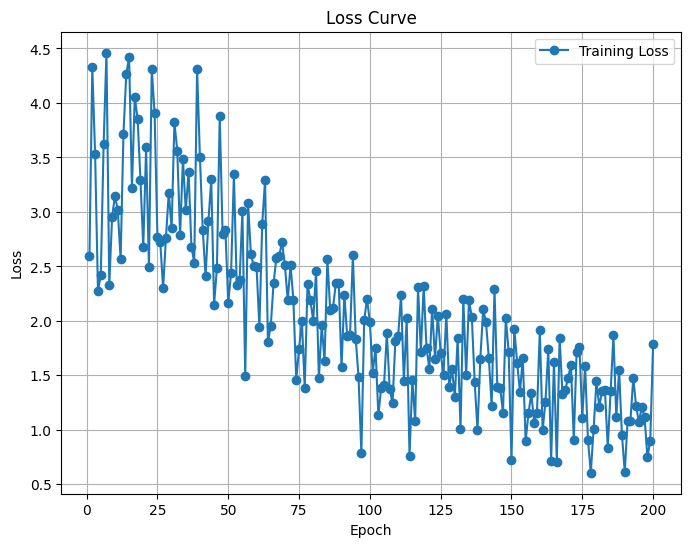

Predicted value for the first sample: 2.0068
Training Loss Scaling Unreversed: 1.1803022623062134
Training Loss Scaling Reversed: 8534.2626953125


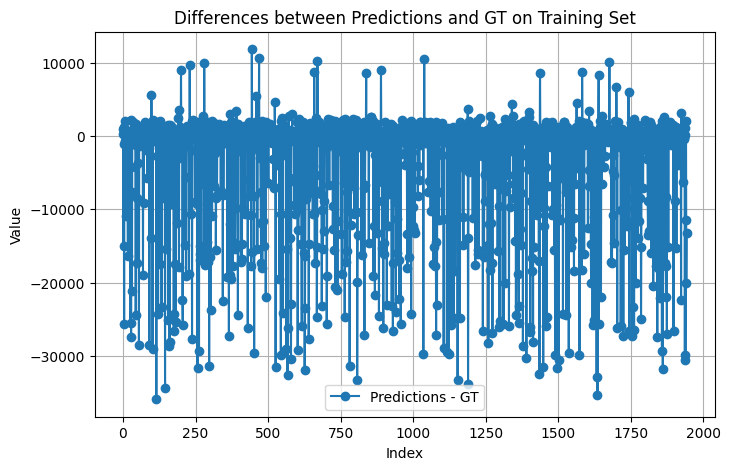

Predicted value for the first sample: 3.9752
Validation Loss Scaling Unreversed: 0.5769883394241333
Validation Loss Scaling Reversed: 4171.95751953125


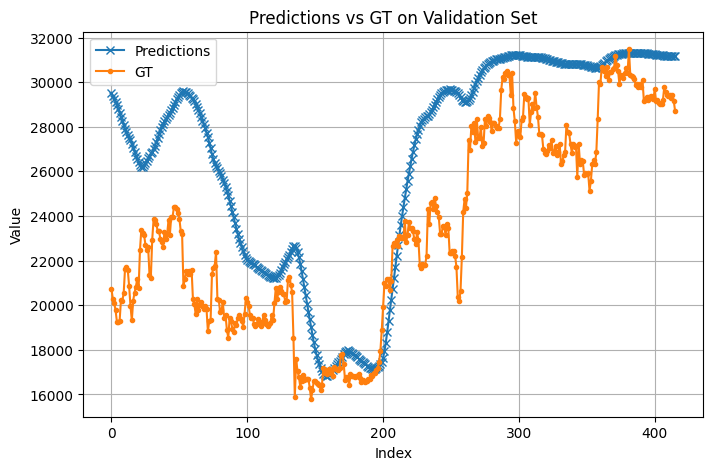

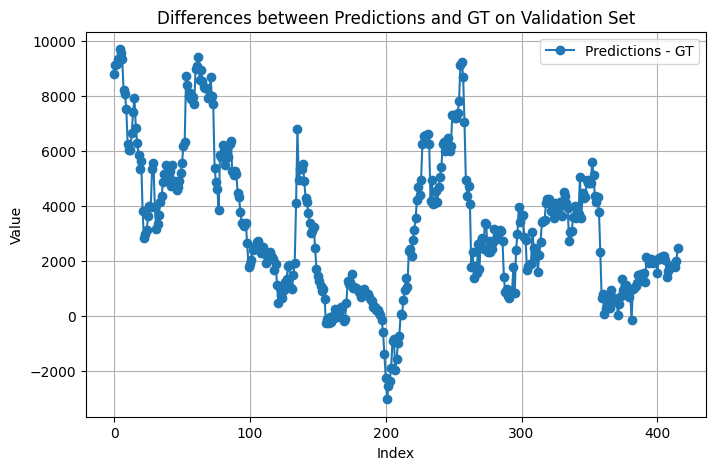

Return: 0.03314340114593506
Max Drawdown: -0.34193721413612366
Epoch [5/200], Loss: 0.6628
Epoch [10/200], Loss: 0.2139
Epoch [15/200], Loss: 0.3125
Epoch [20/200], Loss: 0.1321
Epoch [25/200], Loss: 0.1285
Epoch [30/200], Loss: 0.2240
Epoch [35/200], Loss: 0.2756
Epoch [40/200], Loss: 0.1390
Epoch [45/200], Loss: 0.1469
Epoch [50/200], Loss: 0.1200
Epoch [55/200], Loss: 0.1244
Epoch [60/200], Loss: 0.1380
Epoch [65/200], Loss: 0.1722
Epoch [70/200], Loss: 0.1679
Epoch [75/200], Loss: 0.1649
Epoch [80/200], Loss: 0.0671
Epoch [85/200], Loss: 0.1192
Epoch [90/200], Loss: 0.1123
Epoch [95/200], Loss: 0.1827
Epoch [100/200], Loss: 0.2024
Epoch [105/200], Loss: 0.1342
Epoch [110/200], Loss: 0.0920
Epoch [115/200], Loss: 0.1271
Epoch [120/200], Loss: 0.1461
Epoch [125/200], Loss: 0.1407
Epoch [130/200], Loss: 0.1591
Epoch [135/200], Loss: 0.1453
Epoch [140/200], Loss: 0.1514
Epoch [145/200], Loss: 0.1182
Epoch [150/200], Loss: 0.0930
Epoch [155/200], Loss: 0.1319
Epoch [160/200], Loss: 0.16

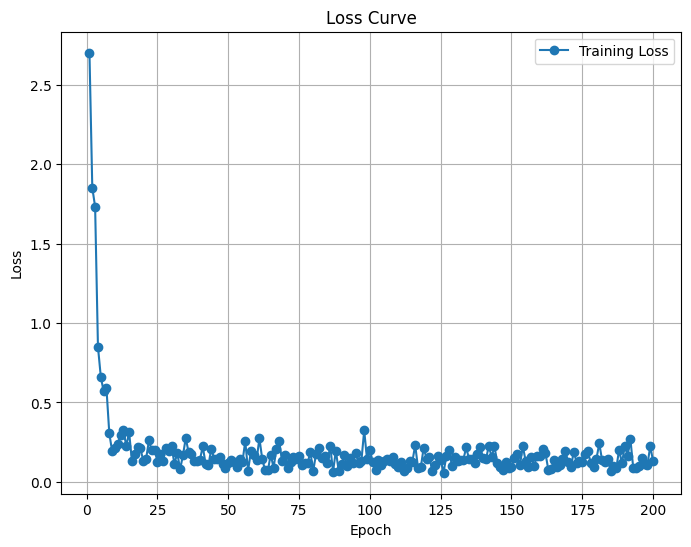

Predicted value for the first sample: 1.8870
Training Loss Scaling Unreversed: 0.13998273015022278
Training Loss Scaling Reversed: 1012.1554565429688


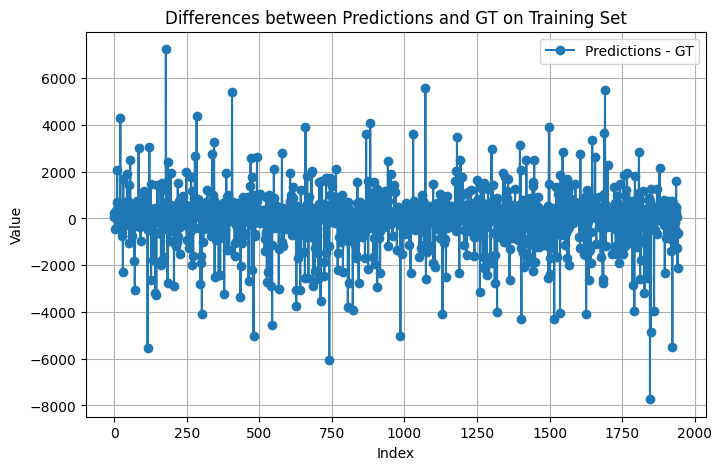

Predicted value for the first sample: 2.9680
Validation Loss Scaling Unreversed: 0.1406601369380951
Validation Loss Scaling Reversed: 1017.0535888671875


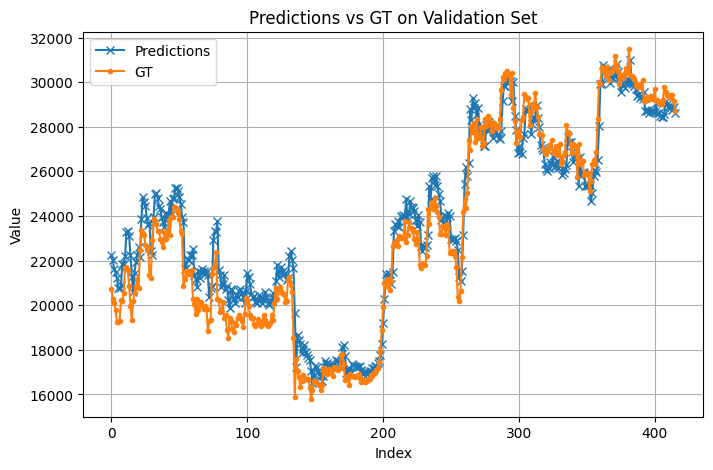

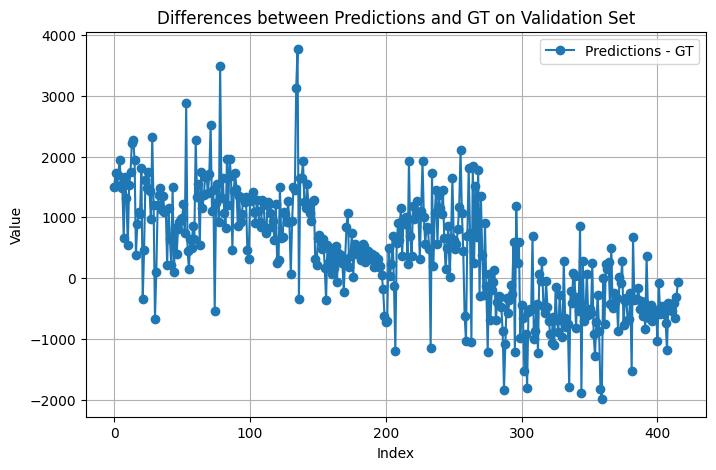

Return: 0.34892916679382324
Max Drawdown: -0.2470567524433136
Epoch [5/200], Loss: 3.6412
Epoch [10/200], Loss: 3.2718
Epoch [15/200], Loss: 2.2103
Epoch [20/200], Loss: 1.8339
Epoch [25/200], Loss: 1.0472
Epoch [30/200], Loss: 1.4709
Epoch [35/200], Loss: 1.2884
Epoch [40/200], Loss: 1.2264
Epoch [45/200], Loss: 0.7350
Epoch [50/200], Loss: 0.2863
Epoch [55/200], Loss: 0.7165
Epoch [60/200], Loss: 0.6525
Epoch [65/200], Loss: 0.7612
Epoch [70/200], Loss: 0.5427
Epoch [75/200], Loss: 0.4588
Epoch [80/200], Loss: 0.2303
Epoch [85/200], Loss: 0.2399
Epoch [90/200], Loss: 0.4004
Epoch [95/200], Loss: 0.2432
Epoch [100/200], Loss: 0.1307
Epoch [105/200], Loss: 0.2786
Epoch [110/200], Loss: 0.2302
Epoch [115/200], Loss: 0.1286
Epoch [120/200], Loss: 0.2072
Epoch [125/200], Loss: 0.2083
Epoch [130/200], Loss: 0.1572
Epoch [135/200], Loss: 0.1614
Epoch [140/200], Loss: 0.2542
Epoch [145/200], Loss: 0.1803
Epoch [150/200], Loss: 0.2591
Epoch [155/200], Loss: 0.1909
Epoch [160/200], Loss: 0.241

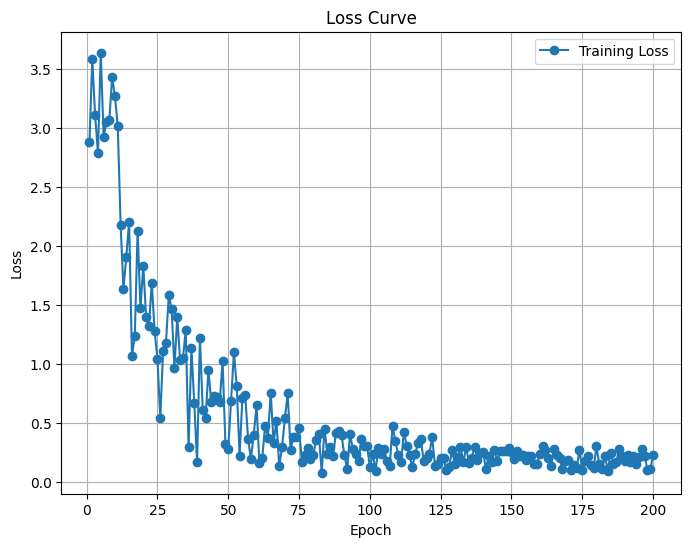

Predicted value for the first sample: 1.8828
Training Loss Scaling Unreversed: 0.18137556314468384
Training Loss Scaling Reversed: 1311.449462890625


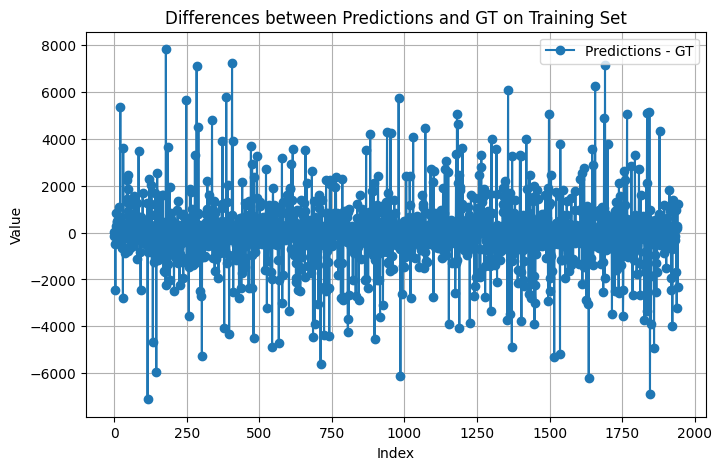

Predicted value for the first sample: 2.9194
Validation Loss Scaling Unreversed: 0.16119153797626495
Validation Loss Scaling Reversed: 1165.5074462890625


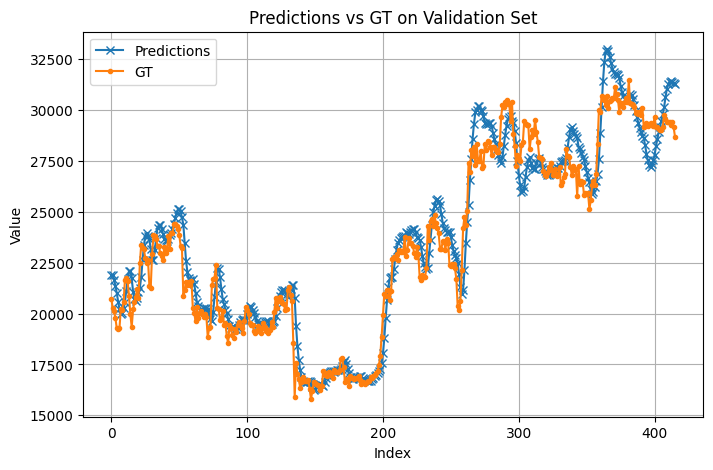

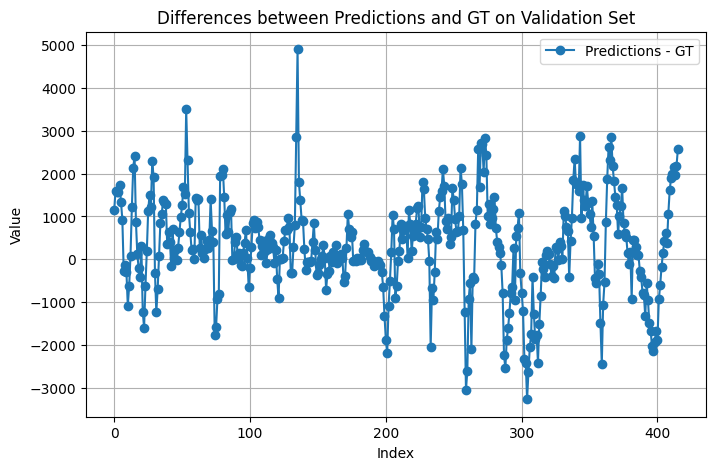

Return: 0.26183927059173584
Max Drawdown: -0.2626081109046936
Epoch [5/200], Loss: 3.9520
Epoch [10/200], Loss: 3.7856
Epoch [15/200], Loss: 4.1871
Epoch [20/200], Loss: 4.3008
Epoch [25/200], Loss: 4.1284
Epoch [30/200], Loss: 2.6027
Epoch [35/200], Loss: 3.4853
Epoch [40/200], Loss: 3.1020
Epoch [45/200], Loss: 4.1340
Epoch [50/200], Loss: 3.6408
Epoch [55/200], Loss: 3.6011
Epoch [60/200], Loss: 3.5398
Epoch [65/200], Loss: 3.4884
Epoch [70/200], Loss: 2.6476
Epoch [75/200], Loss: 3.2868
Epoch [80/200], Loss: 1.8268
Epoch [85/200], Loss: 2.3727
Epoch [90/200], Loss: 2.4866
Epoch [95/200], Loss: 2.8284
Epoch [100/200], Loss: 2.1326
Epoch [105/200], Loss: 2.4252
Epoch [110/200], Loss: 3.1158
Epoch [115/200], Loss: 3.3126
Epoch [120/200], Loss: 2.4018
Epoch [125/200], Loss: 1.4722
Epoch [130/200], Loss: 1.9408
Epoch [135/200], Loss: 1.9947
Epoch [140/200], Loss: 2.9439
Epoch [145/200], Loss: 0.8145
Epoch [150/200], Loss: 2.0756
Epoch [155/200], Loss: 2.0805
Epoch [160/200], Loss: 2.309

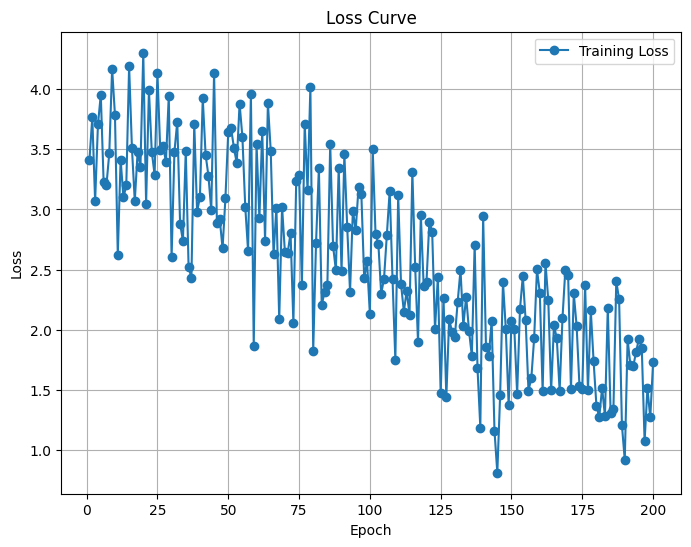

Predicted value for the first sample: 2.3588
Training Loss Scaling Unreversed: 1.7337385416030884
Training Loss Scaling Reversed: 12535.92578125


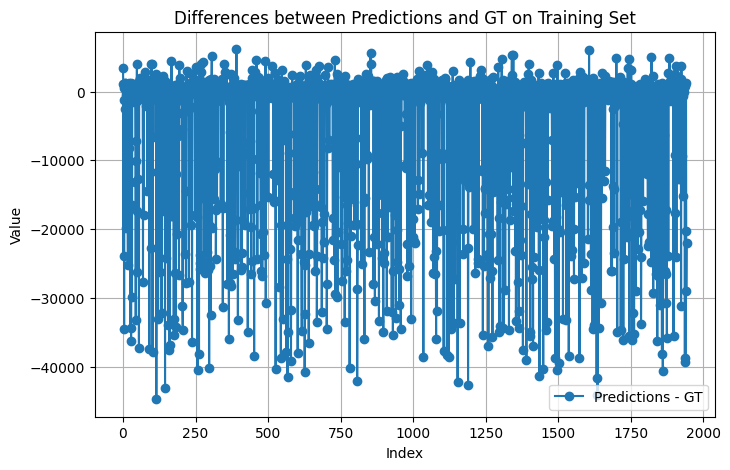

Predicted value for the first sample: 2.8885
Validation Loss Scaling Unreversed: 0.573884129524231
Validation Loss Scaling Reversed: 4149.51220703125


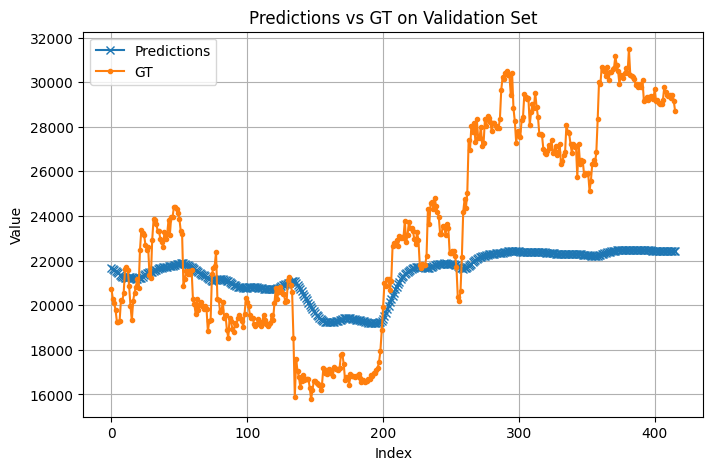

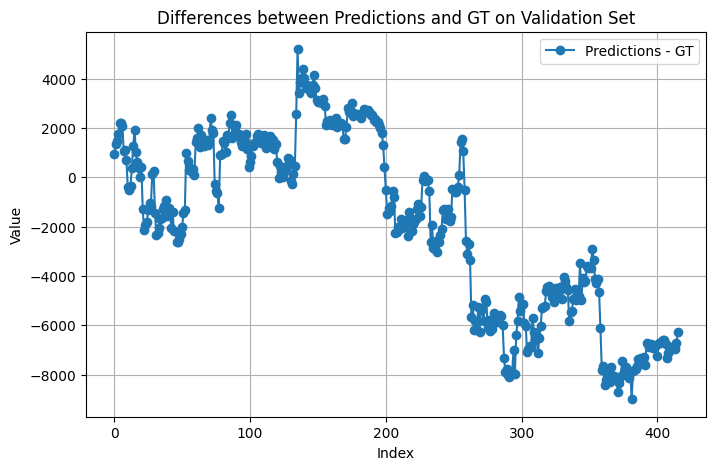

Return: 0.13404524326324463
Max Drawdown: -0.23733048141002655
Epoch [5/200], Loss: 0.6557
Epoch [10/200], Loss: 0.4846
Epoch [15/200], Loss: 0.2938
Epoch [20/200], Loss: 0.1913
Epoch [25/200], Loss: 0.1257
Epoch [30/200], Loss: 0.1401
Epoch [35/200], Loss: 0.2203
Epoch [40/200], Loss: 0.1170
Epoch [45/200], Loss: 0.2592
Epoch [50/200], Loss: 0.2146
Epoch [55/200], Loss: 0.1653
Epoch [60/200], Loss: 0.1865
Epoch [65/200], Loss: 0.1218
Epoch [70/200], Loss: 0.1226
Epoch [75/200], Loss: 0.2036
Epoch [80/200], Loss: 0.0616
Epoch [85/200], Loss: 0.1863
Epoch [90/200], Loss: 0.2319
Epoch [95/200], Loss: 0.1915
Epoch [100/200], Loss: 0.0992
Epoch [105/200], Loss: 0.1637
Epoch [110/200], Loss: 0.1514
Epoch [115/200], Loss: 0.0923
Epoch [120/200], Loss: 0.2502
Epoch [125/200], Loss: 0.1904
Epoch [130/200], Loss: 0.0985
Epoch [135/200], Loss: 0.1100
Epoch [140/200], Loss: 0.1773
Epoch [145/200], Loss: 0.2167
Epoch [150/200], Loss: 0.1118
Epoch [155/200], Loss: 0.1335
Epoch [160/200], Loss: 0.11

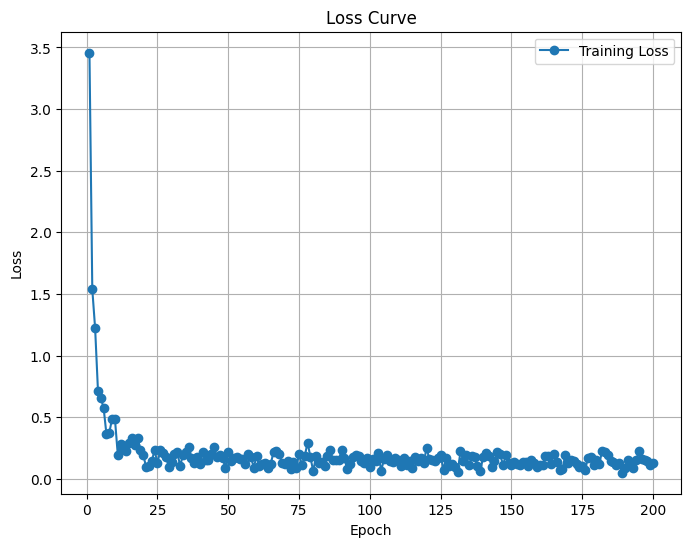

Predicted value for the first sample: 1.7942
Training Loss Scaling Unreversed: 0.13808448612689972
Training Loss Scaling Reversed: 998.4300537109375


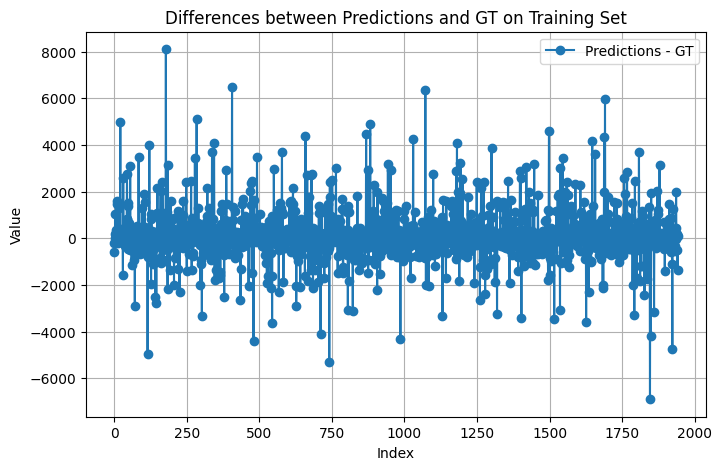

Predicted value for the first sample: 2.9774
Validation Loss Scaling Unreversed: 0.13935406506061554
Validation Loss Scaling Reversed: 1007.60986328125


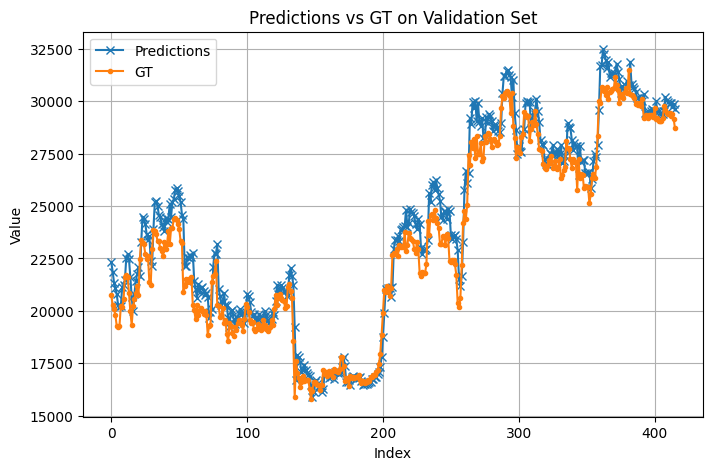

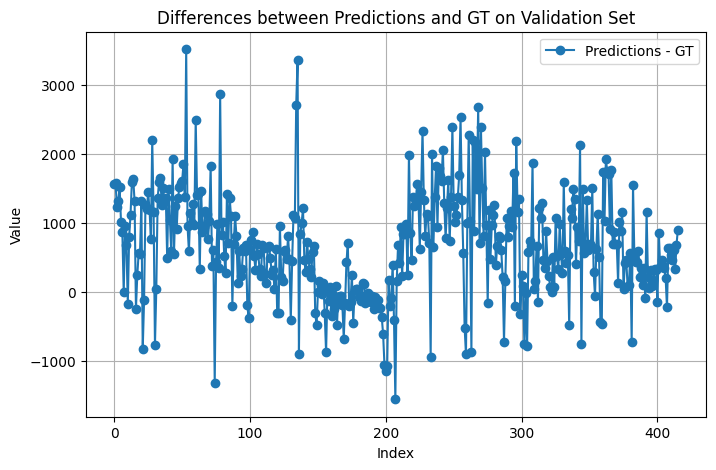

Return: 0.28278279304504395
Max Drawdown: -0.24623286724090576
Epoch [5/200], Loss: 3.8168
Epoch [10/200], Loss: 2.4552
Epoch [15/200], Loss: 1.6393
Epoch [20/200], Loss: 0.1167
Epoch [25/200], Loss: 0.6223
Epoch [30/200], Loss: 0.7885
Epoch [35/200], Loss: 0.7868
Epoch [40/200], Loss: 0.4225
Epoch [45/200], Loss: 0.7366
Epoch [50/200], Loss: 0.8178
Epoch [55/200], Loss: 0.8793
Epoch [60/200], Loss: 0.5149
Epoch [65/200], Loss: 0.6479
Epoch [70/200], Loss: 0.1399
Epoch [75/200], Loss: 0.2727
Epoch [80/200], Loss: 0.1859
Epoch [85/200], Loss: 0.3787
Epoch [90/200], Loss: 0.2953
Epoch [95/200], Loss: 0.3148
Epoch [100/200], Loss: 0.2040
Epoch [105/200], Loss: 0.1276
Epoch [110/200], Loss: 0.2636
Epoch [115/200], Loss: 0.1604
Epoch [120/200], Loss: 0.2178
Epoch [125/200], Loss: 0.1704
Epoch [130/200], Loss: 0.1422
Epoch [135/200], Loss: 0.2279
Epoch [140/200], Loss: 0.1970
Epoch [145/200], Loss: 0.2121
Epoch [150/200], Loss: 0.1737
Epoch [155/200], Loss: 0.1043
Epoch [160/200], Loss: 0.15

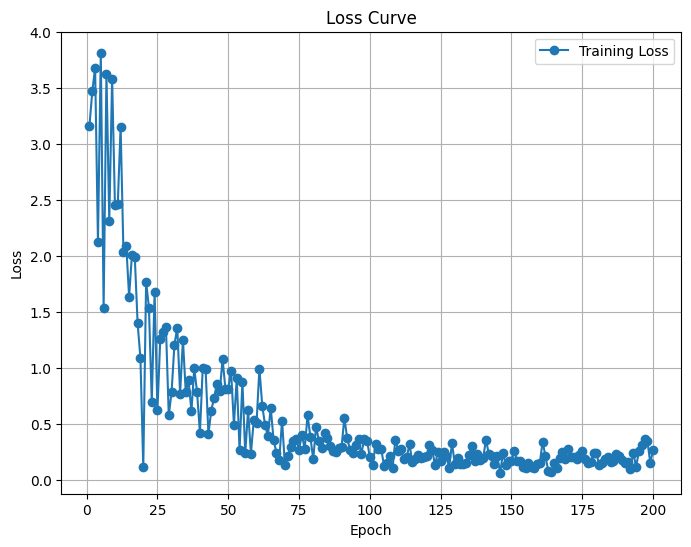

Predicted value for the first sample: 1.8252
Training Loss Scaling Unreversed: 0.17269335687160492
Training Loss Scaling Reversed: 1248.6719970703125


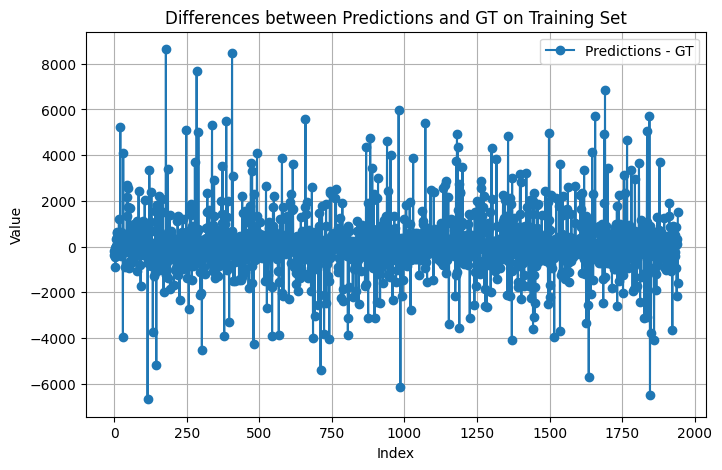

Predicted value for the first sample: 2.9028
Validation Loss Scaling Unreversed: 0.11630057543516159
Validation Loss Scaling Reversed: 840.9199829101562


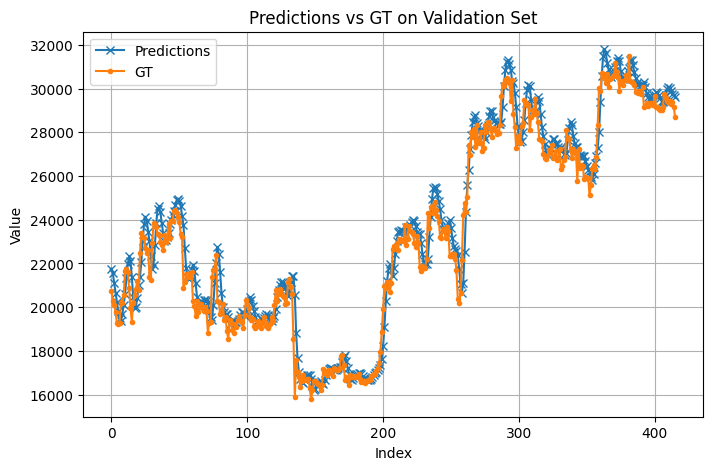

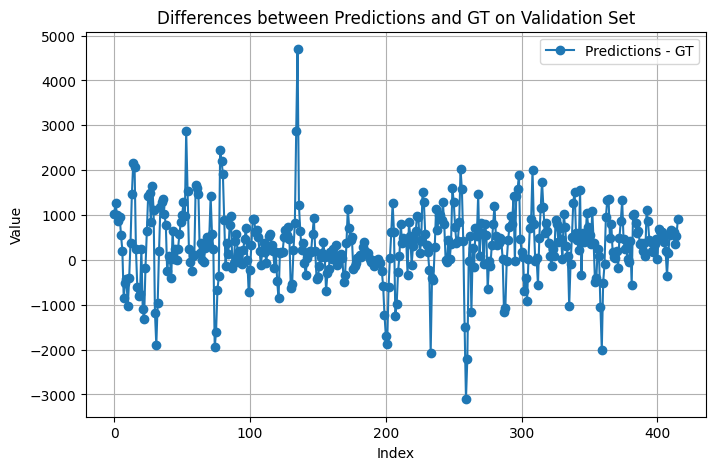

Return: 0.6811380386352539
Max Drawdown: -0.23955388367176056
Epoch [5/200], Loss: 3.2110
Epoch [10/200], Loss: 3.4087
Epoch [15/200], Loss: 3.8768
Epoch [20/200], Loss: 2.8988
Epoch [25/200], Loss: 3.0014
Epoch [30/200], Loss: 3.4874
Epoch [35/200], Loss: 4.1035
Epoch [40/200], Loss: 3.6302
Epoch [45/200], Loss: 3.0151
Epoch [50/200], Loss: 2.8837
Epoch [55/200], Loss: 3.0195
Epoch [60/200], Loss: 2.6635
Epoch [65/200], Loss: 3.2377
Epoch [70/200], Loss: 4.2120
Epoch [75/200], Loss: 2.9918
Epoch [80/200], Loss: 2.3259
Epoch [85/200], Loss: 2.9463
Epoch [90/200], Loss: 4.0812
Epoch [95/200], Loss: 1.6055
Epoch [100/200], Loss: 2.2396
Epoch [105/200], Loss: 2.0939
Epoch [110/200], Loss: 2.0166
Epoch [115/200], Loss: 1.8233
Epoch [120/200], Loss: 2.3346
Epoch [125/200], Loss: 2.2341
Epoch [130/200], Loss: 0.9953
Epoch [135/200], Loss: 2.7021
Epoch [140/200], Loss: 0.6854
Epoch [145/200], Loss: 2.0040
Epoch [150/200], Loss: 1.7294
Epoch [155/200], Loss: 2.1433
Epoch [160/200], Loss: 1.476

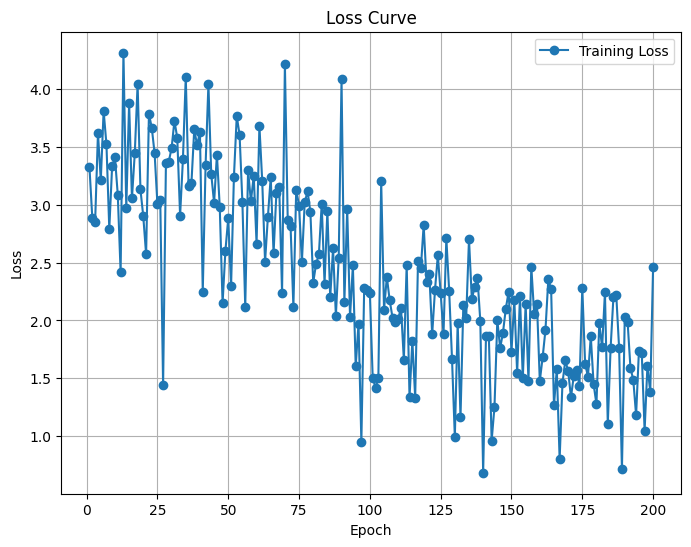

Predicted value for the first sample: 2.5304
Training Loss Scaling Unreversed: 1.6076265573501587
Training Loss Scaling Reversed: 11624.0625


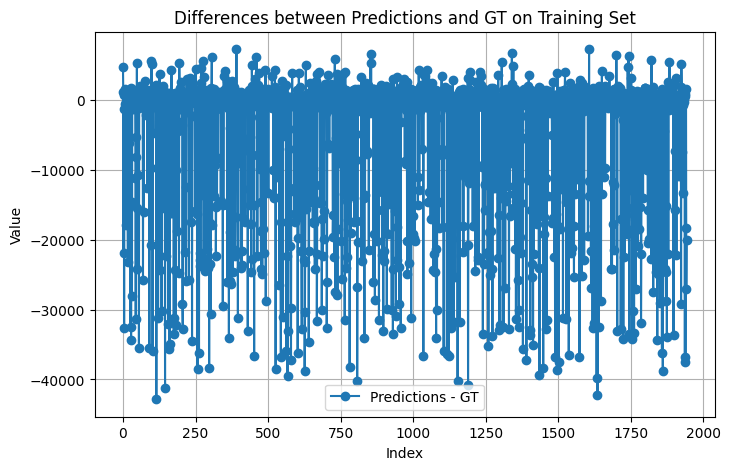

Predicted value for the first sample: 3.1372
Validation Loss Scaling Unreversed: 0.4956071972846985
Validation Loss Scaling Reversed: 3583.5244140625


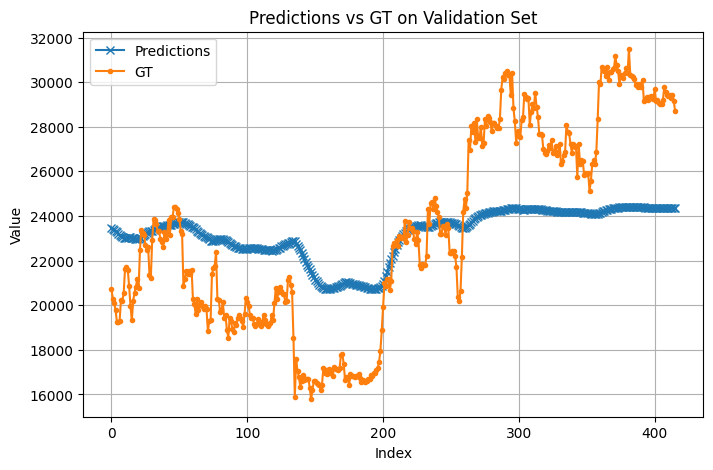

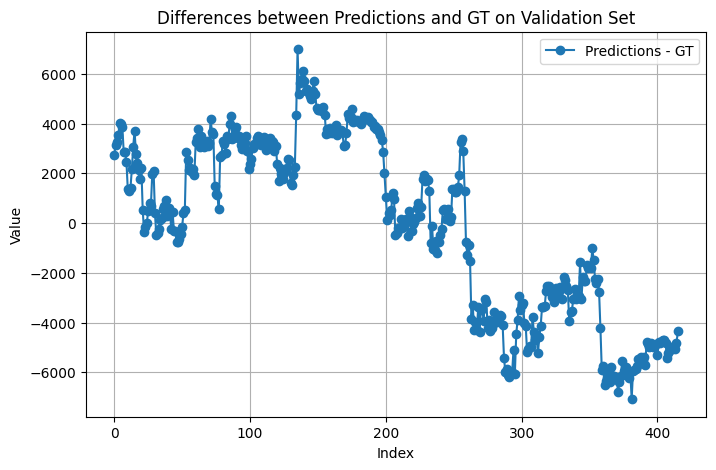

Return: 0.027898311614990234
Max Drawdown: -0.25232070684432983
Epoch [5/200], Loss: 1.2397
Epoch [10/200], Loss: 0.3288
Epoch [15/200], Loss: 0.2829
Epoch [20/200], Loss: 0.1698
Epoch [25/200], Loss: 0.1572
Epoch [30/200], Loss: 0.2015
Epoch [35/200], Loss: 0.1264
Epoch [40/200], Loss: 0.1385
Epoch [45/200], Loss: 0.1576
Epoch [50/200], Loss: 0.0588
Epoch [55/200], Loss: 0.1823
Epoch [60/200], Loss: 0.1853
Epoch [65/200], Loss: 0.2070
Epoch [70/200], Loss: 0.1644
Epoch [75/200], Loss: 0.1406
Epoch [80/200], Loss: 0.1764
Epoch [85/200], Loss: 0.1867
Epoch [90/200], Loss: 0.1520
Epoch [95/200], Loss: 0.1208
Epoch [100/200], Loss: 0.1352
Epoch [105/200], Loss: 0.1346
Epoch [110/200], Loss: 0.2046
Epoch [115/200], Loss: 0.2064
Epoch [120/200], Loss: 0.1455
Epoch [125/200], Loss: 0.1394
Epoch [130/200], Loss: 0.1379
Epoch [135/200], Loss: 0.1080
Epoch [140/200], Loss: 0.1670
Epoch [145/200], Loss: 0.2374
Epoch [150/200], Loss: 0.2415
Epoch [155/200], Loss: 0.1377
Epoch [160/200], Loss: 0.1

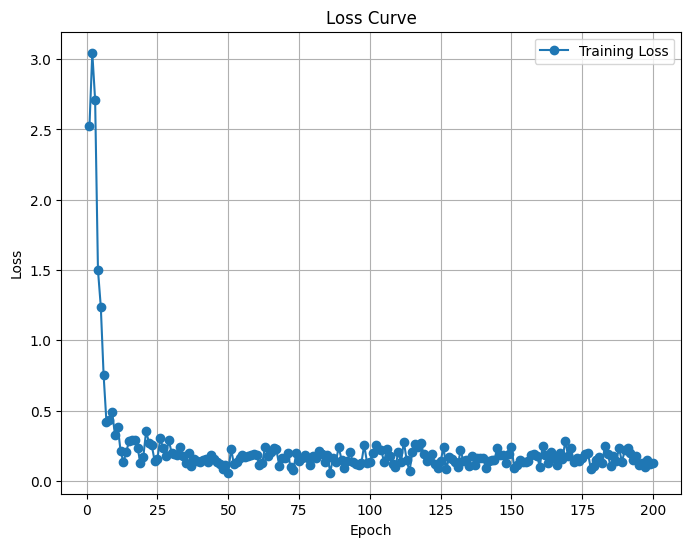

Predicted value for the first sample: 1.9148
Training Loss Scaling Unreversed: 0.16872775554656982
Training Loss Scaling Reversed: 1219.99853515625


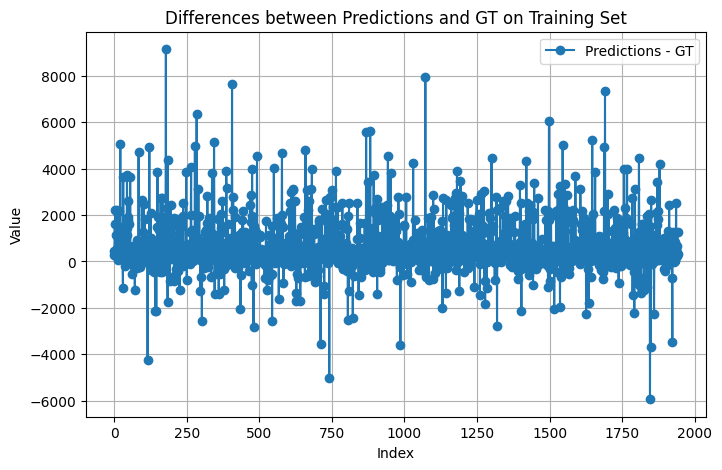

Predicted value for the first sample: 3.0827
Validation Loss Scaling Unreversed: 0.22888803482055664
Validation Loss Scaling Reversed: 1654.991943359375


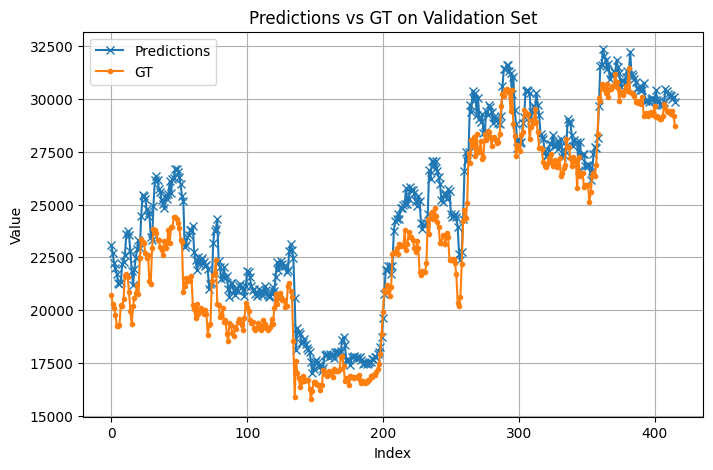

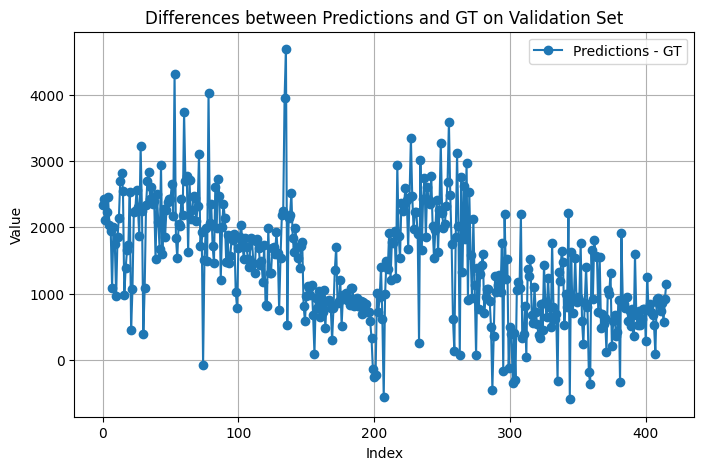

Return: 0.7131619453430176
Max Drawdown: -0.14882664382457733
Epoch [5/200], Loss: 3.0429
Epoch [10/200], Loss: 4.1513
Epoch [15/200], Loss: 2.3512
Epoch [20/200], Loss: 2.0526
Epoch [25/200], Loss: 1.2045
Epoch [30/200], Loss: 1.1991
Epoch [35/200], Loss: 0.8715
Epoch [40/200], Loss: 0.9323
Epoch [45/200], Loss: 1.1623
Epoch [50/200], Loss: 0.6186
Epoch [55/200], Loss: 0.8720
Epoch [60/200], Loss: 0.9037
Epoch [65/200], Loss: 0.5960
Epoch [70/200], Loss: 1.0313
Epoch [75/200], Loss: 0.5201
Epoch [80/200], Loss: 0.4764
Epoch [85/200], Loss: 0.2742
Epoch [90/200], Loss: 0.3374
Epoch [95/200], Loss: 0.3097
Epoch [100/200], Loss: 0.5889
Epoch [105/200], Loss: 0.3500
Epoch [110/200], Loss: 0.1962
Epoch [115/200], Loss: 0.4793
Epoch [120/200], Loss: 0.1569
Epoch [125/200], Loss: 0.3505
Epoch [130/200], Loss: 0.1344
Epoch [135/200], Loss: 0.2449
Epoch [140/200], Loss: 0.2045
Epoch [145/200], Loss: 0.2825
Epoch [150/200], Loss: 0.2927
Epoch [155/200], Loss: 0.1289
Epoch [160/200], Loss: 0.116

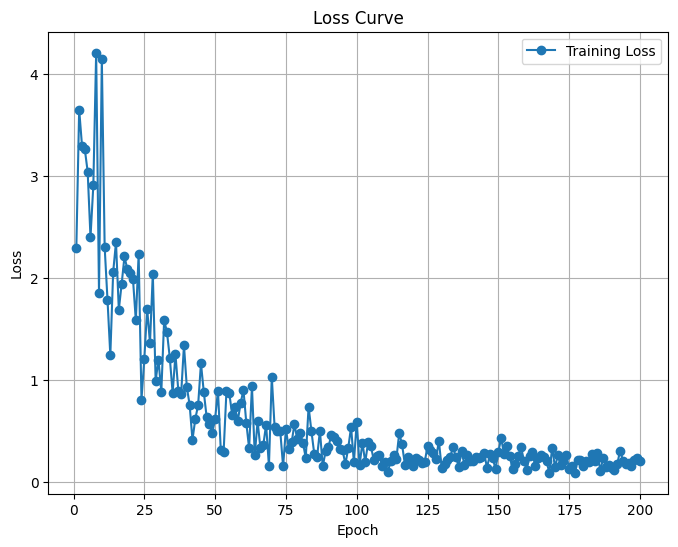

Predicted value for the first sample: 1.8582
Training Loss Scaling Unreversed: 0.19038188457489014
Training Loss Scaling Reversed: 1376.5701904296875


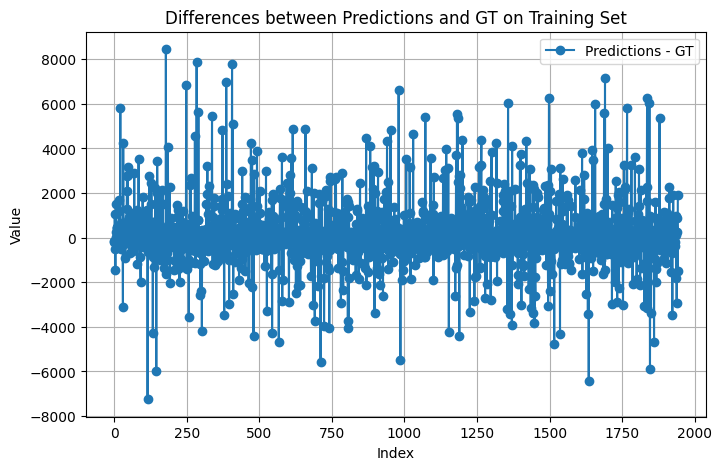

Predicted value for the first sample: 3.0199
Validation Loss Scaling Unreversed: 0.18627198040485382
Validation Loss Scaling Reversed: 1346.8533935546875


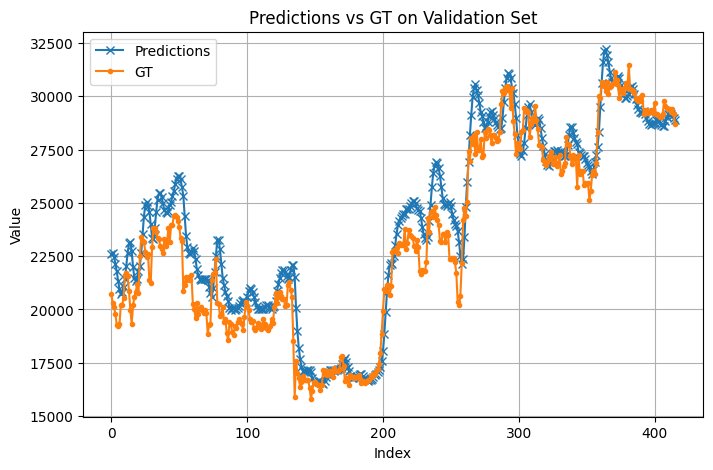

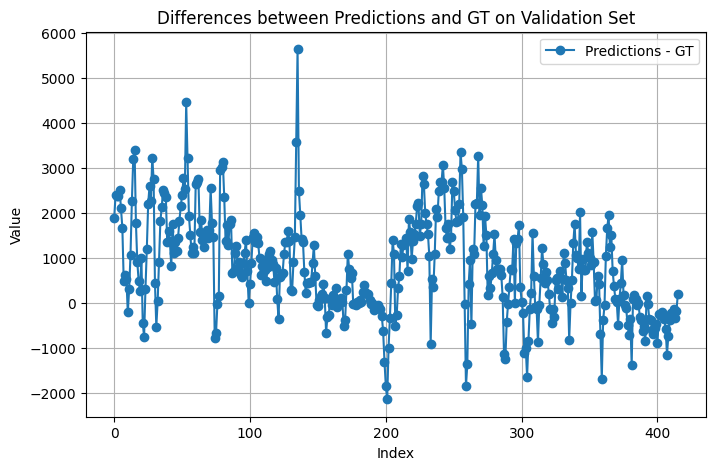

Return: 0.2192913293838501
Max Drawdown: -0.323808878660202
Epoch [5/200], Loss: 4.0998
Epoch [10/200], Loss: 3.0715
Epoch [15/200], Loss: 4.0694
Epoch [20/200], Loss: 2.7885
Epoch [25/200], Loss: 3.0895
Epoch [30/200], Loss: 1.5314
Epoch [35/200], Loss: 2.7759
Epoch [40/200], Loss: 2.1684
Epoch [45/200], Loss: 3.3114
Epoch [50/200], Loss: 3.1117
Epoch [55/200], Loss: 2.5270
Epoch [60/200], Loss: 2.6310
Epoch [65/200], Loss: 2.5479
Epoch [70/200], Loss: 1.8828
Epoch [75/200], Loss: 2.4572
Epoch [80/200], Loss: 2.8785
Epoch [85/200], Loss: 3.0165
Epoch [90/200], Loss: 2.1397
Epoch [95/200], Loss: 1.8798
Epoch [100/200], Loss: 2.9657
Epoch [105/200], Loss: 1.7078
Epoch [110/200], Loss: 1.4833
Epoch [115/200], Loss: 2.3842
Epoch [120/200], Loss: 1.4667
Epoch [125/200], Loss: 1.4363
Epoch [130/200], Loss: 2.9032
Epoch [135/200], Loss: 2.9639
Epoch [140/200], Loss: 2.2708
Epoch [145/200], Loss: 1.2666
Epoch [150/200], Loss: 1.4079
Epoch [155/200], Loss: 2.2956
Epoch [160/200], Loss: 2.1674


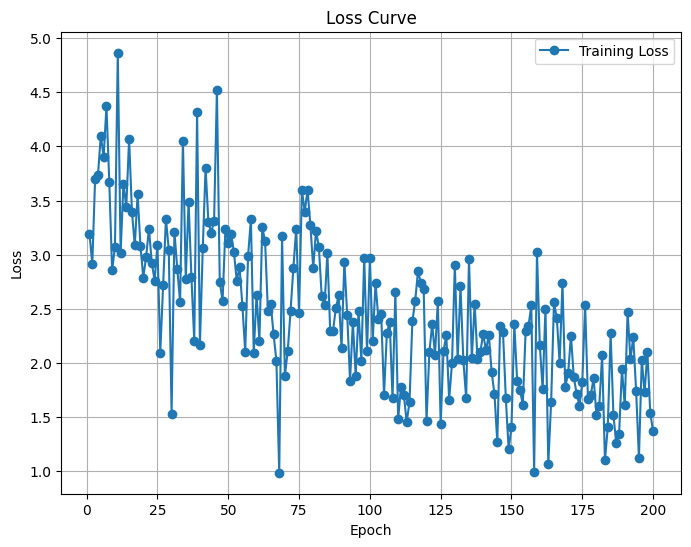

Predicted value for the first sample: 2.4177
Training Loss Scaling Unreversed: 1.7449439764022827
Training Loss Scaling Reversed: 12616.947265625


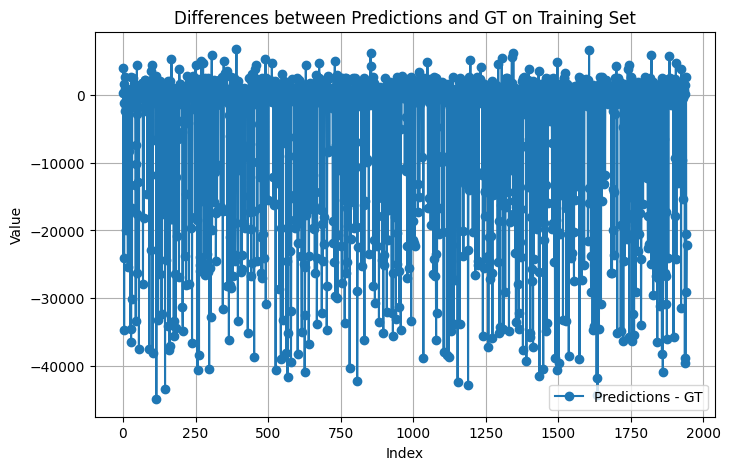

Predicted value for the first sample: 2.9020
Validation Loss Scaling Unreversed: 0.5915069580078125
Validation Loss Scaling Reversed: 4276.9345703125


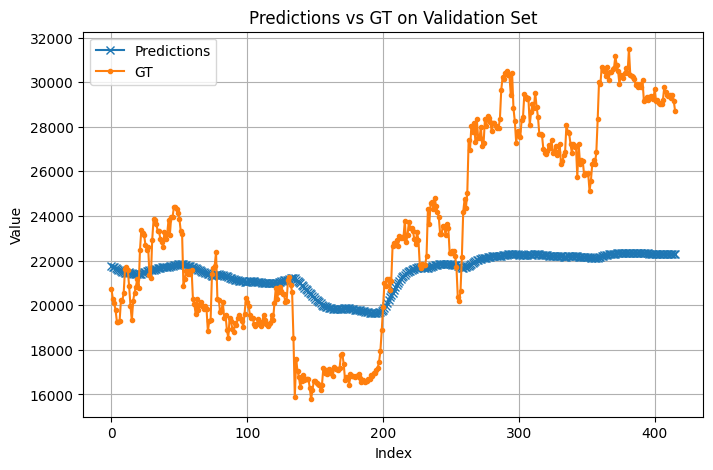

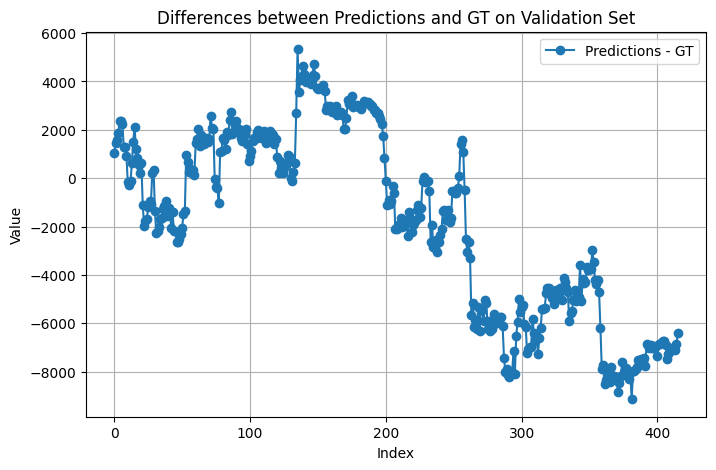

Return: -0.05702316761016846
Max Drawdown: -0.27518588304519653
Epoch [5/200], Loss: 0.2225
Epoch [10/200], Loss: 0.4106
Epoch [15/200], Loss: 0.0764
Epoch [20/200], Loss: 0.0590
Epoch [25/200], Loss: 0.0228
Epoch [30/200], Loss: 0.0545
Epoch [35/200], Loss: 0.0243
Epoch [40/200], Loss: 0.0352
Epoch [45/200], Loss: 0.1057
Epoch [50/200], Loss: 0.2981
Epoch [55/200], Loss: 0.0838
Epoch [60/200], Loss: 0.1069
Epoch [65/200], Loss: 0.2918
Epoch [70/200], Loss: 0.0171
Epoch [75/200], Loss: 0.0704
Epoch [80/200], Loss: 0.4022
Epoch [85/200], Loss: 0.0587
Epoch [90/200], Loss: 0.1153
Epoch [95/200], Loss: 0.0804
Epoch [100/200], Loss: 0.0453
Epoch [105/200], Loss: 0.1359
Epoch [110/200], Loss: 0.0772
Epoch [115/200], Loss: 0.0167
Epoch [120/200], Loss: 0.1513
Epoch [125/200], Loss: 0.0323
Epoch [130/200], Loss: 0.0714
Epoch [135/200], Loss: 0.0522
Epoch [140/200], Loss: 0.2974
Epoch [145/200], Loss: 0.0839
Epoch [150/200], Loss: 0.2537
Epoch [155/200], Loss: 0.1901
Epoch [160/200], Loss: 0.0

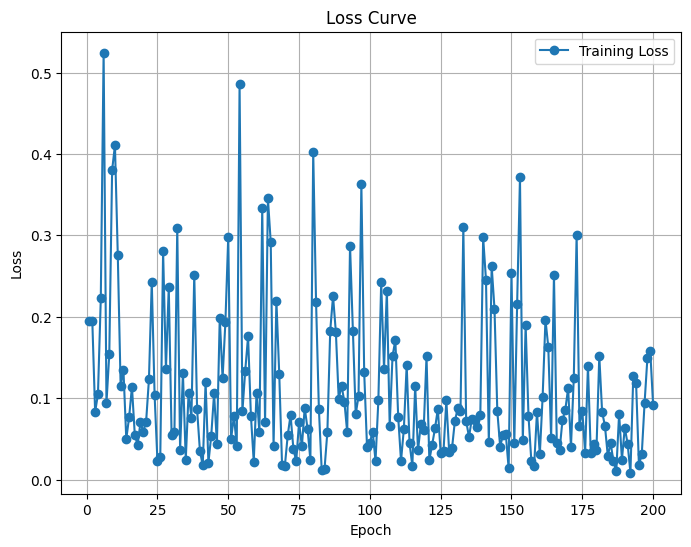

Predicted value for the first sample: 1.7622
Training Loss Scaling Unreversed: 0.1279672384262085
Training Loss Scaling Reversed: 925.2765502929688


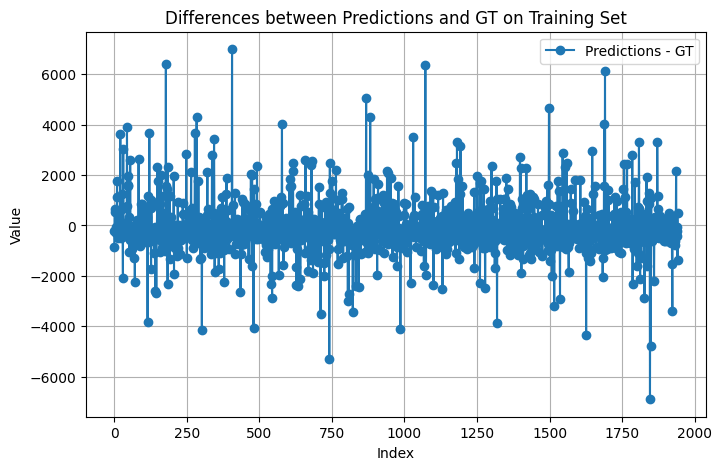

Predicted value for the first sample: 2.7821
Validation Loss Scaling Unreversed: 0.13044343888759613
Validation Loss Scaling Reversed: 943.1809692382812


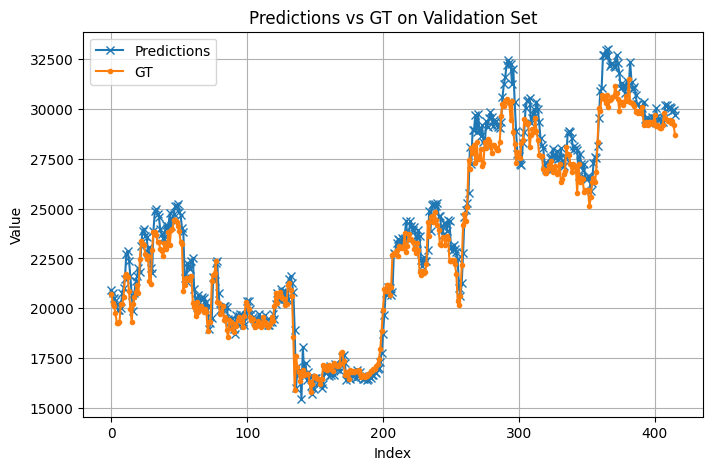

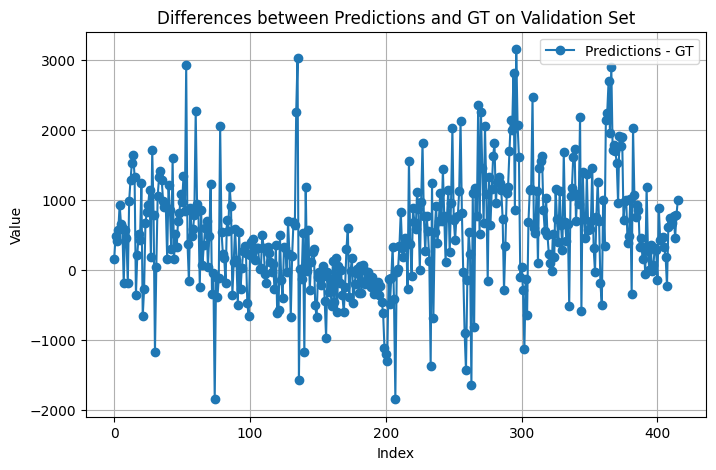

Return: 0.5616055727005005
Max Drawdown: -0.17565420269966125
Epoch [5/200], Loss: 0.0539
Epoch [10/200], Loss: 0.1969
Epoch [15/200], Loss: 0.5272
Epoch [20/200], Loss: 0.0229
Epoch [25/200], Loss: 0.1105
Epoch [30/200], Loss: 0.0574
Epoch [35/200], Loss: 0.0517
Epoch [40/200], Loss: 0.0254
Epoch [45/200], Loss: 0.0447
Epoch [50/200], Loss: 0.0646
Epoch [55/200], Loss: 0.1748
Epoch [60/200], Loss: 0.0636
Epoch [65/200], Loss: 0.0528
Epoch [70/200], Loss: 0.0501
Epoch [75/200], Loss: 0.1518
Epoch [80/200], Loss: 0.1052
Epoch [85/200], Loss: 0.1532
Epoch [90/200], Loss: 0.0396
Epoch [95/200], Loss: 0.0693
Epoch [100/200], Loss: 0.0415
Epoch [105/200], Loss: 0.1353
Epoch [110/200], Loss: 0.0216
Epoch [115/200], Loss: 0.0136
Epoch [120/200], Loss: 0.0722
Epoch [125/200], Loss: 0.1174
Epoch [130/200], Loss: 0.2440
Epoch [135/200], Loss: 0.0247
Epoch [140/200], Loss: 0.0786
Epoch [145/200], Loss: 0.1372
Epoch [150/200], Loss: 0.1213
Epoch [155/200], Loss: 0.0374
Epoch [160/200], Loss: 0.129

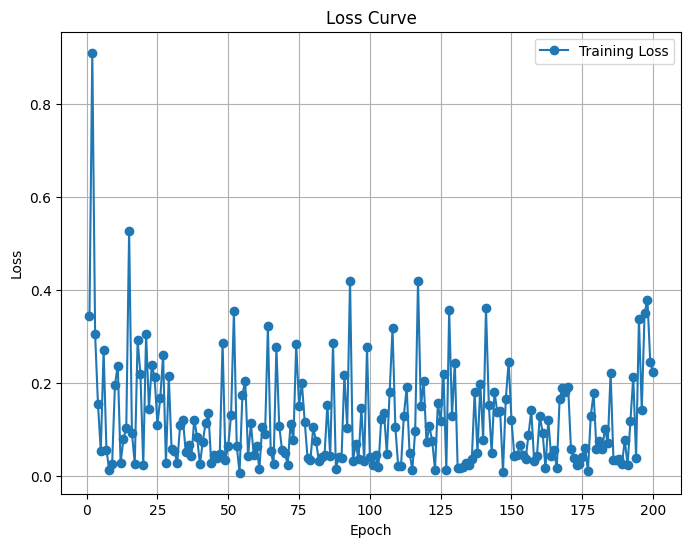

Predicted value for the first sample: 1.8638
Training Loss Scaling Unreversed: 0.14398646354675293
Training Loss Scaling Reversed: 1041.1048583984375


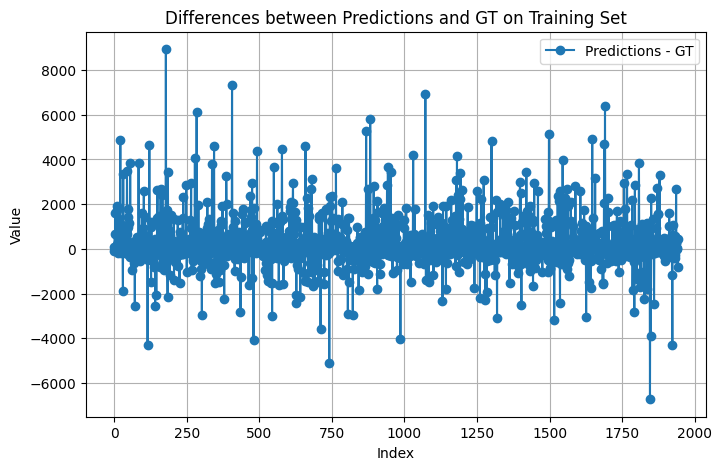

Predicted value for the first sample: 2.8534
Validation Loss Scaling Unreversed: 0.10438261181116104
Validation Loss Scaling Reversed: 754.746337890625


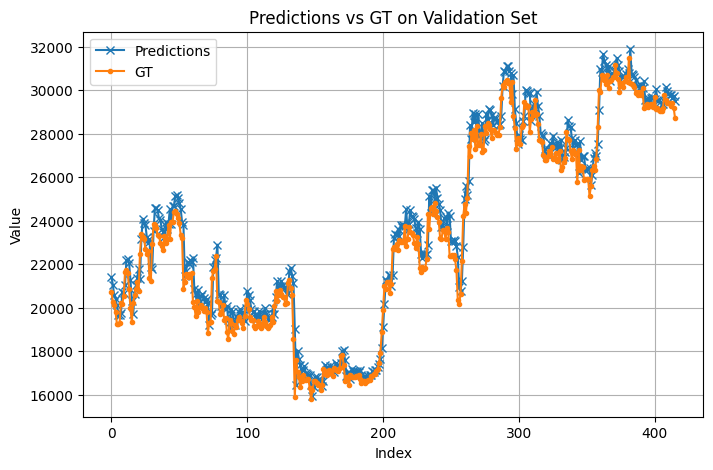

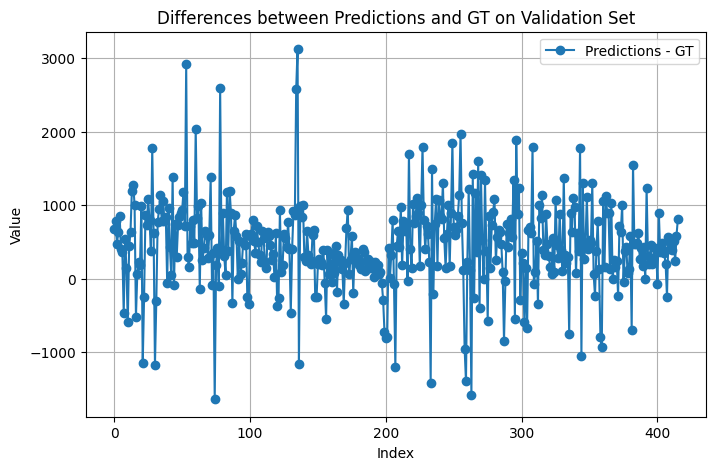

Return: 0.43902575969696045
Max Drawdown: -0.18553663790225983
Epoch [5/200], Loss: 0.4391
Epoch [10/200], Loss: 0.1316
Epoch [15/200], Loss: 0.5469
Epoch [20/200], Loss: 0.3592
Epoch [25/200], Loss: 0.4987
Epoch [30/200], Loss: 0.1089
Epoch [35/200], Loss: 0.4201
Epoch [40/200], Loss: 0.0339
Epoch [45/200], Loss: 0.0640
Epoch [50/200], Loss: 0.8449
Epoch [55/200], Loss: 0.0369
Epoch [60/200], Loss: 0.0980
Epoch [65/200], Loss: 0.1702
Epoch [70/200], Loss: 0.3160
Epoch [75/200], Loss: 0.1955
Epoch [80/200], Loss: 0.3146
Epoch [85/200], Loss: 0.0405
Epoch [90/200], Loss: 0.1316
Epoch [95/200], Loss: 0.0439
Epoch [100/200], Loss: 0.1618
Epoch [105/200], Loss: 0.0755
Epoch [110/200], Loss: 0.0405
Epoch [115/200], Loss: 0.1526
Epoch [120/200], Loss: 0.0788
Epoch [125/200], Loss: 0.0567
Epoch [130/200], Loss: 0.3351
Epoch [135/200], Loss: 0.0513
Epoch [140/200], Loss: 0.4103
Epoch [145/200], Loss: 0.1617
Epoch [150/200], Loss: 0.0595
Epoch [155/200], Loss: 0.0736
Epoch [160/200], Loss: 0.02

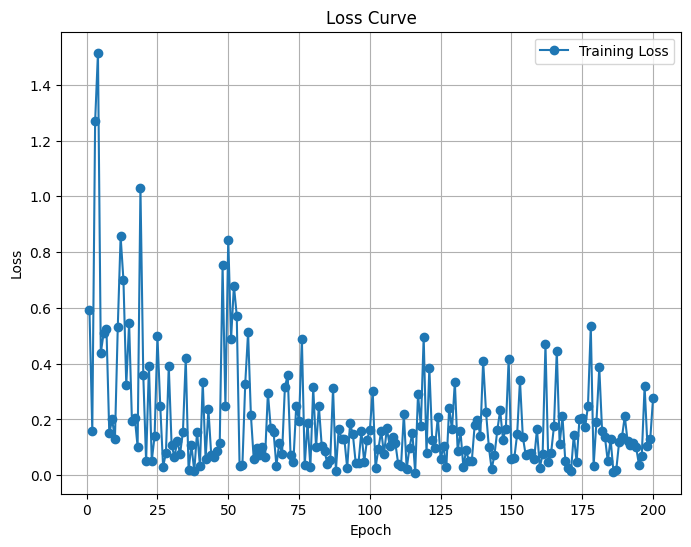

Predicted value for the first sample: 1.8245
Training Loss Scaling Unreversed: 0.16501985490322113
Training Loss Scaling Reversed: 1193.1883544921875


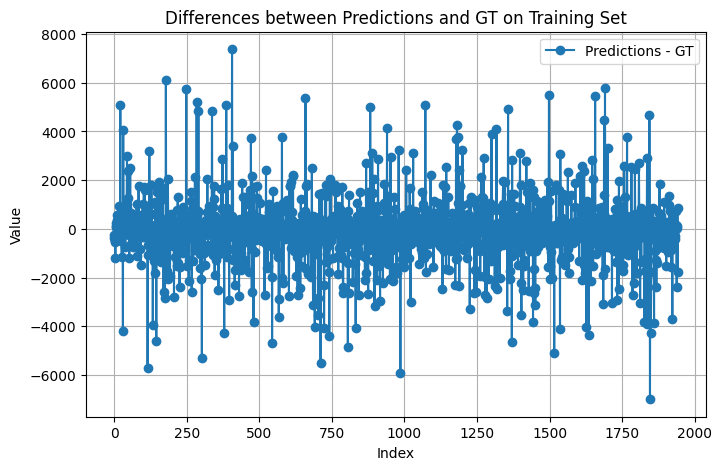

Predicted value for the first sample: 2.8849
Validation Loss Scaling Unreversed: 0.10856441408395767
Validation Loss Scaling Reversed: 784.983154296875


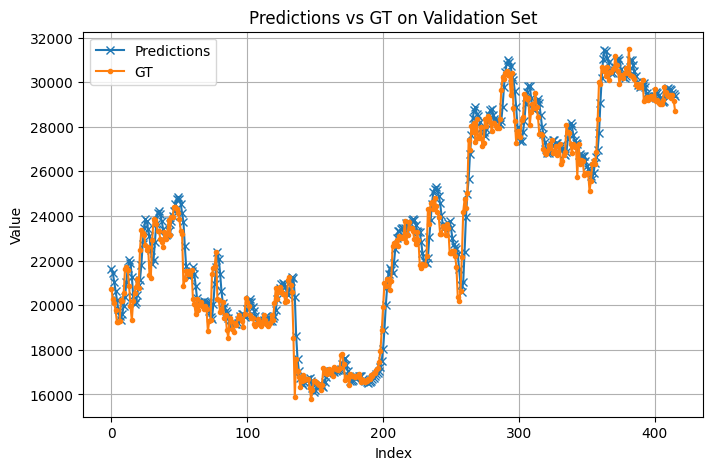

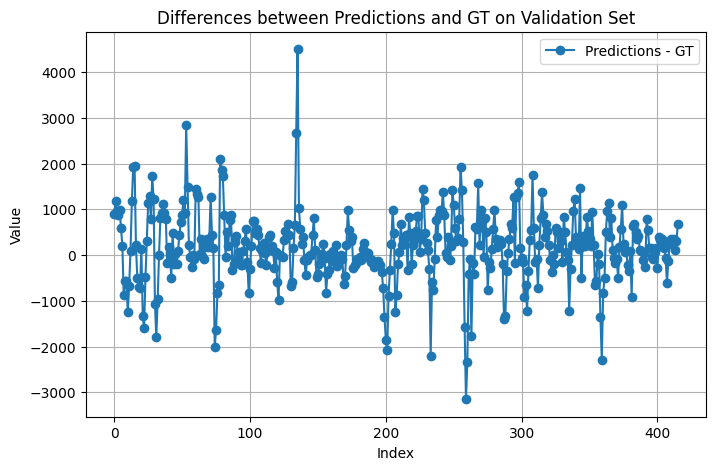

Return: 0.49905335903167725
Max Drawdown: -0.24575534462928772
Epoch [5/200], Loss: 0.0173
Epoch [10/200], Loss: 0.0232
Epoch [15/200], Loss: 0.0704
Epoch [20/200], Loss: 0.0532
Epoch [25/200], Loss: 0.0188
Epoch [30/200], Loss: 0.1304
Epoch [35/200], Loss: 0.1378
Epoch [40/200], Loss: 0.0405
Epoch [45/200], Loss: 0.1649
Epoch [50/200], Loss: 0.1130
Epoch [55/200], Loss: 0.3006
Epoch [60/200], Loss: 0.1159
Epoch [65/200], Loss: 0.1017
Epoch [70/200], Loss: 0.1875
Epoch [75/200], Loss: 0.1706
Epoch [80/200], Loss: 0.0569
Epoch [85/200], Loss: 0.2149
Epoch [90/200], Loss: 0.1156
Epoch [95/200], Loss: 0.0238
Epoch [100/200], Loss: 0.0376
Epoch [105/200], Loss: 0.2377
Epoch [110/200], Loss: 0.0422
Epoch [115/200], Loss: 0.3408
Epoch [120/200], Loss: 0.0887
Epoch [125/200], Loss: 0.1401
Epoch [130/200], Loss: 0.0883
Epoch [135/200], Loss: 0.0365
Epoch [140/200], Loss: 0.1840
Epoch [145/200], Loss: 0.0283
Epoch [150/200], Loss: 0.3546
Epoch [155/200], Loss: 0.0883
Epoch [160/200], Loss: 0.22

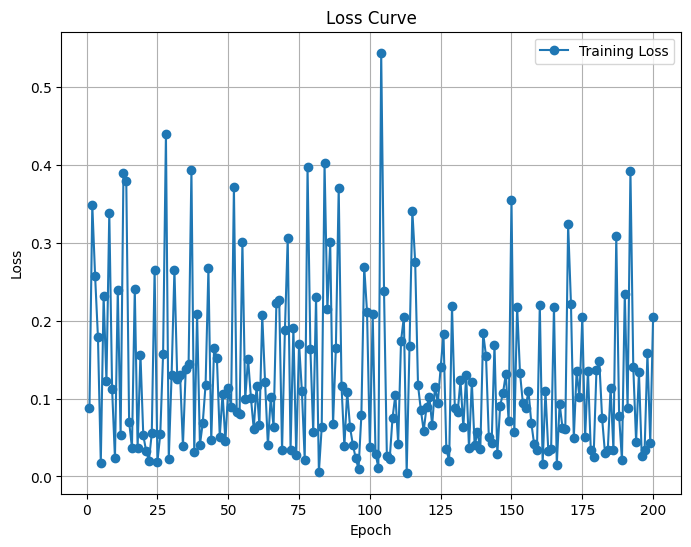

Predicted value for the first sample: 1.7820
Training Loss Scaling Unreversed: 0.13988986611366272
Training Loss Scaling Reversed: 1011.4840087890625


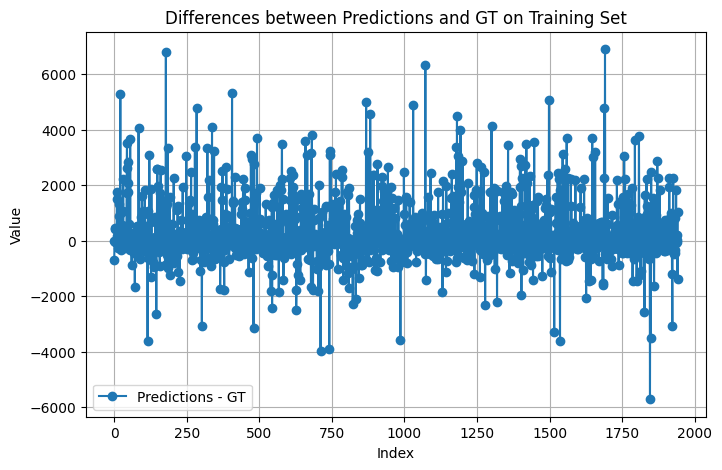

Predicted value for the first sample: 2.8950
Validation Loss Scaling Unreversed: 0.16091209650039673
Validation Loss Scaling Reversed: 1163.4869384765625


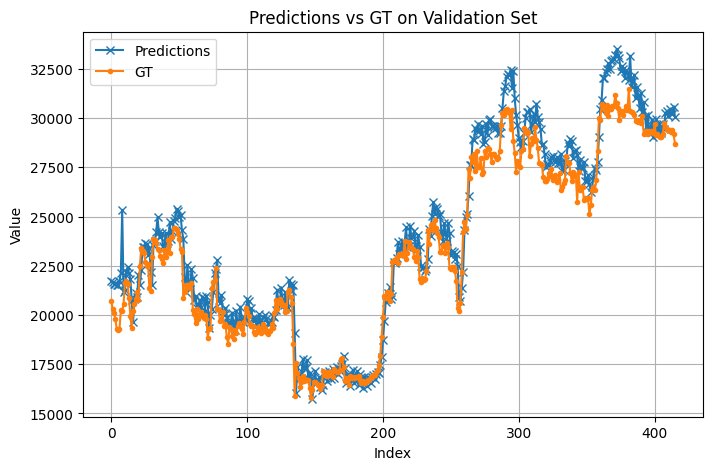

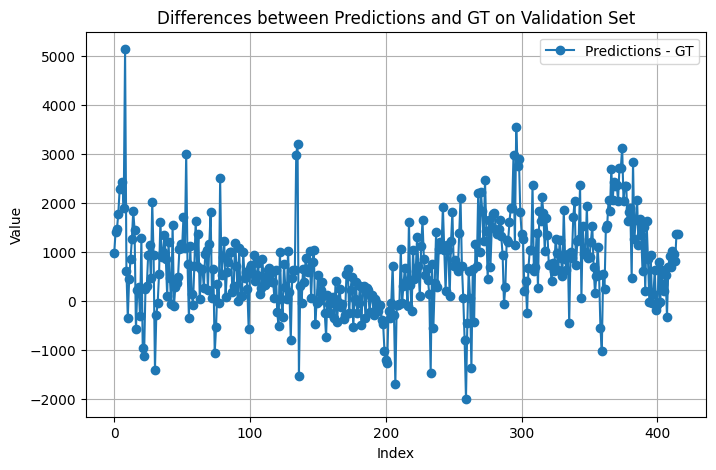

Return: 0.3375566005706787
Max Drawdown: -0.23825885355472565
Epoch [5/200], Loss: 0.0551
Epoch [10/200], Loss: 0.3297
Epoch [15/200], Loss: 0.1480
Epoch [20/200], Loss: 0.3104
Epoch [25/200], Loss: 0.1467
Epoch [30/200], Loss: 0.0534
Epoch [35/200], Loss: 0.2016
Epoch [40/200], Loss: 0.0539
Epoch [45/200], Loss: 0.0247
Epoch [50/200], Loss: 0.0590
Epoch [55/200], Loss: 0.0755
Epoch [60/200], Loss: 0.1165
Epoch [65/200], Loss: 0.2388
Epoch [70/200], Loss: 0.0798
Epoch [75/200], Loss: 0.2292
Epoch [80/200], Loss: 0.3394
Epoch [85/200], Loss: 0.0376
Epoch [90/200], Loss: 0.0504
Epoch [95/200], Loss: 0.0522
Epoch [100/200], Loss: 0.0363
Epoch [105/200], Loss: 0.0226
Epoch [110/200], Loss: 0.0040
Epoch [115/200], Loss: 0.1389
Epoch [120/200], Loss: 0.0472
Epoch [125/200], Loss: 0.0475
Epoch [130/200], Loss: 0.0231
Epoch [135/200], Loss: 0.1190
Epoch [140/200], Loss: 0.1905
Epoch [145/200], Loss: 0.0933
Epoch [150/200], Loss: 0.0441
Epoch [155/200], Loss: 0.0746
Epoch [160/200], Loss: 0.173

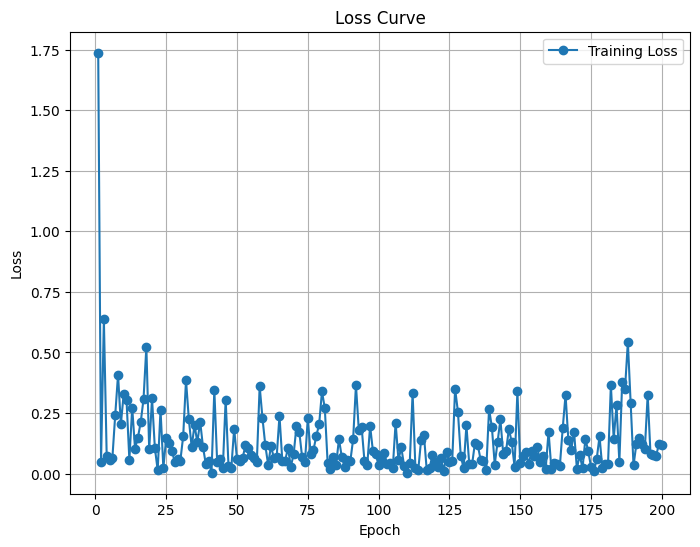

Predicted value for the first sample: 1.8629
Training Loss Scaling Unreversed: 0.13702858984470367
Training Loss Scaling Reversed: 990.79541015625


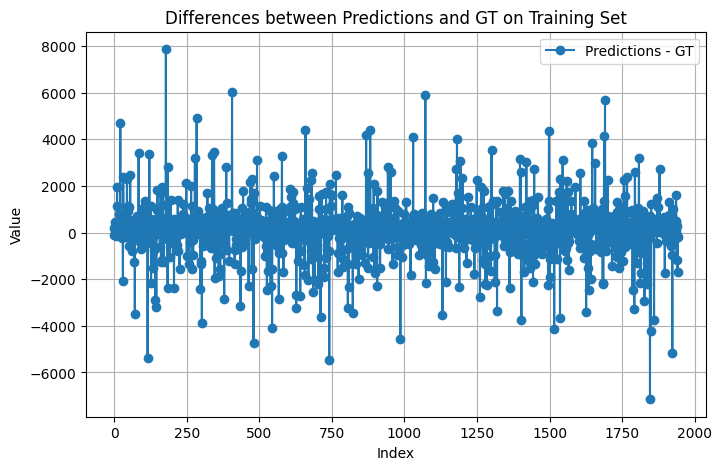

Predicted value for the first sample: 2.8277
Validation Loss Scaling Unreversed: 0.09718240797519684
Validation Loss Scaling Reversed: 702.6846313476562


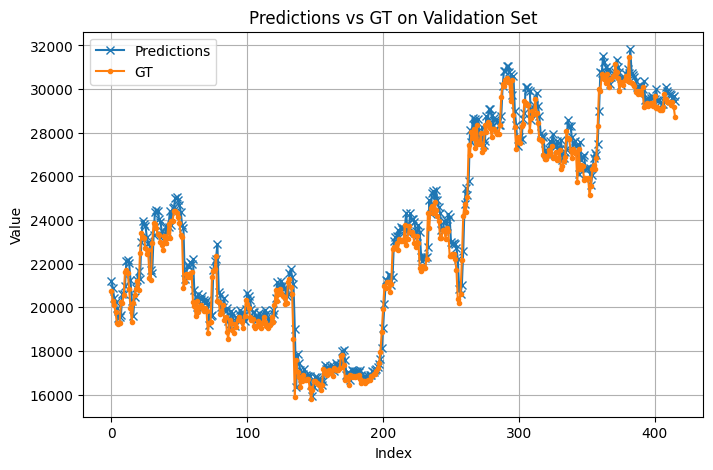

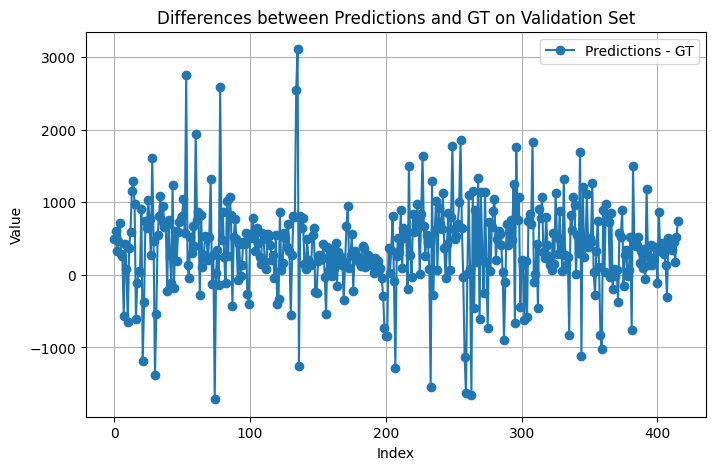

Return: 0.5791242122650146
Max Drawdown: -0.1594729721546173
Epoch [5/200], Loss: 0.0566
Epoch [10/200], Loss: 1.2900
Epoch [15/200], Loss: 0.1510
Epoch [20/200], Loss: 0.0869
Epoch [25/200], Loss: 0.1491
Epoch [30/200], Loss: 0.0578
Epoch [35/200], Loss: 0.1034
Epoch [40/200], Loss: 0.0336
Epoch [45/200], Loss: 0.0469
Epoch [50/200], Loss: 0.0569
Epoch [55/200], Loss: 0.6218
Epoch [60/200], Loss: 0.1648
Epoch [65/200], Loss: 0.2167
Epoch [70/200], Loss: 0.1918
Epoch [75/200], Loss: 0.5858
Epoch [80/200], Loss: 0.6188
Epoch [85/200], Loss: 0.2463
Epoch [90/200], Loss: 0.5057
Epoch [95/200], Loss: 0.2216
Epoch [100/200], Loss: 0.2649
Epoch [105/200], Loss: 0.2321
Epoch [110/200], Loss: 0.1133
Epoch [115/200], Loss: 0.0486
Epoch [120/200], Loss: 0.0495
Epoch [125/200], Loss: 0.1742
Epoch [130/200], Loss: 0.3376
Epoch [135/200], Loss: 0.1730
Epoch [140/200], Loss: 0.0369
Epoch [145/200], Loss: 0.1465
Epoch [150/200], Loss: 0.1179
Epoch [155/200], Loss: 0.0734
Epoch [160/200], Loss: 0.0697

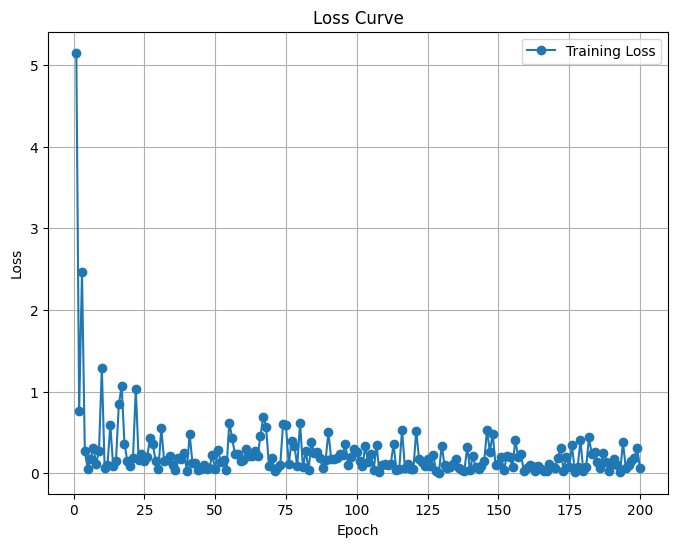

Predicted value for the first sample: 1.8277
Training Loss Scaling Unreversed: 0.17351004481315613
Training Loss Scaling Reversed: 1254.5772705078125


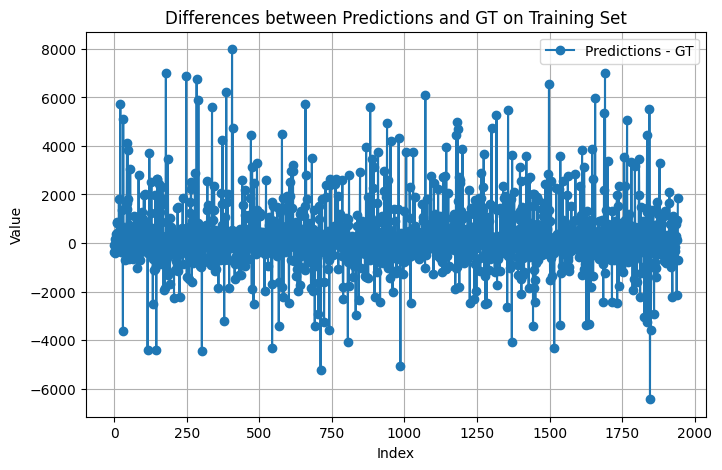

Predicted value for the first sample: 2.9050
Validation Loss Scaling Unreversed: 0.12183229625225067
Validation Loss Scaling Reversed: 880.91748046875


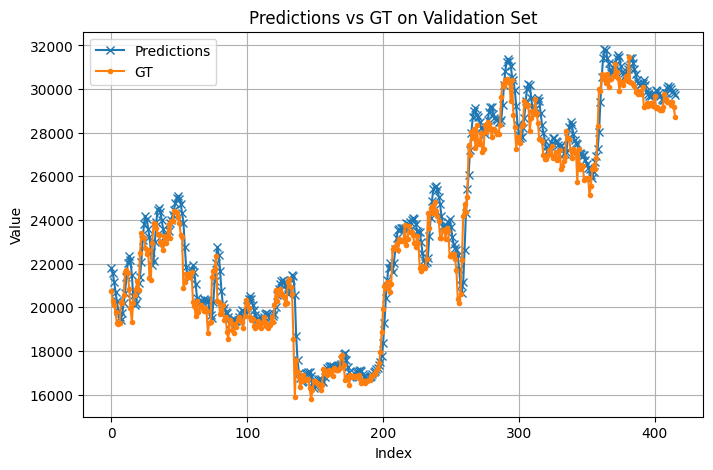

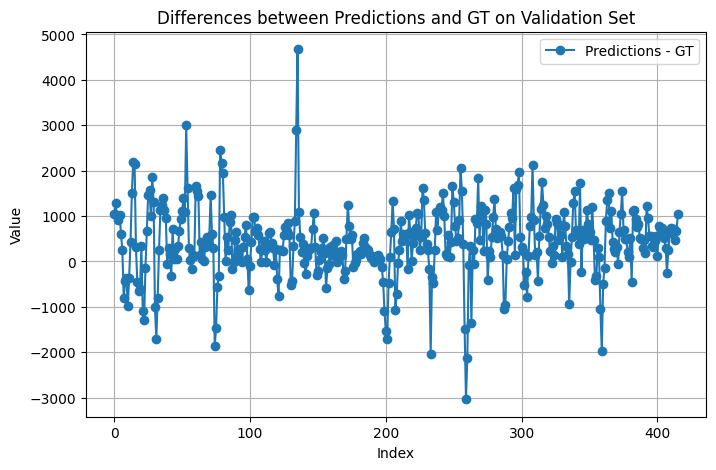

Return: 0.7081873416900635
Max Drawdown: -0.2026592195034027
Epoch [5/200], Loss: 0.2680
Epoch [10/200], Loss: 0.0823
Epoch [15/200], Loss: 0.3248
Epoch [20/200], Loss: 0.2424
Epoch [25/200], Loss: 0.0375
Epoch [30/200], Loss: 0.0398
Epoch [35/200], Loss: 0.0486
Epoch [40/200], Loss: 0.0259
Epoch [45/200], Loss: 0.2629
Epoch [50/200], Loss: 0.0707
Epoch [55/200], Loss: 0.3385
Epoch [60/200], Loss: 0.0695
Epoch [65/200], Loss: 0.0752
Epoch [70/200], Loss: 0.2195
Epoch [75/200], Loss: 0.0741
Epoch [80/200], Loss: 0.0512
Epoch [85/200], Loss: 0.2704
Epoch [90/200], Loss: 0.0403
Epoch [95/200], Loss: 0.0757
Epoch [100/200], Loss: 0.1055
Epoch [105/200], Loss: 0.0816
Epoch [110/200], Loss: 0.2924
Epoch [115/200], Loss: 0.0758
Epoch [120/200], Loss: 0.0347
Epoch [125/200], Loss: 0.0292
Epoch [130/200], Loss: 0.0151
Epoch [135/200], Loss: 0.0438
Epoch [140/200], Loss: 0.0137
Epoch [145/200], Loss: 0.0432
Epoch [150/200], Loss: 0.0350
Epoch [155/200], Loss: 0.0831
Epoch [160/200], Loss: 0.0373

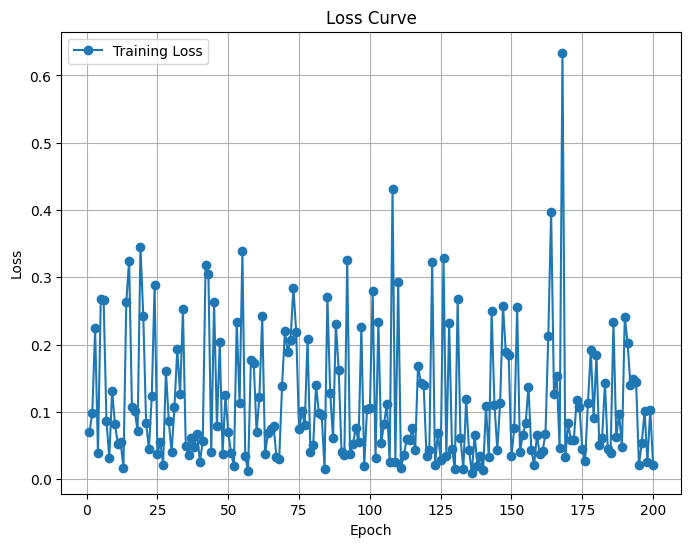

Predicted value for the first sample: 1.8749
Training Loss Scaling Unreversed: 0.13027624785900116
Training Loss Scaling Reversed: 941.9721069335938


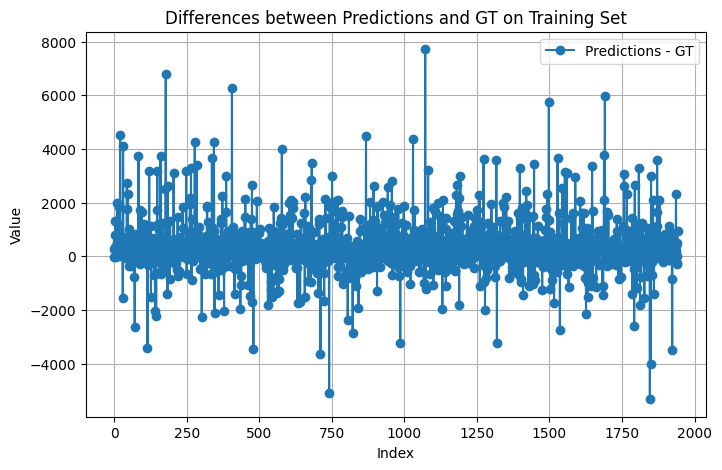

Predicted value for the first sample: 2.8556
Validation Loss Scaling Unreversed: 0.3579597473144531
Validation Loss Scaling Reversed: 2588.254150390625


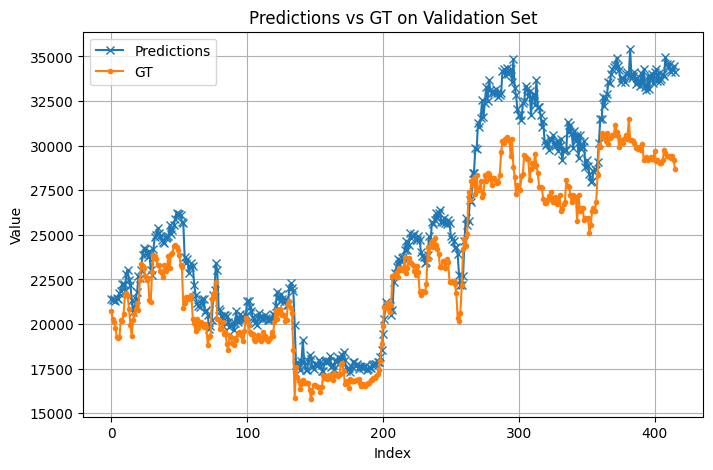

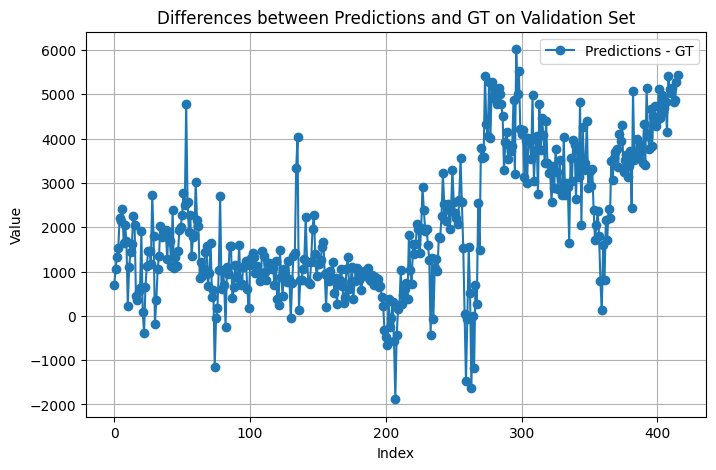

Return: 0.3831132650375366
Max Drawdown: -0.2710731625556946
Epoch [5/200], Loss: 0.3062
Epoch [10/200], Loss: 0.1027
Epoch [15/200], Loss: 0.0380
Epoch [20/200], Loss: 0.1499
Epoch [25/200], Loss: 0.1374
Epoch [30/200], Loss: 0.2175
Epoch [35/200], Loss: 0.1688
Epoch [40/200], Loss: 0.0936
Epoch [45/200], Loss: 0.0827
Epoch [50/200], Loss: 0.0352
Epoch [55/200], Loss: 0.1037
Epoch [60/200], Loss: 0.3935
Epoch [65/200], Loss: 0.0472
Epoch [70/200], Loss: 0.2732
Epoch [75/200], Loss: 0.1413
Epoch [80/200], Loss: 0.5371
Epoch [85/200], Loss: 0.0151
Epoch [90/200], Loss: 0.1793
Epoch [95/200], Loss: 0.1834
Epoch [100/200], Loss: 0.0179
Epoch [105/200], Loss: 0.0955
Epoch [110/200], Loss: 0.0241
Epoch [115/200], Loss: 0.1685
Epoch [120/200], Loss: 0.2291
Epoch [125/200], Loss: 0.0361
Epoch [130/200], Loss: 0.5004
Epoch [135/200], Loss: 0.0589
Epoch [140/200], Loss: 0.0658
Epoch [145/200], Loss: 0.0710
Epoch [150/200], Loss: 0.0096
Epoch [155/200], Loss: 0.0312
Epoch [160/200], Loss: 0.0747

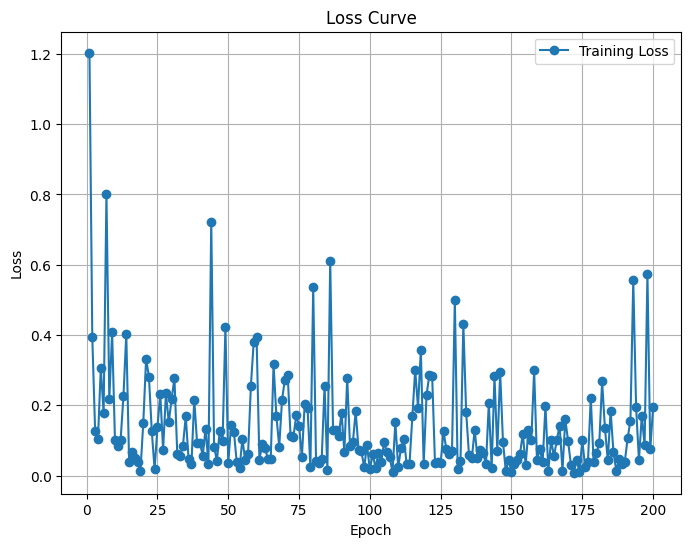

Predicted value for the first sample: 1.8221
Training Loss Scaling Unreversed: 0.13634680211544037
Training Loss Scaling Reversed: 985.8655395507812


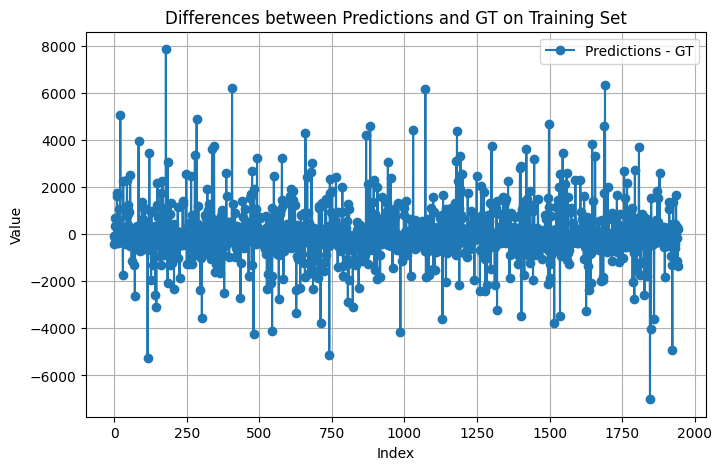

Predicted value for the first sample: 2.8116
Validation Loss Scaling Unreversed: 0.08571553230285645
Validation Loss Scaling Reversed: 619.7725219726562


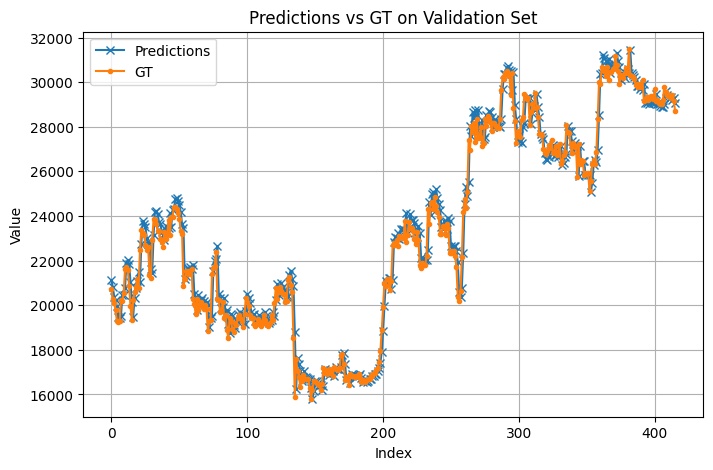

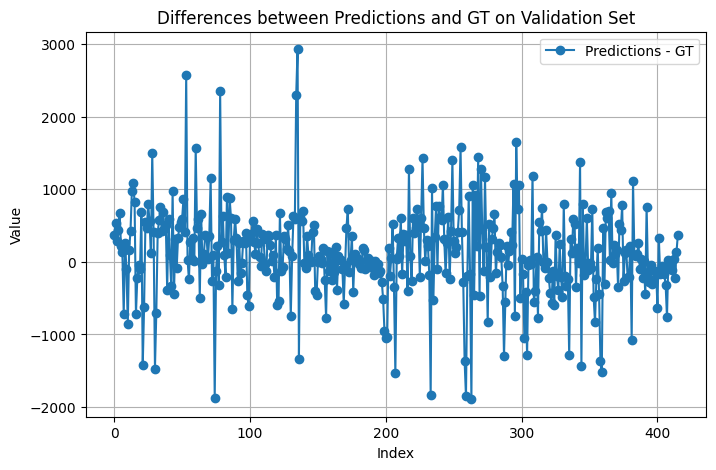

Return: 0.4735022783279419
Max Drawdown: -0.21015939116477966
Epoch [5/200], Loss: 0.1536
Epoch [10/200], Loss: 1.0868
Epoch [15/200], Loss: 0.3791
Epoch [20/200], Loss: 0.1499
Epoch [25/200], Loss: 0.0713
Epoch [30/200], Loss: 0.0975
Epoch [35/200], Loss: 0.0805
Epoch [40/200], Loss: 0.0502
Epoch [45/200], Loss: 0.0457
Epoch [50/200], Loss: 0.4163
Epoch [55/200], Loss: 0.0045
Epoch [60/200], Loss: 0.0417
Epoch [65/200], Loss: 0.2298
Epoch [70/200], Loss: 0.0928
Epoch [75/200], Loss: 0.3348
Epoch [80/200], Loss: 0.2685
Epoch [85/200], Loss: 0.2696
Epoch [90/200], Loss: 0.6100
Epoch [95/200], Loss: 0.0992
Epoch [100/200], Loss: 0.3368
Epoch [105/200], Loss: 0.0400
Epoch [110/200], Loss: 0.2640
Epoch [115/200], Loss: 0.1186
Epoch [120/200], Loss: 0.0903
Epoch [125/200], Loss: 0.1354
Epoch [130/200], Loss: 0.0720
Epoch [135/200], Loss: 0.1671
Epoch [140/200], Loss: 0.0991
Epoch [145/200], Loss: 0.2665
Epoch [150/200], Loss: 0.1053
Epoch [155/200], Loss: 0.1251
Epoch [160/200], Loss: 0.051

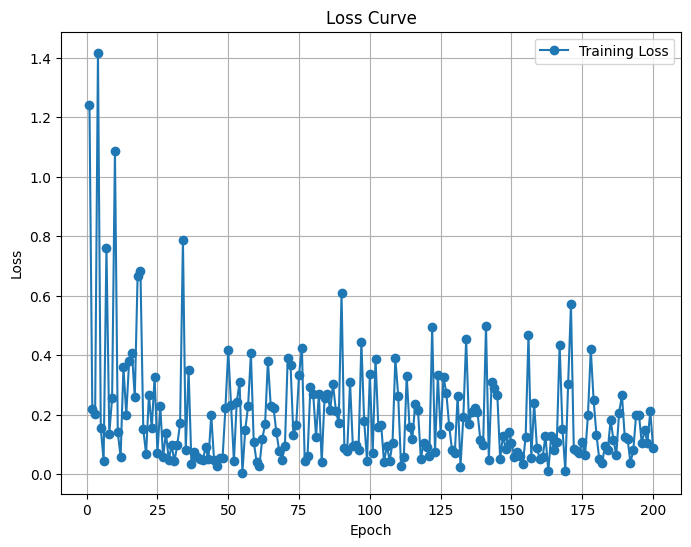

Predicted value for the first sample: 1.8278
Training Loss Scaling Unreversed: 0.1811429113149643
Training Loss Scaling Reversed: 1309.7672119140625


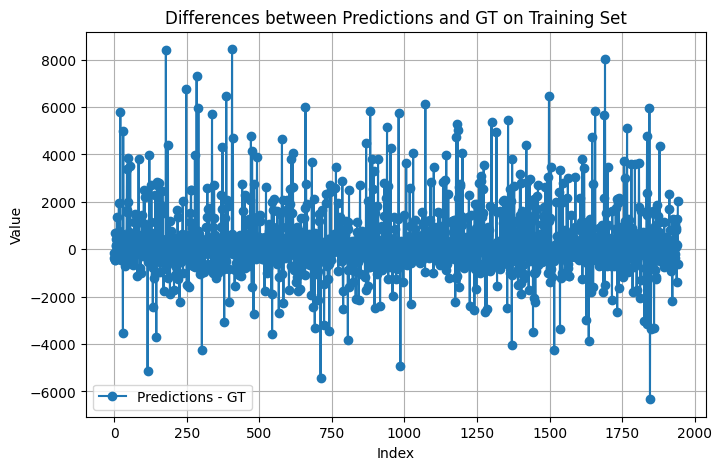

Predicted value for the first sample: 2.9083
Validation Loss Scaling Unreversed: 0.12806664407253265
Validation Loss Scaling Reversed: 925.9954223632812


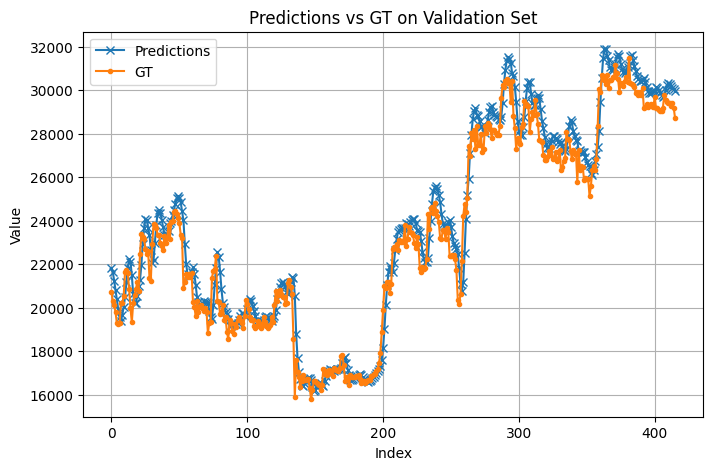

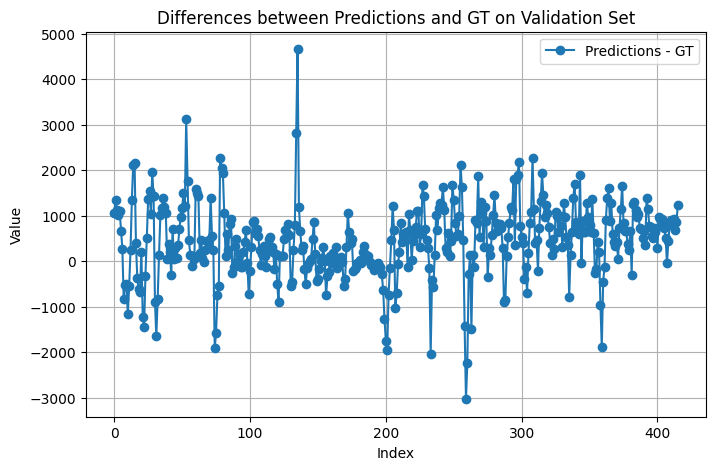

Return: 0.42953360080718994
Max Drawdown: -0.2626692056655884
Epoch [5/200], Loss: 0.0772
Epoch [10/200], Loss: 0.1460
Epoch [15/200], Loss: 0.3122
Epoch [20/200], Loss: 0.1403
Epoch [25/200], Loss: 0.1690
Epoch [30/200], Loss: 0.2242
Epoch [35/200], Loss: 0.1615
Epoch [40/200], Loss: 0.0522
Epoch [45/200], Loss: 0.0464
Epoch [50/200], Loss: 0.1002
Epoch [55/200], Loss: 0.0410
Epoch [60/200], Loss: 0.0937
Epoch [65/200], Loss: 0.1998
Epoch [70/200], Loss: 0.1276
Epoch [75/200], Loss: 0.1422
Epoch [80/200], Loss: 0.1339
Epoch [85/200], Loss: 0.1225
Epoch [90/200], Loss: 0.1019
Epoch [95/200], Loss: 0.1303
Epoch [100/200], Loss: 0.1149
Epoch [105/200], Loss: 0.0516
Epoch [110/200], Loss: 0.0507
Epoch [115/200], Loss: 0.0655
Epoch [120/200], Loss: 0.1367
Epoch [125/200], Loss: 0.1262
Epoch [130/200], Loss: 0.0892
Epoch [135/200], Loss: 0.2808
Epoch [140/200], Loss: 0.1250
Epoch [145/200], Loss: 0.0882
Epoch [150/200], Loss: 0.0565
Epoch [155/200], Loss: 0.1129
Epoch [160/200], Loss: 0.165

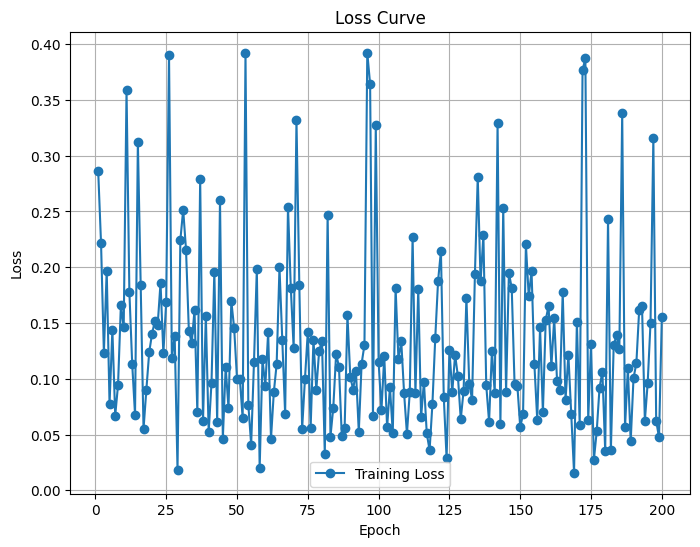

Predicted value for the first sample: 1.7919
Training Loss Scaling Unreversed: 0.13230998814105988
Training Loss Scaling Reversed: 956.6771850585938


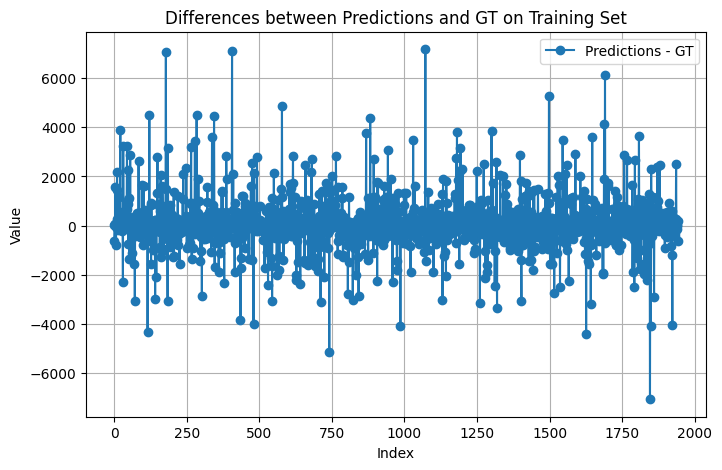

Predicted value for the first sample: 2.7775
Validation Loss Scaling Unreversed: 0.1421131193637848
Validation Loss Scaling Reversed: 1027.5595703125


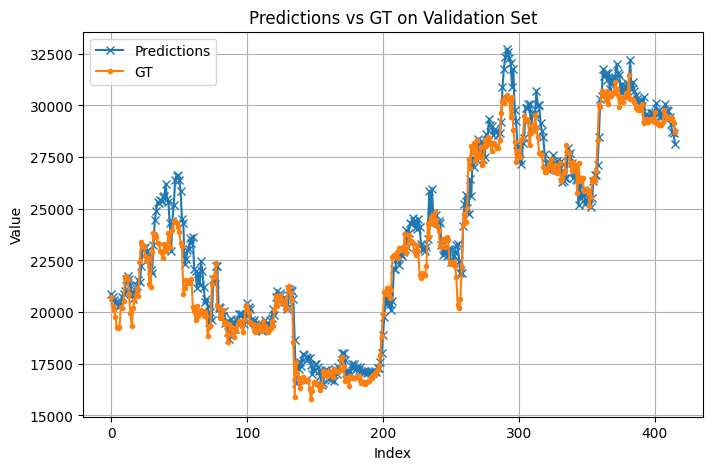

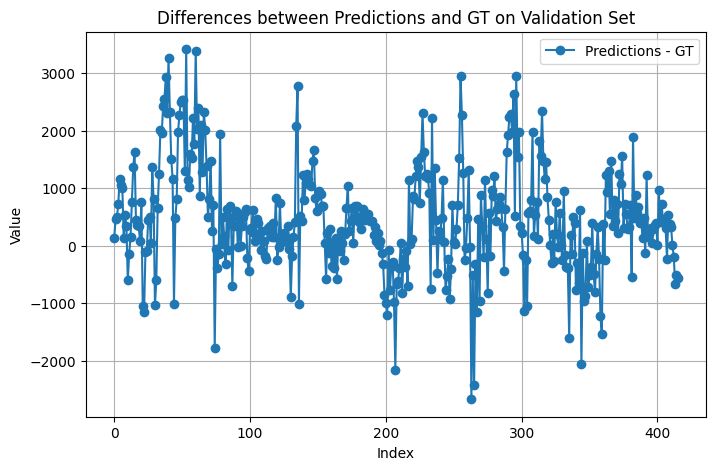

Return: 0.09317827224731445
Max Drawdown: -0.24886499345302582
Epoch [5/200], Loss: 0.2447
Epoch [10/200], Loss: 0.2867
Epoch [15/200], Loss: 0.0980
Epoch [20/200], Loss: 0.0300
Epoch [25/200], Loss: 0.1341
Epoch [30/200], Loss: 0.1829
Epoch [35/200], Loss: 0.1726
Epoch [40/200], Loss: 0.0652
Epoch [45/200], Loss: 0.3245
Epoch [50/200], Loss: 0.0783
Epoch [55/200], Loss: 0.1677
Epoch [60/200], Loss: 0.1797
Epoch [65/200], Loss: 0.0515
Epoch [70/200], Loss: 0.0691
Epoch [75/200], Loss: 0.0236
Epoch [80/200], Loss: 0.1667
Epoch [85/200], Loss: 0.4206
Epoch [90/200], Loss: 0.0930
Epoch [95/200], Loss: 0.1901
Epoch [100/200], Loss: 0.1981
Epoch [105/200], Loss: 0.1190
Epoch [110/200], Loss: 0.0599
Epoch [115/200], Loss: 0.0365
Epoch [120/200], Loss: 0.1857
Epoch [125/200], Loss: 0.1165
Epoch [130/200], Loss: 0.1102
Epoch [135/200], Loss: 0.1748
Epoch [140/200], Loss: 0.0955
Epoch [145/200], Loss: 0.2521
Epoch [150/200], Loss: 0.0883
Epoch [155/200], Loss: 0.3336
Epoch [160/200], Loss: 0.05

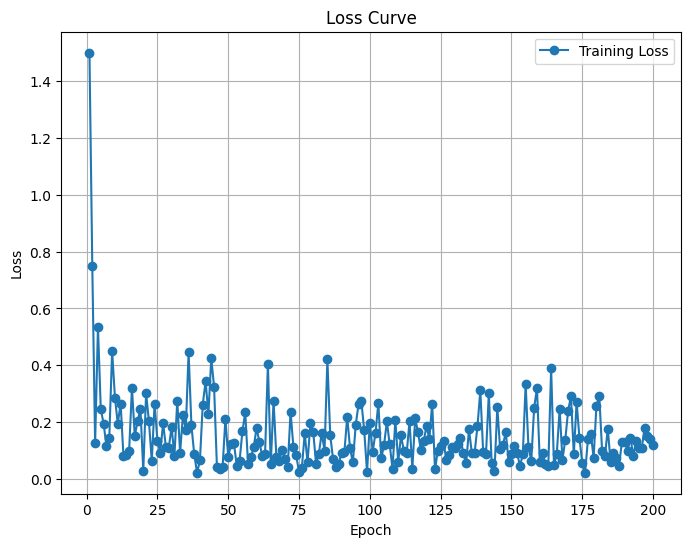

Predicted value for the first sample: 1.8350
Training Loss Scaling Unreversed: 0.13535574078559875
Training Loss Scaling Reversed: 978.6997680664062


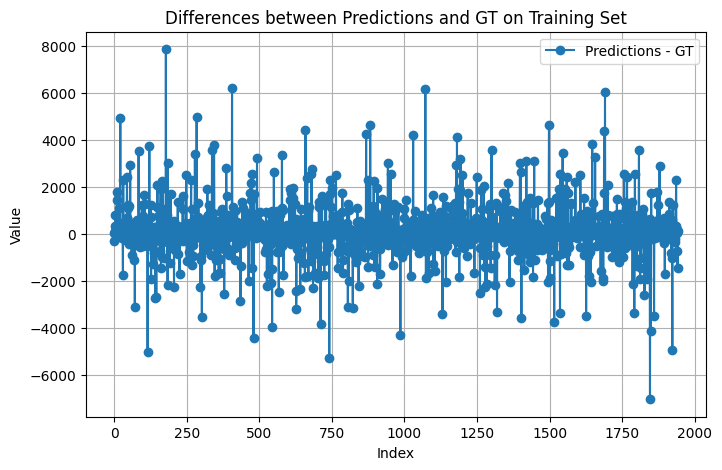

Predicted value for the first sample: 2.8838
Validation Loss Scaling Unreversed: 0.09558093547821045
Validation Loss Scaling Reversed: 691.1051635742188


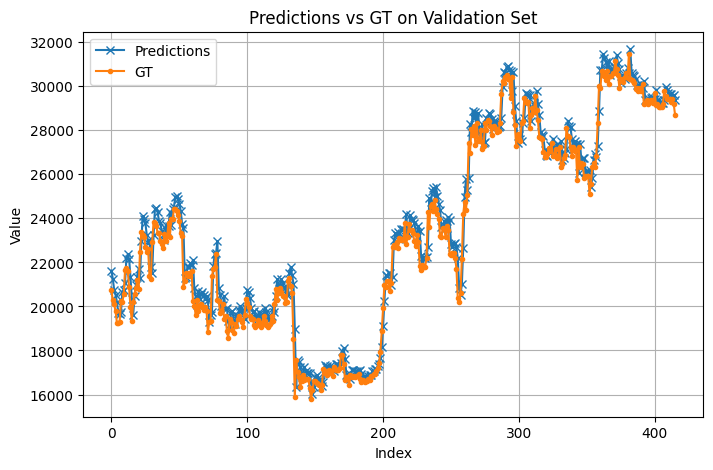

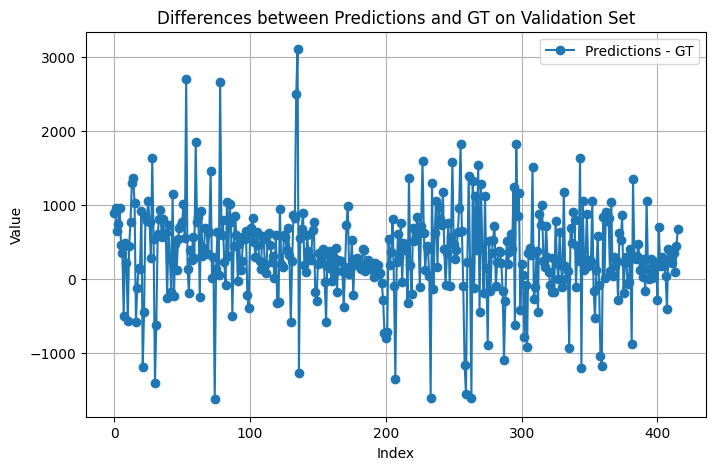

Return: 0.36496496200561523
Max Drawdown: -0.22200870513916016
Epoch [5/200], Loss: 3.5075
Epoch [10/200], Loss: 0.9063
Epoch [15/200], Loss: 0.3002
Epoch [20/200], Loss: 1.2907
Epoch [25/200], Loss: 0.2861
Epoch [30/200], Loss: 0.3947
Epoch [35/200], Loss: 0.7164
Epoch [40/200], Loss: 0.1438
Epoch [45/200], Loss: 0.5327
Epoch [50/200], Loss: 0.1381
Epoch [55/200], Loss: 0.2113
Epoch [60/200], Loss: 0.3182
Epoch [65/200], Loss: 0.1037
Epoch [70/200], Loss: 0.0831
Epoch [75/200], Loss: 0.1305
Epoch [80/200], Loss: 0.2847
Epoch [85/200], Loss: 0.2201
Epoch [90/200], Loss: 0.1054
Epoch [95/200], Loss: 0.0457
Epoch [100/200], Loss: 0.0589
Epoch [105/200], Loss: 0.0647
Epoch [110/200], Loss: 0.0703
Epoch [115/200], Loss: 0.2296
Epoch [120/200], Loss: 0.1737
Epoch [125/200], Loss: 0.2880
Epoch [130/200], Loss: 0.1387
Epoch [135/200], Loss: 0.1245
Epoch [140/200], Loss: 0.2065
Epoch [145/200], Loss: 0.3967
Epoch [150/200], Loss: 0.1693
Epoch [155/200], Loss: 0.0825
Epoch [160/200], Loss: 0.09

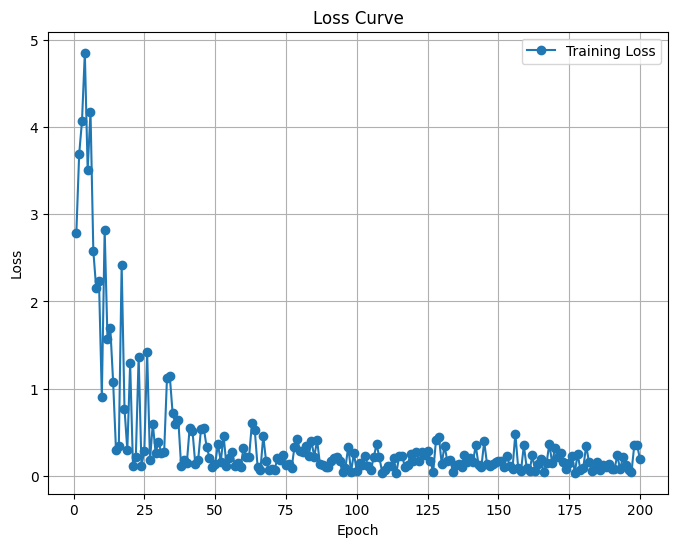

Predicted value for the first sample: 1.8891
Training Loss Scaling Unreversed: 0.18550631403923035
Training Loss Scaling Reversed: 1341.317138671875


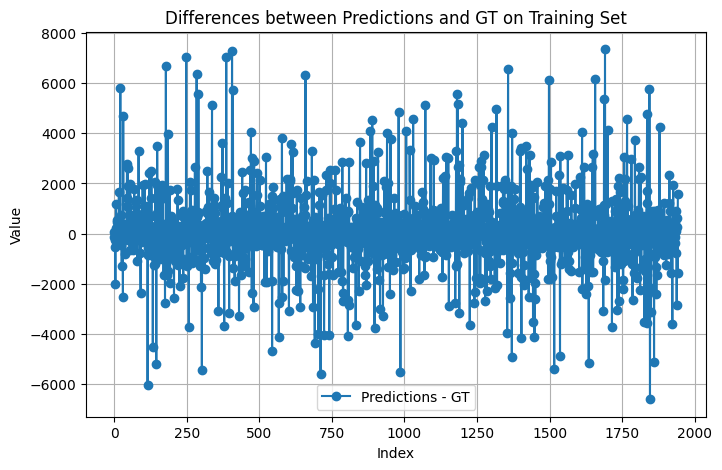

Predicted value for the first sample: 2.8991
Validation Loss Scaling Unreversed: 0.14274996519088745
Validation Loss Scaling Reversed: 1032.1641845703125


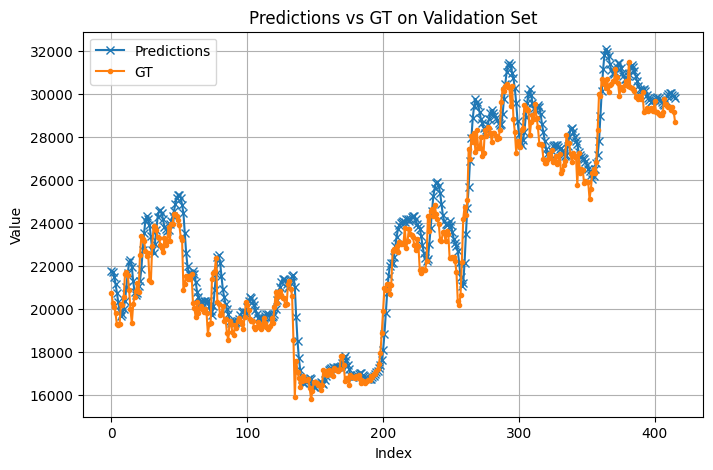

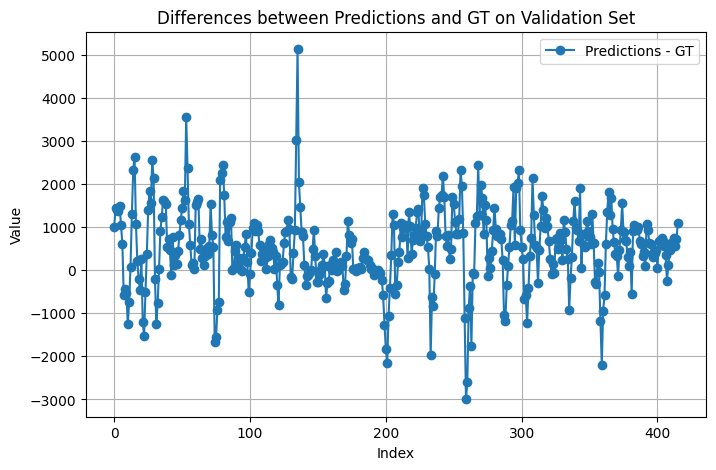

Return: 0.13341236114501953
Max Drawdown: -0.34411102533340454
Epoch [5/200], Loss: 0.3876
Epoch [10/200], Loss: 0.1592
Epoch [15/200], Loss: 0.1099
Epoch [20/200], Loss: 0.1769
Epoch [25/200], Loss: 0.1836
Epoch [30/200], Loss: 0.0633
Epoch [35/200], Loss: 0.2764
Epoch [40/200], Loss: 0.0453
Epoch [45/200], Loss: 0.1703
Epoch [50/200], Loss: 0.3918
Epoch [55/200], Loss: 0.0219
Epoch [60/200], Loss: 0.1690
Epoch [65/200], Loss: 0.1479
Epoch [70/200], Loss: 0.0895
Epoch [75/200], Loss: 0.0327
Epoch [80/200], Loss: 0.1057
Epoch [85/200], Loss: 0.1242
Epoch [90/200], Loss: 0.1358
Epoch [95/200], Loss: 0.2767
Epoch [100/200], Loss: 0.0755
Epoch [105/200], Loss: 0.1318
Epoch [110/200], Loss: 0.0311
Epoch [115/200], Loss: 0.0600
Epoch [120/200], Loss: 0.0847
Epoch [125/200], Loss: 0.0558
Epoch [130/200], Loss: 0.1730
Epoch [135/200], Loss: 0.1774
Epoch [140/200], Loss: 0.3425
Epoch [145/200], Loss: 0.0376
Epoch [150/200], Loss: 0.1336
Epoch [155/200], Loss: 0.1305
Epoch [160/200], Loss: 0.13

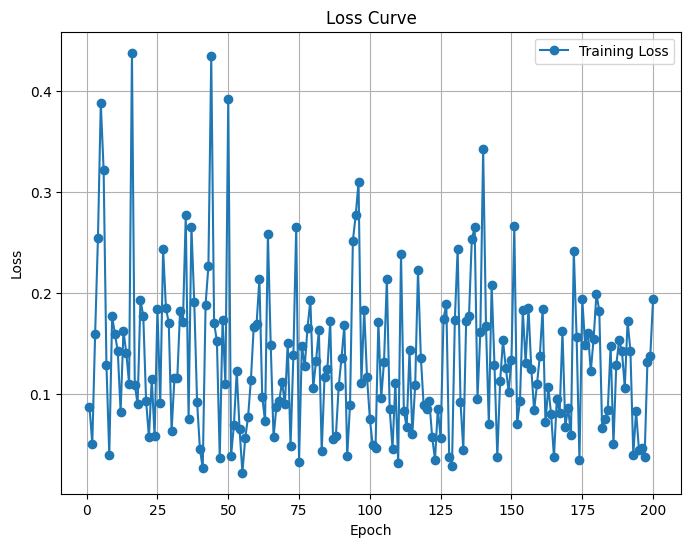

Predicted value for the first sample: 1.9272
Training Loss Scaling Unreversed: 0.1304190456867218
Training Loss Scaling Reversed: 943.0045776367188


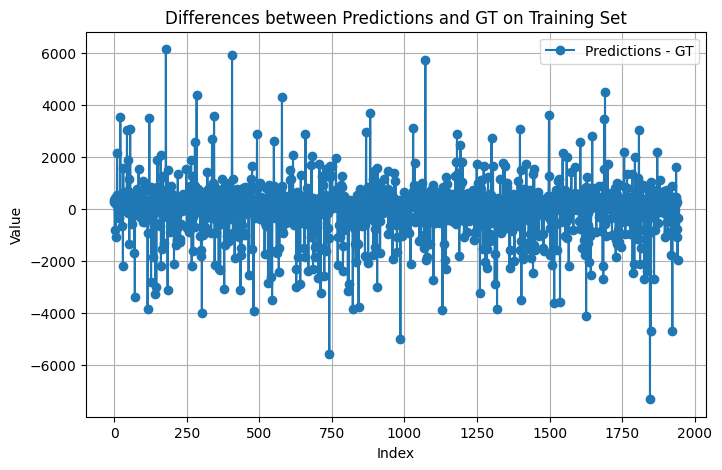

Predicted value for the first sample: 2.7467
Validation Loss Scaling Unreversed: 0.25178319215774536
Validation Loss Scaling Reversed: 1820.5372314453125


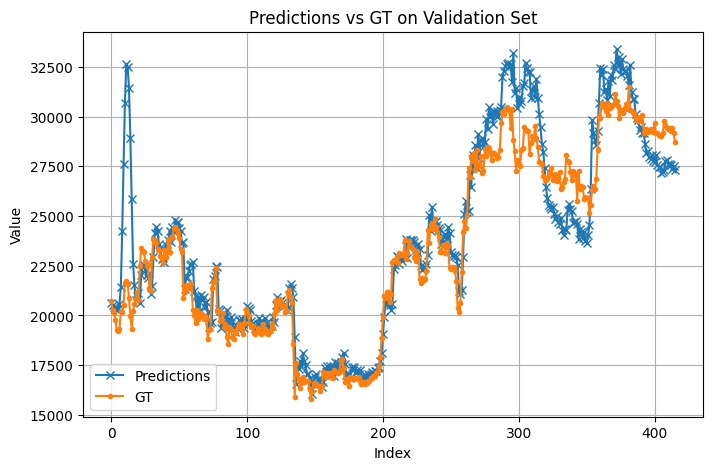

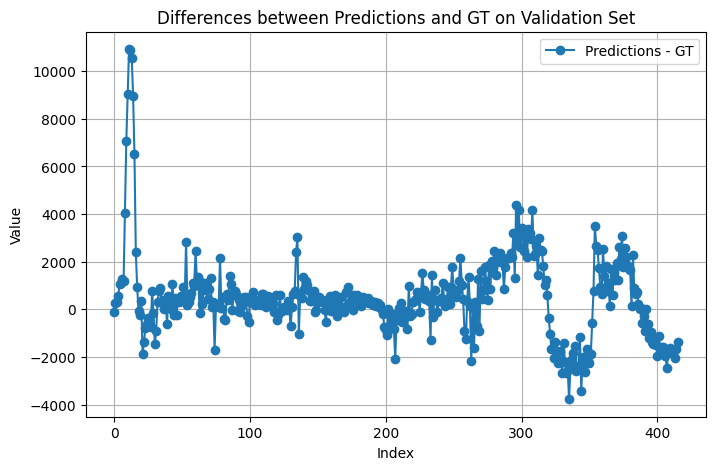

Return: 0.4717748165130615
Max Drawdown: -0.2592093348503113
Epoch [5/200], Loss: 0.3317
Epoch [10/200], Loss: 0.2356
Epoch [15/200], Loss: 0.4176
Epoch [20/200], Loss: 0.1030
Epoch [25/200], Loss: 0.1905
Epoch [30/200], Loss: 0.1317
Epoch [35/200], Loss: 0.1984
Epoch [40/200], Loss: 0.1662
Epoch [45/200], Loss: 0.0644
Epoch [50/200], Loss: 0.1293
Epoch [55/200], Loss: 0.3294
Epoch [60/200], Loss: 0.2506
Epoch [65/200], Loss: 0.3018
Epoch [70/200], Loss: 0.2251
Epoch [75/200], Loss: 0.0292
Epoch [80/200], Loss: 0.1755
Epoch [85/200], Loss: 0.0669
Epoch [90/200], Loss: 0.1259
Epoch [95/200], Loss: 0.0508
Epoch [100/200], Loss: 0.1327
Epoch [105/200], Loss: 0.1875
Epoch [110/200], Loss: 0.1796
Epoch [115/200], Loss: 0.0527
Epoch [120/200], Loss: 0.3183
Epoch [125/200], Loss: 0.1016
Epoch [130/200], Loss: 0.2023
Epoch [135/200], Loss: 0.1955
Epoch [140/200], Loss: 0.2025
Epoch [145/200], Loss: 0.1412
Epoch [150/200], Loss: 0.0605
Epoch [155/200], Loss: 0.1469
Epoch [160/200], Loss: 0.2452

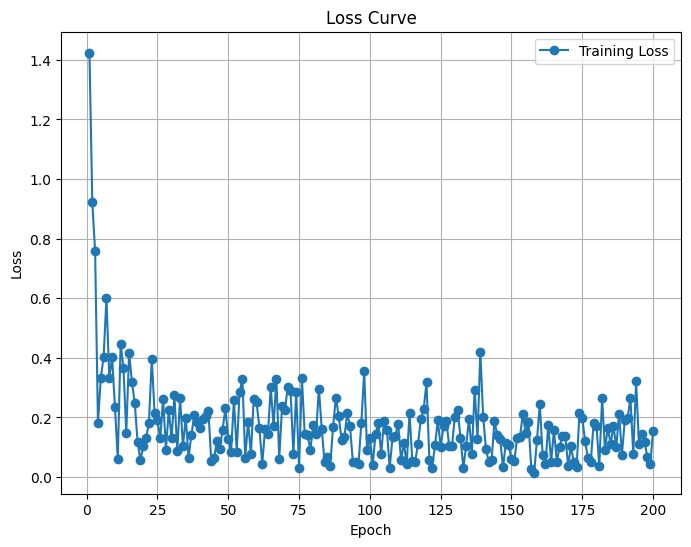

Predicted value for the first sample: 1.7901
Training Loss Scaling Unreversed: 0.13528521358966827
Training Loss Scaling Reversed: 978.1897583007812


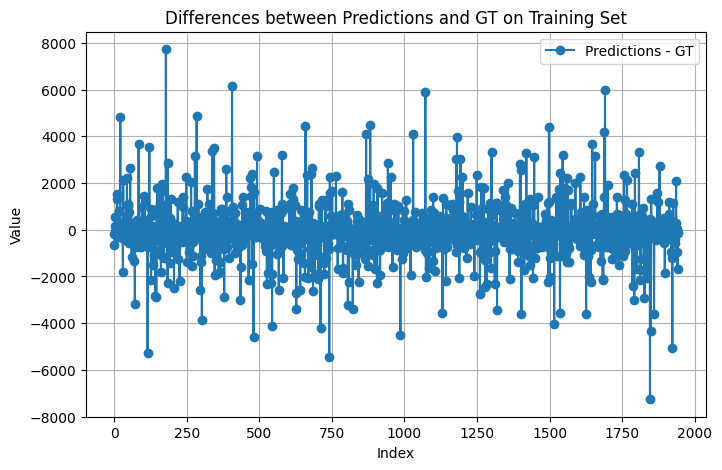

Predicted value for the first sample: 2.8325
Validation Loss Scaling Unreversed: 0.08482562005519867
Validation Loss Scaling Reversed: 613.3379516601562


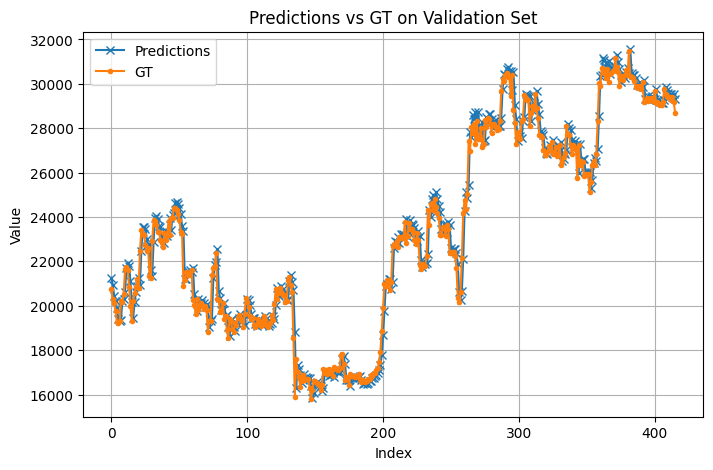

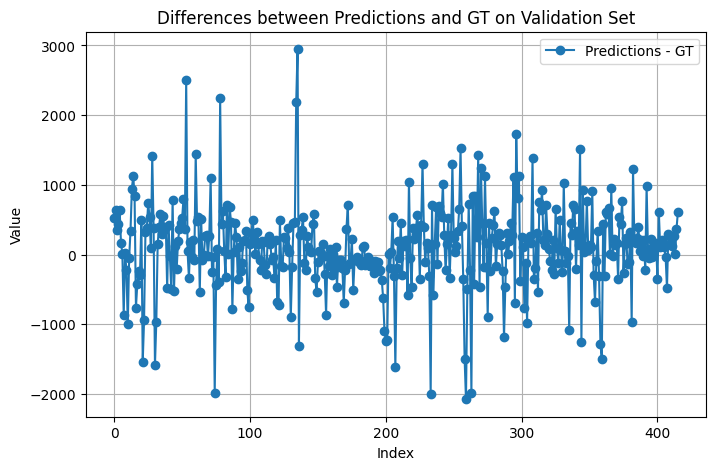

Return: 0.3364654779434204
Max Drawdown: -0.22200870513916016
Epoch [5/200], Loss: 1.6727
Epoch [10/200], Loss: 0.2286
Epoch [15/200], Loss: 0.1058
Epoch [20/200], Loss: 0.1050
Epoch [25/200], Loss: 0.9989
Epoch [30/200], Loss: 1.1401
Epoch [35/200], Loss: 0.6725
Epoch [40/200], Loss: 0.5249
Epoch [45/200], Loss: 0.9212
Epoch [50/200], Loss: 0.1700
Epoch [55/200], Loss: 0.0835
Epoch [60/200], Loss: 0.5860
Epoch [65/200], Loss: 0.3712
Epoch [70/200], Loss: 0.2513
Epoch [75/200], Loss: 0.1632
Epoch [80/200], Loss: 0.2885
Epoch [85/200], Loss: 0.4822
Epoch [90/200], Loss: 0.3240
Epoch [95/200], Loss: 0.1267
Epoch [100/200], Loss: 0.2115
Epoch [105/200], Loss: 0.0945
Epoch [110/200], Loss: 0.2561
Epoch [115/200], Loss: 0.2084
Epoch [120/200], Loss: 0.0961
Epoch [125/200], Loss: 0.3236
Epoch [130/200], Loss: 0.3619
Epoch [135/200], Loss: 0.1459
Epoch [140/200], Loss: 0.3923
Epoch [145/200], Loss: 0.0574
Epoch [150/200], Loss: 0.0474
Epoch [155/200], Loss: 0.3274
Epoch [160/200], Loss: 0.200

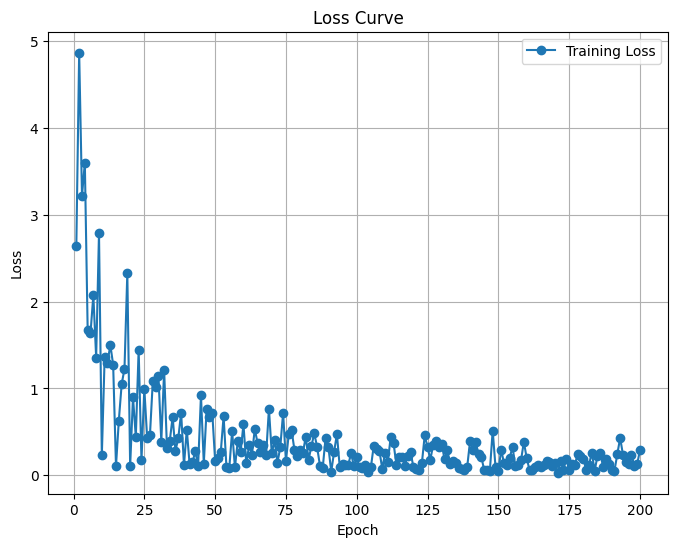

Predicted value for the first sample: 1.9649
Training Loss Scaling Unreversed: 0.2103990763425827
Training Loss Scaling Reversed: 1521.30615234375


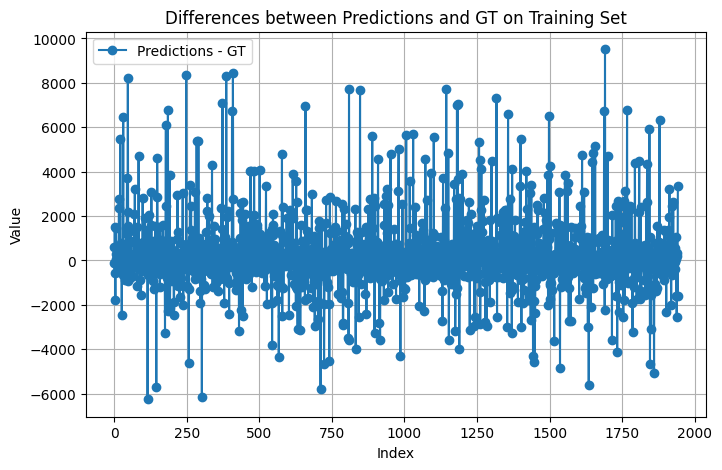

Predicted value for the first sample: 2.9403
Validation Loss Scaling Unreversed: 0.1785786747932434
Validation Loss Scaling Reversed: 1291.226318359375


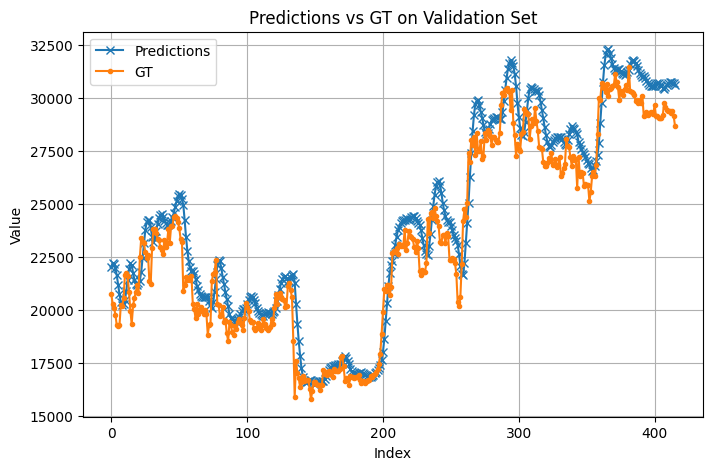

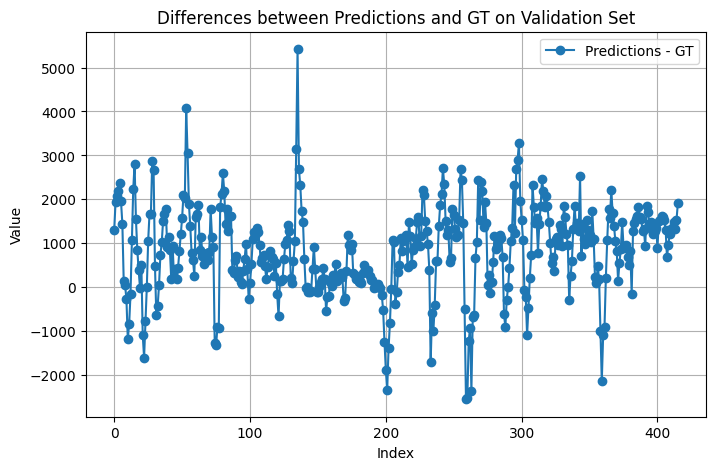

Return: -0.029833674430847168
Max Drawdown: -0.3529042899608612
Epoch [5/200], Loss: 0.3135
Epoch [10/200], Loss: 0.3800
Epoch [15/200], Loss: 0.1786
Epoch [20/200], Loss: 0.1209
Epoch [25/200], Loss: 0.0441
Epoch [30/200], Loss: 0.2086
Epoch [35/200], Loss: 0.1198
Epoch [40/200], Loss: 0.0947
Epoch [45/200], Loss: 0.2575
Epoch [50/200], Loss: 0.0832
Epoch [55/200], Loss: 0.2258
Epoch [60/200], Loss: 0.0511
Epoch [65/200], Loss: 0.3696
Epoch [70/200], Loss: 0.1150
Epoch [75/200], Loss: 0.1470
Epoch [80/200], Loss: 0.2715
Epoch [85/200], Loss: 0.3012
Epoch [90/200], Loss: 0.1856
Epoch [95/200], Loss: 0.0886
Epoch [100/200], Loss: 0.0567
Epoch [105/200], Loss: 0.0389
Epoch [110/200], Loss: 0.2161
Epoch [115/200], Loss: 0.0269
Epoch [120/200], Loss: 0.0556
Epoch [125/200], Loss: 0.0684
Epoch [130/200], Loss: 0.2662
Epoch [135/200], Loss: 0.1726
Epoch [140/200], Loss: 0.0797
Epoch [145/200], Loss: 0.2522
Epoch [150/200], Loss: 0.0735
Epoch [155/200], Loss: 0.0217
Epoch [160/200], Loss: 0.0

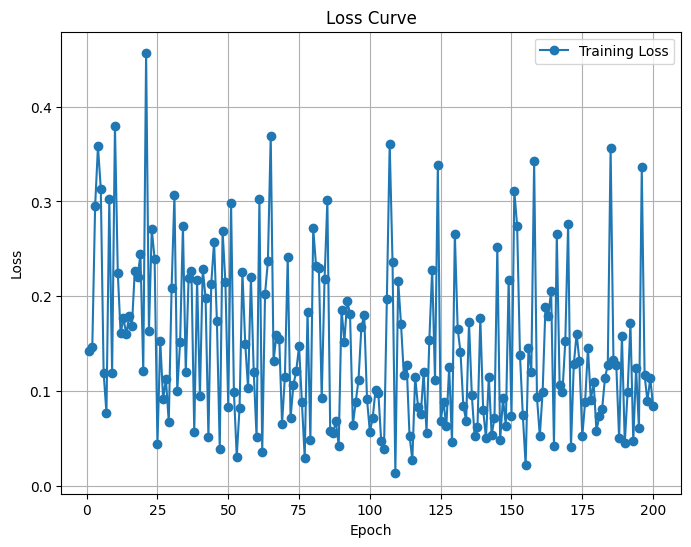

Predicted value for the first sample: 1.8188
Training Loss Scaling Unreversed: 0.1317766308784485
Training Loss Scaling Reversed: 952.8207397460938


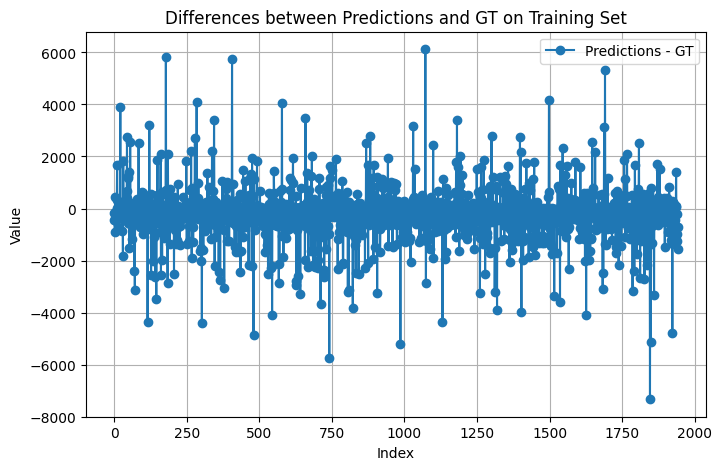

Predicted value for the first sample: 2.8884
Validation Loss Scaling Unreversed: 0.4050377905368805
Validation Loss Scaling Reversed: 2928.65576171875


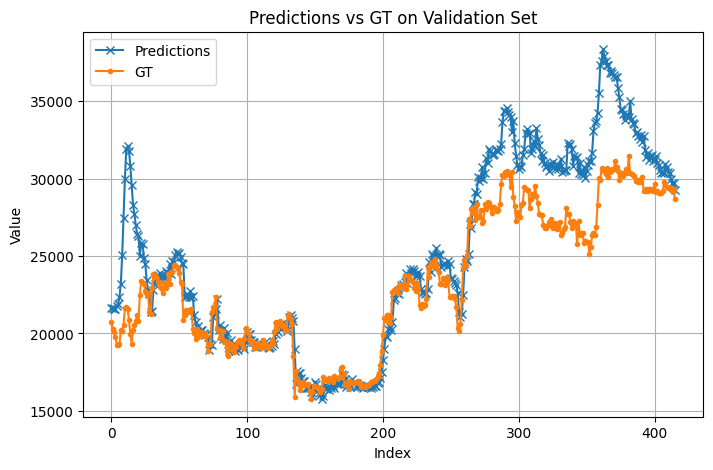

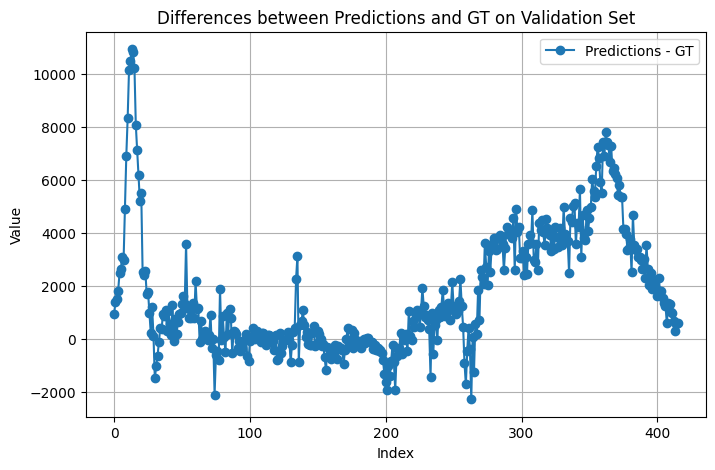

Return: 0.3020799160003662
Max Drawdown: -0.2928711771965027
Epoch [5/200], Loss: 0.3682
Epoch [10/200], Loss: 0.3132
Epoch [15/200], Loss: 0.1453
Epoch [20/200], Loss: 0.2515
Epoch [25/200], Loss: 0.0792
Epoch [30/200], Loss: 0.1034
Epoch [35/200], Loss: 0.1652
Epoch [40/200], Loss: 0.1010
Epoch [45/200], Loss: 0.2136
Epoch [50/200], Loss: 0.1422
Epoch [55/200], Loss: 0.2562
Epoch [60/200], Loss: 0.3751
Epoch [65/200], Loss: 0.2708
Epoch [70/200], Loss: 0.0633
Epoch [75/200], Loss: 0.1993
Epoch [80/200], Loss: 0.0399
Epoch [85/200], Loss: 0.1060
Epoch [90/200], Loss: 0.0682
Epoch [95/200], Loss: 0.3967
Epoch [100/200], Loss: 0.0414
Epoch [105/200], Loss: 0.2226
Epoch [110/200], Loss: 0.2445
Epoch [115/200], Loss: 0.2252
Epoch [120/200], Loss: 0.1386
Epoch [125/200], Loss: 0.3013
Epoch [130/200], Loss: 0.0543
Epoch [135/200], Loss: 0.0991
Epoch [140/200], Loss: 0.1093
Epoch [145/200], Loss: 0.0382
Epoch [150/200], Loss: 0.1295
Epoch [155/200], Loss: 0.1309
Epoch [160/200], Loss: 0.1168

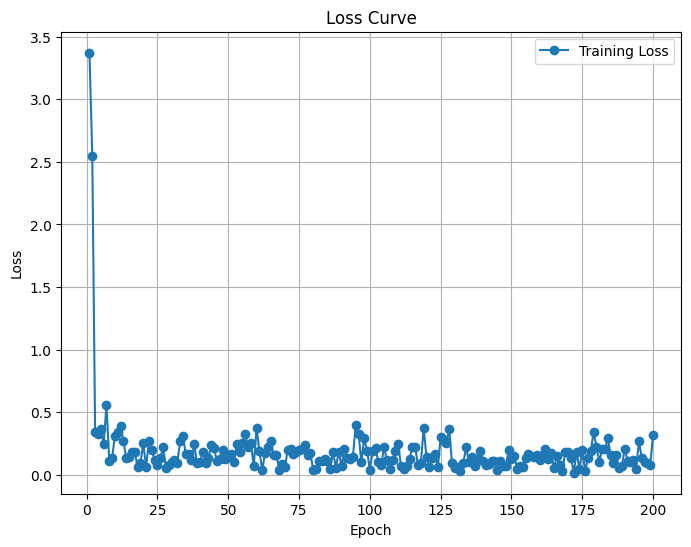

Predicted value for the first sample: 1.8850
Training Loss Scaling Unreversed: 0.15848663449287415
Training Loss Scaling Reversed: 1145.9493408203125


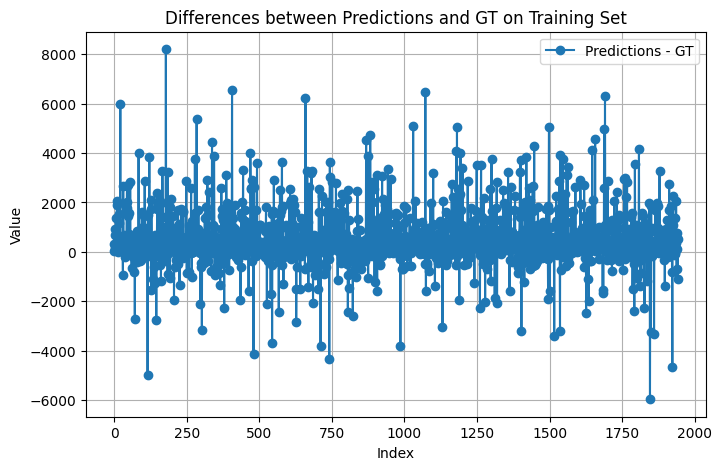

Predicted value for the first sample: 3.0858
Validation Loss Scaling Unreversed: 0.2646835744380951
Validation Loss Scaling Reversed: 1913.8140869140625


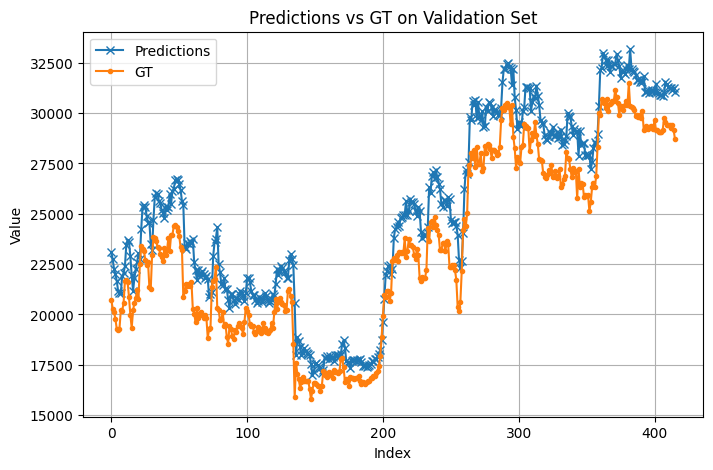

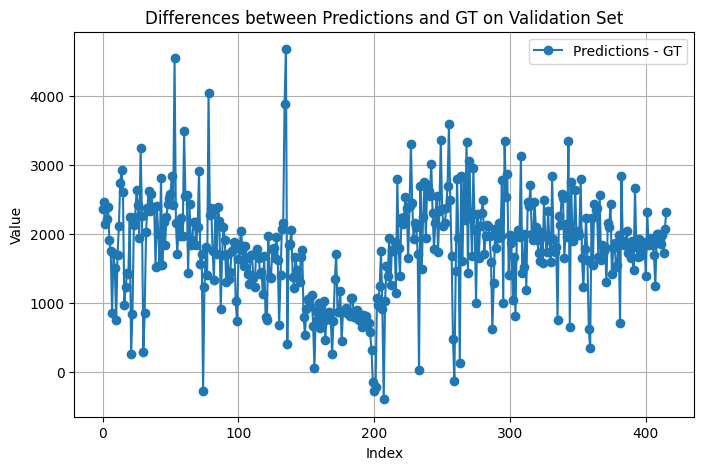

Return: 0.5764292478561401
Max Drawdown: -0.180079385638237
Epoch [5/200], Loss: 3.3831
Epoch [10/200], Loss: 2.5409
Epoch [15/200], Loss: 0.2949
Epoch [20/200], Loss: 0.0622
Epoch [25/200], Loss: 0.1105
Epoch [30/200], Loss: 0.6482
Epoch [35/200], Loss: 1.3025
Epoch [40/200], Loss: 0.5103
Epoch [45/200], Loss: 0.6814
Epoch [50/200], Loss: 0.0660
Epoch [55/200], Loss: 0.2630
Epoch [60/200], Loss: 0.2443
Epoch [65/200], Loss: 0.1933
Epoch [70/200], Loss: 0.0907
Epoch [75/200], Loss: 0.3923
Epoch [80/200], Loss: 0.3336
Epoch [85/200], Loss: 0.1397
Epoch [90/200], Loss: 0.2013
Epoch [95/200], Loss: 0.1117
Epoch [100/200], Loss: 0.0939
Epoch [105/200], Loss: 0.2913
Epoch [110/200], Loss: 0.1867
Epoch [115/200], Loss: 0.0801
Epoch [120/200], Loss: 0.2629
Epoch [125/200], Loss: 0.1040
Epoch [130/200], Loss: 0.3926
Epoch [135/200], Loss: 0.1834
Epoch [140/200], Loss: 0.1429
Epoch [145/200], Loss: 0.2953
Epoch [150/200], Loss: 0.4029
Epoch [155/200], Loss: 0.3798
Epoch [160/200], Loss: 0.2836


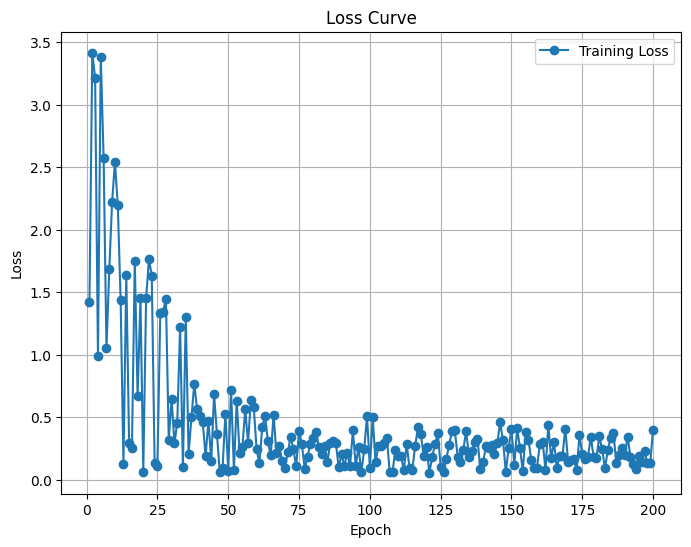

Predicted value for the first sample: 1.9686
Training Loss Scaling Unreversed: 0.20766858756542206
Training Loss Scaling Reversed: 1501.56298828125


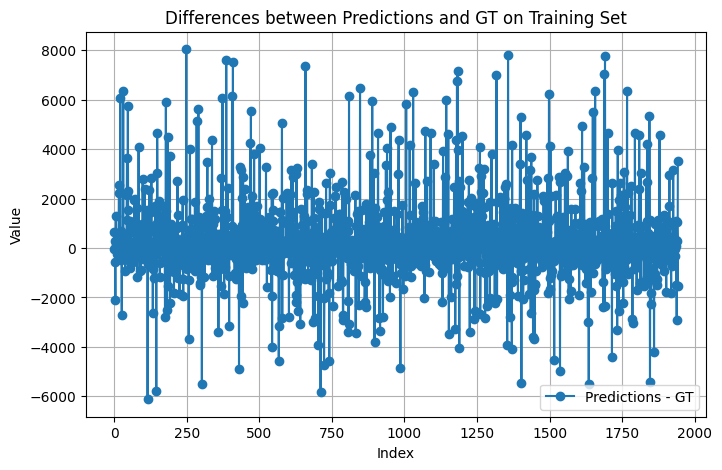

Predicted value for the first sample: 2.8893
Validation Loss Scaling Unreversed: 0.18411901593208313
Validation Loss Scaling Reversed: 1331.2861328125


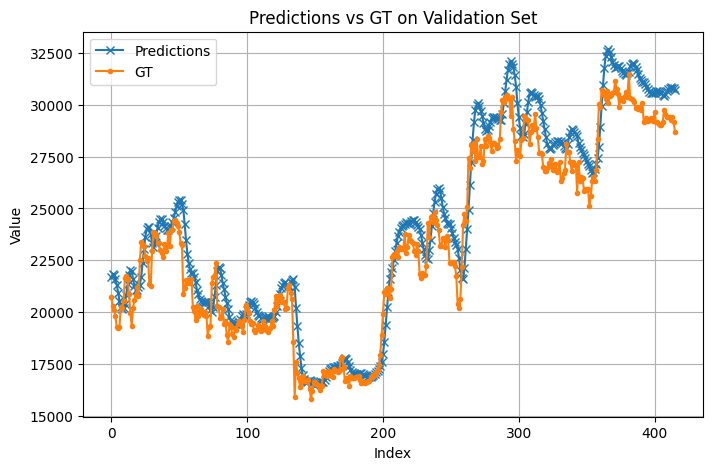

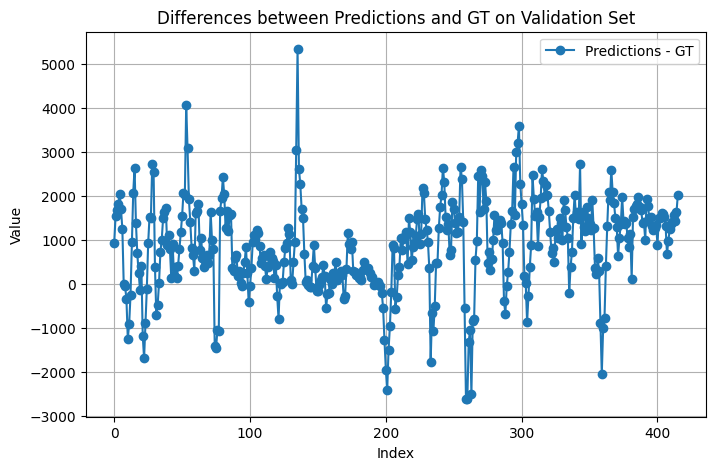

Return: 0.022796630859375
Max Drawdown: -0.3322237432003021
Epoch [5/200], Loss: 0.2532
Epoch [10/200], Loss: 0.1503
Epoch [15/200], Loss: 0.1415
Epoch [20/200], Loss: 0.2007
Epoch [25/200], Loss: 0.1533
Epoch [30/200], Loss: 0.1058
Epoch [35/200], Loss: 0.1457
Epoch [40/200], Loss: 0.2555
Epoch [45/200], Loss: 0.0844
Epoch [50/200], Loss: 0.1334
Epoch [55/200], Loss: 0.2522
Epoch [60/200], Loss: 0.1301
Epoch [65/200], Loss: 0.1624
Epoch [70/200], Loss: 0.1114
Epoch [75/200], Loss: 0.1694
Epoch [80/200], Loss: 0.0629
Epoch [85/200], Loss: 0.1226
Epoch [90/200], Loss: 0.1425
Epoch [95/200], Loss: 0.0793
Epoch [100/200], Loss: 0.1260
Epoch [105/200], Loss: 0.1112
Epoch [110/200], Loss: 0.0922
Epoch [115/200], Loss: 0.1240
Epoch [120/200], Loss: 0.1232
Epoch [125/200], Loss: 0.1195
Epoch [130/200], Loss: 0.1024
Epoch [135/200], Loss: 0.1908
Epoch [140/200], Loss: 0.2865
Epoch [145/200], Loss: 0.0709
Epoch [150/200], Loss: 0.1168
Epoch [155/200], Loss: 0.1811
Epoch [160/200], Loss: 0.1888


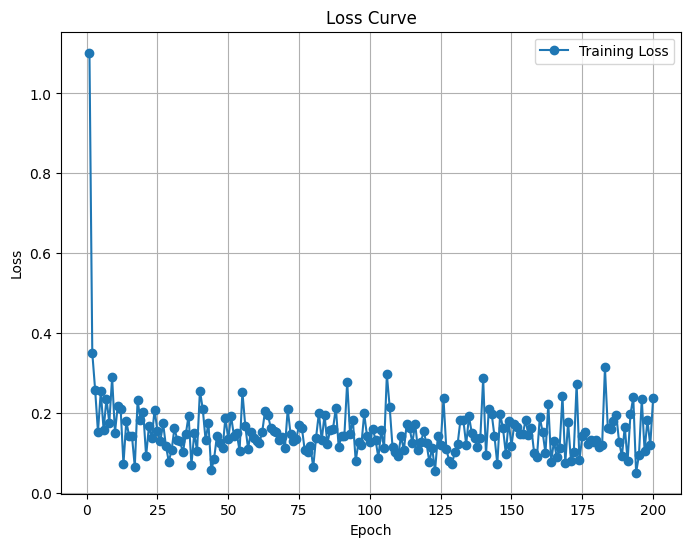

Predicted value for the first sample: 1.8218
Training Loss Scaling Unreversed: 0.1351519227027893
Training Loss Scaling Reversed: 977.2260131835938


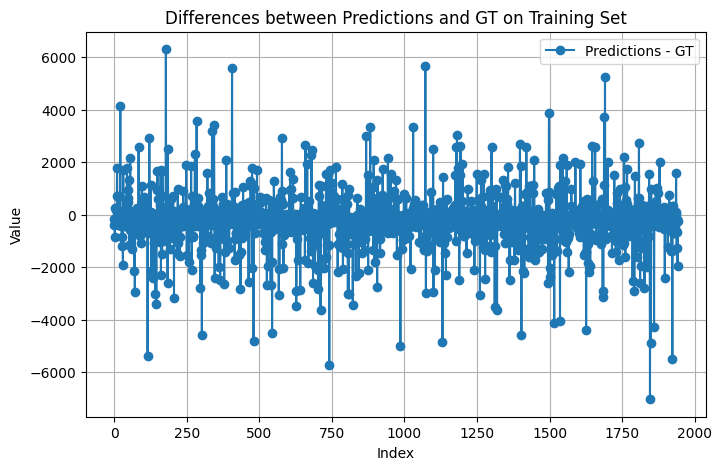

Predicted value for the first sample: 2.8711
Validation Loss Scaling Unreversed: 0.18222728371620178
Validation Loss Scaling Reversed: 1317.60791015625


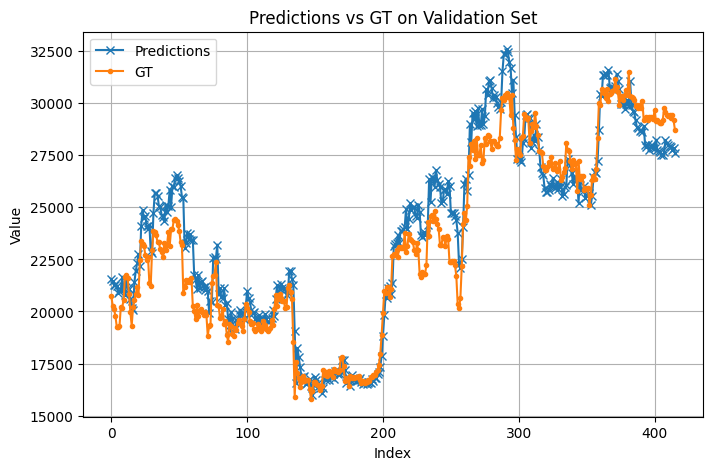

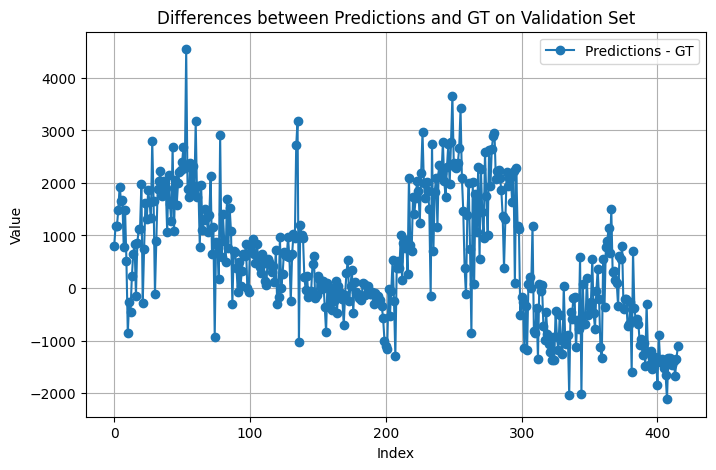

Return: 0.21720683574676514
Max Drawdown: -0.24600186944007874
Epoch [5/200], Loss: 1.6040
Epoch [10/200], Loss: 0.9928
Epoch [15/200], Loss: 0.6806
Epoch [20/200], Loss: 0.2635
Epoch [25/200], Loss: 0.2575
Epoch [30/200], Loss: 0.1707
Epoch [35/200], Loss: 0.1863
Epoch [40/200], Loss: 0.2092
Epoch [45/200], Loss: 0.2129
Epoch [50/200], Loss: 0.2043
Epoch [55/200], Loss: 0.0760
Epoch [60/200], Loss: 0.1705
Epoch [65/200], Loss: 0.2031
Epoch [70/200], Loss: 0.1755
Epoch [75/200], Loss: 0.1551
Epoch [80/200], Loss: 0.1467
Epoch [85/200], Loss: 0.1211
Epoch [90/200], Loss: 0.1786
Epoch [95/200], Loss: 0.1799
Epoch [100/200], Loss: 0.1740
Epoch [105/200], Loss: 0.1265
Epoch [110/200], Loss: 0.1738
Epoch [115/200], Loss: 0.1501
Epoch [120/200], Loss: 0.1717
Epoch [125/200], Loss: 0.1148
Epoch [130/200], Loss: 0.1855
Epoch [135/200], Loss: 0.1574
Epoch [140/200], Loss: 0.1452
Epoch [145/200], Loss: 0.1261
Epoch [150/200], Loss: 0.0630
Epoch [155/200], Loss: 0.0850
Epoch [160/200], Loss: 0.18

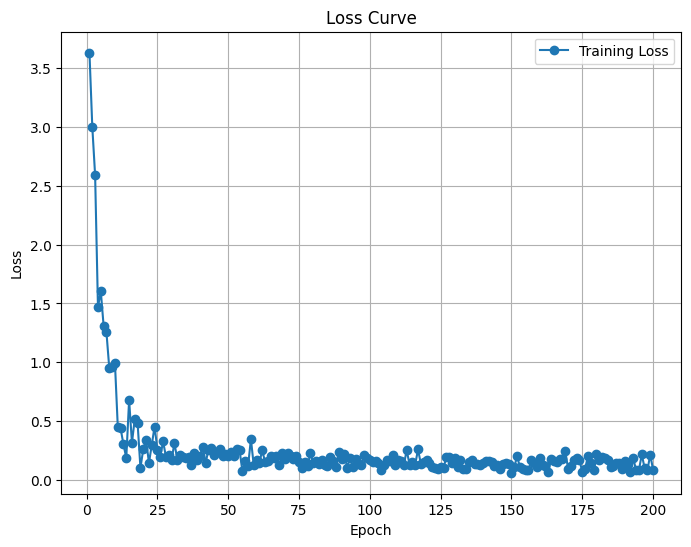

Predicted value for the first sample: 1.7981
Training Loss Scaling Unreversed: 0.13980086147785187
Training Loss Scaling Reversed: 1010.8405151367188


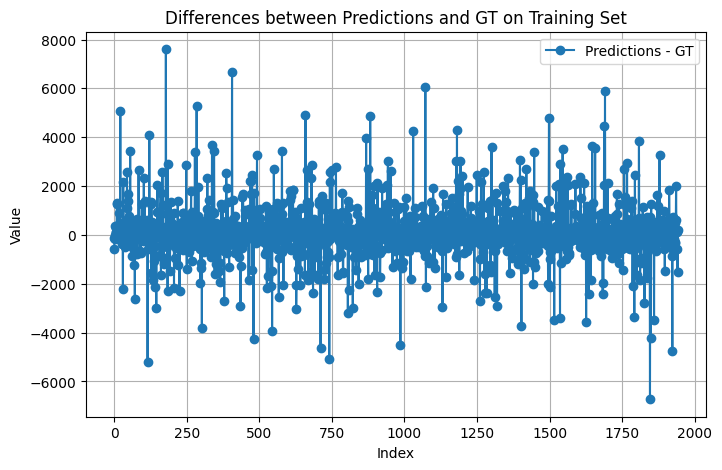

Predicted value for the first sample: 2.9168
Validation Loss Scaling Unreversed: 0.11107498407363892
Validation Loss Scaling Reversed: 803.1359252929688


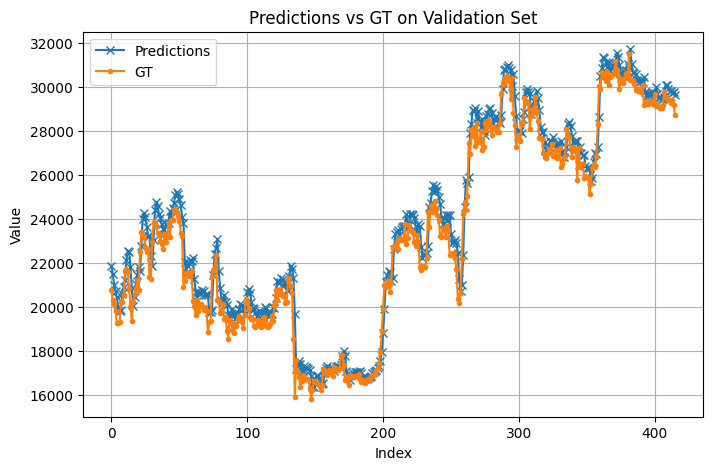

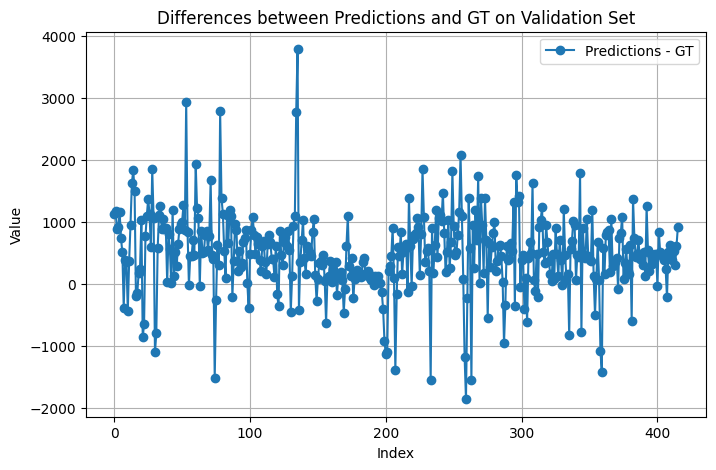

Return: 0.5317373275756836
Max Drawdown: -0.1710350662469864
Epoch [5/200], Loss: 3.0936
Epoch [10/200], Loss: 3.9461
Epoch [15/200], Loss: 2.3639
Epoch [20/200], Loss: 2.9967
Epoch [25/200], Loss: 2.3900
Epoch [30/200], Loss: 2.5337
Epoch [35/200], Loss: 1.6016
Epoch [40/200], Loss: 1.4267
Epoch [45/200], Loss: 1.0635
Epoch [50/200], Loss: 1.2982
Epoch [55/200], Loss: 0.9708
Epoch [60/200], Loss: 1.9527
Epoch [65/200], Loss: 1.1654
Epoch [70/200], Loss: 1.2103
Epoch [75/200], Loss: 1.0112
Epoch [80/200], Loss: 0.4138
Epoch [85/200], Loss: 1.1813
Epoch [90/200], Loss: 0.5414
Epoch [95/200], Loss: 1.1081
Epoch [100/200], Loss: 0.7435
Epoch [105/200], Loss: 0.8162
Epoch [110/200], Loss: 0.8504
Epoch [115/200], Loss: 0.7429
Epoch [120/200], Loss: 0.7853
Epoch [125/200], Loss: 0.6464
Epoch [130/200], Loss: 0.8905
Epoch [135/200], Loss: 1.2826
Epoch [140/200], Loss: 0.6263
Epoch [145/200], Loss: 0.7621
Epoch [150/200], Loss: 0.2510
Epoch [155/200], Loss: 0.2643
Epoch [160/200], Loss: 0.7795

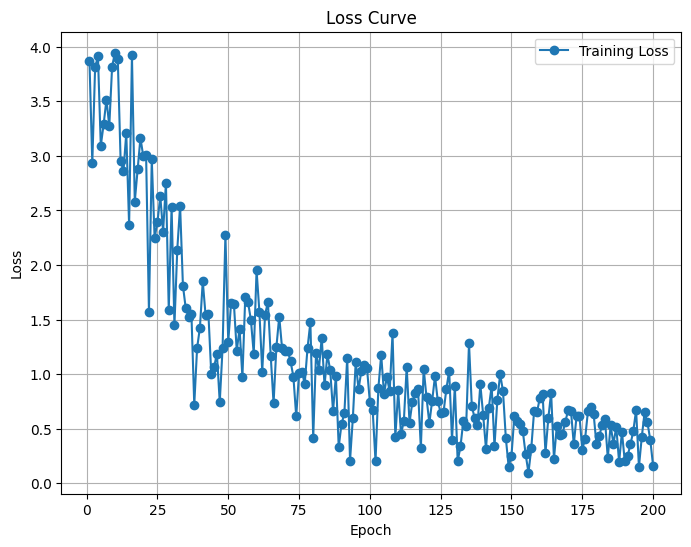

Predicted value for the first sample: 2.0157
Training Loss Scaling Unreversed: 0.4185349941253662
Training Loss Scaling Reversed: 3026.248291015625


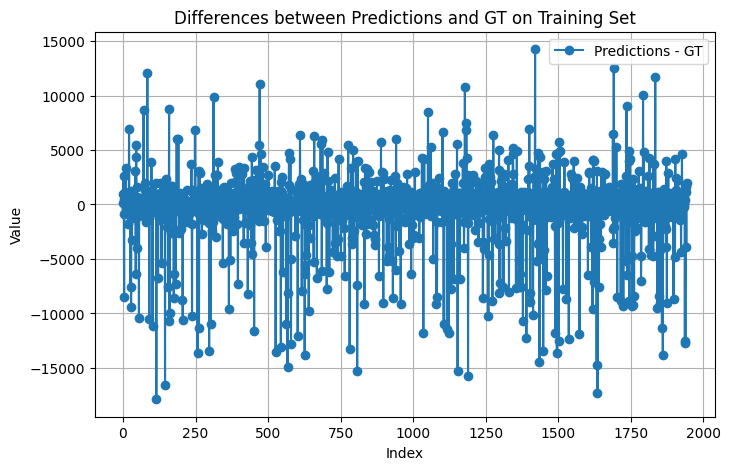

Predicted value for the first sample: 2.4313
Validation Loss Scaling Unreversed: 0.20869699120521545
Validation Loss Scaling Reversed: 1508.9991455078125


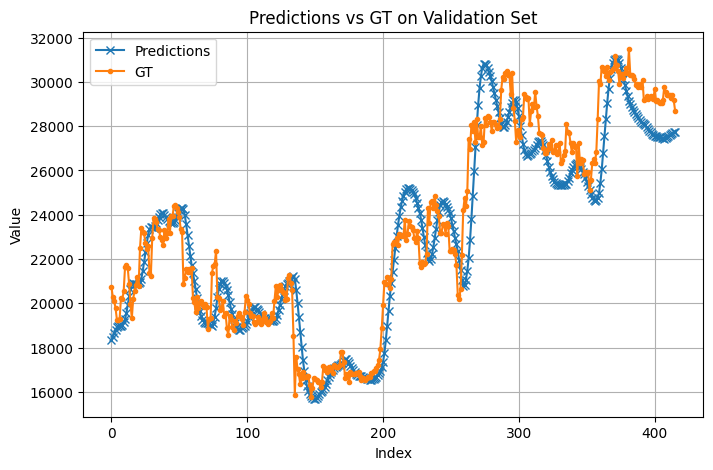

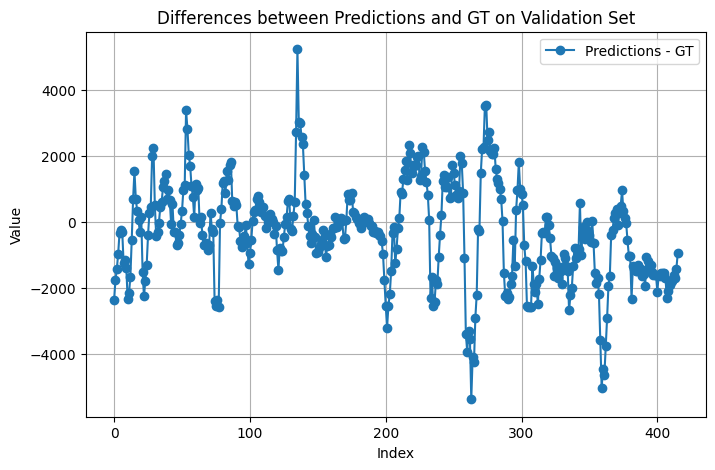

Return: 0.08152854442596436
Max Drawdown: -0.3170161843299866
Epoch [5/200], Loss: 0.4212
Epoch [10/200], Loss: 0.1453
Epoch [15/200], Loss: 0.1755
Epoch [20/200], Loss: 0.1569
Epoch [25/200], Loss: 0.2233
Epoch [30/200], Loss: 0.1477
Epoch [35/200], Loss: 0.2266
Epoch [40/200], Loss: 0.1111
Epoch [45/200], Loss: 0.3151
Epoch [50/200], Loss: 0.1920
Epoch [55/200], Loss: 0.1392
Epoch [60/200], Loss: 0.1181
Epoch [65/200], Loss: 0.2153
Epoch [70/200], Loss: 0.1979
Epoch [75/200], Loss: 0.1436
Epoch [80/200], Loss: 0.1257
Epoch [85/200], Loss: 0.2246
Epoch [90/200], Loss: 0.1141
Epoch [95/200], Loss: 0.0999
Epoch [100/200], Loss: 0.0996
Epoch [105/200], Loss: 0.1791
Epoch [110/200], Loss: 0.1335
Epoch [115/200], Loss: 0.1624
Epoch [120/200], Loss: 0.1226
Epoch [125/200], Loss: 0.1099
Epoch [130/200], Loss: 0.1225
Epoch [135/200], Loss: 0.1843
Epoch [140/200], Loss: 0.1149
Epoch [145/200], Loss: 0.1552
Epoch [150/200], Loss: 0.1563
Epoch [155/200], Loss: 0.2548
Epoch [160/200], Loss: 0.253

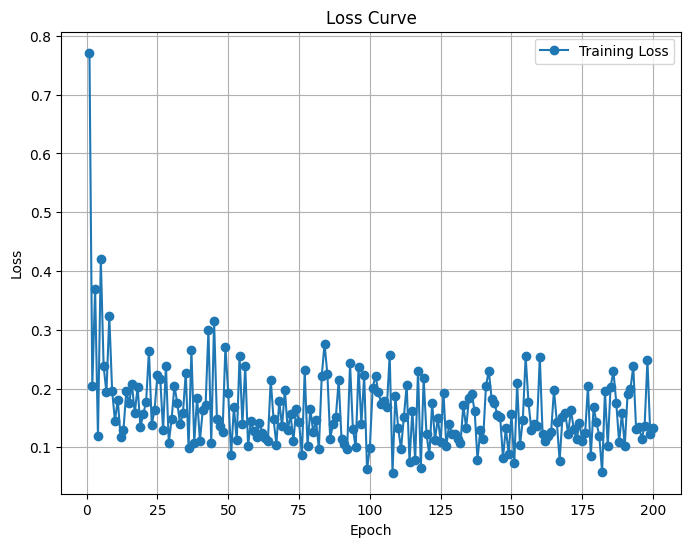

Predicted value for the first sample: 1.8713
Training Loss Scaling Unreversed: 0.14796578884124756
Training Loss Scaling Reversed: 1069.8775634765625


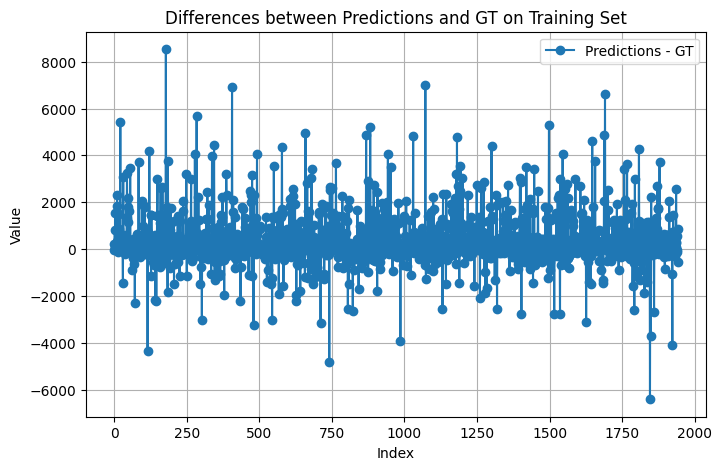

Predicted value for the first sample: 2.9642
Validation Loss Scaling Unreversed: 0.12919729948043823
Validation Loss Scaling Reversed: 934.1708374023438


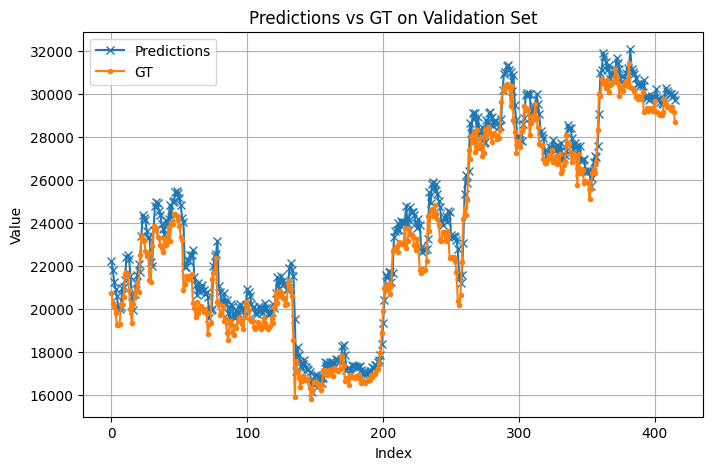

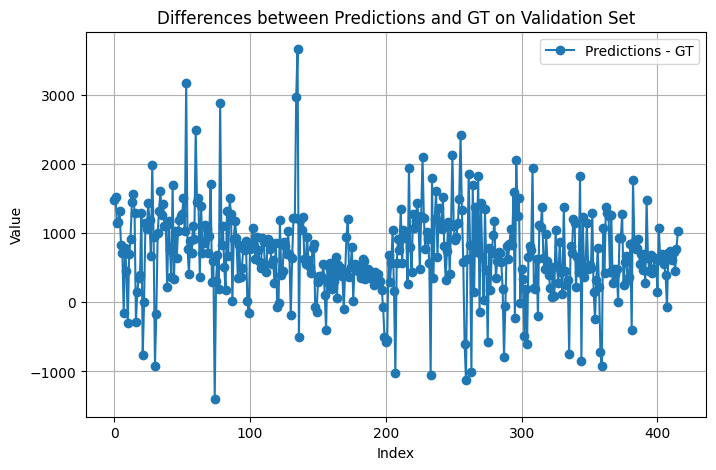

Return: 0.48155105113983154
Max Drawdown: -0.21987542510032654
Epoch [5/200], Loss: 0.9290
Epoch [10/200], Loss: 0.4912
Epoch [15/200], Loss: 0.3015
Epoch [20/200], Loss: 0.1464
Epoch [25/200], Loss: 0.3539
Epoch [30/200], Loss: 0.1530
Epoch [35/200], Loss: 0.3043
Epoch [40/200], Loss: 0.1229
Epoch [45/200], Loss: 0.1399
Epoch [50/200], Loss: 0.2301
Epoch [55/200], Loss: 0.2508
Epoch [60/200], Loss: 0.2856
Epoch [65/200], Loss: 0.1334
Epoch [70/200], Loss: 0.1873
Epoch [75/200], Loss: 0.2628
Epoch [80/200], Loss: 0.1035
Epoch [85/200], Loss: 0.2474
Epoch [90/200], Loss: 0.1706
Epoch [95/200], Loss: 0.2007
Epoch [100/200], Loss: 0.1408
Epoch [105/200], Loss: 0.1593
Epoch [110/200], Loss: 0.1534
Epoch [115/200], Loss: 0.1588
Epoch [120/200], Loss: 0.0916
Epoch [125/200], Loss: 0.1148
Epoch [130/200], Loss: 0.1739
Epoch [135/200], Loss: 0.1766
Epoch [140/200], Loss: 0.0714
Epoch [145/200], Loss: 0.1446
Epoch [150/200], Loss: 0.2120
Epoch [155/200], Loss: 0.1717
Epoch [160/200], Loss: 0.13

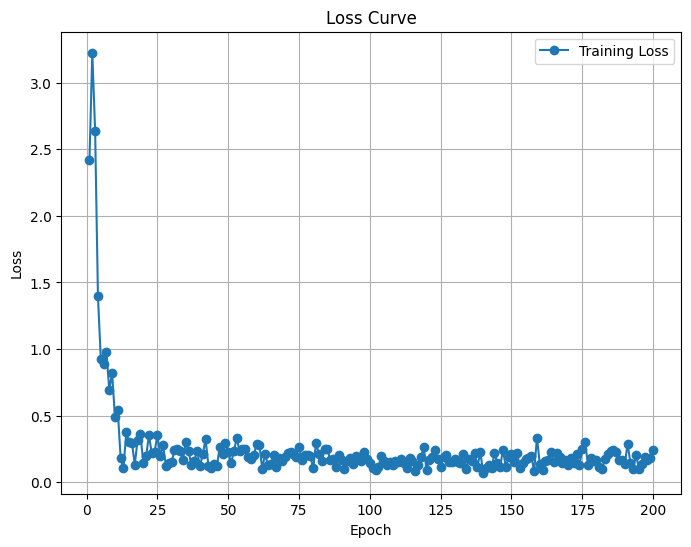

Predicted value for the first sample: 1.8136
Training Loss Scaling Unreversed: 0.14355197548866272
Training Loss Scaling Reversed: 1037.963134765625


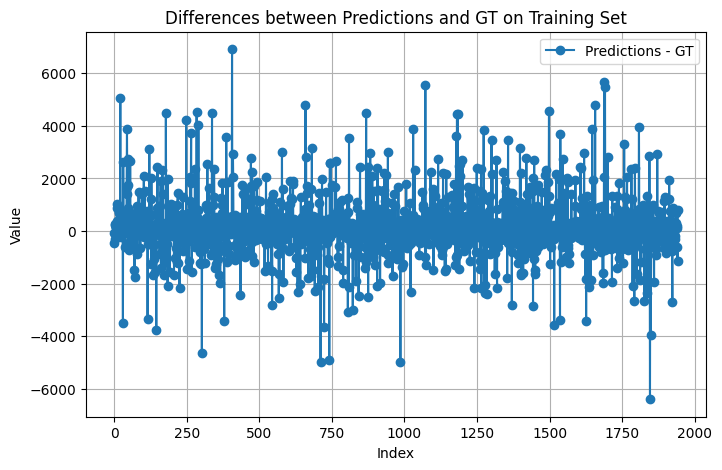

Predicted value for the first sample: 2.9178
Validation Loss Scaling Unreversed: 0.10727082937955856
Validation Loss Scaling Reversed: 775.6297607421875


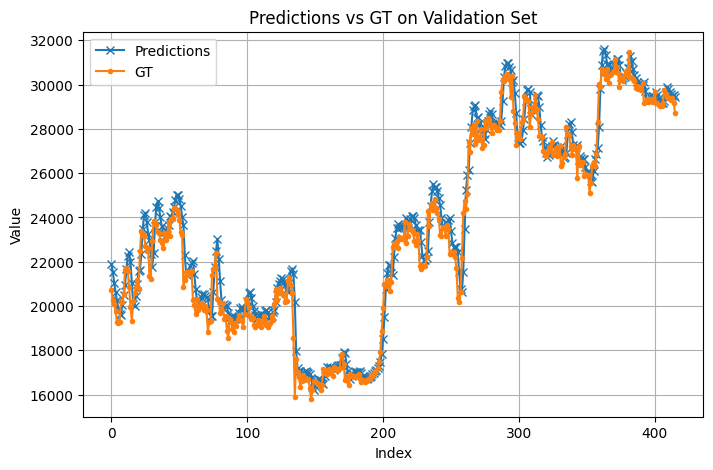

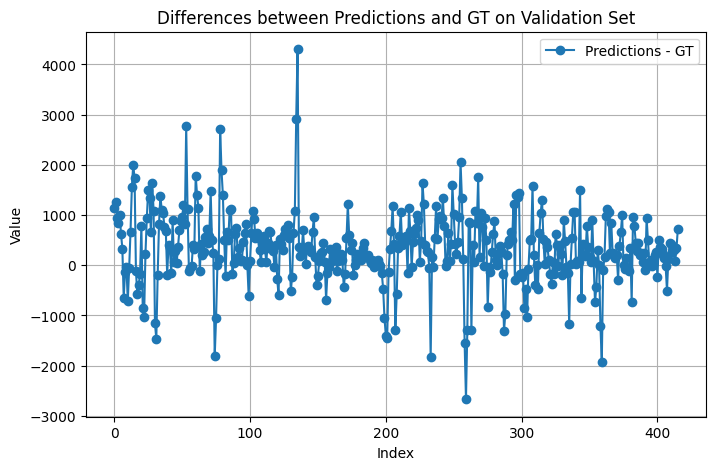

Return: 0.1703646183013916
Max Drawdown: -0.24974684417247772
Epoch [5/200], Loss: 3.4485
Epoch [10/200], Loss: 2.6446
Epoch [15/200], Loss: 3.1127
Epoch [20/200], Loss: 2.7721
Epoch [25/200], Loss: 2.4216
Epoch [30/200], Loss: 2.7001
Epoch [35/200], Loss: 2.1390
Epoch [40/200], Loss: 1.2939
Epoch [45/200], Loss: 1.2273
Epoch [50/200], Loss: 0.9734
Epoch [55/200], Loss: 1.1314
Epoch [60/200], Loss: 1.3911
Epoch [65/200], Loss: 1.2970
Epoch [70/200], Loss: 0.8935
Epoch [75/200], Loss: 1.0484
Epoch [80/200], Loss: 1.3511
Epoch [85/200], Loss: 0.7249
Epoch [90/200], Loss: 0.6981
Epoch [95/200], Loss: 0.8112
Epoch [100/200], Loss: 0.2045
Epoch [105/200], Loss: 0.6897
Epoch [110/200], Loss: 0.5089
Epoch [115/200], Loss: 0.5679
Epoch [120/200], Loss: 0.8399
Epoch [125/200], Loss: 0.7609
Epoch [130/200], Loss: 0.4962
Epoch [135/200], Loss: 0.5076
Epoch [140/200], Loss: 0.6808
Epoch [145/200], Loss: 0.1724
Epoch [150/200], Loss: 0.5601
Epoch [155/200], Loss: 0.3053
Epoch [160/200], Loss: 0.569

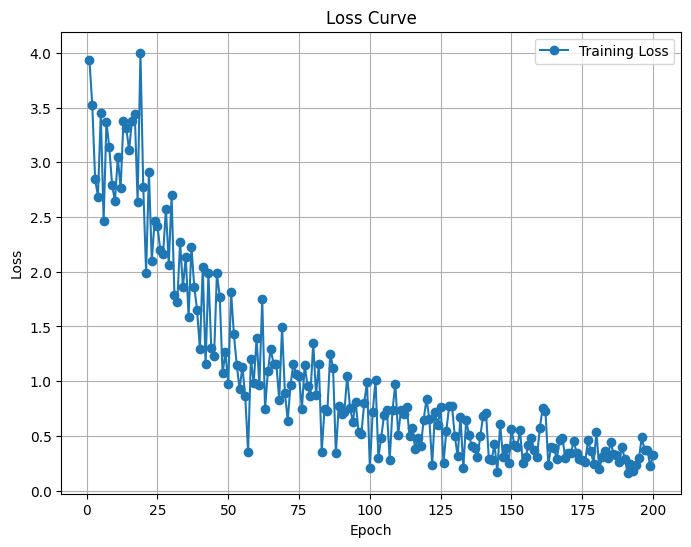

Predicted value for the first sample: 2.0416
Training Loss Scaling Unreversed: 0.31812262535095215
Training Loss Scaling Reversed: 2300.209228515625


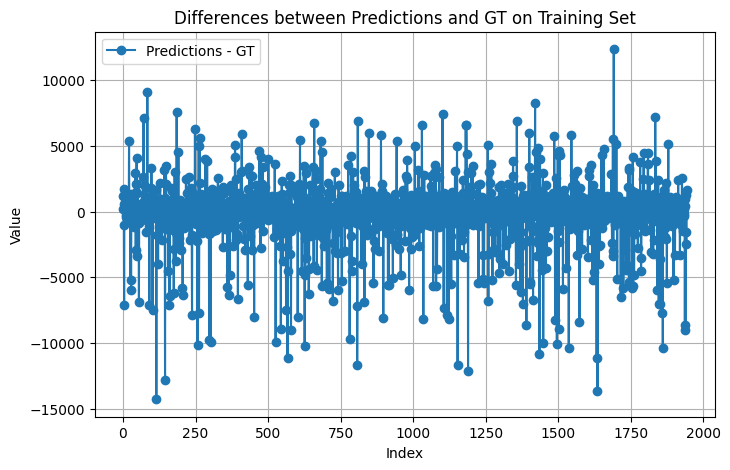

Predicted value for the first sample: 2.6733
Validation Loss Scaling Unreversed: 0.17220541834831238
Validation Loss Scaling Reversed: 1245.1441650390625


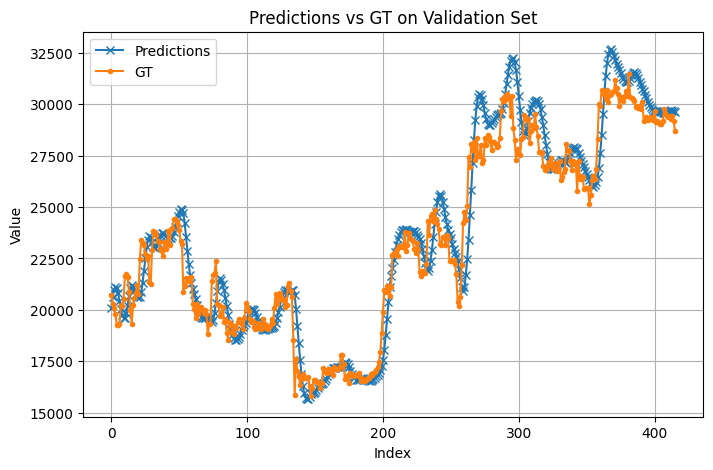

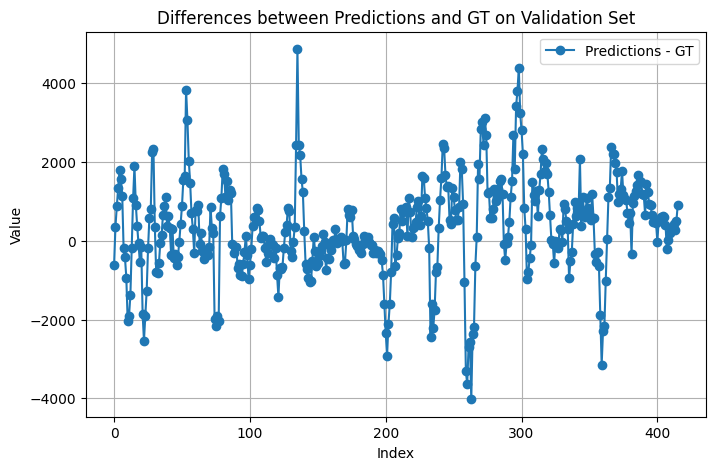

Return: -0.11098122596740723
Max Drawdown: -0.37067705392837524
Epoch [5/200], Loss: 0.2754
Epoch [10/200], Loss: 0.2549
Epoch [15/200], Loss: 0.1925
Epoch [20/200], Loss: 0.1254
Epoch [25/200], Loss: 0.1694
Epoch [30/200], Loss: 0.0803
Epoch [35/200], Loss: 0.0984
Epoch [40/200], Loss: 0.0690
Epoch [45/200], Loss: 0.1576
Epoch [50/200], Loss: 0.1745
Epoch [55/200], Loss: 0.1020
Epoch [60/200], Loss: 0.2893
Epoch [65/200], Loss: 0.0993
Epoch [70/200], Loss: 0.1272
Epoch [75/200], Loss: 0.1698
Epoch [80/200], Loss: 0.0658
Epoch [85/200], Loss: 0.1584
Epoch [90/200], Loss: 0.1099
Epoch [95/200], Loss: 0.0968
Epoch [100/200], Loss: 0.0786
Epoch [105/200], Loss: 0.1578
Epoch [110/200], Loss: 0.0753
Epoch [115/200], Loss: 0.1070
Epoch [120/200], Loss: 0.0865
Epoch [125/200], Loss: 0.1233
Epoch [130/200], Loss: 0.1069
Epoch [135/200], Loss: 0.1037
Epoch [140/200], Loss: 0.1959
Epoch [145/200], Loss: 0.1859
Epoch [150/200], Loss: 0.1887
Epoch [155/200], Loss: 0.2220
Epoch [160/200], Loss: 0.0

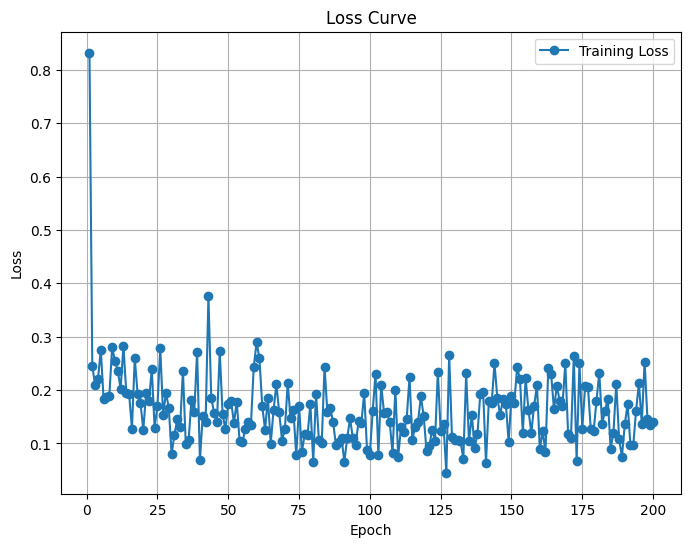

Predicted value for the first sample: 1.8276
Training Loss Scaling Unreversed: 0.13478438556194305
Training Loss Scaling Reversed: 974.5684204101562


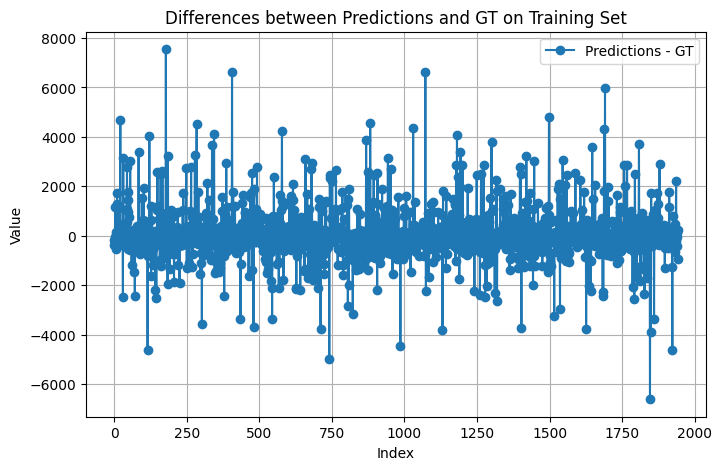

Predicted value for the first sample: 2.9279
Validation Loss Scaling Unreversed: 0.17181071639060974
Validation Loss Scaling Reversed: 1242.2901611328125


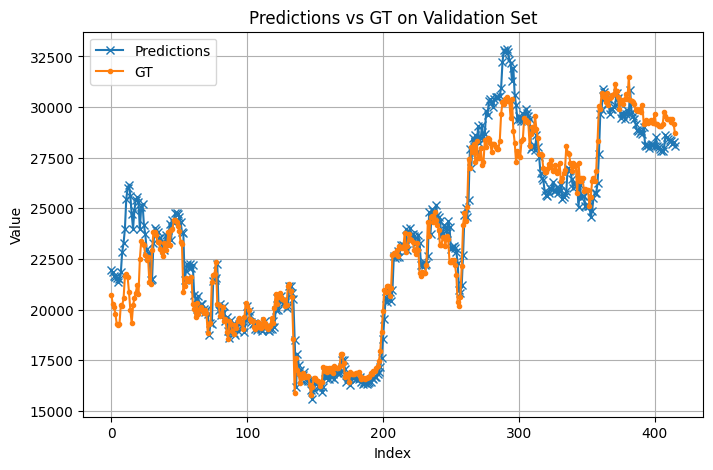

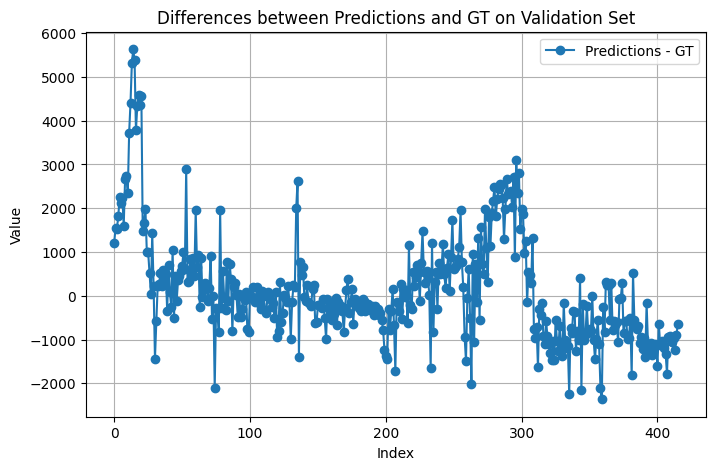

Return: 0.43666136264801025
Max Drawdown: -0.22873470187187195
Epoch [5/200], Loss: 1.7798
Epoch [10/200], Loss: 0.6649
Epoch [15/200], Loss: 0.4224
Epoch [20/200], Loss: 0.2212
Epoch [25/200], Loss: 0.1335
Epoch [30/200], Loss: 0.1158
Epoch [35/200], Loss: 0.1870
Epoch [40/200], Loss: 0.1747
Epoch [45/200], Loss: 0.1816
Epoch [50/200], Loss: 0.2439
Epoch [55/200], Loss: 0.3305
Epoch [60/200], Loss: 0.2188
Epoch [65/200], Loss: 0.2012
Epoch [70/200], Loss: 0.1461
Epoch [75/200], Loss: 0.1720
Epoch [80/200], Loss: 0.1720
Epoch [85/200], Loss: 0.2575
Epoch [90/200], Loss: 0.1514
Epoch [95/200], Loss: 0.1232
Epoch [100/200], Loss: 0.1115
Epoch [105/200], Loss: 0.1811
Epoch [110/200], Loss: 0.1506
Epoch [115/200], Loss: 0.1048
Epoch [120/200], Loss: 0.1248
Epoch [125/200], Loss: 0.1925
Epoch [130/200], Loss: 0.0981
Epoch [135/200], Loss: 0.2211
Epoch [140/200], Loss: 0.2091
Epoch [145/200], Loss: 0.1501
Epoch [150/200], Loss: 0.0666
Epoch [155/200], Loss: 0.1269
Epoch [160/200], Loss: 0.14

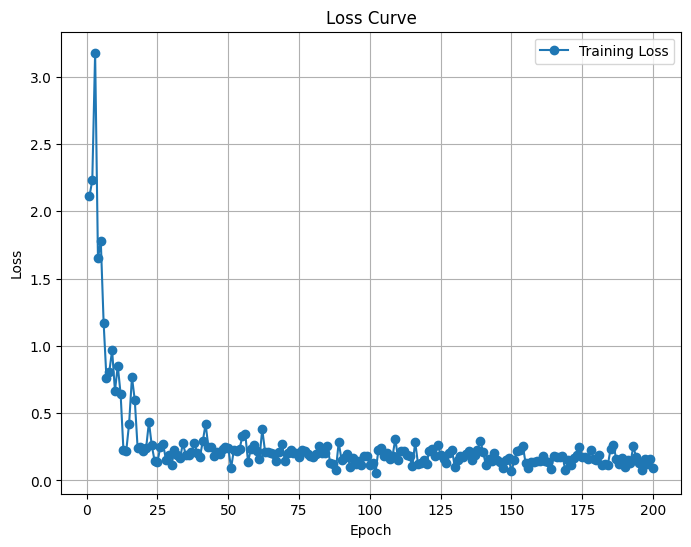

Predicted value for the first sample: 1.8293
Training Loss Scaling Unreversed: 0.15241995453834534
Training Loss Scaling Reversed: 1102.083740234375


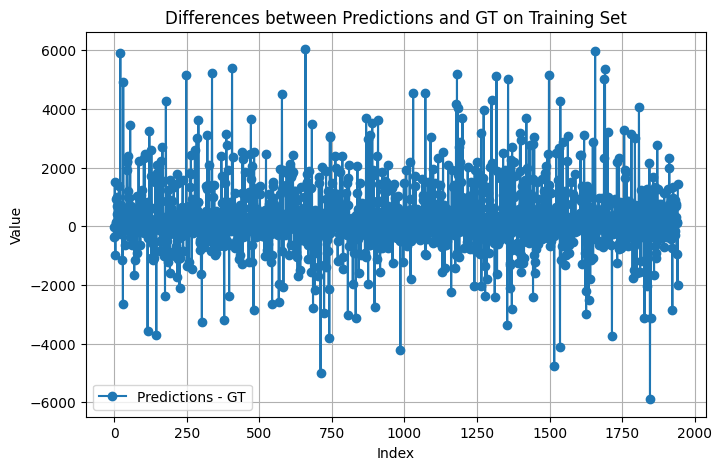

Predicted value for the first sample: 3.0798
Validation Loss Scaling Unreversed: 0.19086763262748718
Validation Loss Scaling Reversed: 1380.0826416015625


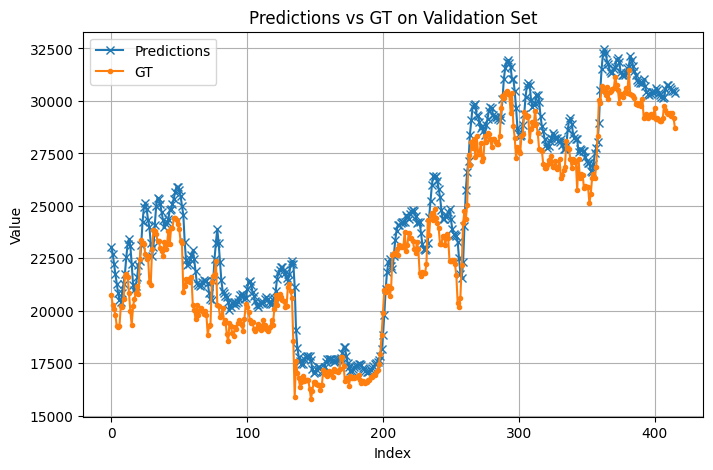

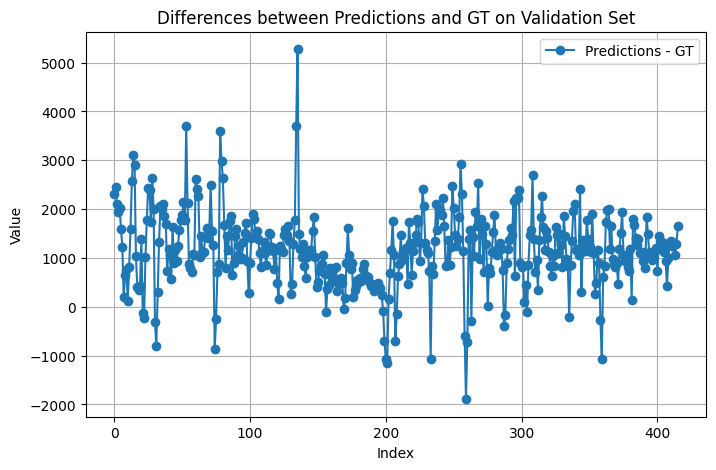

Return: 0.5096797943115234
Max Drawdown: -0.17735996842384338
Epoch [5/200], Loss: 3.7120
Epoch [10/200], Loss: 2.8636
Epoch [15/200], Loss: 1.8235
Epoch [20/200], Loss: 2.9799
Epoch [25/200], Loss: 2.1781
Epoch [30/200], Loss: 2.3177
Epoch [35/200], Loss: 1.5192
Epoch [40/200], Loss: 1.0644
Epoch [45/200], Loss: 1.3705
Epoch [50/200], Loss: 1.6727
Epoch [55/200], Loss: 1.0797
Epoch [60/200], Loss: 0.4245
Epoch [65/200], Loss: 1.1844
Epoch [70/200], Loss: 1.0098
Epoch [75/200], Loss: 0.5071
Epoch [80/200], Loss: 0.8727
Epoch [85/200], Loss: 1.2142
Epoch [90/200], Loss: 0.7473
Epoch [95/200], Loss: 0.4074
Epoch [100/200], Loss: 0.6059
Epoch [105/200], Loss: 0.5117
Epoch [110/200], Loss: 1.0233
Epoch [115/200], Loss: 0.1670
Epoch [120/200], Loss: 0.5117
Epoch [125/200], Loss: 0.3919
Epoch [130/200], Loss: 0.4873
Epoch [135/200], Loss: 0.1430
Epoch [140/200], Loss: 0.3609
Epoch [145/200], Loss: 0.2800
Epoch [150/200], Loss: 0.4600
Epoch [155/200], Loss: 0.4259
Epoch [160/200], Loss: 0.386

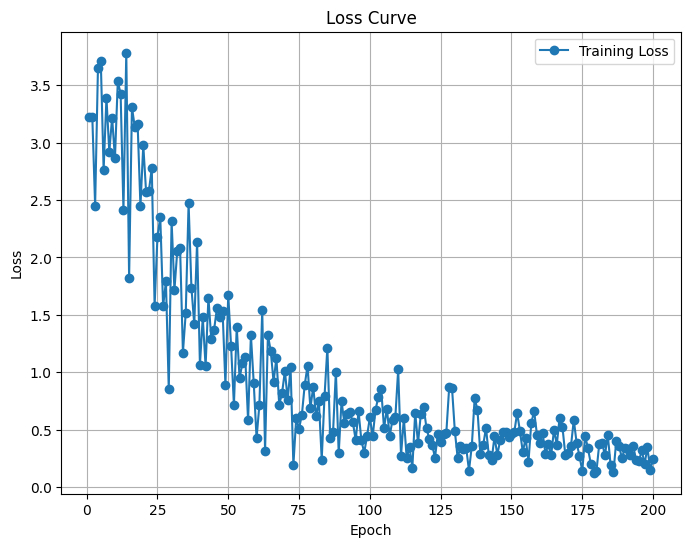

Predicted value for the first sample: 2.0488
Training Loss Scaling Unreversed: 0.313728004693985
Training Loss Scaling Reversed: 2268.43359375


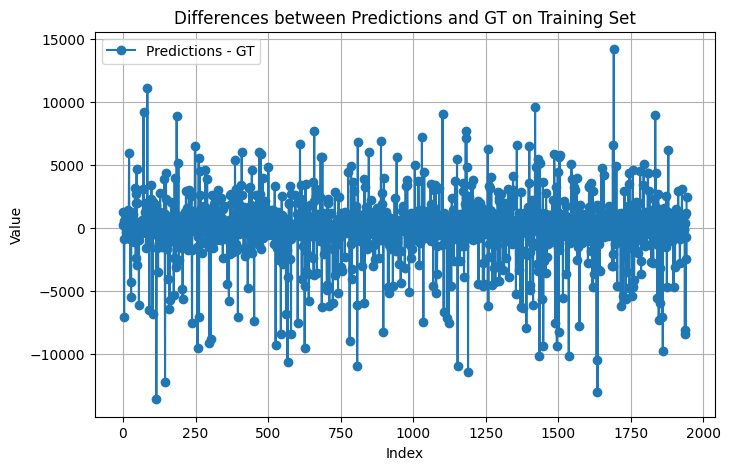

Predicted value for the first sample: 2.7598
Validation Loss Scaling Unreversed: 0.15413209795951843
Validation Loss Scaling Reversed: 1114.463623046875


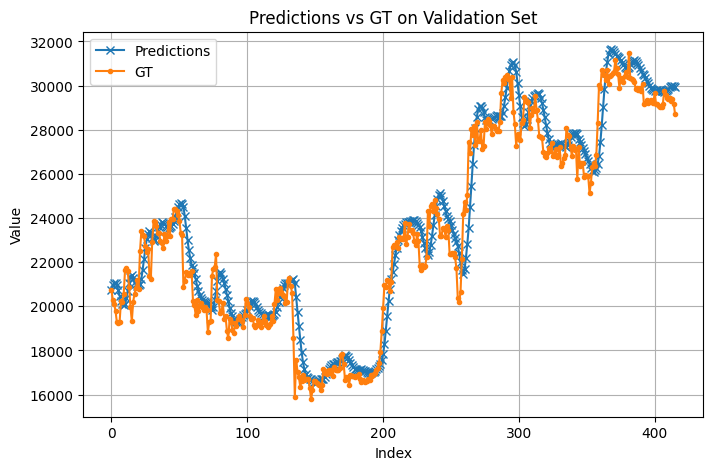

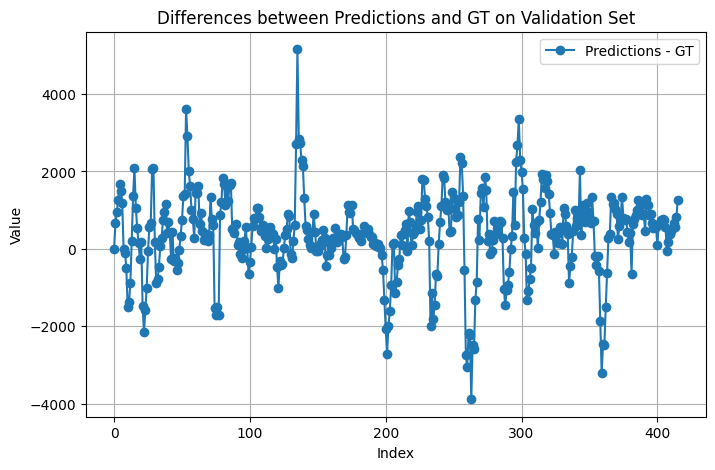

Return: -0.01744389533996582
Max Drawdown: -0.3306840658187866
Epoch [5/200], Loss: 0.2903
Epoch [10/200], Loss: 0.2074
Epoch [15/200], Loss: 0.2290
Epoch [20/200], Loss: 0.1774
Epoch [25/200], Loss: 0.1697
Epoch [30/200], Loss: 0.2217
Epoch [35/200], Loss: 0.1323
Epoch [40/200], Loss: 0.2016
Epoch [45/200], Loss: 0.1437
Epoch [50/200], Loss: 0.1402
Epoch [55/200], Loss: 0.1717
Epoch [60/200], Loss: 0.0602
Epoch [65/200], Loss: 0.1173
Epoch [70/200], Loss: 0.0741
Epoch [75/200], Loss: 0.1792
Epoch [80/200], Loss: 0.1393
Epoch [85/200], Loss: 0.1171
Epoch [90/200], Loss: 0.1705
Epoch [95/200], Loss: 0.1050
Epoch [100/200], Loss: 0.1606
Epoch [105/200], Loss: 0.1596
Epoch [110/200], Loss: 0.1843
Epoch [115/200], Loss: 0.2304
Epoch [120/200], Loss: 0.0842
Epoch [125/200], Loss: 0.2379
Epoch [130/200], Loss: 0.1934
Epoch [135/200], Loss: 0.2308
Epoch [140/200], Loss: 0.1303
Epoch [145/200], Loss: 0.0993
Epoch [150/200], Loss: 0.1378
Epoch [155/200], Loss: 0.1592
Epoch [160/200], Loss: 0.13

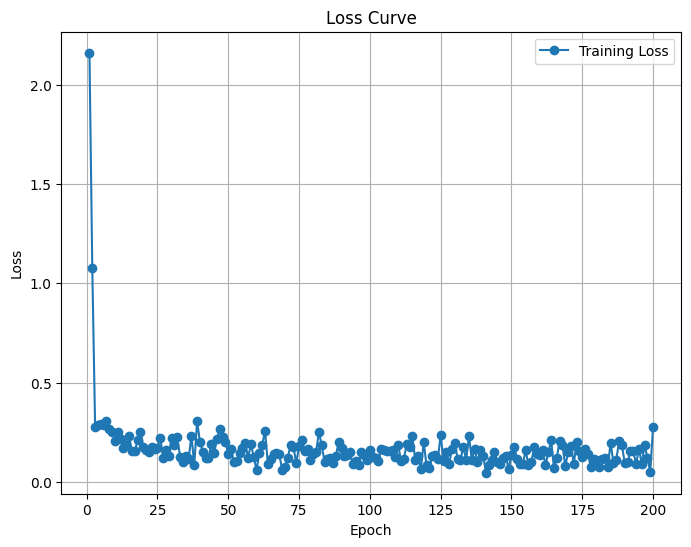

Predicted value for the first sample: 1.8932
Training Loss Scaling Unreversed: 0.14957687258720398
Training Loss Scaling Reversed: 1081.526611328125


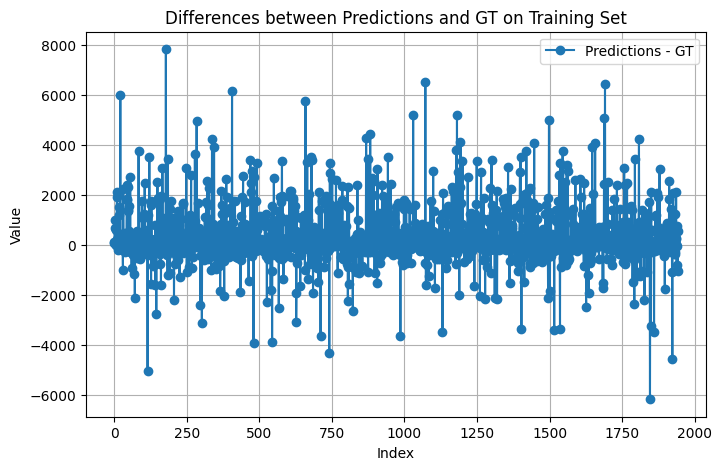

Predicted value for the first sample: 3.0889
Validation Loss Scaling Unreversed: 0.22793298959732056
Validation Loss Scaling Reversed: 1648.0863037109375


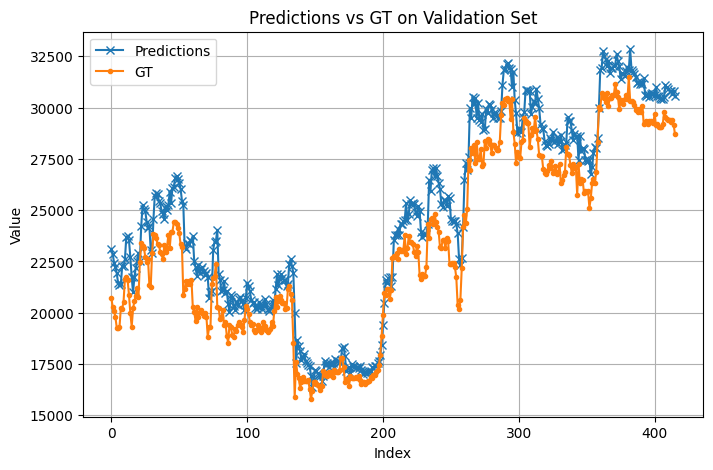

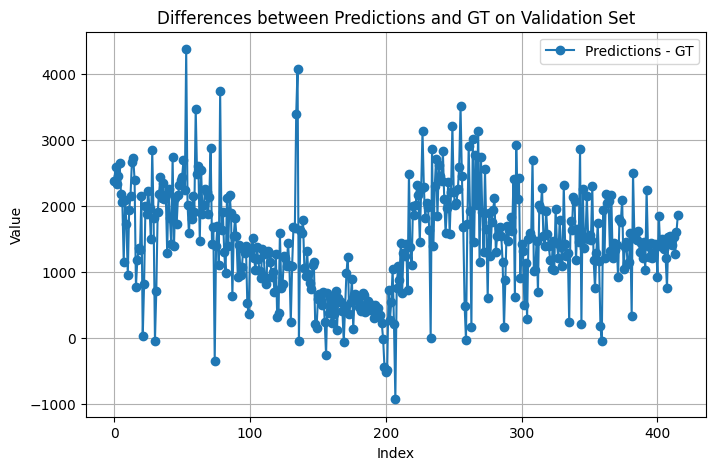

Return: 0.47718334197998047
Max Drawdown: -0.18697382509708405
Epoch [5/200], Loss: 2.8680
Epoch [10/200], Loss: 1.3992
Epoch [15/200], Loss: 0.6509
Epoch [20/200], Loss: 0.4202
Epoch [25/200], Loss: 0.3223
Epoch [30/200], Loss: 0.3192
Epoch [35/200], Loss: 0.3722
Epoch [40/200], Loss: 0.2413
Epoch [45/200], Loss: 0.1684
Epoch [50/200], Loss: 0.2305
Epoch [55/200], Loss: 0.2202
Epoch [60/200], Loss: 0.2117
Epoch [65/200], Loss: 0.1427
Epoch [70/200], Loss: 0.2203
Epoch [75/200], Loss: 0.2898
Epoch [80/200], Loss: 0.2538
Epoch [85/200], Loss: 0.1534
Epoch [90/200], Loss: 0.1851
Epoch [95/200], Loss: 0.1755
Epoch [100/200], Loss: 0.1554
Epoch [105/200], Loss: 0.2547
Epoch [110/200], Loss: 0.1832
Epoch [115/200], Loss: 0.1561
Epoch [120/200], Loss: 0.1631
Epoch [125/200], Loss: 0.2134
Epoch [130/200], Loss: 0.1686
Epoch [135/200], Loss: 0.0917
Epoch [140/200], Loss: 0.1845
Epoch [145/200], Loss: 0.1027
Epoch [150/200], Loss: 0.2610
Epoch [155/200], Loss: 0.1734
Epoch [160/200], Loss: 0.18

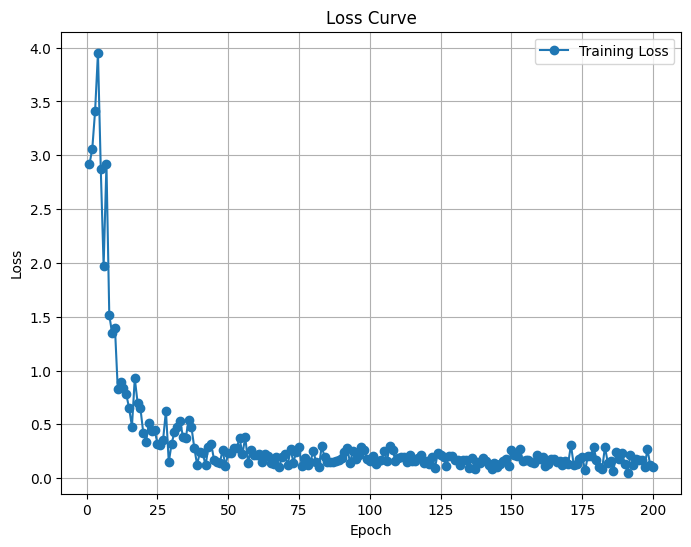

Predicted value for the first sample: 1.8637
Training Loss Scaling Unreversed: 0.15340623259544373
Training Loss Scaling Reversed: 1109.215087890625


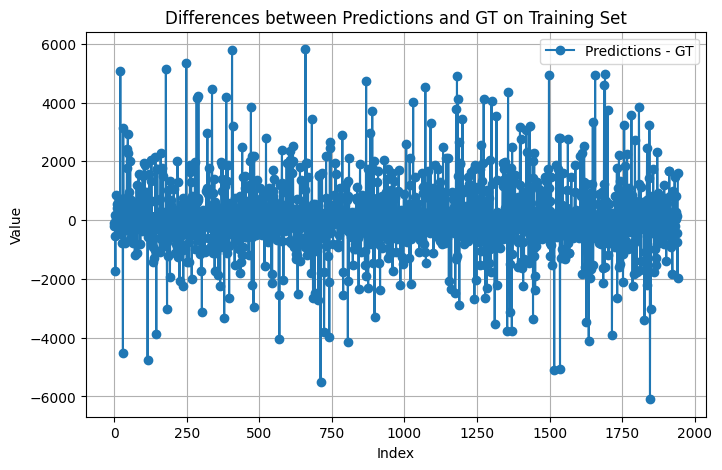

Predicted value for the first sample: 2.9174
Validation Loss Scaling Unreversed: 0.1245872974395752
Validation Loss Scaling Reversed: 900.8377075195312


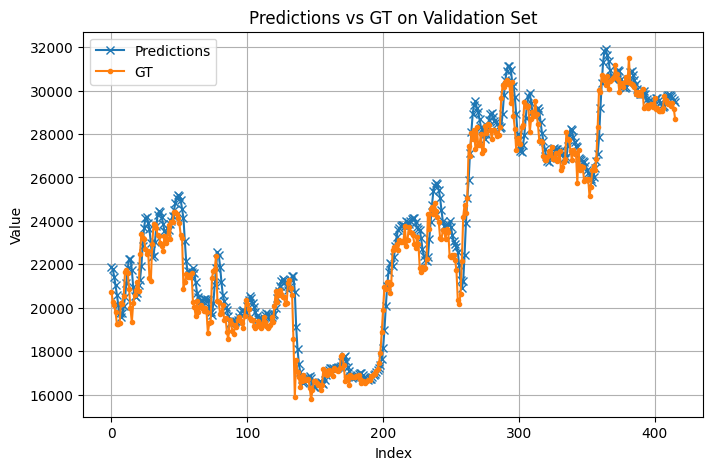

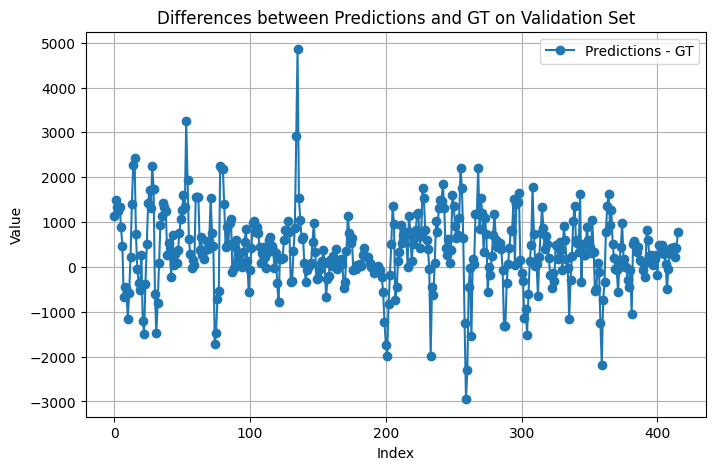

Return: 0.4245110750198364
Max Drawdown: -0.2664231061935425
Epoch [5/200], Loss: 3.4436
Epoch [10/200], Loss: 2.3063
Epoch [15/200], Loss: 2.8557
Epoch [20/200], Loss: 3.8999
Epoch [25/200], Loss: 2.8790
Epoch [30/200], Loss: 2.1063
Epoch [35/200], Loss: 3.7215
Epoch [40/200], Loss: 2.2656
Epoch [45/200], Loss: 2.6386
Epoch [50/200], Loss: 2.5077
Epoch [55/200], Loss: 1.6694
Epoch [60/200], Loss: 1.4178
Epoch [65/200], Loss: 1.1954
Epoch [70/200], Loss: 1.9511
Epoch [75/200], Loss: 1.4257
Epoch [80/200], Loss: 1.5653
Epoch [85/200], Loss: 1.1601
Epoch [90/200], Loss: 1.2111
Epoch [95/200], Loss: 1.1562
Epoch [100/200], Loss: 0.8189
Epoch [105/200], Loss: 1.0996
Epoch [110/200], Loss: 0.8654
Epoch [115/200], Loss: 0.9578
Epoch [120/200], Loss: 1.1622
Epoch [125/200], Loss: 1.2019
Epoch [130/200], Loss: 0.9490
Epoch [135/200], Loss: 1.0347
Epoch [140/200], Loss: 0.9669
Epoch [145/200], Loss: 0.4061
Epoch [150/200], Loss: 0.2975
Epoch [155/200], Loss: 1.2881
Epoch [160/200], Loss: 1.0209

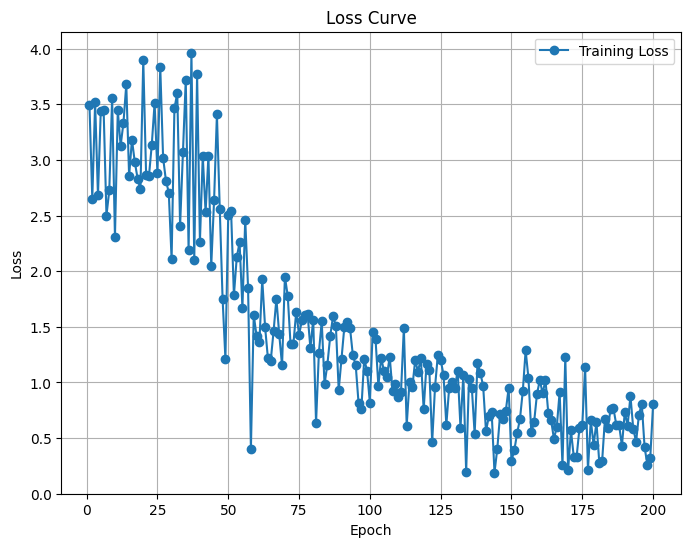

Predicted value for the first sample: 2.0859
Training Loss Scaling Unreversed: 0.592256486415863
Training Loss Scaling Reversed: 4282.3544921875


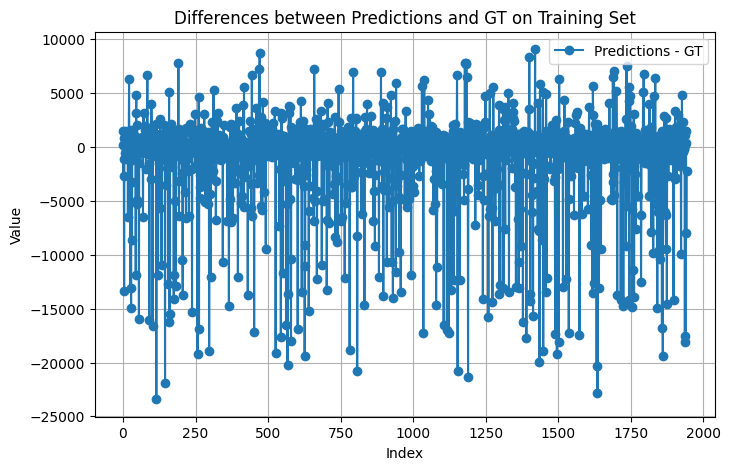

Predicted value for the first sample: 2.7386
Validation Loss Scaling Unreversed: 0.16729336977005005
Validation Loss Scaling Reversed: 1209.627197265625


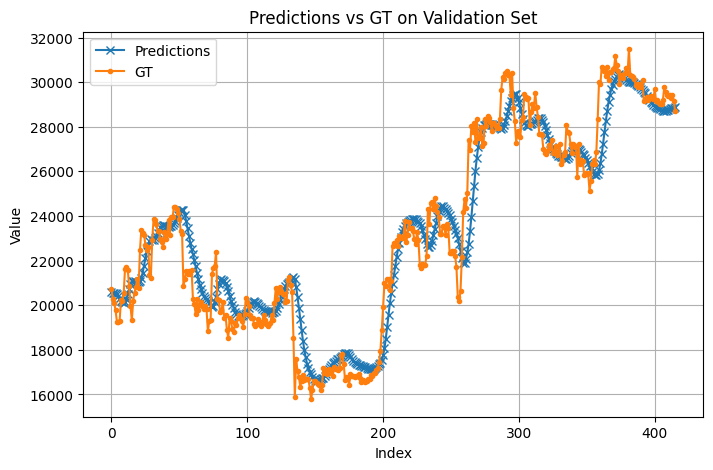

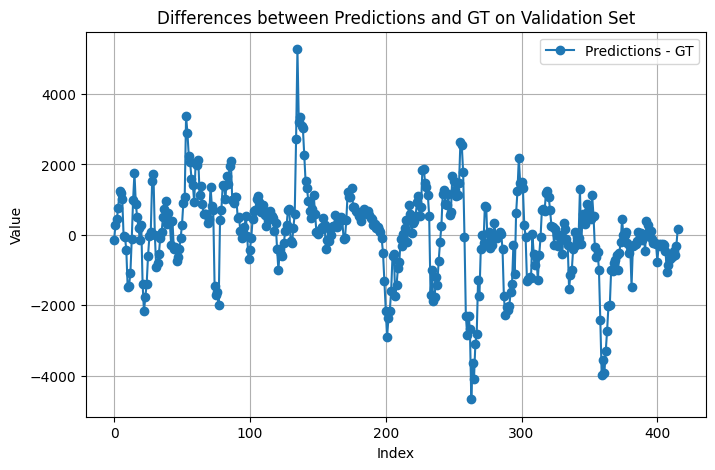

Return: 0.011326909065246582
Max Drawdown: -0.29316651821136475
Epoch [5/200], Loss: 0.2569
Epoch [10/200], Loss: 0.2204
Epoch [15/200], Loss: 0.2156
Epoch [20/200], Loss: 0.1246
Epoch [25/200], Loss: 0.1321
Epoch [30/200], Loss: 0.1192
Epoch [35/200], Loss: 0.1609
Epoch [40/200], Loss: 0.1783
Epoch [45/200], Loss: 0.1720
Epoch [50/200], Loss: 0.0608
Epoch [55/200], Loss: 0.0926
Epoch [60/200], Loss: 0.1143
Epoch [65/200], Loss: 0.1768
Epoch [70/200], Loss: 0.1496
Epoch [75/200], Loss: 0.1265
Epoch [80/200], Loss: 0.1543
Epoch [85/200], Loss: 0.1717
Epoch [90/200], Loss: 0.1425
Epoch [95/200], Loss: 0.1361
Epoch [100/200], Loss: 0.1540
Epoch [105/200], Loss: 0.1508
Epoch [110/200], Loss: 0.1474
Epoch [115/200], Loss: 0.1451
Epoch [120/200], Loss: 0.0818
Epoch [125/200], Loss: 0.1403
Epoch [130/200], Loss: 0.1483
Epoch [135/200], Loss: 0.0547
Epoch [140/200], Loss: 0.0627
Epoch [145/200], Loss: 0.2507
Epoch [150/200], Loss: 0.1199
Epoch [155/200], Loss: 0.0602
Epoch [160/200], Loss: 0.1

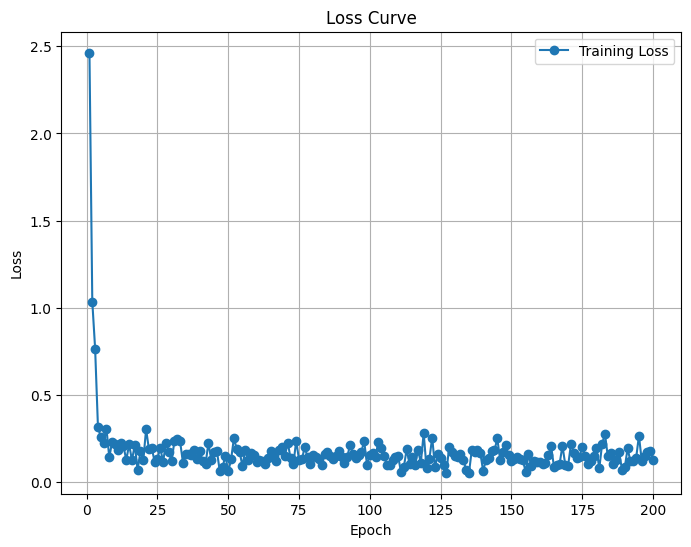

Predicted value for the first sample: 1.8824
Training Loss Scaling Unreversed: 0.14043495059013367
Training Loss Scaling Reversed: 1015.4253540039062


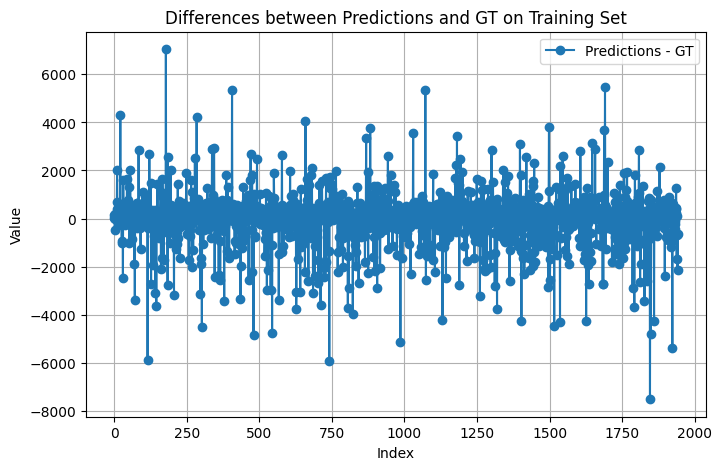

Predicted value for the first sample: 2.9210
Validation Loss Scaling Unreversed: 0.12568271160125732
Validation Loss Scaling Reversed: 908.7582397460938


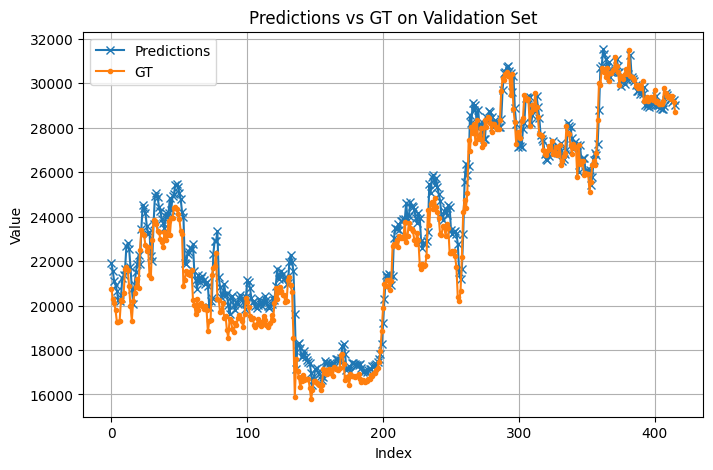

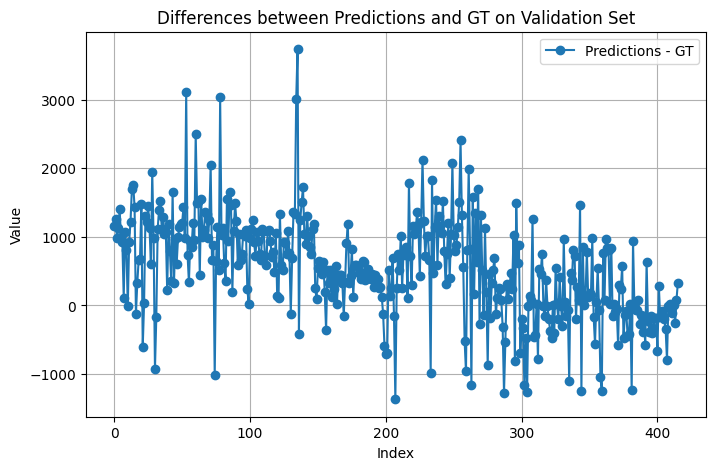

Return: 0.322282075881958
Max Drawdown: -0.22838805615901947
Epoch [5/200], Loss: 3.1134
Epoch [10/200], Loss: 1.6524
Epoch [15/200], Loss: 0.7007
Epoch [20/200], Loss: 0.4408
Epoch [25/200], Loss: 0.3286
Epoch [30/200], Loss: 0.2160
Epoch [35/200], Loss: 0.2869
Epoch [40/200], Loss: 0.3158
Epoch [45/200], Loss: 0.1795
Epoch [50/200], Loss: 0.2436
Epoch [55/200], Loss: 0.2421
Epoch [60/200], Loss: 0.2527
Epoch [65/200], Loss: 0.2556
Epoch [70/200], Loss: 0.3918
Epoch [75/200], Loss: 0.1504
Epoch [80/200], Loss: 0.2022
Epoch [85/200], Loss: 0.1452
Epoch [90/200], Loss: 0.1433
Epoch [95/200], Loss: 0.1612
Epoch [100/200], Loss: 0.2093
Epoch [105/200], Loss: 0.1804
Epoch [110/200], Loss: 0.1819
Epoch [115/200], Loss: 0.2723
Epoch [120/200], Loss: 0.1893
Epoch [125/200], Loss: 0.1248
Epoch [130/200], Loss: 0.2939
Epoch [135/200], Loss: 0.1499
Epoch [140/200], Loss: 0.1695
Epoch [145/200], Loss: 0.2079
Epoch [150/200], Loss: 0.1314
Epoch [155/200], Loss: 0.2218
Epoch [160/200], Loss: 0.1758

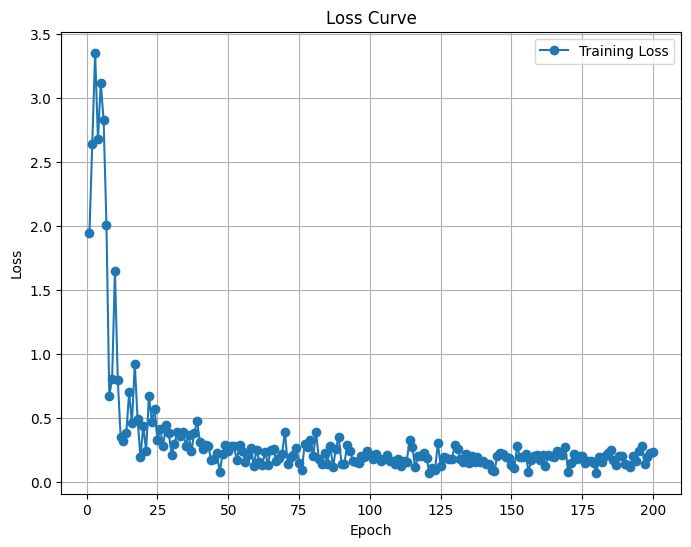

Predicted value for the first sample: 1.8800
Training Loss Scaling Unreversed: 0.16491994261741638
Training Loss Scaling Reversed: 1192.4659423828125


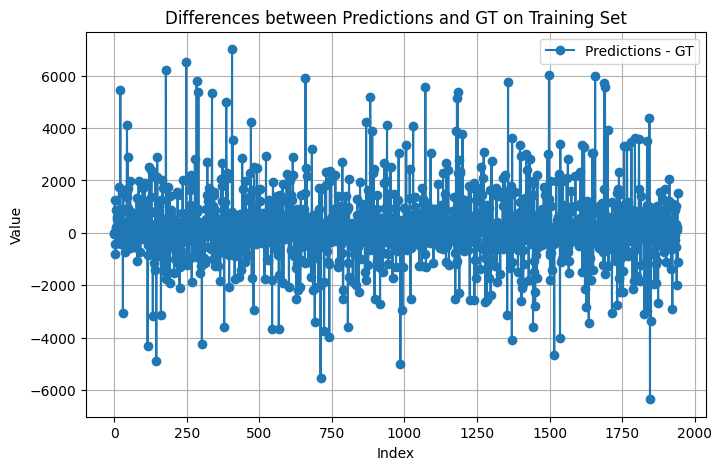

Predicted value for the first sample: 2.9148
Validation Loss Scaling Unreversed: 0.1274908185005188
Validation Loss Scaling Reversed: 921.8318481445312


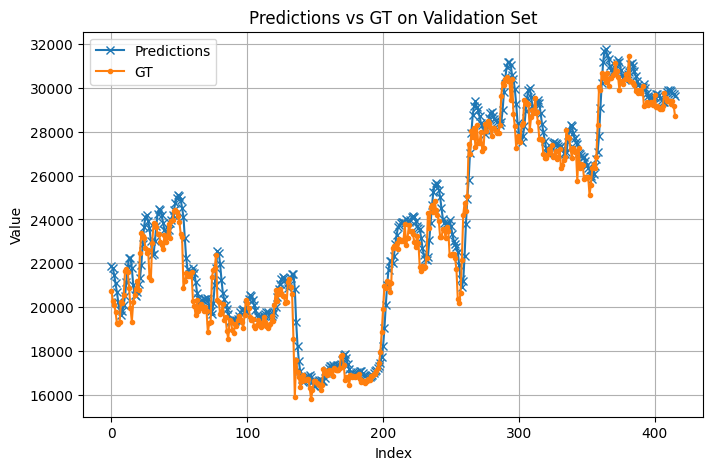

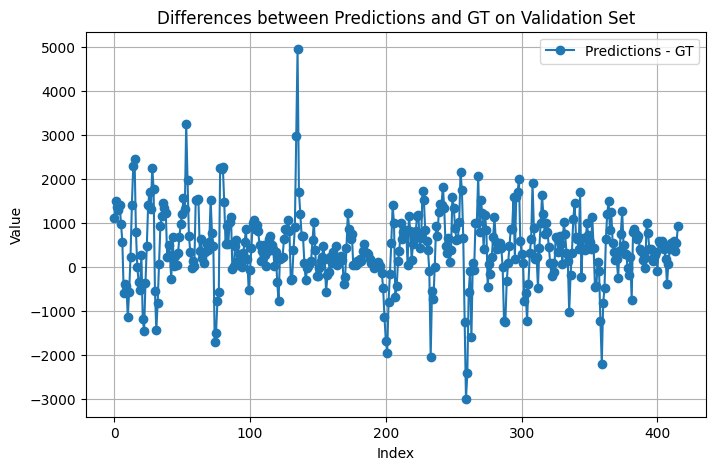

Return: 0.31849145889282227
Max Drawdown: -0.3346785604953766
Epoch [5/200], Loss: 3.7786
Epoch [10/200], Loss: 3.0796
Epoch [15/200], Loss: 2.3624
Epoch [20/200], Loss: 3.5882
Epoch [25/200], Loss: 3.7665
Epoch [30/200], Loss: 3.1597
Epoch [35/200], Loss: 3.1577
Epoch [40/200], Loss: 3.5765
Epoch [45/200], Loss: 2.0215
Epoch [50/200], Loss: 1.5908
Epoch [55/200], Loss: 2.2943
Epoch [60/200], Loss: 2.0321
Epoch [65/200], Loss: 1.3411
Epoch [70/200], Loss: 1.4434
Epoch [75/200], Loss: 1.1792
Epoch [80/200], Loss: 1.9005
Epoch [85/200], Loss: 1.0961
Epoch [90/200], Loss: 1.2627
Epoch [95/200], Loss: 1.7916
Epoch [100/200], Loss: 0.8964
Epoch [105/200], Loss: 1.7589
Epoch [110/200], Loss: 0.7820
Epoch [115/200], Loss: 1.4579
Epoch [120/200], Loss: 0.9854
Epoch [125/200], Loss: 1.4085
Epoch [130/200], Loss: 0.6599
Epoch [135/200], Loss: 0.5650
Epoch [140/200], Loss: 0.8916
Epoch [145/200], Loss: 0.7969
Epoch [150/200], Loss: 0.9698
Epoch [155/200], Loss: 0.1916
Epoch [160/200], Loss: 0.751

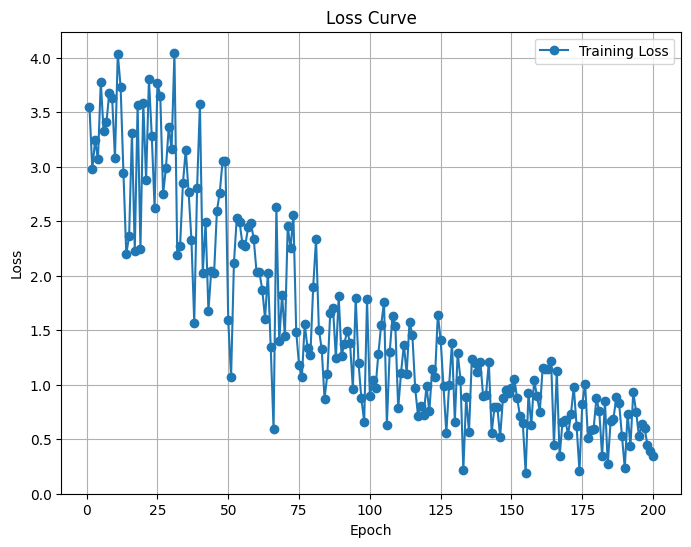

Predicted value for the first sample: 2.1311
Training Loss Scaling Unreversed: 0.64028000831604
Training Loss Scaling Reversed: 4629.591796875


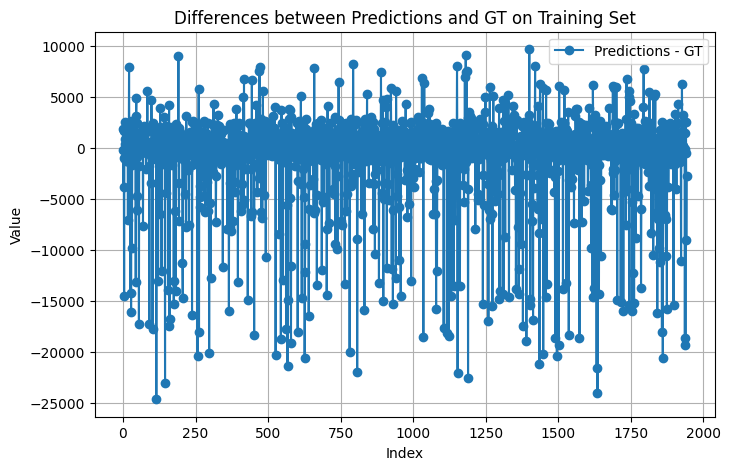

Predicted value for the first sample: 2.6366
Validation Loss Scaling Unreversed: 0.2072601318359375
Validation Loss Scaling Reversed: 1498.60986328125


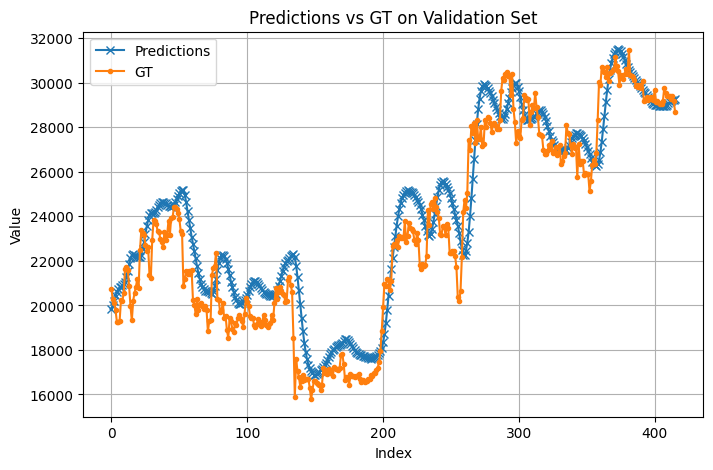

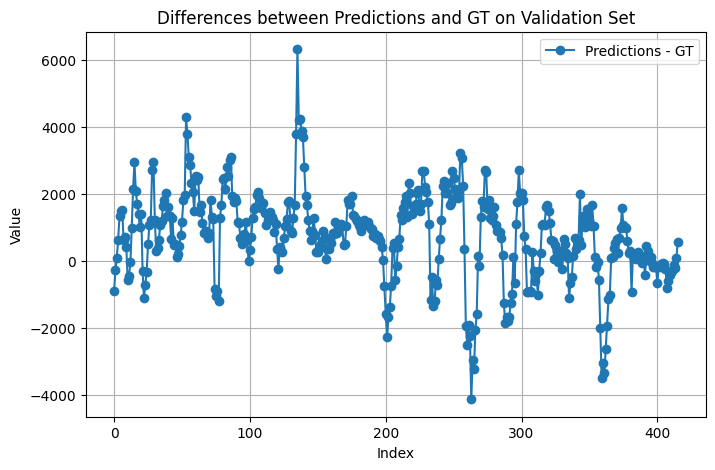

Return: -0.03726506233215332
Max Drawdown: -0.3452145457267761
Epoch [5/200], Loss: 0.3434
Epoch [10/200], Loss: 0.1447
Epoch [15/200], Loss: 0.2167
Epoch [20/200], Loss: 0.1641
Epoch [25/200], Loss: 0.2315
Epoch [30/200], Loss: 0.2952
Epoch [35/200], Loss: 0.2264
Epoch [40/200], Loss: 0.2097
Epoch [45/200], Loss: 0.1300
Epoch [50/200], Loss: 0.1590
Epoch [55/200], Loss: 0.2101
Epoch [60/200], Loss: 0.1643
Epoch [65/200], Loss: 0.1963
Epoch [70/200], Loss: 0.1550
Epoch [75/200], Loss: 0.2497
Epoch [80/200], Loss: 0.1149
Epoch [85/200], Loss: 0.1292
Epoch [90/200], Loss: 0.1603
Epoch [95/200], Loss: 0.1076
Epoch [100/200], Loss: 0.2527
Epoch [105/200], Loss: 0.1985
Epoch [110/200], Loss: 0.1766
Epoch [115/200], Loss: 0.0855
Epoch [120/200], Loss: 0.1108
Epoch [125/200], Loss: 0.1281
Epoch [130/200], Loss: 0.1295
Epoch [135/200], Loss: 0.2648
Epoch [140/200], Loss: 0.2169
Epoch [145/200], Loss: 0.1867
Epoch [150/200], Loss: 0.1163
Epoch [155/200], Loss: 0.1430
Epoch [160/200], Loss: 0.10

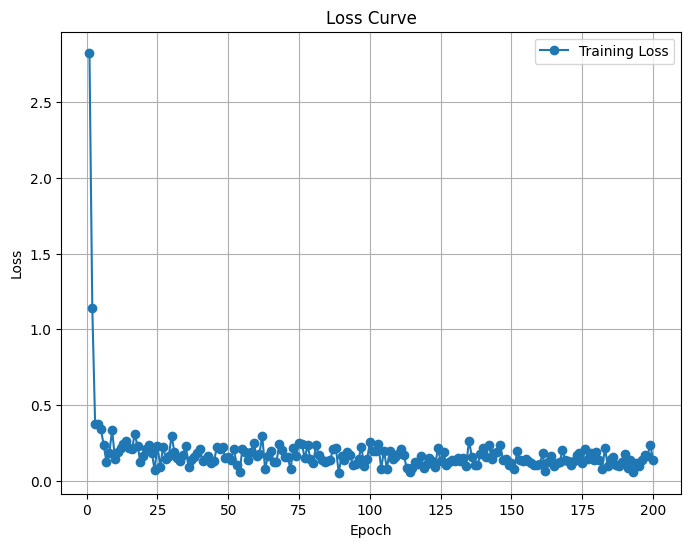

Predicted value for the first sample: 1.7726
Training Loss Scaling Unreversed: 0.14411920309066772
Training Loss Scaling Reversed: 1042.0645751953125


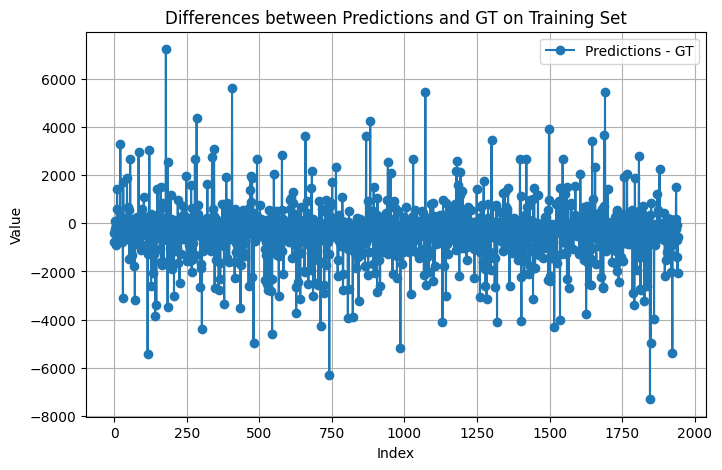

Predicted value for the first sample: 2.7572
Validation Loss Scaling Unreversed: 0.1424483060836792
Validation Loss Scaling Reversed: 1029.9830322265625


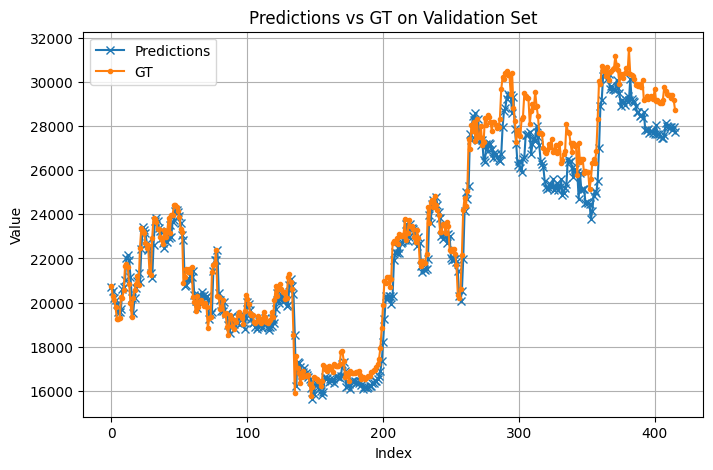

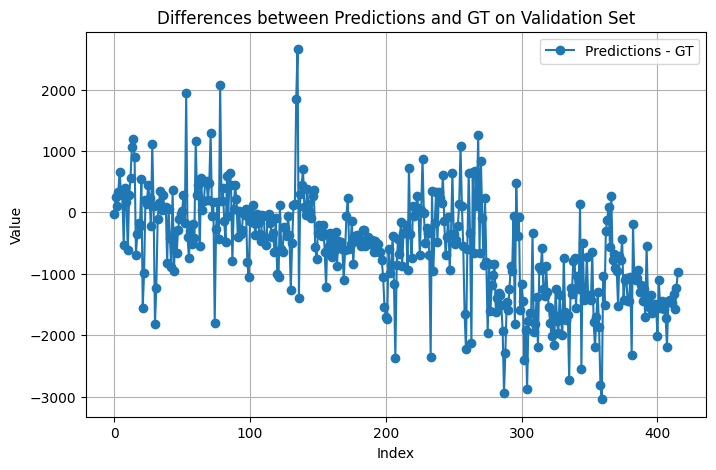

Return: 0.32674717903137207
Max Drawdown: -0.24739694595336914
Epoch [5/200], Loss: 2.2643
Epoch [10/200], Loss: 1.3741
Epoch [15/200], Loss: 0.7939
Epoch [20/200], Loss: 0.4726
Epoch [25/200], Loss: 0.4838
Epoch [30/200], Loss: 0.4532
Epoch [35/200], Loss: 0.4172
Epoch [40/200], Loss: 0.3052
Epoch [45/200], Loss: 0.3300
Epoch [50/200], Loss: 0.2631
Epoch [55/200], Loss: 0.2468
Epoch [60/200], Loss: 0.2587
Epoch [65/200], Loss: 0.3319
Epoch [70/200], Loss: 0.2310
Epoch [75/200], Loss: 0.2745
Epoch [80/200], Loss: 0.2505
Epoch [85/200], Loss: 0.1435
Epoch [90/200], Loss: 0.2671
Epoch [95/200], Loss: 0.1534
Epoch [100/200], Loss: 0.1637
Epoch [105/200], Loss: 0.1270
Epoch [110/200], Loss: 0.2468
Epoch [115/200], Loss: 0.2415
Epoch [120/200], Loss: 0.2620
Epoch [125/200], Loss: 0.1744
Epoch [130/200], Loss: 0.1806
Epoch [135/200], Loss: 0.1619
Epoch [140/200], Loss: 0.1135
Epoch [145/200], Loss: 0.1844
Epoch [150/200], Loss: 0.1481
Epoch [155/200], Loss: 0.2249
Epoch [160/200], Loss: 0.16

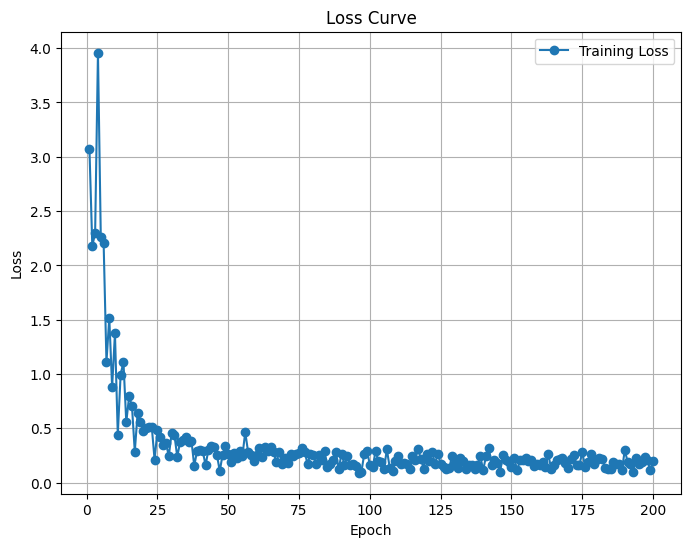

Predicted value for the first sample: 1.8635
Training Loss Scaling Unreversed: 0.162420392036438
Training Loss Scaling Reversed: 1174.392578125


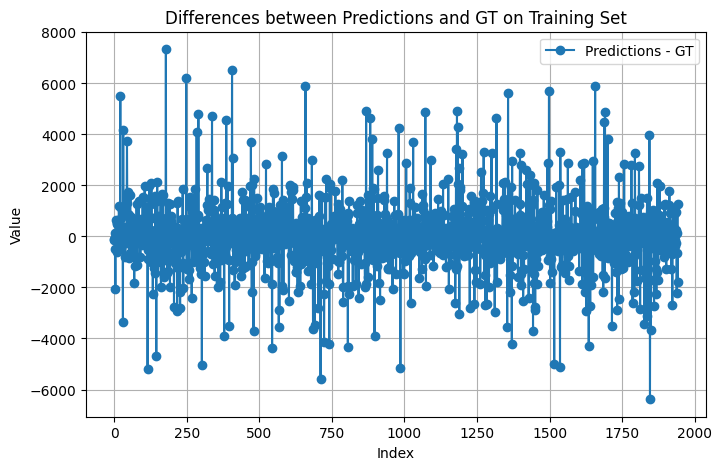

Predicted value for the first sample: 2.9444
Validation Loss Scaling Unreversed: 0.12521255016326904
Validation Loss Scaling Reversed: 905.3587036132812


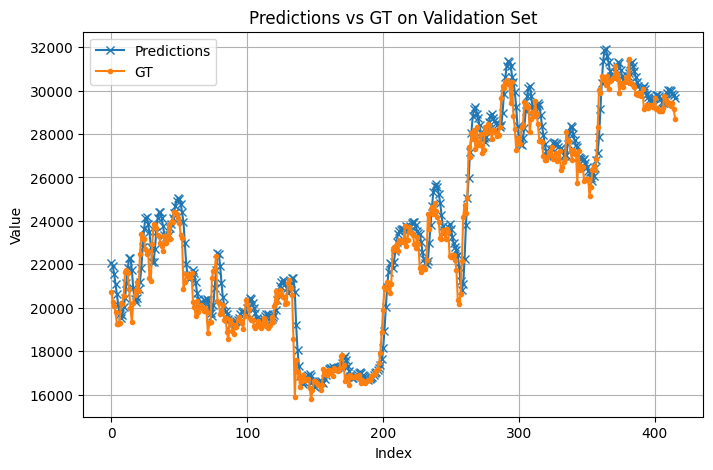

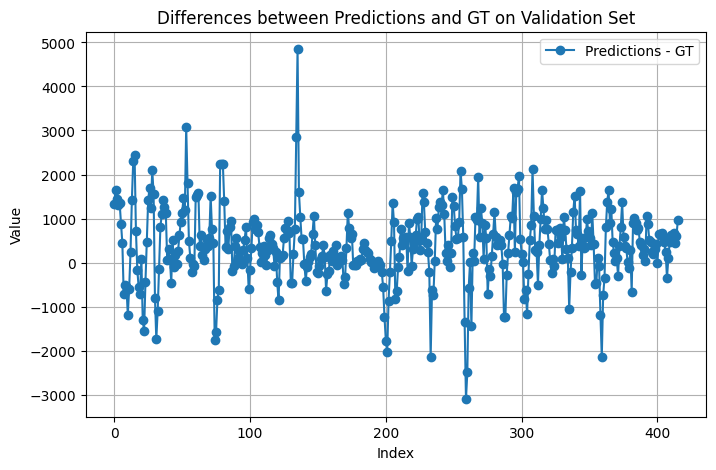

Return: 0.2532697916030884
Max Drawdown: -0.33433178067207336
Epoch [5/200], Loss: 2.5252
Epoch [10/200], Loss: 2.2430
Epoch [15/200], Loss: 3.2228
Epoch [20/200], Loss: 3.5233
Epoch [25/200], Loss: 3.6034
Epoch [30/200], Loss: 3.1770
Epoch [35/200], Loss: 2.8140
Epoch [40/200], Loss: 2.2597
Epoch [45/200], Loss: 1.9206
Epoch [50/200], Loss: 2.2138
Epoch [55/200], Loss: 2.2774
Epoch [60/200], Loss: 2.5822
Epoch [65/200], Loss: 1.6270
Epoch [70/200], Loss: 1.4544
Epoch [75/200], Loss: 1.7047
Epoch [80/200], Loss: 1.3459
Epoch [85/200], Loss: 1.6220
Epoch [90/200], Loss: 2.0783
Epoch [95/200], Loss: 1.2903
Epoch [100/200], Loss: 1.1842
Epoch [105/200], Loss: 1.8278
Epoch [110/200], Loss: 1.4836
Epoch [115/200], Loss: 1.5357
Epoch [120/200], Loss: 0.9320
Epoch [125/200], Loss: 1.5544
Epoch [130/200], Loss: 0.9406
Epoch [135/200], Loss: 1.1658
Epoch [140/200], Loss: 0.7421
Epoch [145/200], Loss: 0.6476
Epoch [150/200], Loss: 1.0358
Epoch [155/200], Loss: 0.7447
Epoch [160/200], Loss: 0.637

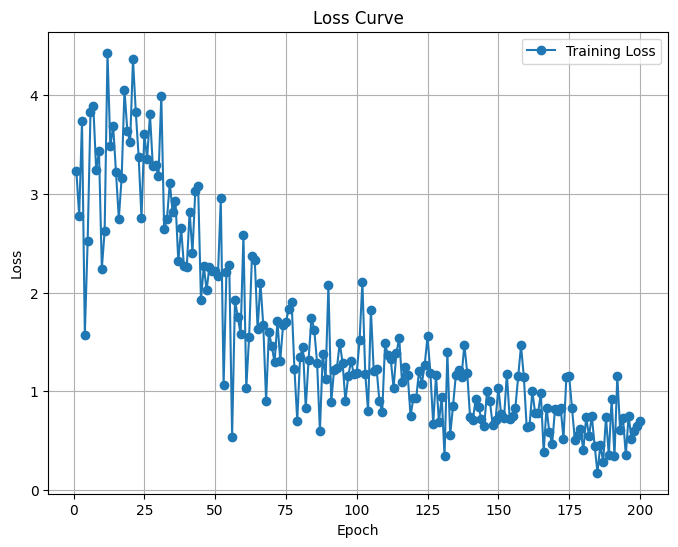

Predicted value for the first sample: 2.1254
Training Loss Scaling Unreversed: 0.6777523756027222
Training Loss Scaling Reversed: 4900.53857421875


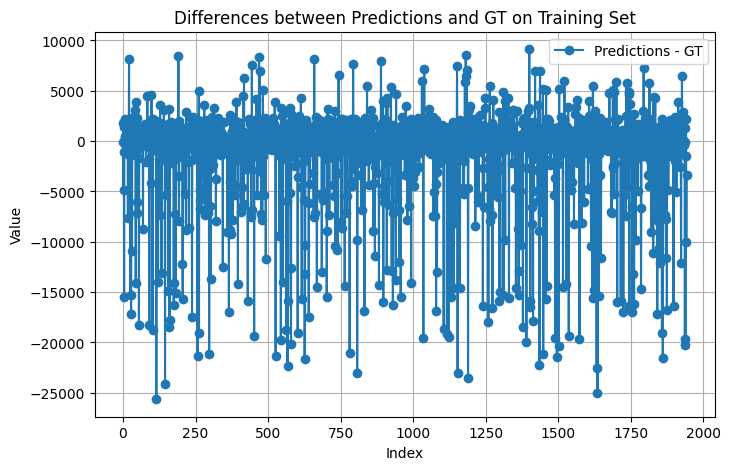

Predicted value for the first sample: 2.6532
Validation Loss Scaling Unreversed: 0.20188672840595245
Validation Loss Scaling Reversed: 1459.7569580078125


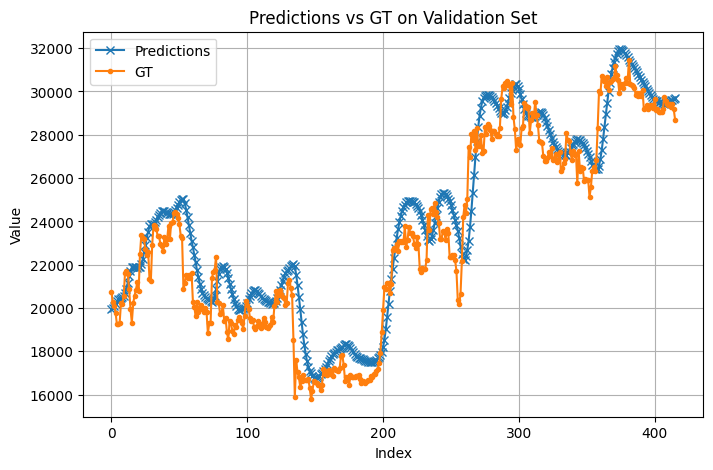

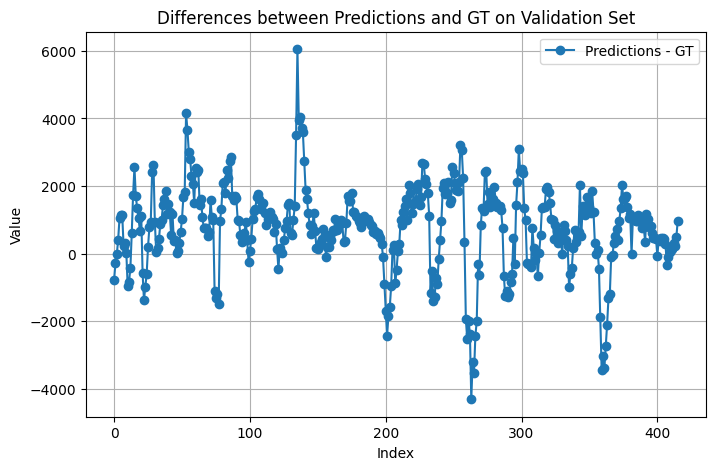

Return: 0.14249873161315918
Max Drawdown: -0.2544541656970978
Epoch [5/200], Loss: 0.1359
Epoch [10/200], Loss: 0.0332
Epoch [15/200], Loss: 0.4296
Epoch [20/200], Loss: 0.0182
Epoch [25/200], Loss: 0.3382
Epoch [30/200], Loss: 0.1577
Epoch [35/200], Loss: 0.2417
Epoch [40/200], Loss: 0.0508
Epoch [45/200], Loss: 0.1080
Epoch [50/200], Loss: 0.0182
Epoch [55/200], Loss: 0.0228
Epoch [60/200], Loss: 0.1511
Epoch [65/200], Loss: 0.1708
Epoch [70/200], Loss: 0.0308
Epoch [75/200], Loss: 0.1480
Epoch [80/200], Loss: 0.3330
Epoch [85/200], Loss: 0.3656
Epoch [90/200], Loss: 0.0303
Epoch [95/200], Loss: 0.0396
Epoch [100/200], Loss: 0.0170
Epoch [105/200], Loss: 0.1494
Epoch [110/200], Loss: 0.0603
Epoch [115/200], Loss: 0.0561
Epoch [120/200], Loss: 0.0156
Epoch [125/200], Loss: 0.0224
Epoch [130/200], Loss: 0.2146
Epoch [135/200], Loss: 0.0835
Epoch [140/200], Loss: 0.1183
Epoch [145/200], Loss: 0.1373
Epoch [150/200], Loss: 0.1740
Epoch [155/200], Loss: 0.0648
Epoch [160/200], Loss: 0.030

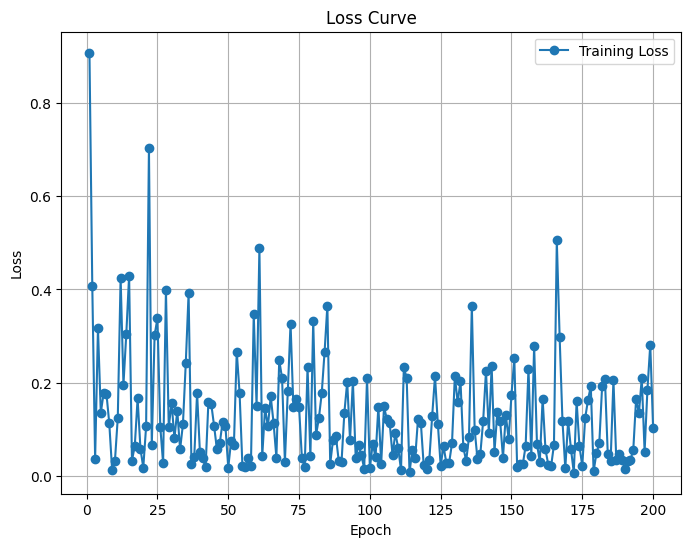

Predicted value for the first sample: 1.8635
Training Loss Scaling Unreversed: 0.12570227682590485
Training Loss Scaling Reversed: 908.8995971679688


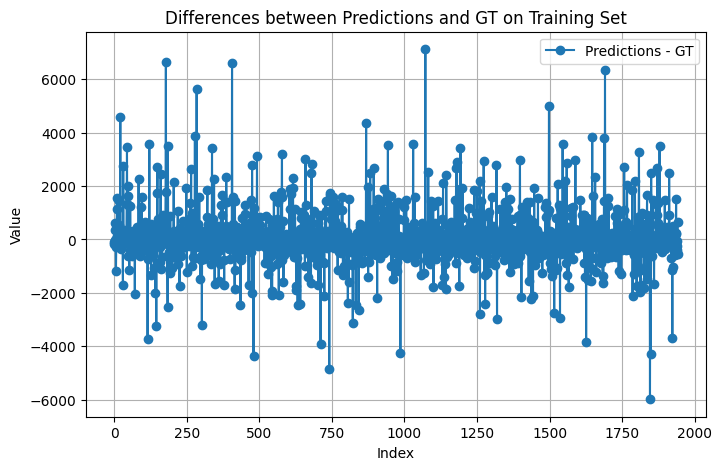

Predicted value for the first sample: 2.7689
Validation Loss Scaling Unreversed: 0.1105884462594986
Validation Loss Scaling Reversed: 799.6179809570312


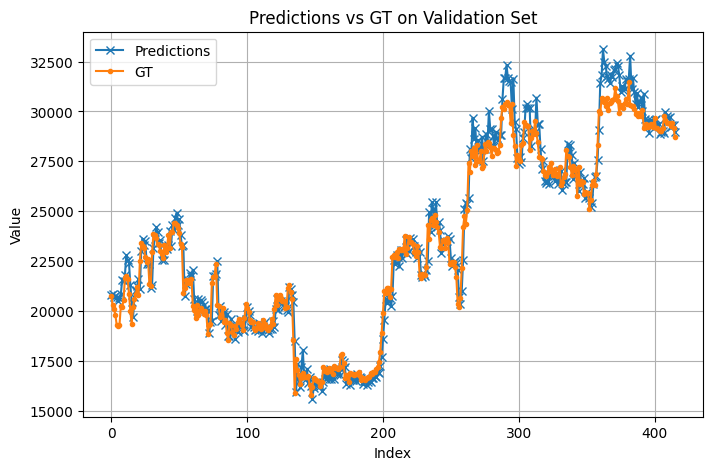

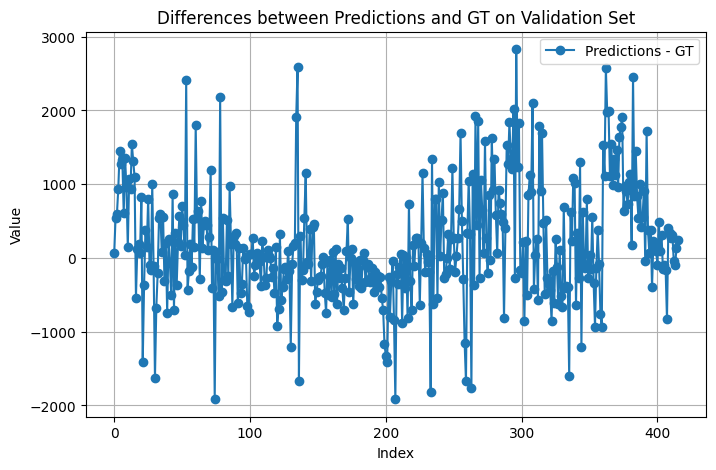

Return: 0.5204614400863647
Max Drawdown: -0.2574176788330078
Epoch [5/200], Loss: 0.1973
Epoch [10/200], Loss: 0.0843
Epoch [15/200], Loss: 0.0695
Epoch [20/200], Loss: 0.1568
Epoch [25/200], Loss: 0.0191
Epoch [30/200], Loss: 0.1422
Epoch [35/200], Loss: 0.0654
Epoch [40/200], Loss: 0.1463
Epoch [45/200], Loss: 0.1471
Epoch [50/200], Loss: 0.0987
Epoch [55/200], Loss: 0.2226
Epoch [60/200], Loss: 0.0471
Epoch [65/200], Loss: 0.0390
Epoch [70/200], Loss: 0.0441
Epoch [75/200], Loss: 0.1735
Epoch [80/200], Loss: 0.1156
Epoch [85/200], Loss: 0.1045
Epoch [90/200], Loss: 0.0149
Epoch [95/200], Loss: 0.0791
Epoch [100/200], Loss: 0.0374
Epoch [105/200], Loss: 0.0381
Epoch [110/200], Loss: 0.1670
Epoch [115/200], Loss: 0.0321
Epoch [120/200], Loss: 0.0835
Epoch [125/200], Loss: 0.0098
Epoch [130/200], Loss: 0.2663
Epoch [135/200], Loss: 0.0735
Epoch [140/200], Loss: 0.1070
Epoch [145/200], Loss: 0.0125
Epoch [150/200], Loss: 0.2192
Epoch [155/200], Loss: 0.1253
Epoch [160/200], Loss: 0.2229

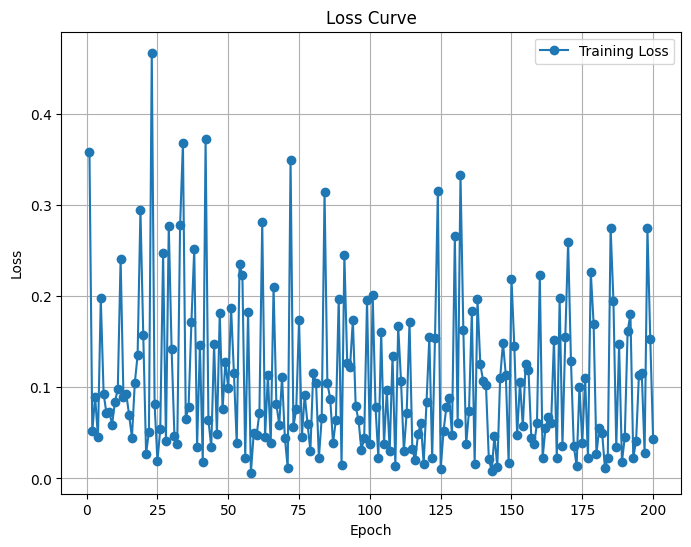

Predicted value for the first sample: 1.8966
Training Loss Scaling Unreversed: 0.13729523122310638
Training Loss Scaling Reversed: 992.723388671875


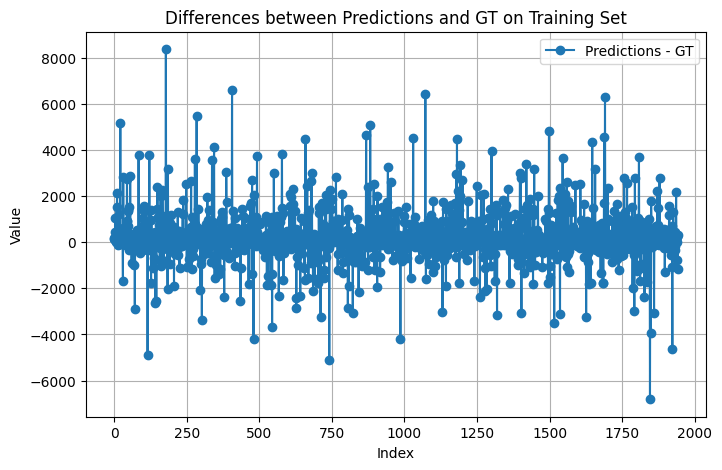

Predicted value for the first sample: 2.8680
Validation Loss Scaling Unreversed: 0.10668119788169861
Validation Loss Scaling Reversed: 771.3663330078125


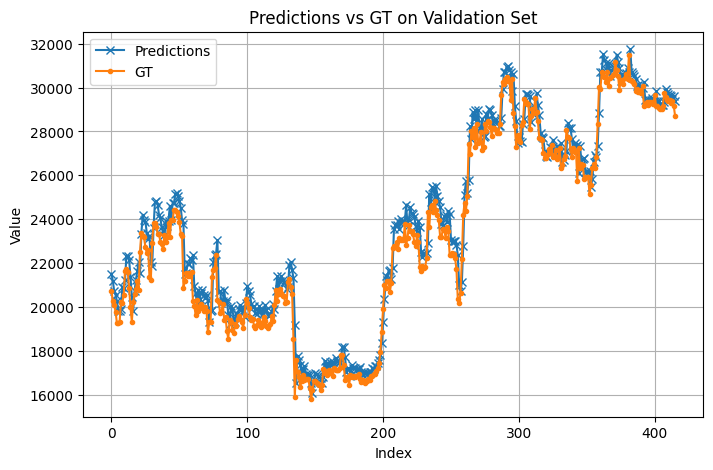

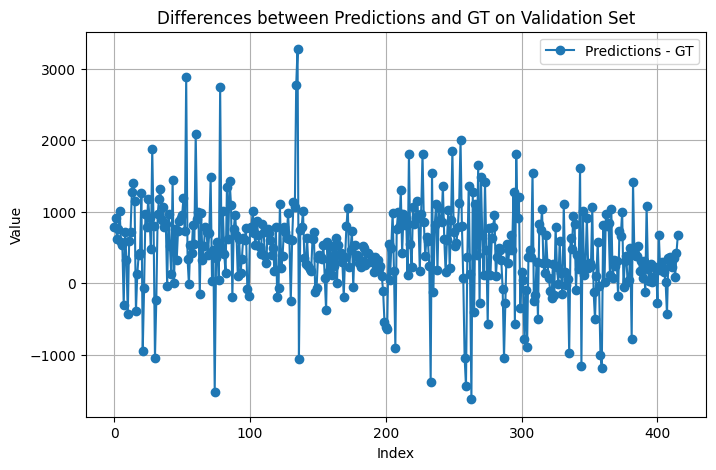

Return: 0.41015803813934326
Max Drawdown: -0.196611225605011
Epoch [5/200], Loss: 0.8483
Epoch [10/200], Loss: 0.1256
Epoch [15/200], Loss: 0.0520
Epoch [20/200], Loss: 0.0748
Epoch [25/200], Loss: 0.0300
Epoch [30/200], Loss: 0.0647
Epoch [35/200], Loss: 0.3319
Epoch [40/200], Loss: 0.1503
Epoch [45/200], Loss: 0.0763
Epoch [50/200], Loss: 0.2380
Epoch [55/200], Loss: 0.1217
Epoch [60/200], Loss: 0.1726
Epoch [65/200], Loss: 0.3082
Epoch [70/200], Loss: 0.3339
Epoch [75/200], Loss: 0.0673
Epoch [80/200], Loss: 0.0706
Epoch [85/200], Loss: 0.0789
Epoch [90/200], Loss: 0.0725
Epoch [95/200], Loss: 0.2068
Epoch [100/200], Loss: 0.3124
Epoch [105/200], Loss: 0.0204
Epoch [110/200], Loss: 0.3913
Epoch [115/200], Loss: 0.3048
Epoch [120/200], Loss: 0.0477
Epoch [125/200], Loss: 0.0414
Epoch [130/200], Loss: 0.1233
Epoch [135/200], Loss: 0.1659
Epoch [140/200], Loss: 0.0877
Epoch [145/200], Loss: 0.1097
Epoch [150/200], Loss: 0.3111
Epoch [155/200], Loss: 0.2024
Epoch [160/200], Loss: 0.1202

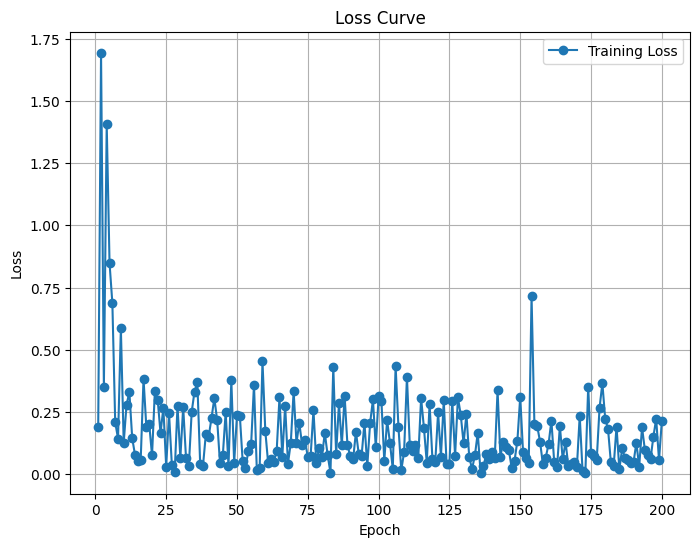

Predicted value for the first sample: 1.7938
Training Loss Scaling Unreversed: 0.14702846109867096
Training Loss Scaling Reversed: 1063.1002197265625


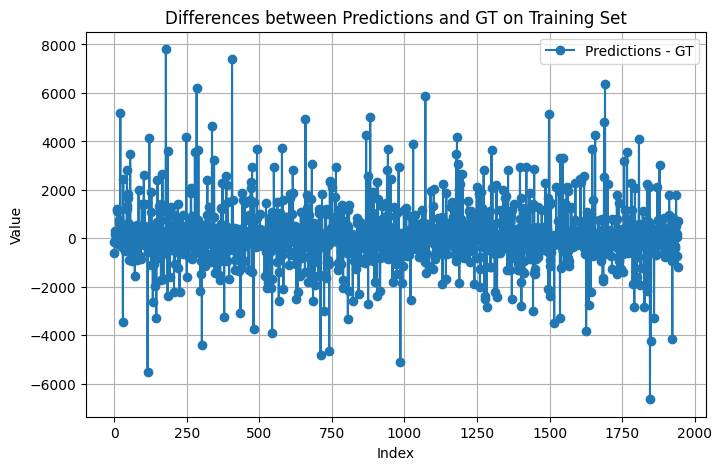

Predicted value for the first sample: 2.8693
Validation Loss Scaling Unreversed: 0.09515005350112915
Validation Loss Scaling Reversed: 687.9895629882812


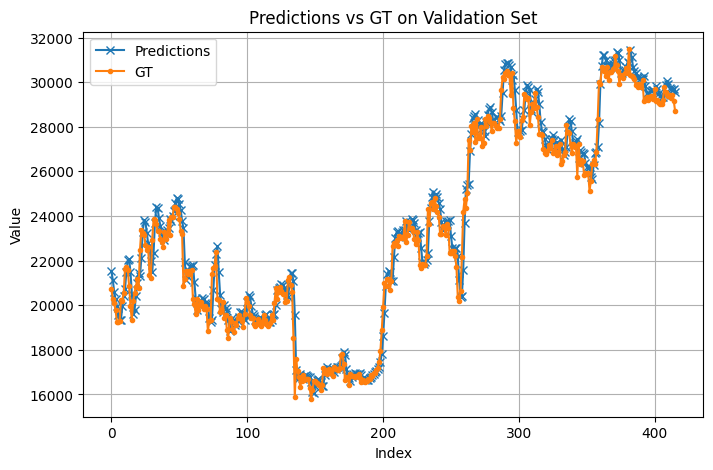

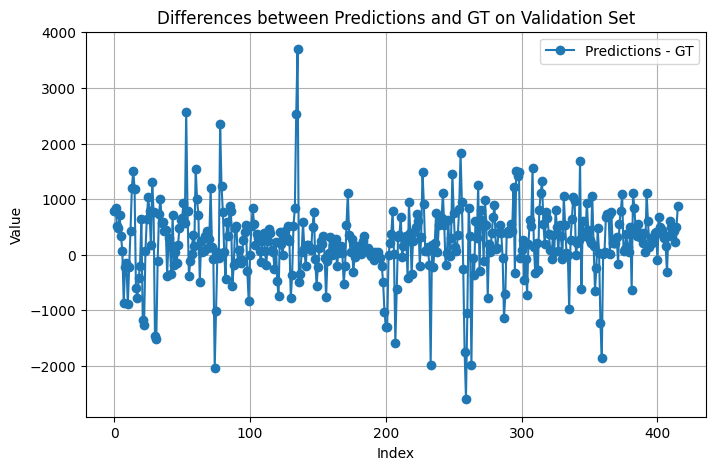

Return: 0.4459960460662842
Max Drawdown: -0.15370921790599823
Epoch [5/200], Loss: 0.3243
Epoch [10/200], Loss: 0.1770
Epoch [15/200], Loss: 0.0543
Epoch [20/200], Loss: 0.5138
Epoch [25/200], Loss: 0.0338
Epoch [30/200], Loss: 0.2027
Epoch [35/200], Loss: 0.0101
Epoch [40/200], Loss: 0.0579
Epoch [45/200], Loss: 0.0389
Epoch [50/200], Loss: 0.0538
Epoch [55/200], Loss: 0.1598
Epoch [60/200], Loss: 0.1422
Epoch [65/200], Loss: 0.0322
Epoch [70/200], Loss: 0.0581
Epoch [75/200], Loss: 0.0326
Epoch [80/200], Loss: 0.0478
Epoch [85/200], Loss: 0.3668
Epoch [90/200], Loss: 0.0308
Epoch [95/200], Loss: 0.3311
Epoch [100/200], Loss: 0.0737
Epoch [105/200], Loss: 0.1159
Epoch [110/200], Loss: 0.0802
Epoch [115/200], Loss: 0.0233
Epoch [120/200], Loss: 0.0818
Epoch [125/200], Loss: 0.0064
Epoch [130/200], Loss: 0.1212
Epoch [135/200], Loss: 0.1081
Epoch [140/200], Loss: 0.0815
Epoch [145/200], Loss: 0.0989
Epoch [150/200], Loss: 0.0575
Epoch [155/200], Loss: 0.4578
Epoch [160/200], Loss: 0.012

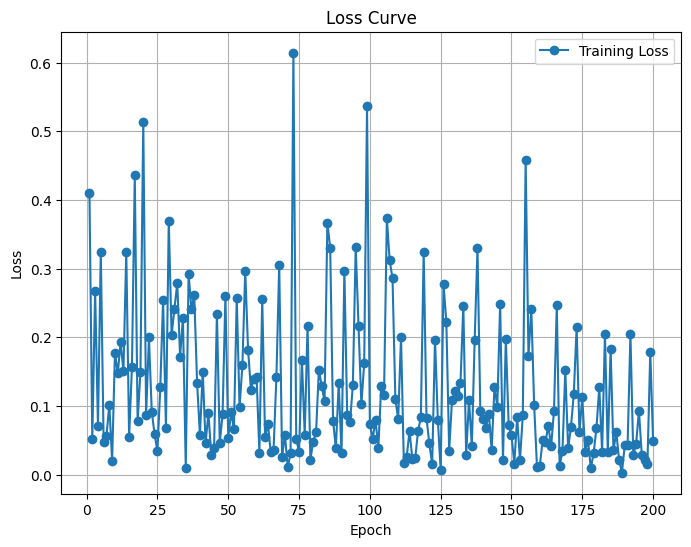

Predicted value for the first sample: 1.8422
Training Loss Scaling Unreversed: 0.12176688760519028
Training Loss Scaling Reversed: 880.4445190429688


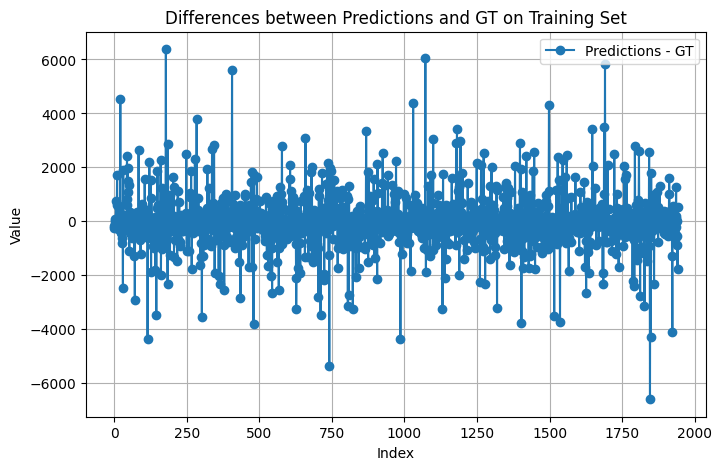

Predicted value for the first sample: 2.8845
Validation Loss Scaling Unreversed: 0.3612850606441498
Validation Loss Scaling Reversed: 2612.29833984375


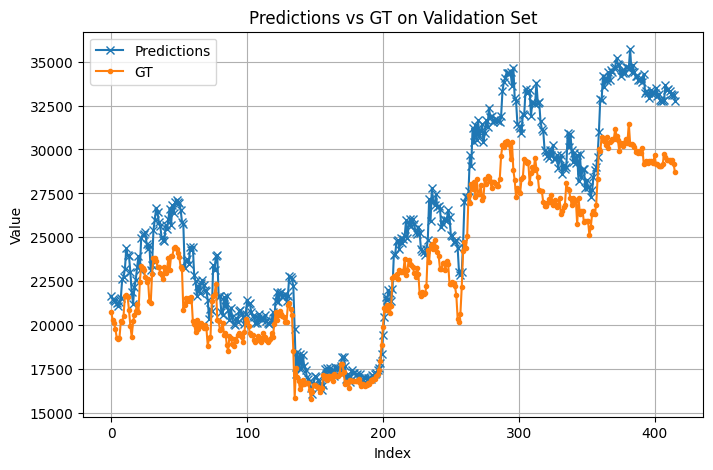

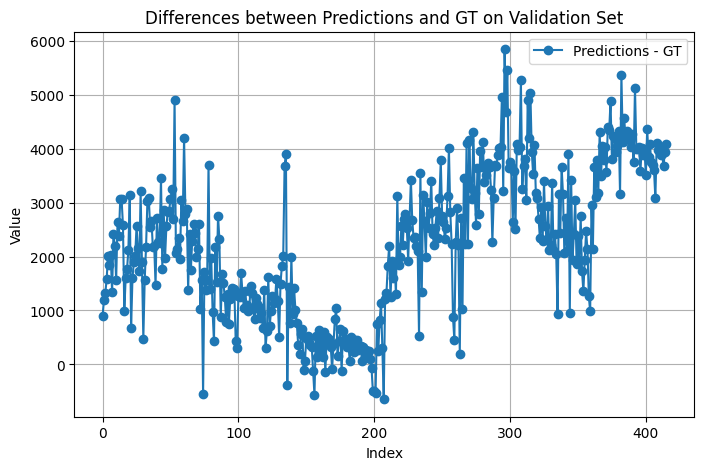

Return: 0.29668164253234863
Max Drawdown: -0.28418222069740295
Epoch [5/200], Loss: 0.2374
Epoch [10/200], Loss: 0.1803
Epoch [15/200], Loss: 0.2308
Epoch [20/200], Loss: 0.3568
Epoch [25/200], Loss: 0.4084
Epoch [30/200], Loss: 0.1213
Epoch [35/200], Loss: 0.0377
Epoch [40/200], Loss: 0.0742
Epoch [45/200], Loss: 0.1578
Epoch [50/200], Loss: 0.0287
Epoch [55/200], Loss: 0.0428
Epoch [60/200], Loss: 0.2546
Epoch [65/200], Loss: 0.0767
Epoch [70/200], Loss: 0.1482
Epoch [75/200], Loss: 0.0222
Epoch [80/200], Loss: 0.1185
Epoch [85/200], Loss: 0.0753
Epoch [90/200], Loss: 0.0499
Epoch [95/200], Loss: 0.0845
Epoch [100/200], Loss: 0.0439
Epoch [105/200], Loss: 0.0603
Epoch [110/200], Loss: 0.1697
Epoch [115/200], Loss: 0.0196
Epoch [120/200], Loss: 0.1294
Epoch [125/200], Loss: 0.2034
Epoch [130/200], Loss: 0.0498
Epoch [135/200], Loss: 0.1768
Epoch [140/200], Loss: 0.0188
Epoch [145/200], Loss: 0.0530
Epoch [150/200], Loss: 0.0499
Epoch [155/200], Loss: 0.0926
Epoch [160/200], Loss: 0.05

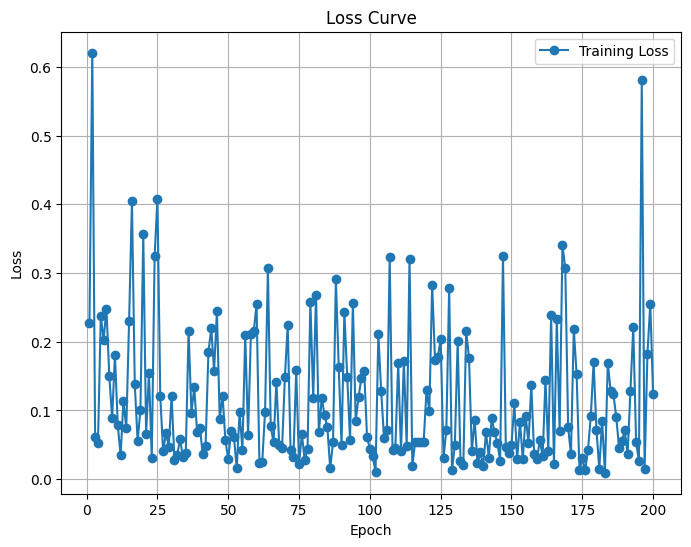

Predicted value for the first sample: 1.8532
Training Loss Scaling Unreversed: 0.1412302404642105
Training Loss Scaling Reversed: 1021.1758422851562


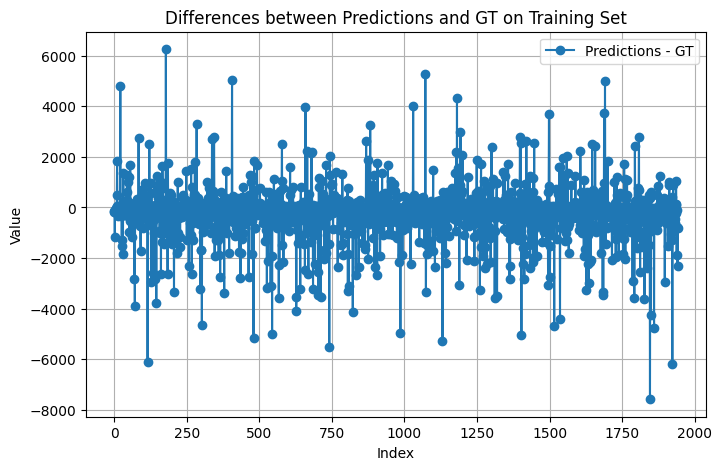

Predicted value for the first sample: 2.7716
Validation Loss Scaling Unreversed: 0.08692654222249985
Validation Loss Scaling Reversed: 628.5288696289062


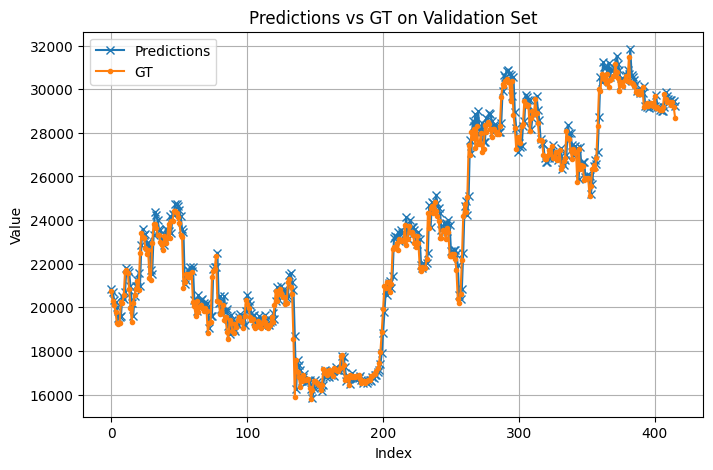

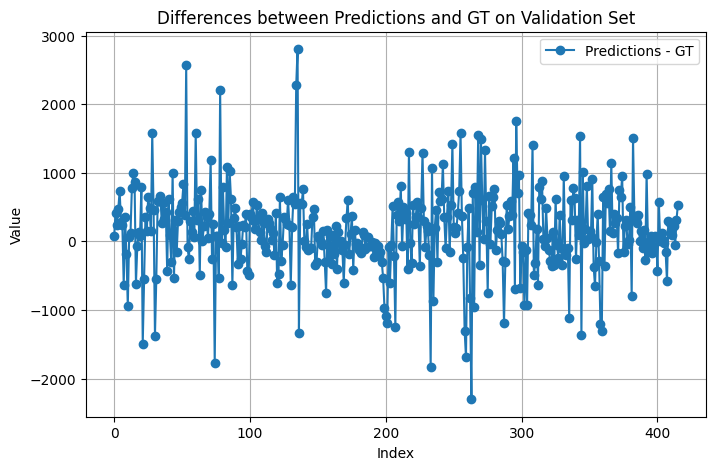

Return: 0.36460208892822266
Max Drawdown: -0.2037135511636734
Epoch [5/200], Loss: 0.3744
Epoch [10/200], Loss: 0.1743
Epoch [15/200], Loss: 0.0995
Epoch [20/200], Loss: 0.1705
Epoch [25/200], Loss: 0.0318
Epoch [30/200], Loss: 0.5979
Epoch [35/200], Loss: 0.2680
Epoch [40/200], Loss: 0.2402
Epoch [45/200], Loss: 0.2275
Epoch [50/200], Loss: 0.0337
Epoch [55/200], Loss: 0.1065
Epoch [60/200], Loss: 0.0406
Epoch [65/200], Loss: 0.0856
Epoch [70/200], Loss: 0.0120
Epoch [75/200], Loss: 0.1219
Epoch [80/200], Loss: 0.0293
Epoch [85/200], Loss: 0.2437
Epoch [90/200], Loss: 0.0411
Epoch [95/200], Loss: 0.3067
Epoch [100/200], Loss: 0.0556
Epoch [105/200], Loss: 0.0253
Epoch [110/200], Loss: 0.0263
Epoch [115/200], Loss: 0.0577
Epoch [120/200], Loss: 0.4827
Epoch [125/200], Loss: 0.0946
Epoch [130/200], Loss: 0.1537
Epoch [135/200], Loss: 0.0174
Epoch [140/200], Loss: 0.0678
Epoch [145/200], Loss: 0.0865
Epoch [150/200], Loss: 0.1653
Epoch [155/200], Loss: 0.2079
Epoch [160/200], Loss: 0.094

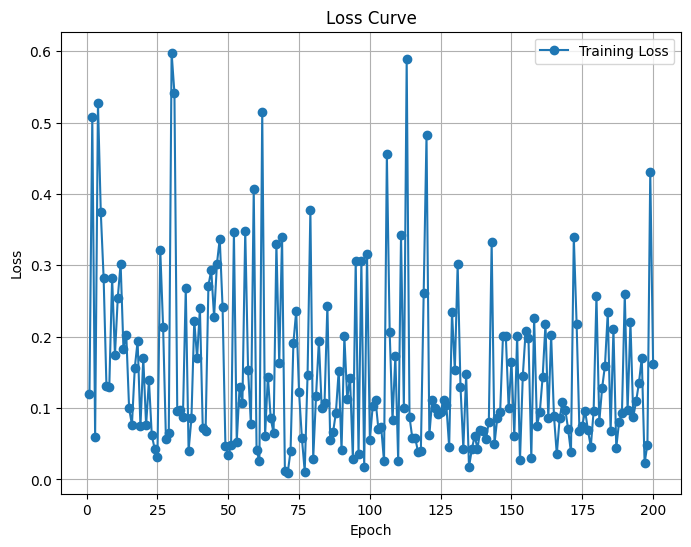

Predicted value for the first sample: 1.7939
Training Loss Scaling Unreversed: 0.15230423212051392
Training Loss Scaling Reversed: 1101.2469482421875


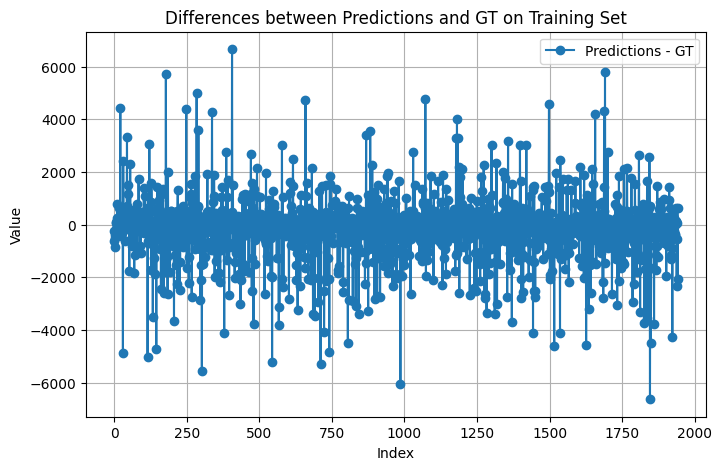

Predicted value for the first sample: 2.8886
Validation Loss Scaling Unreversed: 0.09918834269046783
Validation Loss Scaling Reversed: 717.188720703125


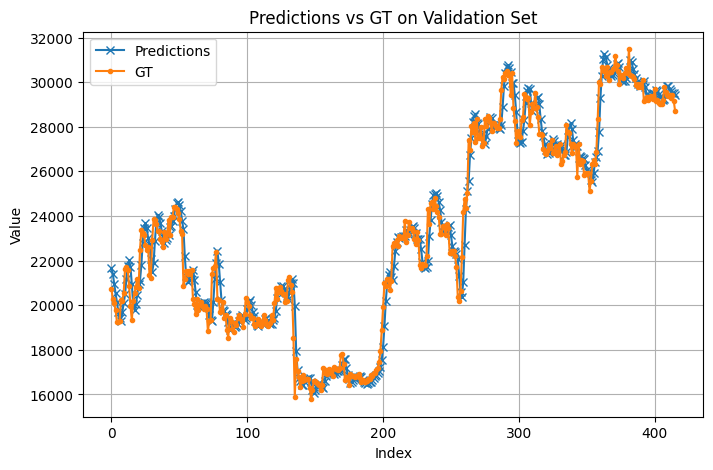

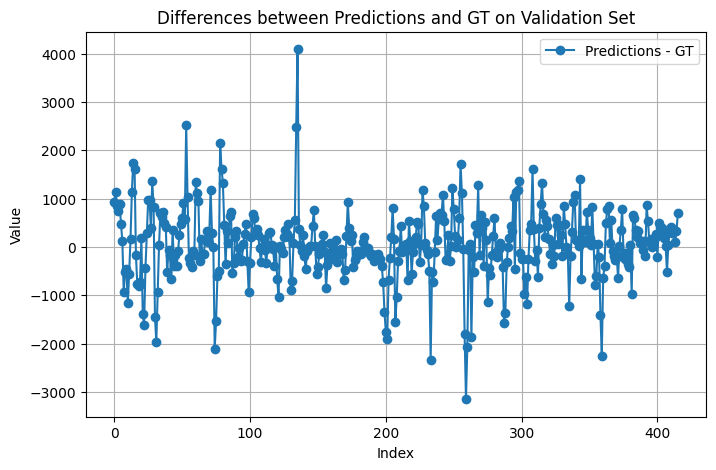

Return: 0.46223676204681396
Max Drawdown: -0.19087807834148407
Epoch [5/200], Loss: 0.1227
Epoch [10/200], Loss: 0.1120
Epoch [15/200], Loss: 0.0294
Epoch [20/200], Loss: 0.0515
Epoch [25/200], Loss: 0.0811
Epoch [30/200], Loss: 0.2989
Epoch [35/200], Loss: 0.1683
Epoch [40/200], Loss: 0.0492
Epoch [45/200], Loss: 0.0450
Epoch [50/200], Loss: 0.0345
Epoch [55/200], Loss: 0.1541
Epoch [60/200], Loss: 0.0321
Epoch [65/200], Loss: 0.0779
Epoch [70/200], Loss: 0.0441
Epoch [75/200], Loss: 0.2091
Epoch [80/200], Loss: 0.2855
Epoch [85/200], Loss: 0.1463
Epoch [90/200], Loss: 0.1960
Epoch [95/200], Loss: 0.2148
Epoch [100/200], Loss: 0.1187
Epoch [105/200], Loss: 0.0743
Epoch [110/200], Loss: 0.0536
Epoch [115/200], Loss: 0.0262
Epoch [120/200], Loss: 0.1884
Epoch [125/200], Loss: 0.0191
Epoch [130/200], Loss: 0.0888
Epoch [135/200], Loss: 0.3808
Epoch [140/200], Loss: 0.0317
Epoch [145/200], Loss: 0.2279
Epoch [150/200], Loss: 0.0382
Epoch [155/200], Loss: 0.0641
Epoch [160/200], Loss: 0.04

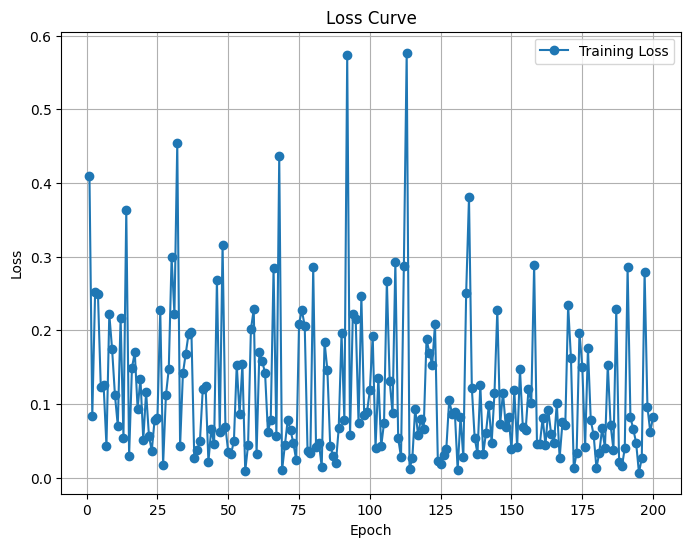

Predicted value for the first sample: 1.8533
Training Loss Scaling Unreversed: 0.12807001173496246
Training Loss Scaling Reversed: 926.0195922851562


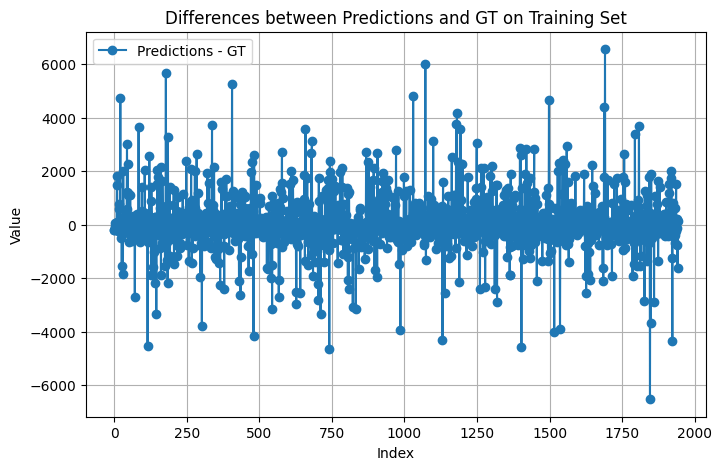

Predicted value for the first sample: 2.8143
Validation Loss Scaling Unreversed: 0.23153863847255707
Validation Loss Scaling Reversed: 1674.1573486328125


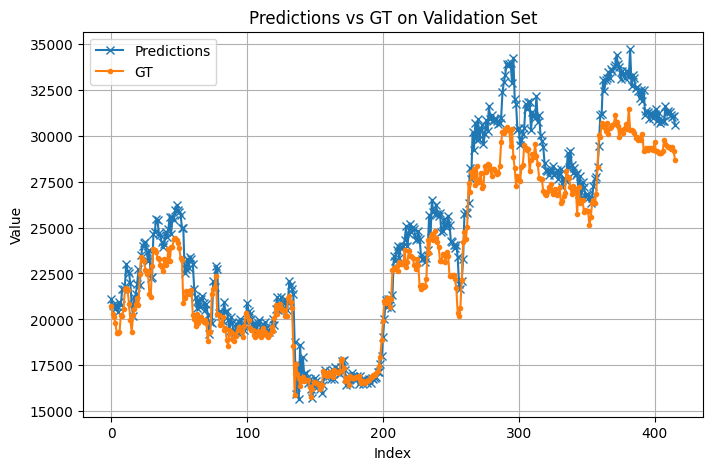

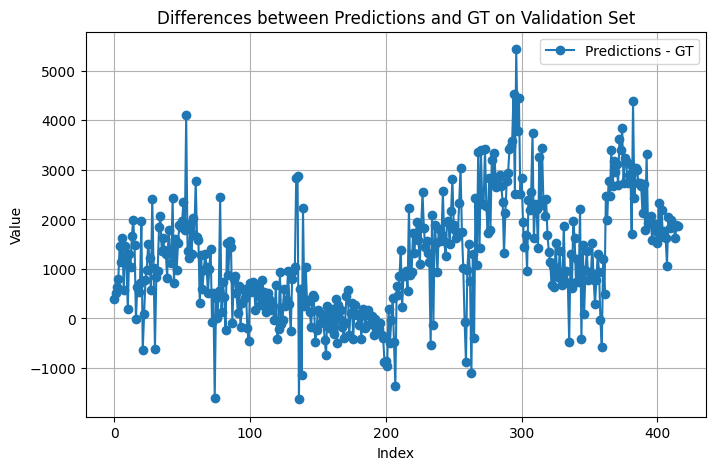

Return: 0.7154814004898071
Max Drawdown: -0.20434339344501495
Epoch [5/200], Loss: 0.0434
Epoch [10/200], Loss: 0.3310
Epoch [15/200], Loss: 0.0888
Epoch [20/200], Loss: 0.0196
Epoch [25/200], Loss: 0.3470
Epoch [30/200], Loss: 0.4821
Epoch [35/200], Loss: 0.0822
Epoch [40/200], Loss: 0.0633
Epoch [45/200], Loss: 0.0533
Epoch [50/200], Loss: 0.1245
Epoch [55/200], Loss: 0.0566
Epoch [60/200], Loss: 0.0396
Epoch [65/200], Loss: 0.0754
Epoch [70/200], Loss: 0.0952
Epoch [75/200], Loss: 0.0508
Epoch [80/200], Loss: 0.0256
Epoch [85/200], Loss: 0.0813
Epoch [90/200], Loss: 0.1541
Epoch [95/200], Loss: 0.0392
Epoch [100/200], Loss: 0.2169
Epoch [105/200], Loss: 0.3732
Epoch [110/200], Loss: 0.1461
Epoch [115/200], Loss: 0.0323
Epoch [120/200], Loss: 0.0734
Epoch [125/200], Loss: 0.0346
Epoch [130/200], Loss: 0.1305
Epoch [135/200], Loss: 0.0812
Epoch [140/200], Loss: 0.0524
Epoch [145/200], Loss: 0.1345
Epoch [150/200], Loss: 0.1682
Epoch [155/200], Loss: 0.1772
Epoch [160/200], Loss: 0.047

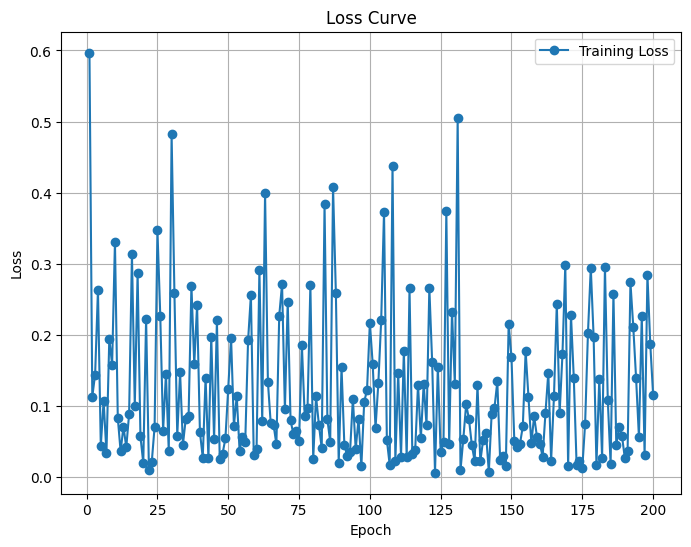

Predicted value for the first sample: 1.8304
Training Loss Scaling Unreversed: 0.13552439212799072
Training Loss Scaling Reversed: 979.919189453125


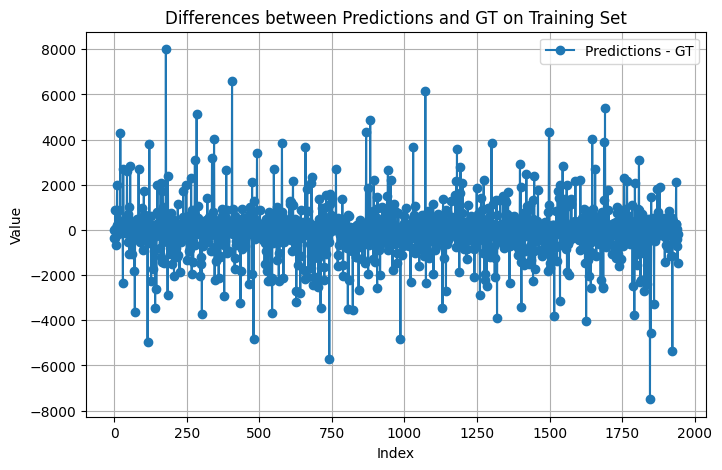

Predicted value for the first sample: 2.7642
Validation Loss Scaling Unreversed: 0.08726729452610016
Validation Loss Scaling Reversed: 630.99267578125


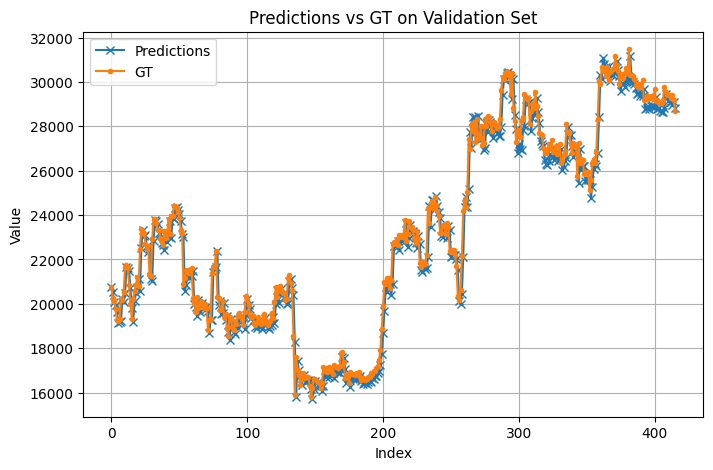

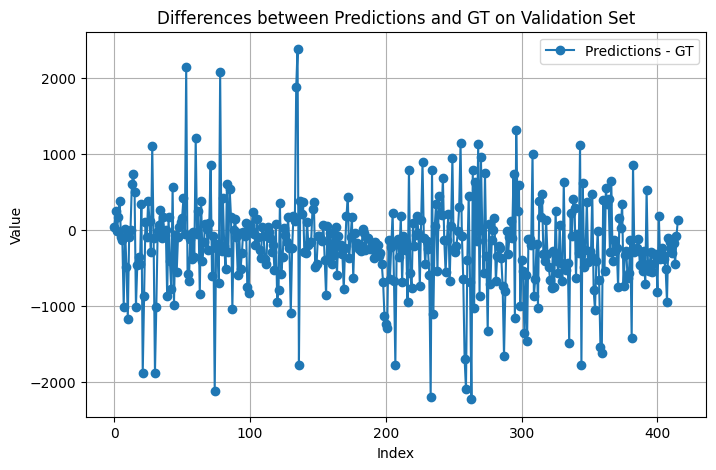

Return: 0.3386186361312866
Max Drawdown: -0.23191630840301514
Epoch [5/200], Loss: 0.0487
Epoch [10/200], Loss: 0.4950
Epoch [15/200], Loss: 0.0785
Epoch [20/200], Loss: 0.0672
Epoch [25/200], Loss: 0.0309
Epoch [30/200], Loss: 0.2649
Epoch [35/200], Loss: 0.3231
Epoch [40/200], Loss: 0.2366
Epoch [45/200], Loss: 0.2238
Epoch [50/200], Loss: 0.0433
Epoch [55/200], Loss: 0.0372
Epoch [60/200], Loss: 0.0301
Epoch [65/200], Loss: 0.3177
Epoch [70/200], Loss: 0.2833
Epoch [75/200], Loss: 0.0498
Epoch [80/200], Loss: 0.2043
Epoch [85/200], Loss: 0.3779
Epoch [90/200], Loss: 0.0858
Epoch [95/200], Loss: 0.0212
Epoch [100/200], Loss: 0.0557
Epoch [105/200], Loss: 0.0416
Epoch [110/200], Loss: 0.0496
Epoch [115/200], Loss: 0.0808
Epoch [120/200], Loss: 0.0552
Epoch [125/200], Loss: 0.3006
Epoch [130/200], Loss: 0.1162
Epoch [135/200], Loss: 0.2787
Epoch [140/200], Loss: 0.0982
Epoch [145/200], Loss: 0.1545
Epoch [150/200], Loss: 0.0889
Epoch [155/200], Loss: 0.1245
Epoch [160/200], Loss: 0.101

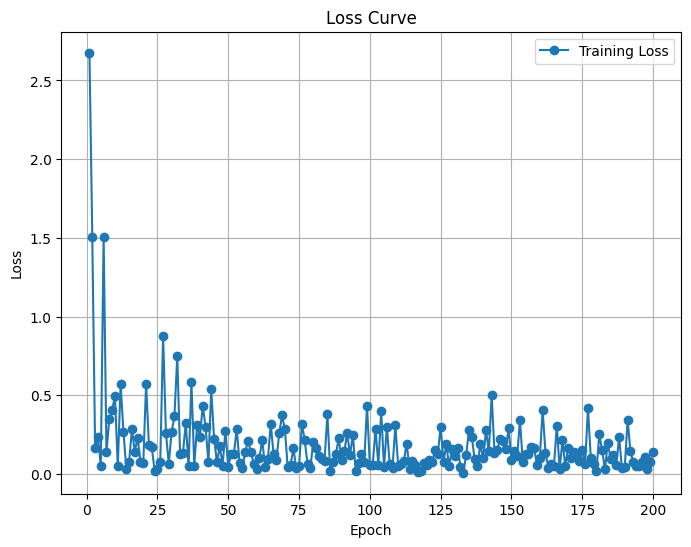

Predicted value for the first sample: 1.8174
Training Loss Scaling Unreversed: 0.16169221699237823
Training Loss Scaling Reversed: 1169.1275634765625


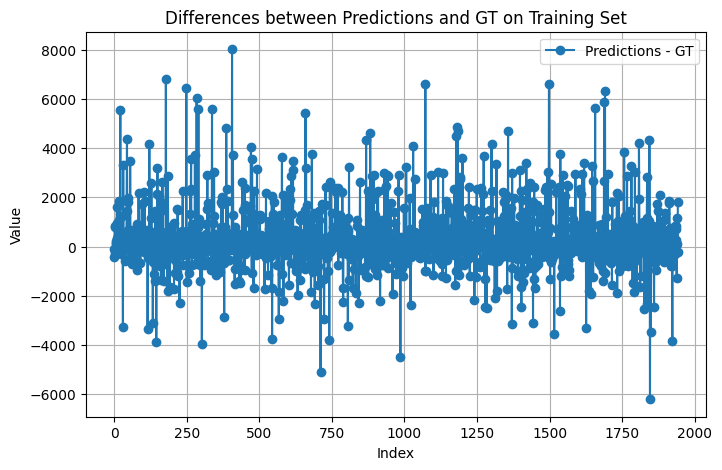

Predicted value for the first sample: 2.9177
Validation Loss Scaling Unreversed: 0.11333797127008438
Validation Loss Scaling Reversed: 819.4986572265625


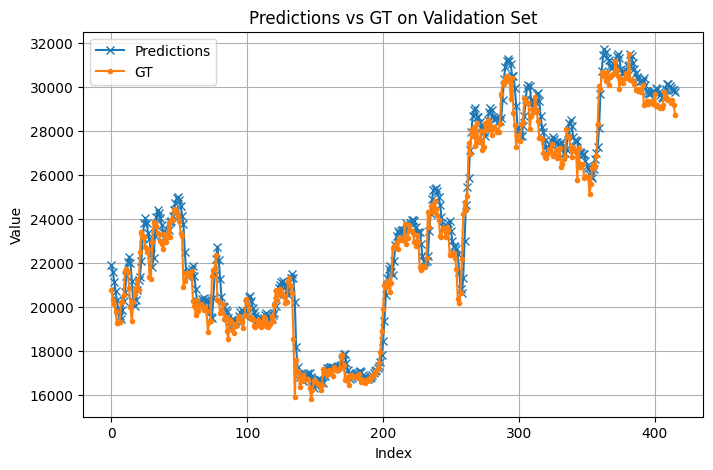

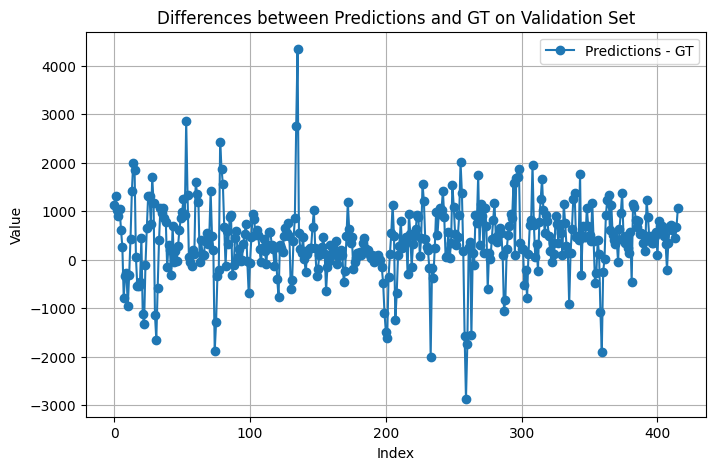

Return: 0.31486475467681885
Max Drawdown: -0.2023063451051712
Epoch [5/200], Loss: 0.2252
Epoch [10/200], Loss: 0.0759
Epoch [15/200], Loss: 0.1076
Epoch [20/200], Loss: 0.2759
Epoch [25/200], Loss: 0.0607
Epoch [30/200], Loss: 0.1620
Epoch [35/200], Loss: 0.1552
Epoch [40/200], Loss: 0.1593
Epoch [45/200], Loss: 0.1761
Epoch [50/200], Loss: 0.1511
Epoch [55/200], Loss: 0.1700
Epoch [60/200], Loss: 0.1205
Epoch [65/200], Loss: 0.0708
Epoch [70/200], Loss: 0.0934
Epoch [75/200], Loss: 0.1433
Epoch [80/200], Loss: 0.2079
Epoch [85/200], Loss: 0.0999
Epoch [90/200], Loss: 0.1175
Epoch [95/200], Loss: 0.2299
Epoch [100/200], Loss: 0.0894
Epoch [105/200], Loss: 0.1438
Epoch [110/200], Loss: 0.2533
Epoch [115/200], Loss: 0.0376
Epoch [120/200], Loss: 0.0616
Epoch [125/200], Loss: 0.0668
Epoch [130/200], Loss: 0.0961
Epoch [135/200], Loss: 0.0502
Epoch [140/200], Loss: 0.1722
Epoch [145/200], Loss: 0.1509
Epoch [150/200], Loss: 0.1505
Epoch [155/200], Loss: 0.0641
Epoch [160/200], Loss: 0.145

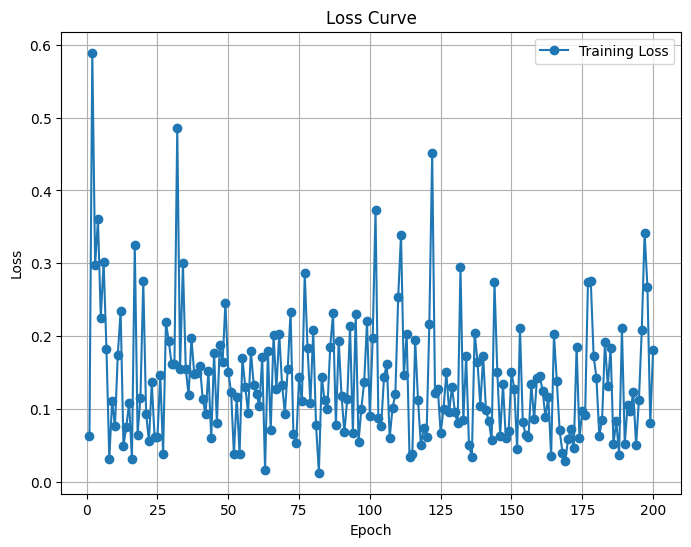

Predicted value for the first sample: 1.8735
Training Loss Scaling Unreversed: 0.12742504477500916
Training Loss Scaling Reversed: 921.3561401367188


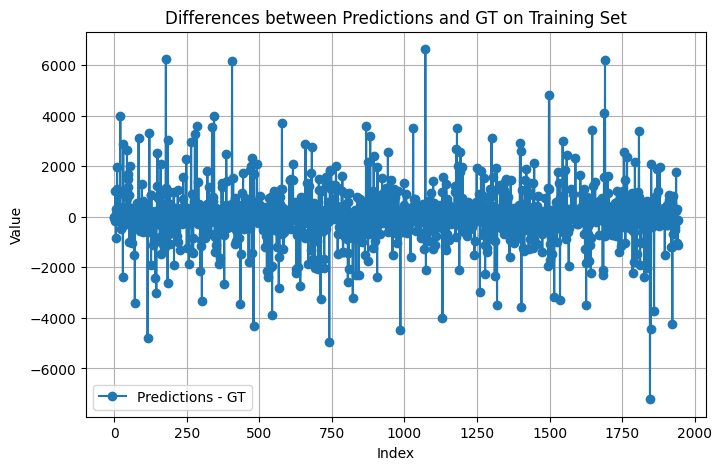

Predicted value for the first sample: 2.9031
Validation Loss Scaling Unreversed: 0.1355615258216858
Validation Loss Scaling Reversed: 980.1876831054688


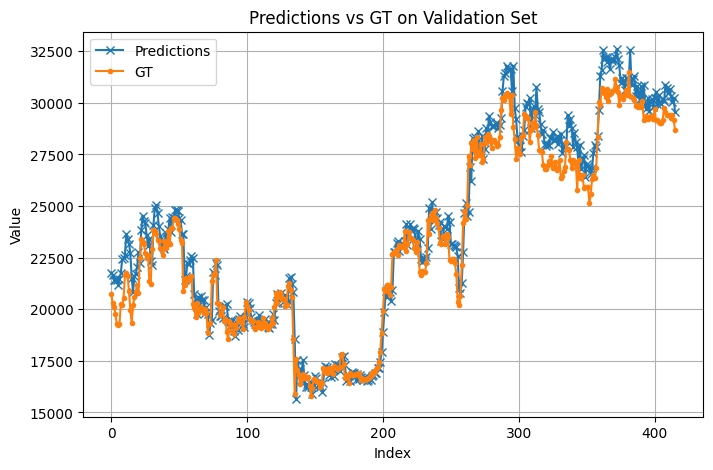

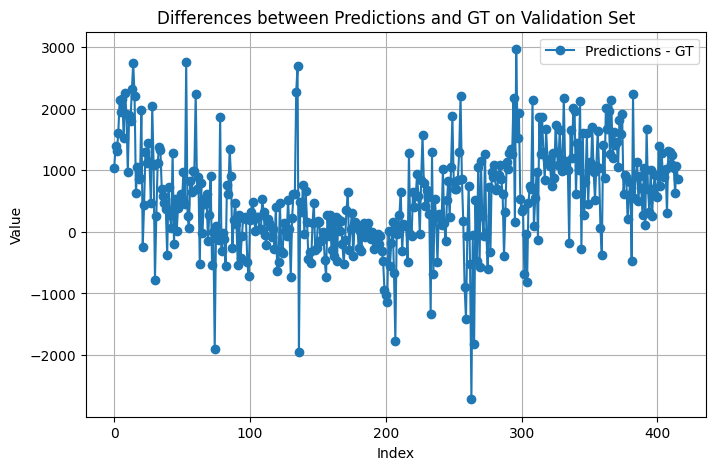

Return: 0.7908514738082886
Max Drawdown: -0.1909501552581787
Epoch [5/200], Loss: 0.1896
Epoch [10/200], Loss: 0.2315
Epoch [15/200], Loss: 0.0673
Epoch [20/200], Loss: 0.1920
Epoch [25/200], Loss: 0.0913
Epoch [30/200], Loss: 0.1592
Epoch [35/200], Loss: 0.1453
Epoch [40/200], Loss: 0.3462
Epoch [45/200], Loss: 0.0687
Epoch [50/200], Loss: 0.2230
Epoch [55/200], Loss: 0.1401
Epoch [60/200], Loss: 0.1441
Epoch [65/200], Loss: 0.0663
Epoch [70/200], Loss: 0.0831
Epoch [75/200], Loss: 0.2382
Epoch [80/200], Loss: 0.0494
Epoch [85/200], Loss: 0.1653
Epoch [90/200], Loss: 0.1241
Epoch [95/200], Loss: 0.1672
Epoch [100/200], Loss: 0.3114
Epoch [105/200], Loss: 0.0882
Epoch [110/200], Loss: 0.1048
Epoch [115/200], Loss: 0.1018
Epoch [120/200], Loss: 0.0411
Epoch [125/200], Loss: 0.0281
Epoch [130/200], Loss: 0.0801
Epoch [135/200], Loss: 0.0599
Epoch [140/200], Loss: 0.0471
Epoch [145/200], Loss: 0.0963
Epoch [150/200], Loss: 0.1757
Epoch [155/200], Loss: 0.1854
Epoch [160/200], Loss: 0.1215

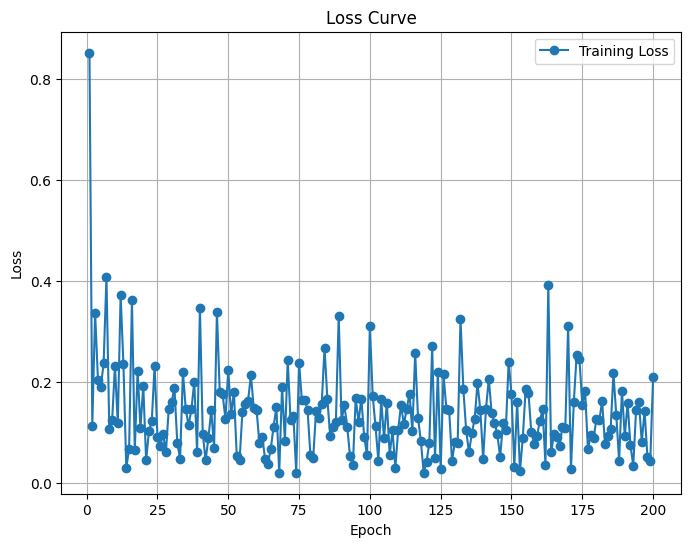

Predicted value for the first sample: 1.8343
Training Loss Scaling Unreversed: 0.13619592785835266
Training Loss Scaling Reversed: 984.7748413085938


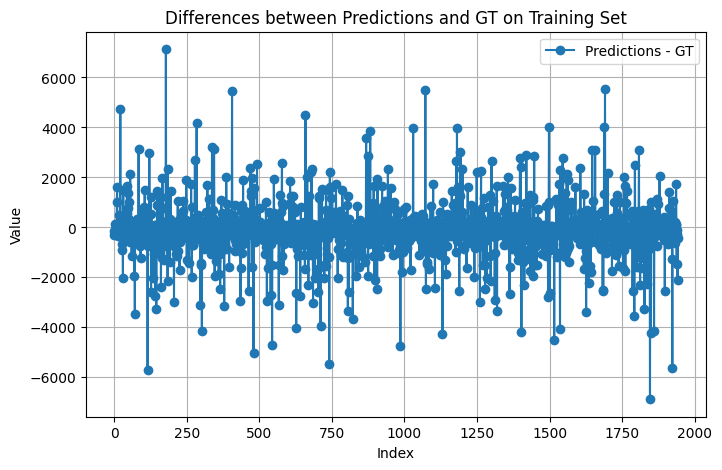

Predicted value for the first sample: 2.8414
Validation Loss Scaling Unreversed: 0.1058925911784172
Validation Loss Scaling Reversed: 765.6641845703125


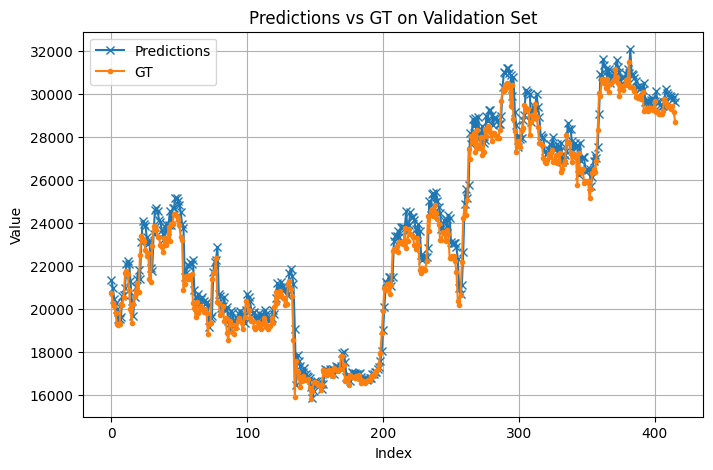

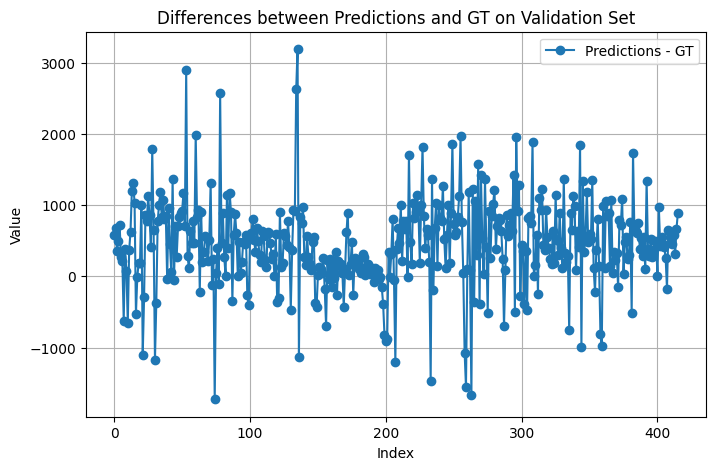

Return: 0.5423731803894043
Max Drawdown: -0.15367180109024048
Epoch [5/200], Loss: 0.5183
Epoch [10/200], Loss: 0.5936
Epoch [15/200], Loss: 1.1050
Epoch [20/200], Loss: 0.4177
Epoch [25/200], Loss: 0.2314
Epoch [30/200], Loss: 0.1807
Epoch [35/200], Loss: 0.4628
Epoch [40/200], Loss: 0.0840
Epoch [45/200], Loss: 0.0661
Epoch [50/200], Loss: 0.2537
Epoch [55/200], Loss: 0.0726
Epoch [60/200], Loss: 0.1093
Epoch [65/200], Loss: 0.1239
Epoch [70/200], Loss: 0.2212
Epoch [75/200], Loss: 0.3036
Epoch [80/200], Loss: 0.3273
Epoch [85/200], Loss: 0.5447
Epoch [90/200], Loss: 0.0792
Epoch [95/200], Loss: 0.1656
Epoch [100/200], Loss: 0.1288
Epoch [105/200], Loss: 0.2127
Epoch [110/200], Loss: 0.3685
Epoch [115/200], Loss: 0.3782
Epoch [120/200], Loss: 0.1946
Epoch [125/200], Loss: 0.1842
Epoch [130/200], Loss: 0.3285
Epoch [135/200], Loss: 0.1274
Epoch [140/200], Loss: 0.0612
Epoch [145/200], Loss: 0.1475
Epoch [150/200], Loss: 0.2206
Epoch [155/200], Loss: 0.1361
Epoch [160/200], Loss: 0.089

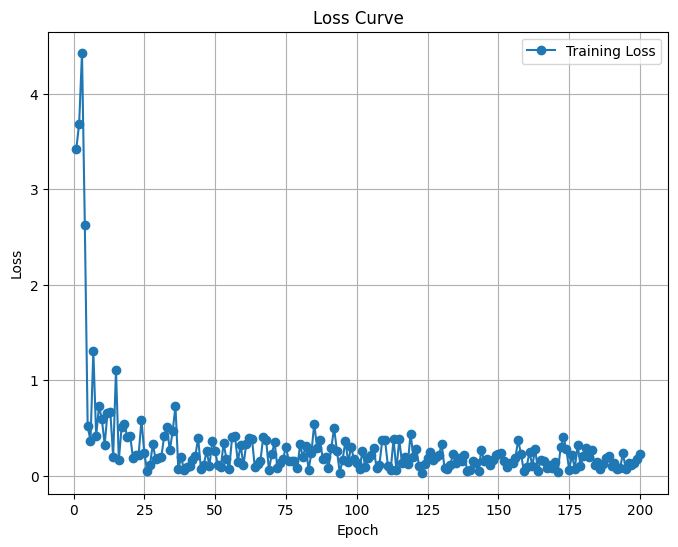

Predicted value for the first sample: 1.9278
Training Loss Scaling Unreversed: 0.17595858871936798
Training Loss Scaling Reversed: 1272.2816162109375


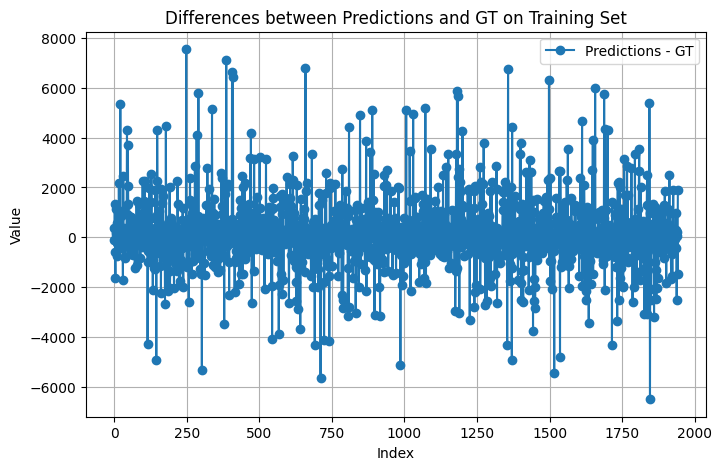

Predicted value for the first sample: 2.9082
Validation Loss Scaling Unreversed: 0.15057635307312012
Validation Loss Scaling Reversed: 1088.75341796875


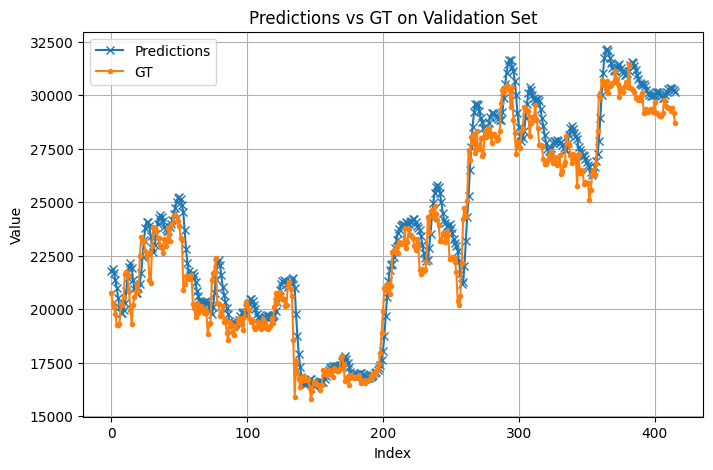

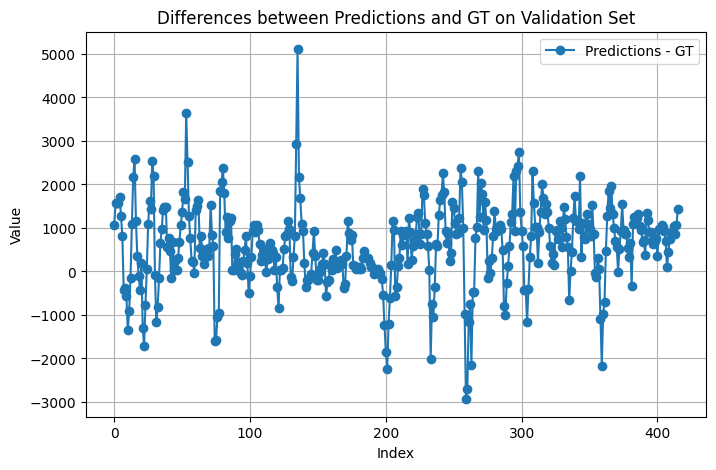

Return: 0.10986721515655518
Max Drawdown: -0.3524782955646515
Epoch [5/200], Loss: 0.1589
Epoch [10/200], Loss: 0.0281
Epoch [15/200], Loss: 0.5225
Epoch [20/200], Loss: 0.1795
Epoch [25/200], Loss: 0.2139
Epoch [30/200], Loss: 0.0565
Epoch [35/200], Loss: 0.3308
Epoch [40/200], Loss: 0.2019
Epoch [45/200], Loss: 0.1237
Epoch [50/200], Loss: 0.0851
Epoch [55/200], Loss: 0.1590
Epoch [60/200], Loss: 0.0733
Epoch [65/200], Loss: 0.1056
Epoch [70/200], Loss: 0.2146
Epoch [75/200], Loss: 0.0523
Epoch [80/200], Loss: 0.1931
Epoch [85/200], Loss: 0.2031
Epoch [90/200], Loss: 0.4159
Epoch [95/200], Loss: 0.1468
Epoch [100/200], Loss: 0.0505
Epoch [105/200], Loss: 0.1198
Epoch [110/200], Loss: 0.1125
Epoch [115/200], Loss: 0.1103
Epoch [120/200], Loss: 0.1011
Epoch [125/200], Loss: 0.1117
Epoch [130/200], Loss: 0.1196
Epoch [135/200], Loss: 0.1356
Epoch [140/200], Loss: 0.0814
Epoch [145/200], Loss: 0.1427
Epoch [150/200], Loss: 0.1619
Epoch [155/200], Loss: 0.1566
Epoch [160/200], Loss: 0.083

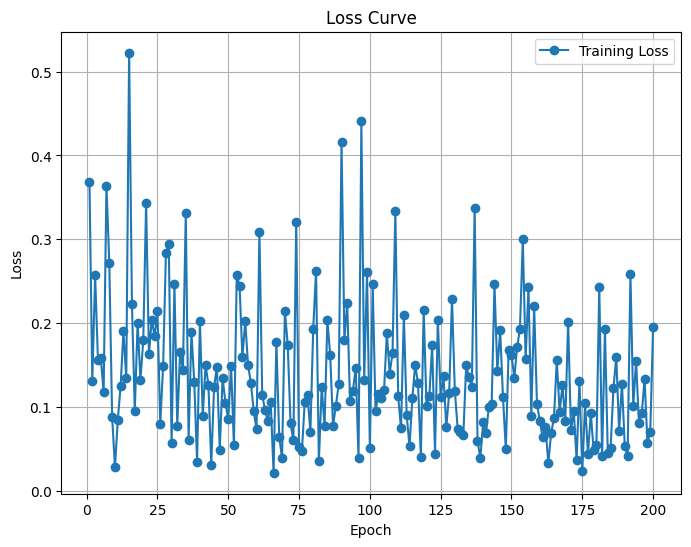

Predicted value for the first sample: 1.8536
Training Loss Scaling Unreversed: 0.12738460302352905
Training Loss Scaling Reversed: 921.0637817382812


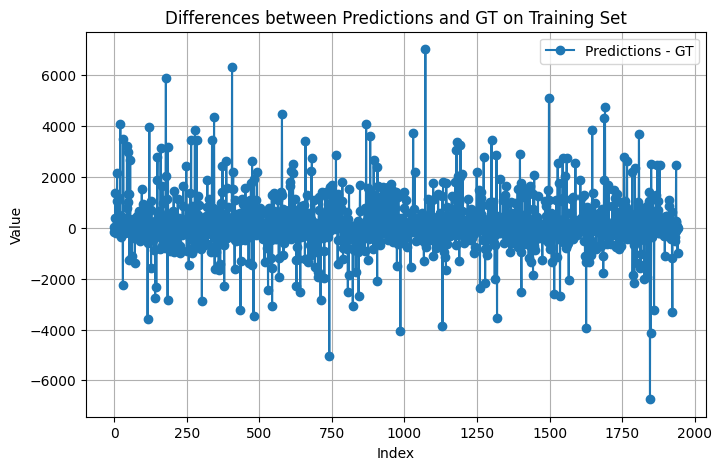

Predicted value for the first sample: 2.8165
Validation Loss Scaling Unreversed: 0.2537210285663605
Validation Loss Scaling Reversed: 1834.548828125


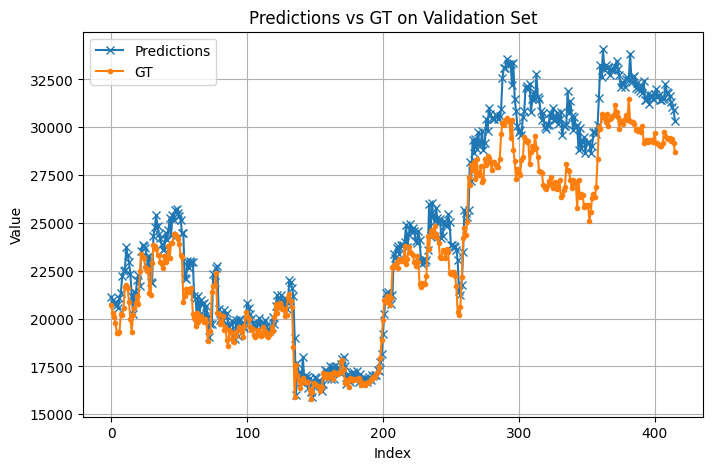

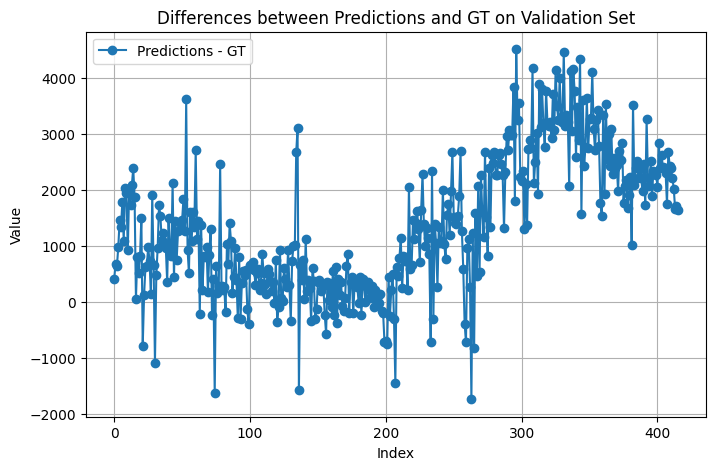

Return: 0.1520850658416748
Max Drawdown: -0.3302932381629944
Epoch [5/200], Loss: 0.1397
Epoch [10/200], Loss: 0.4685
Epoch [15/200], Loss: 0.3065
Epoch [20/200], Loss: 0.1300
Epoch [25/200], Loss: 0.0726
Epoch [30/200], Loss: 0.3360
Epoch [35/200], Loss: 0.1366
Epoch [40/200], Loss: 0.0628
Epoch [45/200], Loss: 0.0891
Epoch [50/200], Loss: 0.2723
Epoch [55/200], Loss: 0.1046
Epoch [60/200], Loss: 0.1204
Epoch [65/200], Loss: 0.1498
Epoch [70/200], Loss: 0.0876
Epoch [75/200], Loss: 0.0816
Epoch [80/200], Loss: 0.1684
Epoch [85/200], Loss: 0.1829
Epoch [90/200], Loss: 0.1136
Epoch [95/200], Loss: 0.3192
Epoch [100/200], Loss: 0.0410
Epoch [105/200], Loss: 0.0922
Epoch [110/200], Loss: 0.1522
Epoch [115/200], Loss: 0.0525
Epoch [120/200], Loss: 0.2446
Epoch [125/200], Loss: 0.1917
Epoch [130/200], Loss: 0.1772
Epoch [135/200], Loss: 0.1498
Epoch [140/200], Loss: 0.1408
Epoch [145/200], Loss: 0.0440
Epoch [150/200], Loss: 0.0861
Epoch [155/200], Loss: 0.2386
Epoch [160/200], Loss: 0.2786

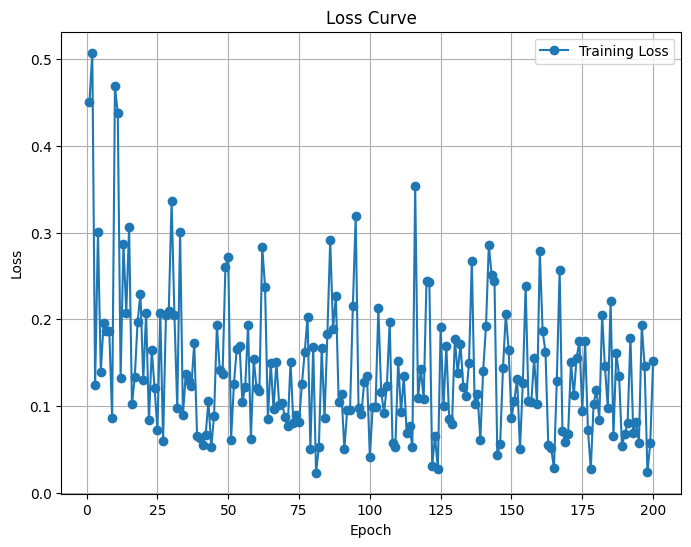

Predicted value for the first sample: 1.7893
Training Loss Scaling Unreversed: 0.13525190949440002
Training Loss Scaling Reversed: 977.9488525390625


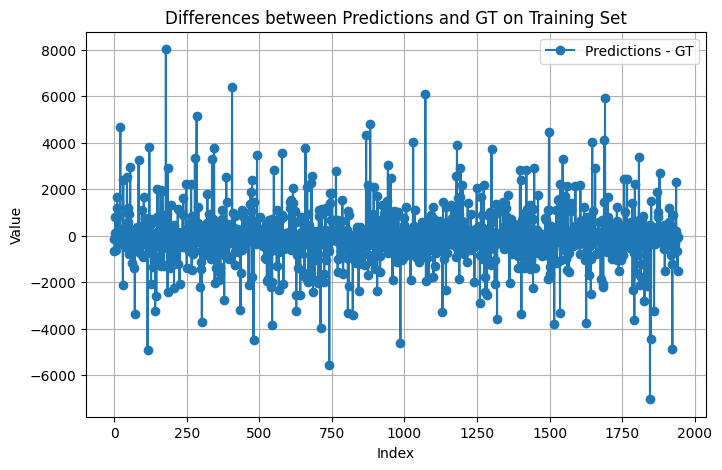

Predicted value for the first sample: 2.7884
Validation Loss Scaling Unreversed: 0.08972122520208359
Validation Loss Scaling Reversed: 648.736083984375


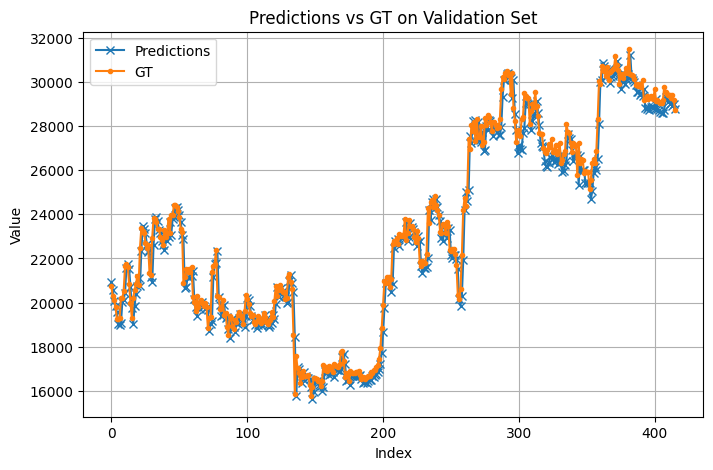

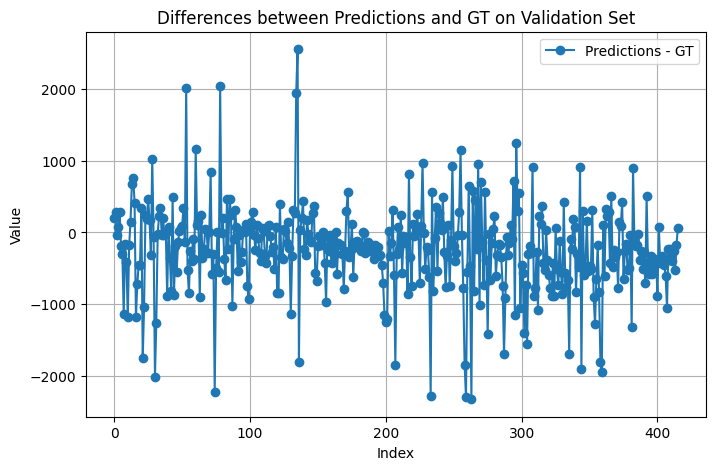

Return: 0.37628281116485596
Max Drawdown: -0.23498785495758057
Epoch [5/200], Loss: 1.8380
Epoch [10/200], Loss: 0.8634
Epoch [15/200], Loss: 0.3673
Epoch [20/200], Loss: 0.1158
Epoch [25/200], Loss: 0.2889
Epoch [30/200], Loss: 0.1801
Epoch [35/200], Loss: 0.1361
Epoch [40/200], Loss: 0.3594
Epoch [45/200], Loss: 0.1273
Epoch [50/200], Loss: 0.1817
Epoch [55/200], Loss: 0.0899
Epoch [60/200], Loss: 0.3289
Epoch [65/200], Loss: 0.0744
Epoch [70/200], Loss: 0.2005
Epoch [75/200], Loss: 0.4304
Epoch [80/200], Loss: 0.4720
Epoch [85/200], Loss: 0.0771
Epoch [90/200], Loss: 0.2049
Epoch [95/200], Loss: 0.0818
Epoch [100/200], Loss: 0.3929
Epoch [105/200], Loss: 0.2749
Epoch [110/200], Loss: 0.4420
Epoch [115/200], Loss: 0.0969
Epoch [120/200], Loss: 0.3480
Epoch [125/200], Loss: 0.0722
Epoch [130/200], Loss: 0.1088
Epoch [135/200], Loss: 0.2650
Epoch [140/200], Loss: 0.0583
Epoch [145/200], Loss: 0.4590
Epoch [150/200], Loss: 0.2541
Epoch [155/200], Loss: 0.1624
Epoch [160/200], Loss: 0.18

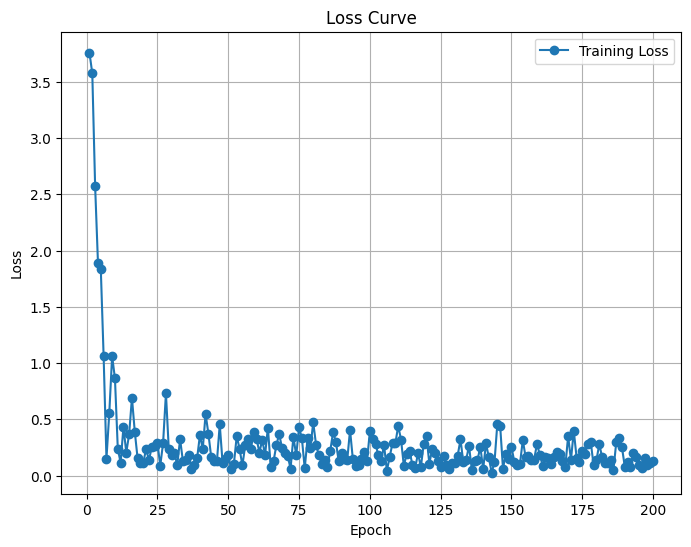

Predicted value for the first sample: 1.8948
Training Loss Scaling Unreversed: 0.17823733389377594
Training Loss Scaling Reversed: 1288.75830078125


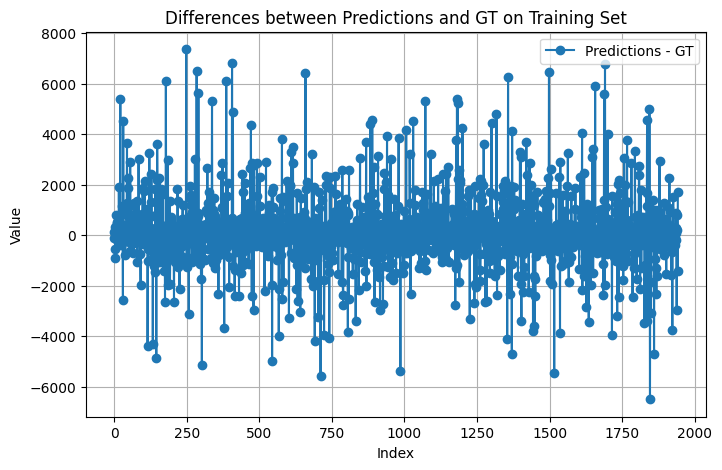

Predicted value for the first sample: 2.9108
Validation Loss Scaling Unreversed: 0.13689492642879486
Validation Loss Scaling Reversed: 989.8289794921875


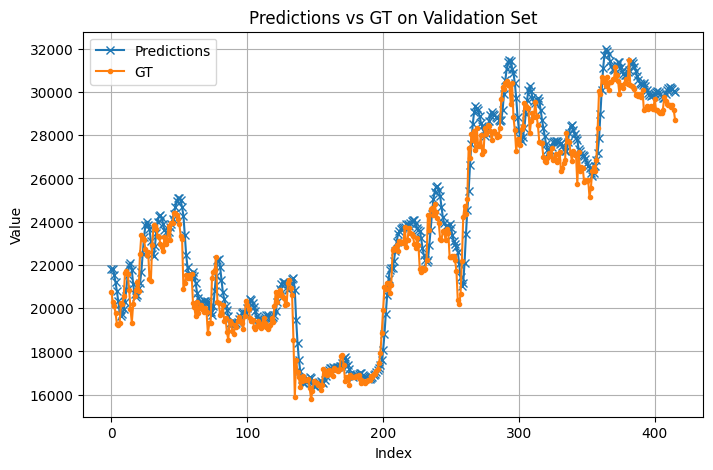

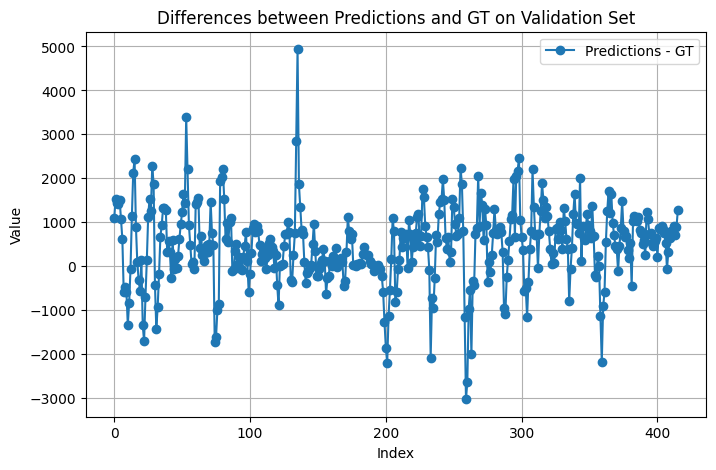

Return: 0.12972283363342285
Max Drawdown: -0.3545859158039093
Epoch [5/200], Loss: 0.1777
Epoch [10/200], Loss: 0.0852
Epoch [15/200], Loss: 0.1275
Epoch [20/200], Loss: 0.1710
Epoch [25/200], Loss: 0.0422
Epoch [30/200], Loss: 0.3672
Epoch [35/200], Loss: 0.0857
Epoch [40/200], Loss: 0.1059
Epoch [45/200], Loss: 0.1427
Epoch [50/200], Loss: 0.3140
Epoch [55/200], Loss: 0.1648
Epoch [60/200], Loss: 0.1142
Epoch [65/200], Loss: 0.0466
Epoch [70/200], Loss: 0.1441
Epoch [75/200], Loss: 0.1554
Epoch [80/200], Loss: 0.0418
Epoch [85/200], Loss: 0.2886
Epoch [90/200], Loss: 0.4864
Epoch [95/200], Loss: 0.0496
Epoch [100/200], Loss: 0.1995
Epoch [105/200], Loss: 0.0251
Epoch [110/200], Loss: 0.0704
Epoch [115/200], Loss: 0.1618
Epoch [120/200], Loss: 0.1363
Epoch [125/200], Loss: 0.0828
Epoch [130/200], Loss: 0.2276
Epoch [135/200], Loss: 0.1057
Epoch [140/200], Loss: 0.1152
Epoch [145/200], Loss: 0.3480
Epoch [150/200], Loss: 0.0764
Epoch [155/200], Loss: 0.1104
Epoch [160/200], Loss: 0.057

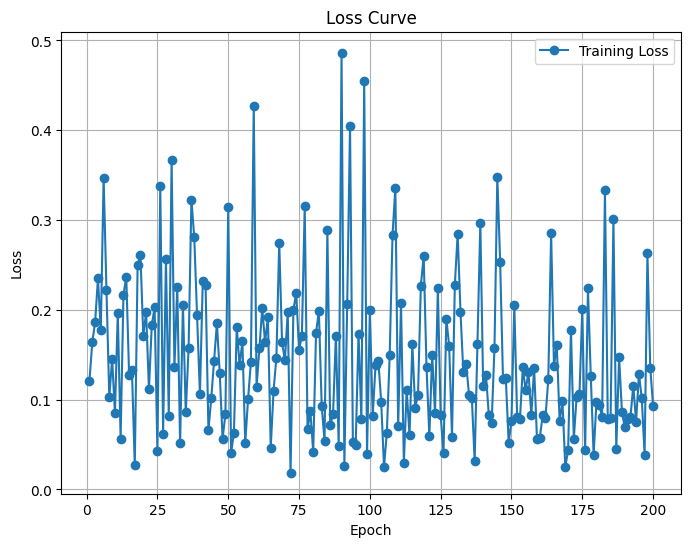

Predicted value for the first sample: 1.8121
Training Loss Scaling Unreversed: 0.13638955354690552
Training Loss Scaling Reversed: 986.1746826171875


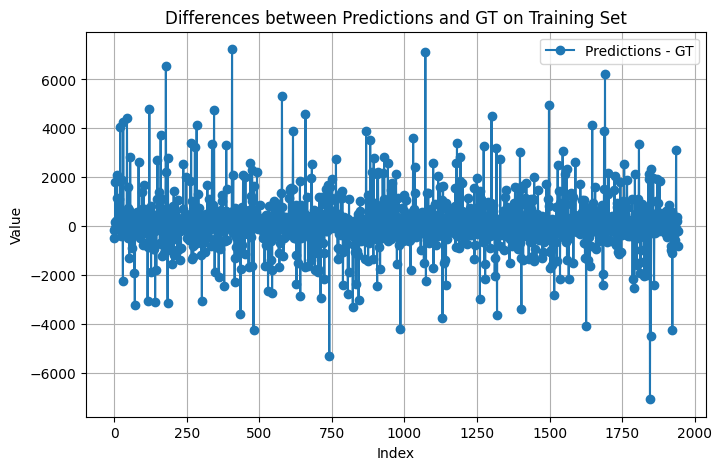

Predicted value for the first sample: 2.6424
Validation Loss Scaling Unreversed: 0.20999237895011902
Validation Loss Scaling Reversed: 1518.3653564453125


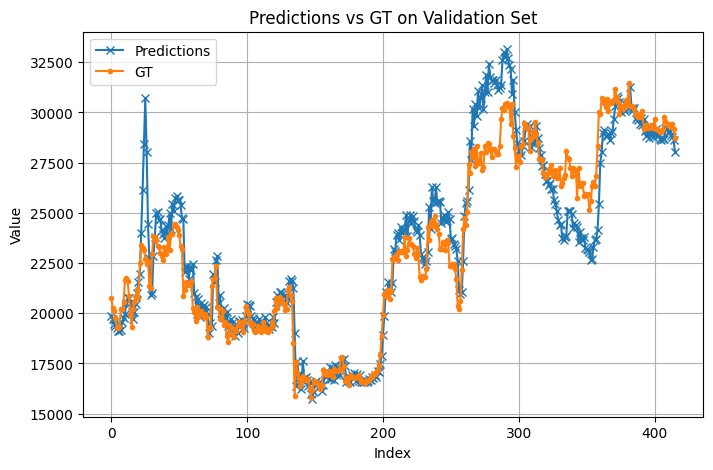

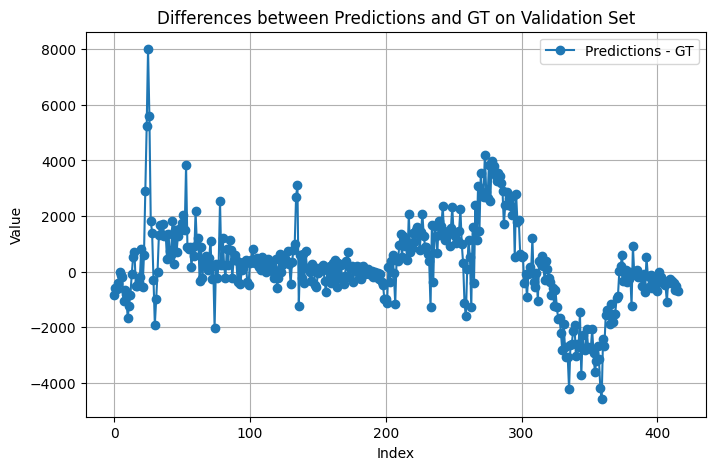

Return: 0.6707843542098999
Max Drawdown: -0.2795071601867676
Epoch [5/200], Loss: 0.2852
Epoch [10/200], Loss: 0.0985
Epoch [15/200], Loss: 0.1585
Epoch [20/200], Loss: 0.1175
Epoch [25/200], Loss: 0.1311
Epoch [30/200], Loss: 0.1092
Epoch [35/200], Loss: 0.0743
Epoch [40/200], Loss: 0.0760
Epoch [45/200], Loss: 0.1443
Epoch [50/200], Loss: 0.3568
Epoch [55/200], Loss: 0.2708
Epoch [60/200], Loss: 0.0603
Epoch [65/200], Loss: 0.2787
Epoch [70/200], Loss: 0.0681
Epoch [75/200], Loss: 0.2431
Epoch [80/200], Loss: 0.1474
Epoch [85/200], Loss: 0.0670
Epoch [90/200], Loss: 0.1516
Epoch [95/200], Loss: 0.0802
Epoch [100/200], Loss: 0.0805
Epoch [105/200], Loss: 0.2501
Epoch [110/200], Loss: 0.1773
Epoch [115/200], Loss: 0.0409
Epoch [120/200], Loss: 0.3451
Epoch [125/200], Loss: 0.0477
Epoch [130/200], Loss: 0.2878
Epoch [135/200], Loss: 0.0600
Epoch [140/200], Loss: 0.1336
Epoch [145/200], Loss: 0.1379
Epoch [150/200], Loss: 0.0450
Epoch [155/200], Loss: 0.1780
Epoch [160/200], Loss: 0.0707

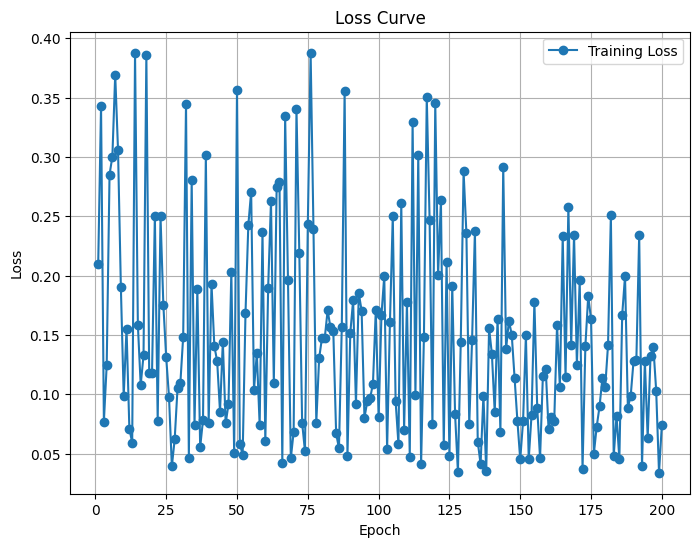

Predicted value for the first sample: 1.7966
Training Loss Scaling Unreversed: 0.16958120465278625
Training Loss Scaling Reversed: 1226.16943359375


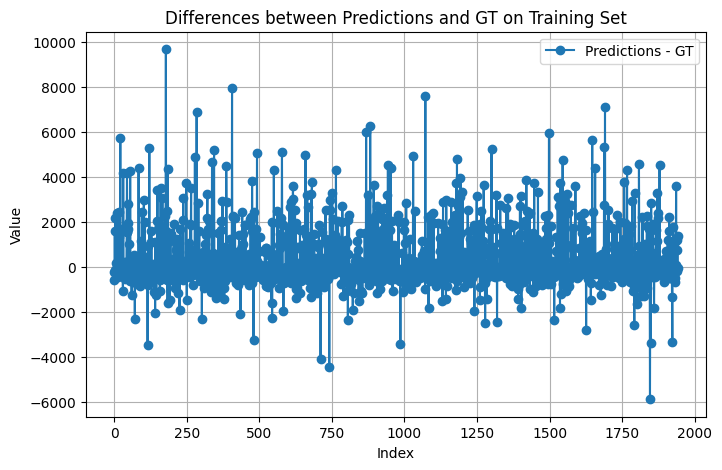

Predicted value for the first sample: 2.8973
Validation Loss Scaling Unreversed: 0.12313732504844666
Validation Loss Scaling Reversed: 890.3536987304688


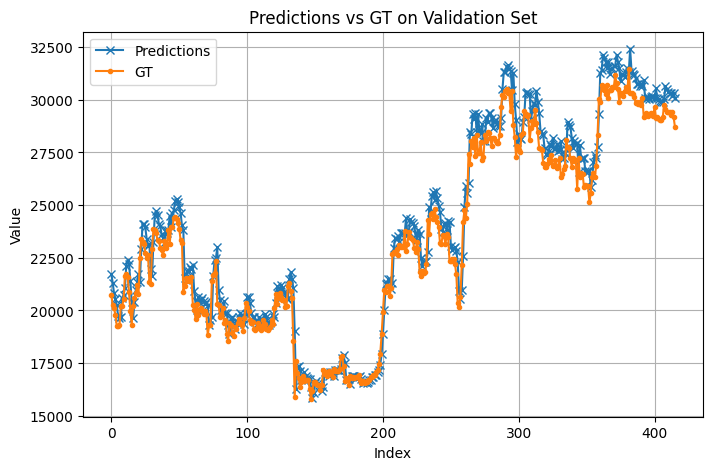

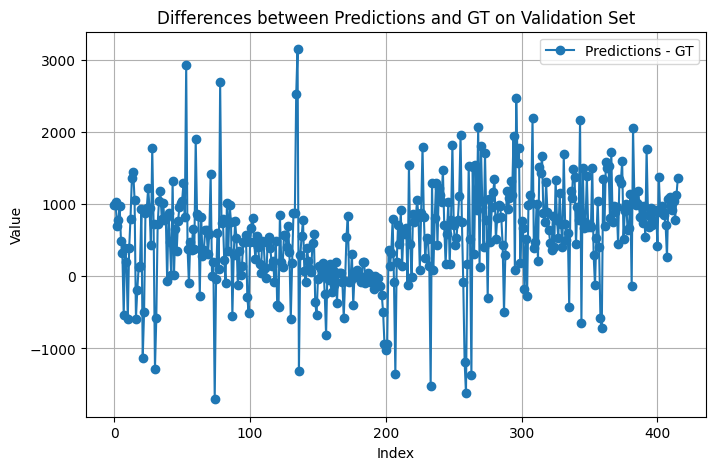

Return: 0.39502060413360596
Max Drawdown: -0.22294877469539642
Epoch [5/200], Loss: 1.8555
Epoch [10/200], Loss: 0.3090
Epoch [15/200], Loss: 0.4221
Epoch [20/200], Loss: 0.8014
Epoch [25/200], Loss: 0.2048
Epoch [30/200], Loss: 0.3334
Epoch [35/200], Loss: 0.3007
Epoch [40/200], Loss: 0.3503
Epoch [45/200], Loss: 0.3131
Epoch [50/200], Loss: 0.1029
Epoch [55/200], Loss: 0.1614
Epoch [60/200], Loss: 0.2984
Epoch [65/200], Loss: 0.3614
Epoch [70/200], Loss: 0.1615
Epoch [75/200], Loss: 0.1921
Epoch [80/200], Loss: 0.1511
Epoch [85/200], Loss: 0.1457
Epoch [90/200], Loss: 0.0490
Epoch [95/200], Loss: 0.2973
Epoch [100/200], Loss: 0.2579
Epoch [105/200], Loss: 0.0508
Epoch [110/200], Loss: 0.2726
Epoch [115/200], Loss: 0.0795
Epoch [120/200], Loss: 0.1686
Epoch [125/200], Loss: 0.4036
Epoch [130/200], Loss: 0.1308
Epoch [135/200], Loss: 0.0218
Epoch [140/200], Loss: 0.3567
Epoch [145/200], Loss: 0.1652
Epoch [150/200], Loss: 0.3437
Epoch [155/200], Loss: 0.0997
Epoch [160/200], Loss: 0.16

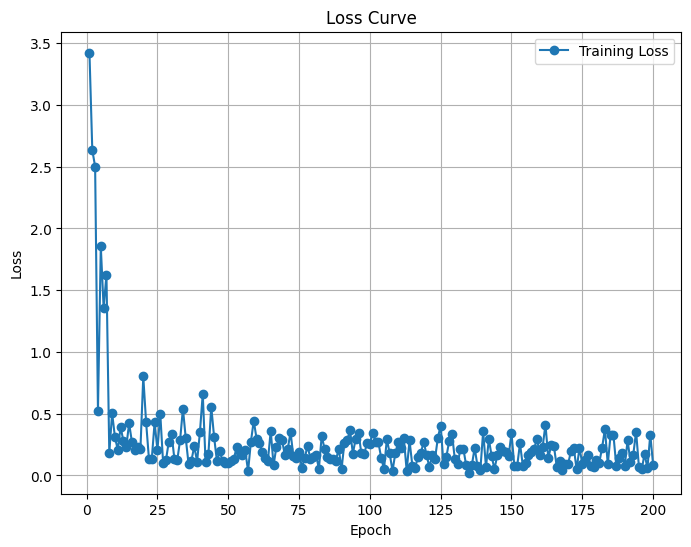

Predicted value for the first sample: 1.9148
Training Loss Scaling Unreversed: 0.18691343069076538
Training Loss Scaling Reversed: 1351.4913330078125


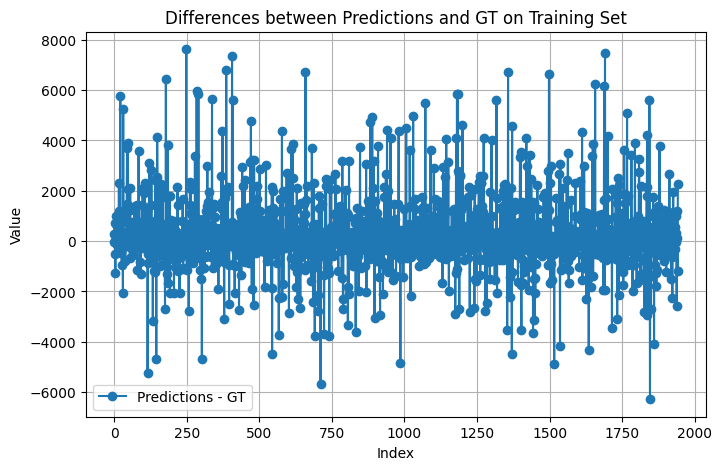

Predicted value for the first sample: 2.9257
Validation Loss Scaling Unreversed: 0.15251341462135315
Validation Loss Scaling Reversed: 1102.7596435546875


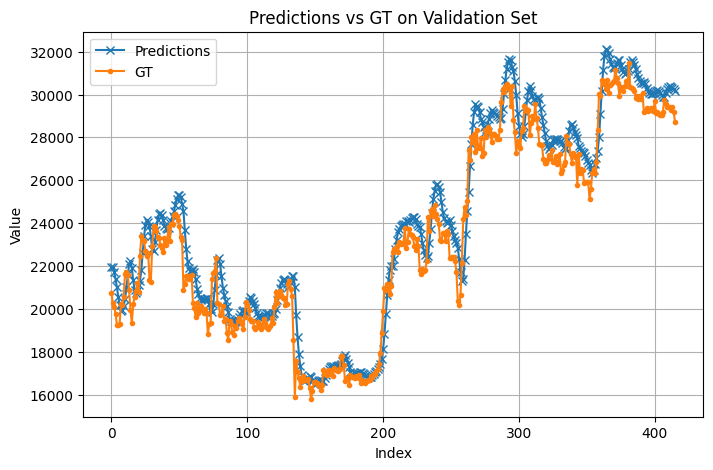

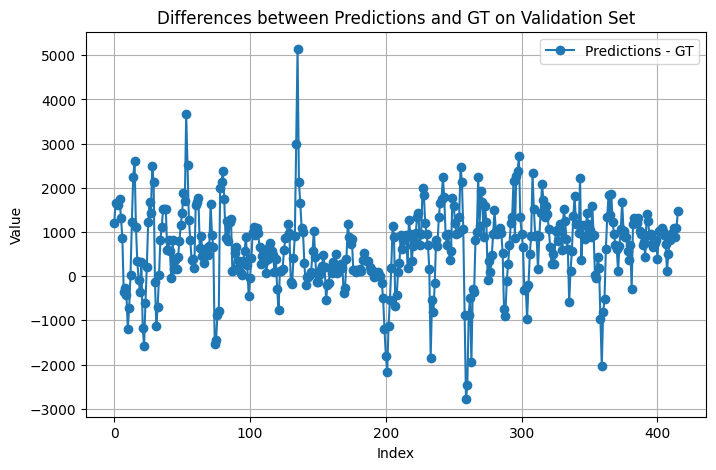

Return: 0.15157294273376465
Max Drawdown: -0.3513985276222229
Epoch [5/200], Loss: 0.1979
Epoch [10/200], Loss: 0.1327
Epoch [15/200], Loss: 0.1874
Epoch [20/200], Loss: 0.1052
Epoch [25/200], Loss: 0.1656
Epoch [30/200], Loss: 0.1568
Epoch [35/200], Loss: 0.1542
Epoch [40/200], Loss: 0.0953
Epoch [45/200], Loss: 0.1767
Epoch [50/200], Loss: 0.2222
Epoch [55/200], Loss: 0.1172
Epoch [60/200], Loss: 0.1148
Epoch [65/200], Loss: 0.1368
Epoch [70/200], Loss: 0.1737
Epoch [75/200], Loss: 0.2021
Epoch [80/200], Loss: 0.1071
Epoch [85/200], Loss: 0.1536
Epoch [90/200], Loss: 0.1118
Epoch [95/200], Loss: 0.1910
Epoch [100/200], Loss: 0.1769
Epoch [105/200], Loss: 0.1469
Epoch [110/200], Loss: 0.1743
Epoch [115/200], Loss: 0.0797
Epoch [120/200], Loss: 0.1008
Epoch [125/200], Loss: 0.0940
Epoch [130/200], Loss: 0.1000
Epoch [135/200], Loss: 0.2361
Epoch [140/200], Loss: 0.0832
Epoch [145/200], Loss: 0.1288
Epoch [150/200], Loss: 0.0490
Epoch [155/200], Loss: 0.1686
Epoch [160/200], Loss: 0.095

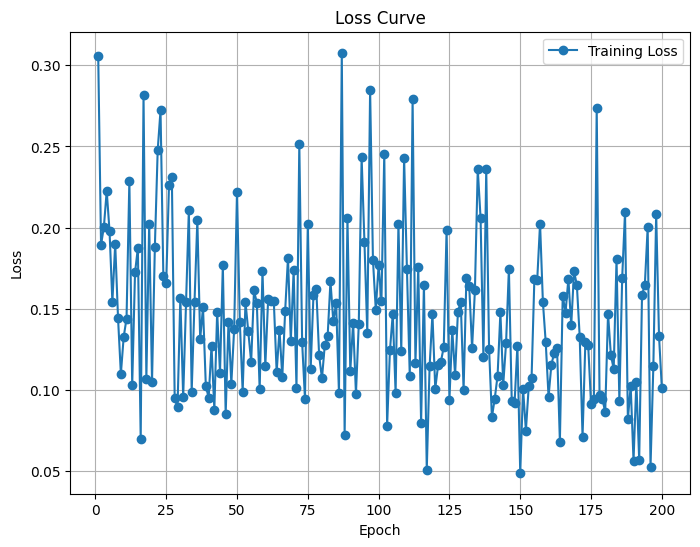

Predicted value for the first sample: 1.8902
Training Loss Scaling Unreversed: 0.13887712359428406
Training Loss Scaling Reversed: 1004.1613159179688


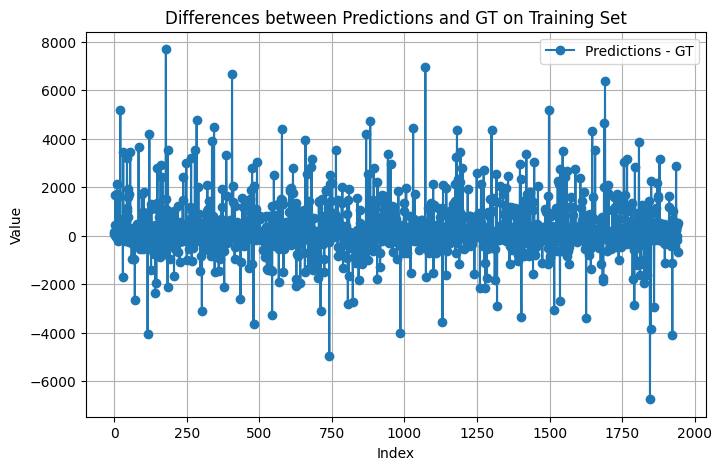

Predicted value for the first sample: 2.9446
Validation Loss Scaling Unreversed: 0.12702308595180511
Validation Loss Scaling Reversed: 918.449951171875


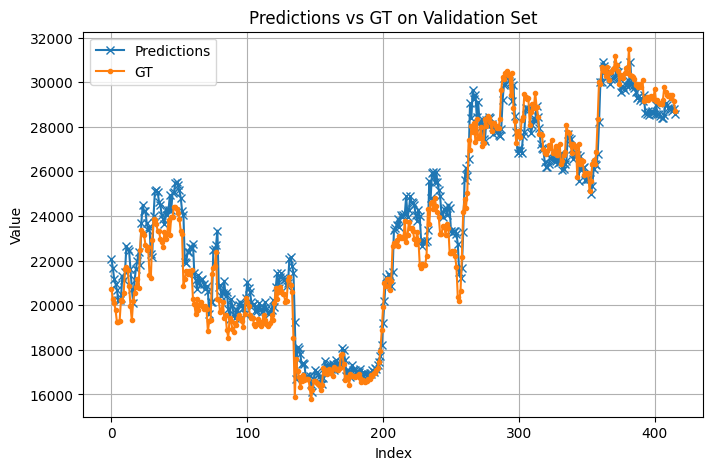

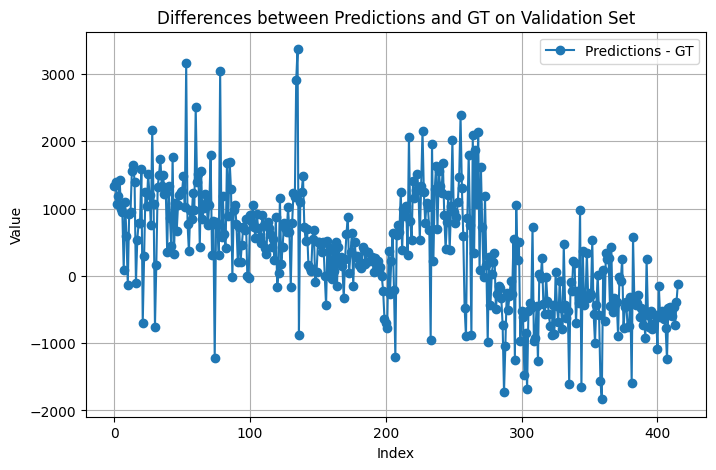

Return: 0.3606683015823364
Max Drawdown: -0.2542506754398346
Epoch [5/200], Loss: 0.3001
Epoch [10/200], Loss: 0.3360
Epoch [15/200], Loss: 0.1176
Epoch [20/200], Loss: 0.1966
Epoch [25/200], Loss: 0.1986
Epoch [30/200], Loss: 0.1345
Epoch [35/200], Loss: 0.1987
Epoch [40/200], Loss: 0.2057
Epoch [45/200], Loss: 0.1926
Epoch [50/200], Loss: 0.2485
Epoch [55/200], Loss: 0.1287
Epoch [60/200], Loss: 0.1669
Epoch [65/200], Loss: 0.0850
Epoch [70/200], Loss: 0.0671
Epoch [75/200], Loss: 0.1349
Epoch [80/200], Loss: 0.0979
Epoch [85/200], Loss: 0.2220
Epoch [90/200], Loss: 0.1333
Epoch [95/200], Loss: 0.1265
Epoch [100/200], Loss: 0.1740
Epoch [105/200], Loss: 0.2284
Epoch [110/200], Loss: 0.1186
Epoch [115/200], Loss: 0.2279
Epoch [120/200], Loss: 0.1056
Epoch [125/200], Loss: 0.1634
Epoch [130/200], Loss: 0.2331
Epoch [135/200], Loss: 0.1102
Epoch [140/200], Loss: 0.1413
Epoch [145/200], Loss: 0.1036
Epoch [150/200], Loss: 0.2081
Epoch [155/200], Loss: 0.1162
Epoch [160/200], Loss: 0.1860

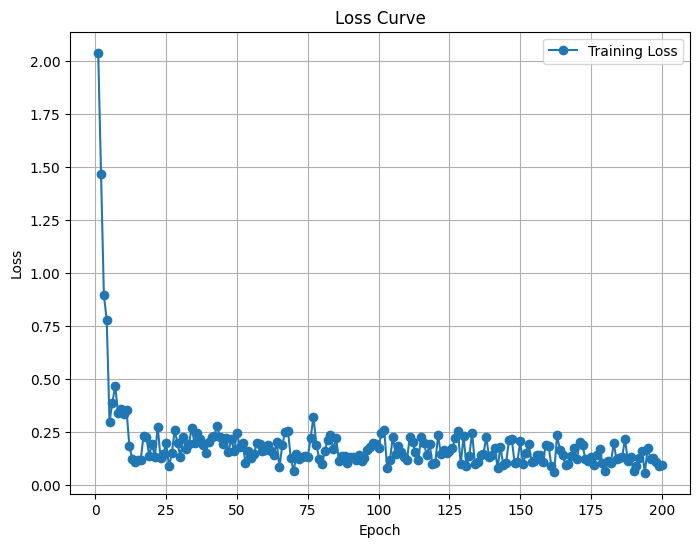

Predicted value for the first sample: 1.8202
Training Loss Scaling Unreversed: 0.14504122734069824
Training Loss Scaling Reversed: 1048.7313232421875


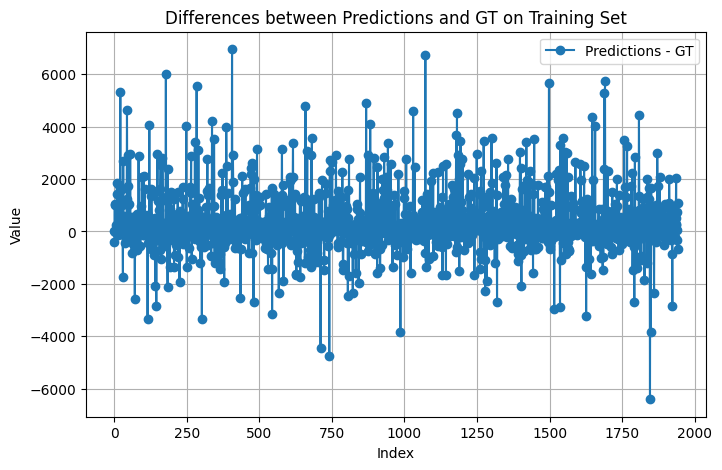

Predicted value for the first sample: 2.9105
Validation Loss Scaling Unreversed: 0.11372844874858856
Validation Loss Scaling Reversed: 822.3220825195312


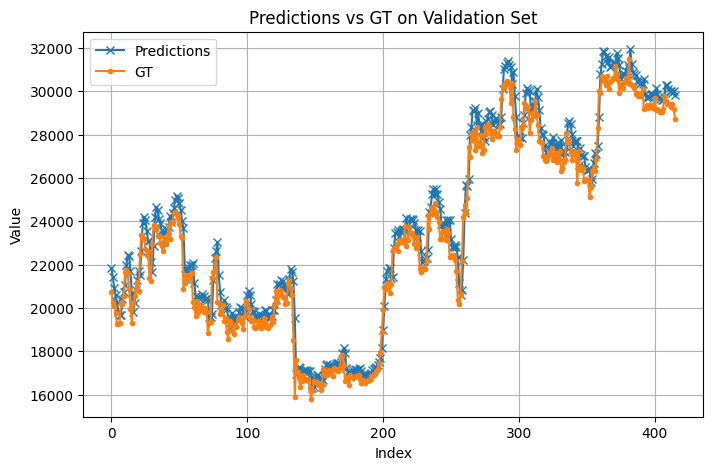

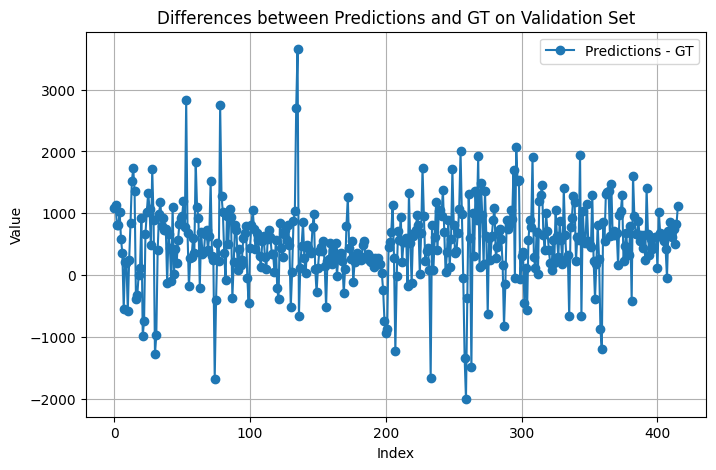

Return: 0.5769344568252563
Max Drawdown: -0.19371213018894196
Epoch [5/200], Loss: 3.3682
Epoch [10/200], Loss: 2.2768
Epoch [15/200], Loss: 1.1993
Epoch [20/200], Loss: 0.4218
Epoch [25/200], Loss: 0.8536
Epoch [30/200], Loss: 0.5444
Epoch [35/200], Loss: 0.9584
Epoch [40/200], Loss: 0.6334
Epoch [45/200], Loss: 0.6123
Epoch [50/200], Loss: 0.2968
Epoch [55/200], Loss: 0.3779
Epoch [60/200], Loss: 0.1870
Epoch [65/200], Loss: 0.4363
Epoch [70/200], Loss: 0.4284
Epoch [75/200], Loss: 0.2383
Epoch [80/200], Loss: 0.3435
Epoch [85/200], Loss: 0.2390
Epoch [90/200], Loss: 0.2436
Epoch [95/200], Loss: 0.2239
Epoch [100/200], Loss: 0.2088
Epoch [105/200], Loss: 0.4527
Epoch [110/200], Loss: 0.1919
Epoch [115/200], Loss: 0.4322
Epoch [120/200], Loss: 0.2597
Epoch [125/200], Loss: 0.1872
Epoch [130/200], Loss: 0.4178
Epoch [135/200], Loss: 0.3452
Epoch [140/200], Loss: 0.2957
Epoch [145/200], Loss: 0.2886
Epoch [150/200], Loss: 0.2897
Epoch [155/200], Loss: 0.2985
Epoch [160/200], Loss: 0.273

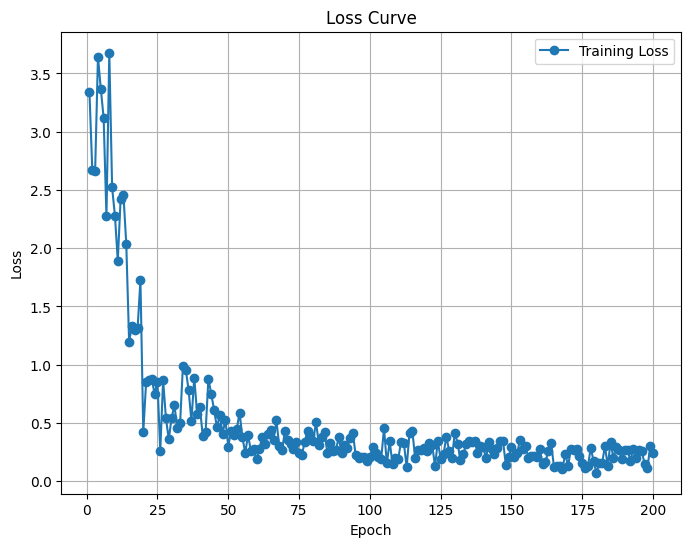

Predicted value for the first sample: 1.9862
Training Loss Scaling Unreversed: 0.2186651974916458
Training Loss Scaling Reversed: 1581.0748291015625


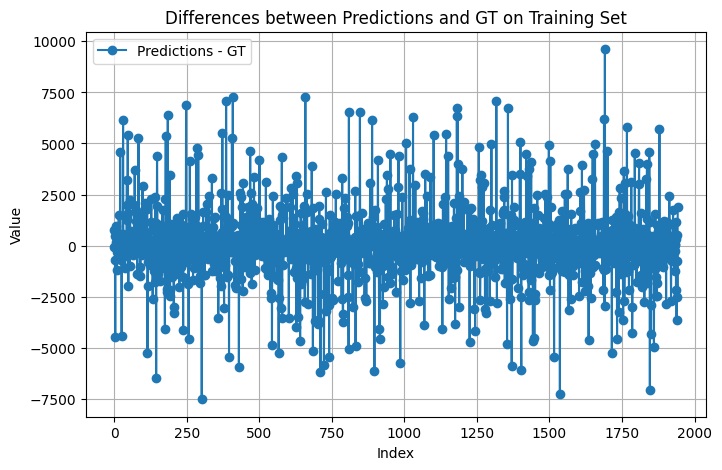

Predicted value for the first sample: 2.7989
Validation Loss Scaling Unreversed: 0.15364603698253632
Validation Loss Scaling Reversed: 1110.948974609375


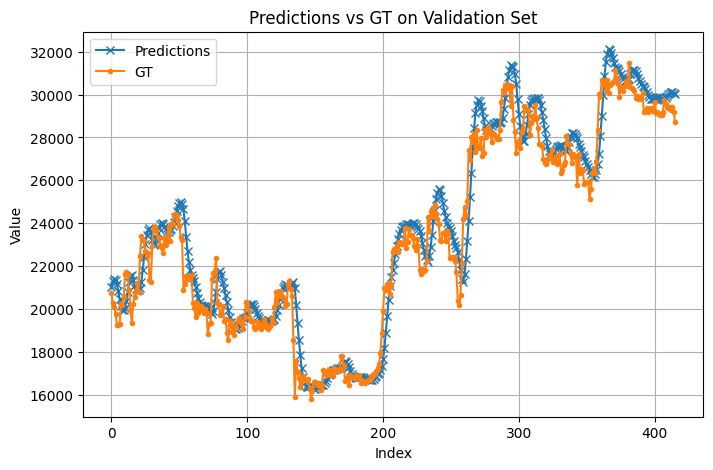

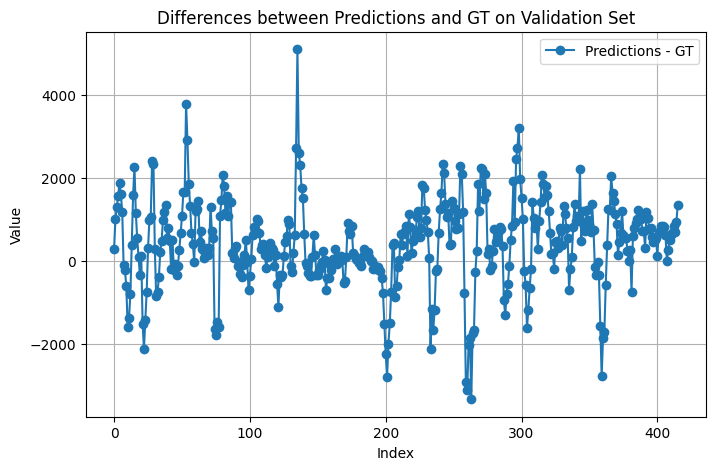

Return: -0.04889732599258423
Max Drawdown: -0.3961368501186371
Epoch [5/200], Loss: 0.1602
Epoch [10/200], Loss: 0.1634
Epoch [15/200], Loss: 0.2023
Epoch [20/200], Loss: 0.1668
Epoch [25/200], Loss: 0.1557
Epoch [30/200], Loss: 0.1887
Epoch [35/200], Loss: 0.2678
Epoch [40/200], Loss: 0.1585
Epoch [45/200], Loss: 0.2080
Epoch [50/200], Loss: 0.1416
Epoch [55/200], Loss: 0.1422
Epoch [60/200], Loss: 0.0734
Epoch [65/200], Loss: 0.1139
Epoch [70/200], Loss: 0.1315
Epoch [75/200], Loss: 0.2012
Epoch [80/200], Loss: 0.0377
Epoch [85/200], Loss: 0.0831
Epoch [90/200], Loss: 0.1440
Epoch [95/200], Loss: 0.1973
Epoch [100/200], Loss: 0.2210
Epoch [105/200], Loss: 0.0930
Epoch [110/200], Loss: 0.0533
Epoch [115/200], Loss: 0.1098
Epoch [120/200], Loss: 0.2234
Epoch [125/200], Loss: 0.1200
Epoch [130/200], Loss: 0.1270
Epoch [135/200], Loss: 0.1275
Epoch [140/200], Loss: 0.1620
Epoch [145/200], Loss: 0.2179
Epoch [150/200], Loss: 0.0996
Epoch [155/200], Loss: 0.1254
Epoch [160/200], Loss: 0.14

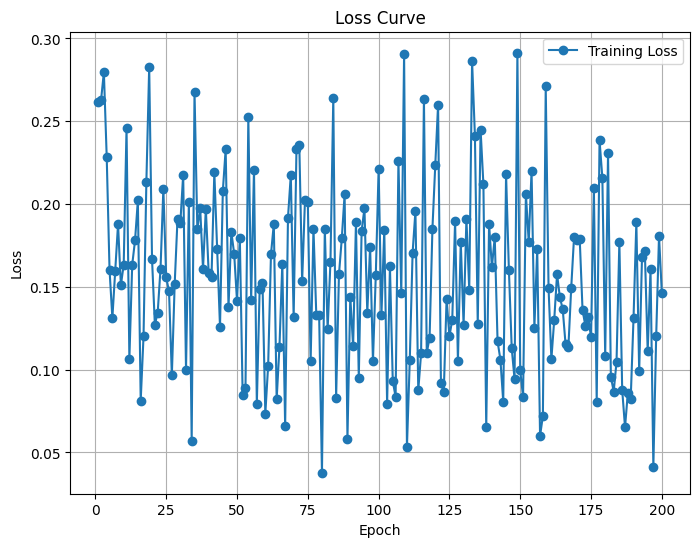

Predicted value for the first sample: 1.8638
Training Loss Scaling Unreversed: 0.13761894404888153
Training Loss Scaling Reversed: 995.0638427734375


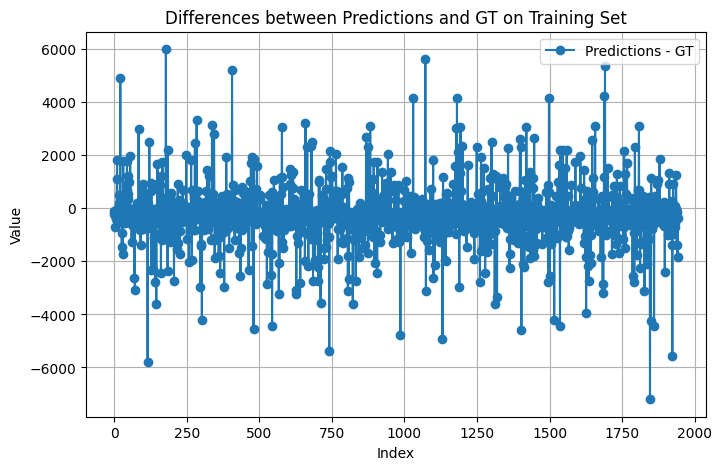

Predicted value for the first sample: 2.7002
Validation Loss Scaling Unreversed: 0.1115642860531807
Validation Loss Scaling Reversed: 806.6738891601562


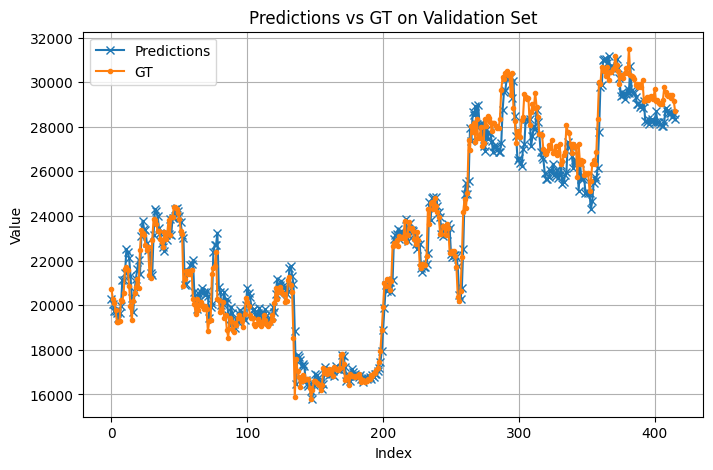

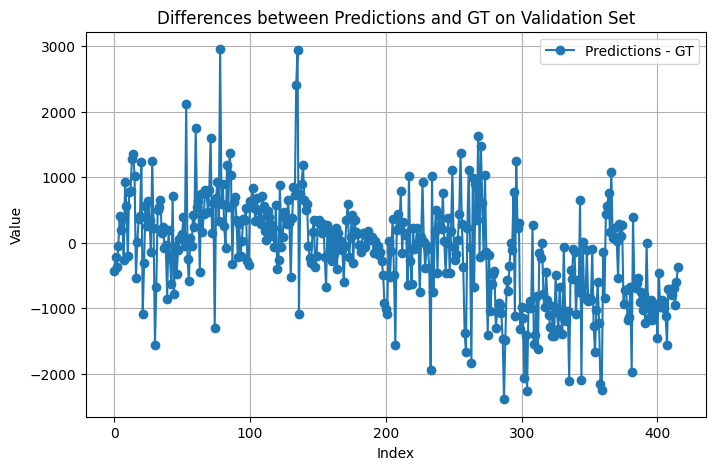

Return: 0.32573187351226807
Max Drawdown: -0.24836406111717224
Epoch [5/200], Loss: 0.4669
Epoch [10/200], Loss: 0.3734
Epoch [15/200], Loss: 0.3037
Epoch [20/200], Loss: 0.1352
Epoch [25/200], Loss: 0.2057
Epoch [30/200], Loss: 0.2700
Epoch [35/200], Loss: 0.1831
Epoch [40/200], Loss: 0.1706
Epoch [45/200], Loss: 0.1868
Epoch [50/200], Loss: 0.2207
Epoch [55/200], Loss: 0.0945
Epoch [60/200], Loss: 0.1414
Epoch [65/200], Loss: 0.1880
Epoch [70/200], Loss: 0.2133
Epoch [75/200], Loss: 0.0719
Epoch [80/200], Loss: 0.2074
Epoch [85/200], Loss: 0.3260
Epoch [90/200], Loss: 0.2031
Epoch [95/200], Loss: 0.0860
Epoch [100/200], Loss: 0.1823
Epoch [105/200], Loss: 0.2105
Epoch [110/200], Loss: 0.1564
Epoch [115/200], Loss: 0.1227
Epoch [120/200], Loss: 0.0835
Epoch [125/200], Loss: 0.0661
Epoch [130/200], Loss: 0.1725
Epoch [135/200], Loss: 0.1724
Epoch [140/200], Loss: 0.1387
Epoch [145/200], Loss: 0.0876
Epoch [150/200], Loss: 0.1285
Epoch [155/200], Loss: 0.1736
Epoch [160/200], Loss: 0.10

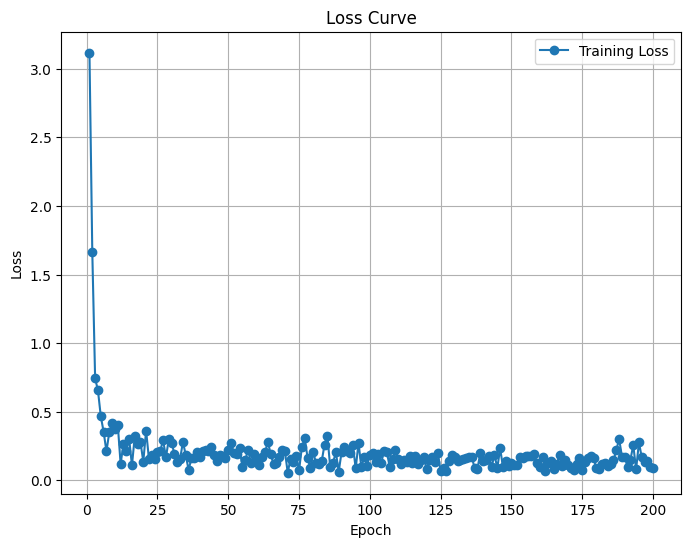

Predicted value for the first sample: 1.7806
Training Loss Scaling Unreversed: 0.13634666800498962
Training Loss Scaling Reversed: 985.8646850585938


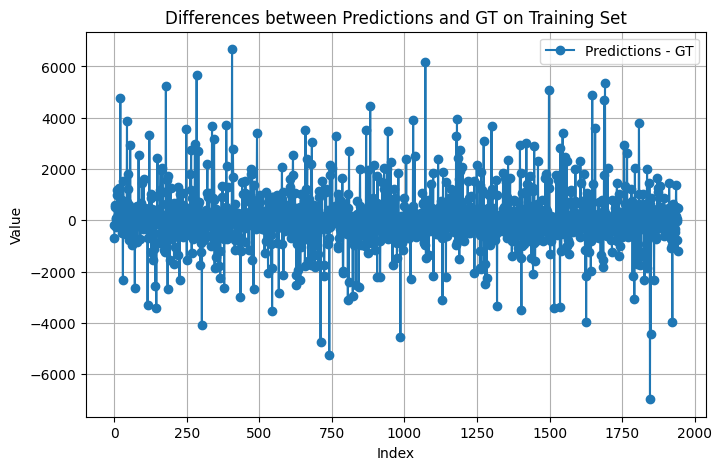

Predicted value for the first sample: 2.7850
Validation Loss Scaling Unreversed: 0.10819535702466965
Validation Loss Scaling Reversed: 782.3145751953125


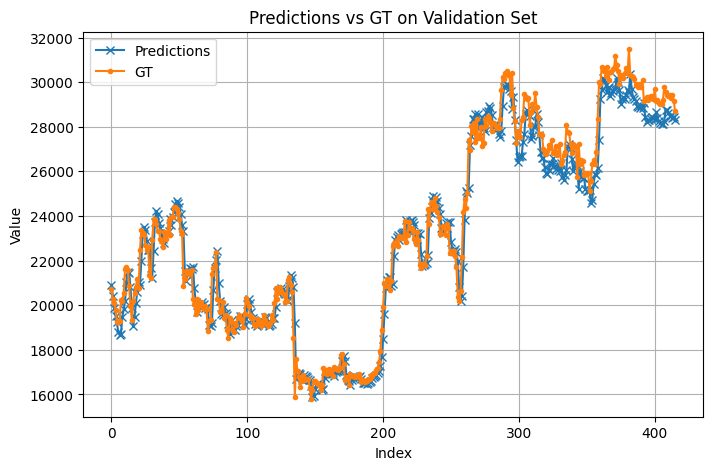

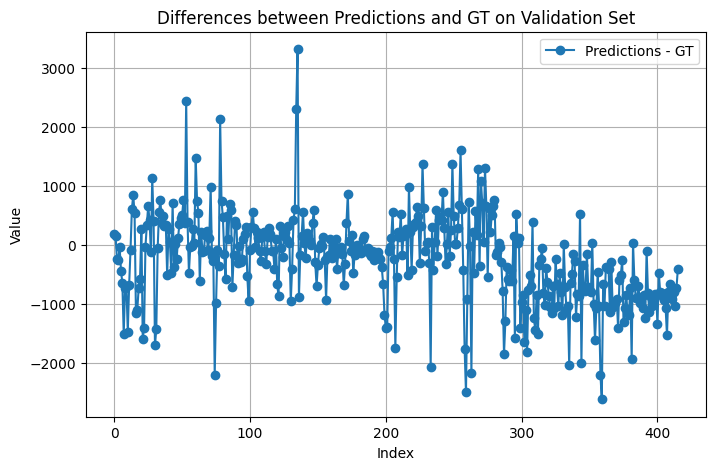

Return: 0.4468250274658203
Max Drawdown: -0.21732524037361145
Epoch [5/200], Loss: 3.6942
Epoch [10/200], Loss: 2.5199
Epoch [15/200], Loss: 1.5586
Epoch [20/200], Loss: 0.6138
Epoch [25/200], Loss: 0.4693
Epoch [30/200], Loss: 0.5031
Epoch [35/200], Loss: 0.4255
Epoch [40/200], Loss: 0.2800
Epoch [45/200], Loss: 0.4485
Epoch [50/200], Loss: 0.3267
Epoch [55/200], Loss: 0.1969
Epoch [60/200], Loss: 0.4883
Epoch [65/200], Loss: 0.3354
Epoch [70/200], Loss: 0.1985
Epoch [75/200], Loss: 0.1455
Epoch [80/200], Loss: 0.4040
Epoch [85/200], Loss: 0.3134
Epoch [90/200], Loss: 0.2656
Epoch [95/200], Loss: 0.2826
Epoch [100/200], Loss: 0.2030
Epoch [105/200], Loss: 0.3605
Epoch [110/200], Loss: 0.3421
Epoch [115/200], Loss: 0.1829
Epoch [120/200], Loss: 0.1736
Epoch [125/200], Loss: 0.3263
Epoch [130/200], Loss: 0.3515
Epoch [135/200], Loss: 0.1453
Epoch [140/200], Loss: 0.3560
Epoch [145/200], Loss: 0.2239
Epoch [150/200], Loss: 0.2672
Epoch [155/200], Loss: 0.1303
Epoch [160/200], Loss: 0.298

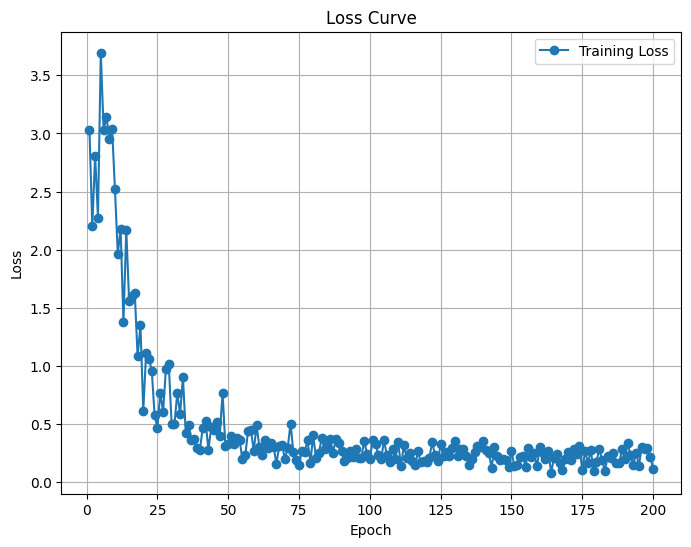

Predicted value for the first sample: 2.0071
Training Loss Scaling Unreversed: 0.21025314927101135
Training Loss Scaling Reversed: 1520.2508544921875


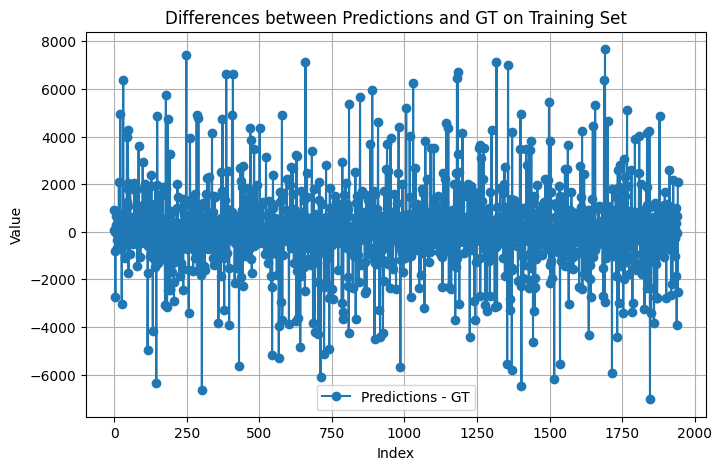

Predicted value for the first sample: 2.7963
Validation Loss Scaling Unreversed: 0.14552374184131622
Validation Loss Scaling Reversed: 1052.2203369140625


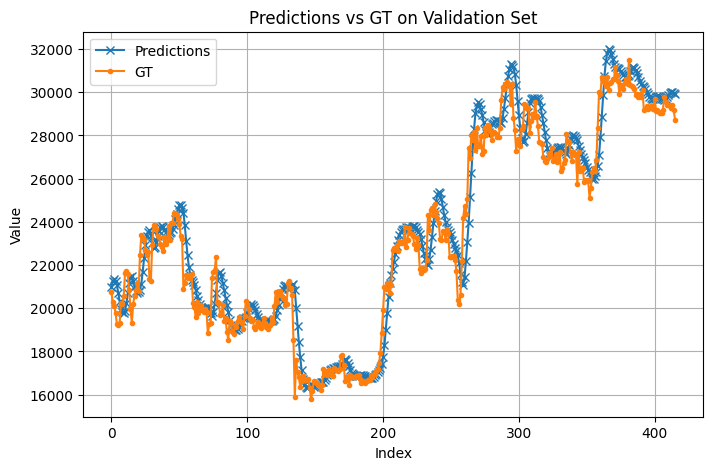

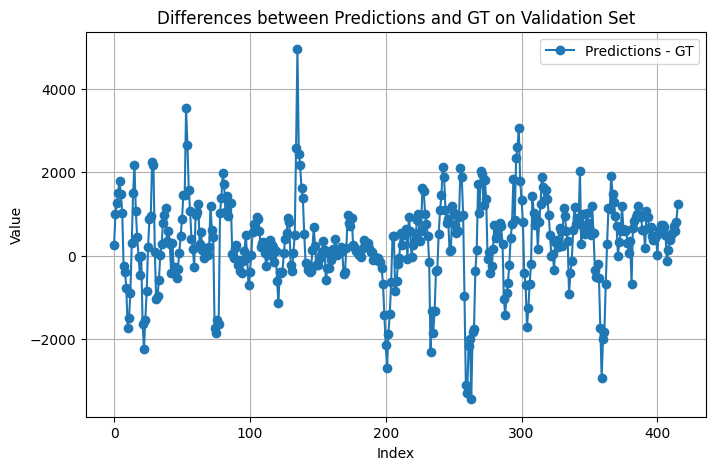

Return: -0.13451021909713745
Max Drawdown: -0.4319329261779785
Epoch [5/200], Loss: 0.1881
Epoch [10/200], Loss: 0.1325
Epoch [15/200], Loss: 0.1683
Epoch [20/200], Loss: 0.2138
Epoch [25/200], Loss: 0.2273
Epoch [30/200], Loss: 0.1194
Epoch [35/200], Loss: 0.0968
Epoch [40/200], Loss: 0.1573
Epoch [45/200], Loss: 0.1168
Epoch [50/200], Loss: 0.1895
Epoch [55/200], Loss: 0.1299
Epoch [60/200], Loss: 0.2587
Epoch [65/200], Loss: 0.1380
Epoch [70/200], Loss: 0.1700
Epoch [75/200], Loss: 0.1197
Epoch [80/200], Loss: 0.0881
Epoch [85/200], Loss: 0.1373
Epoch [90/200], Loss: 0.2004
Epoch [95/200], Loss: 0.1238
Epoch [100/200], Loss: 0.1273
Epoch [105/200], Loss: 0.0568
Epoch [110/200], Loss: 0.1120
Epoch [115/200], Loss: 0.1204
Epoch [120/200], Loss: 0.0984
Epoch [125/200], Loss: 0.0921
Epoch [130/200], Loss: 0.1120
Epoch [135/200], Loss: 0.1046
Epoch [140/200], Loss: 0.1713
Epoch [145/200], Loss: 0.1252
Epoch [150/200], Loss: 0.1077
Epoch [155/200], Loss: 0.1049
Epoch [160/200], Loss: 0.13

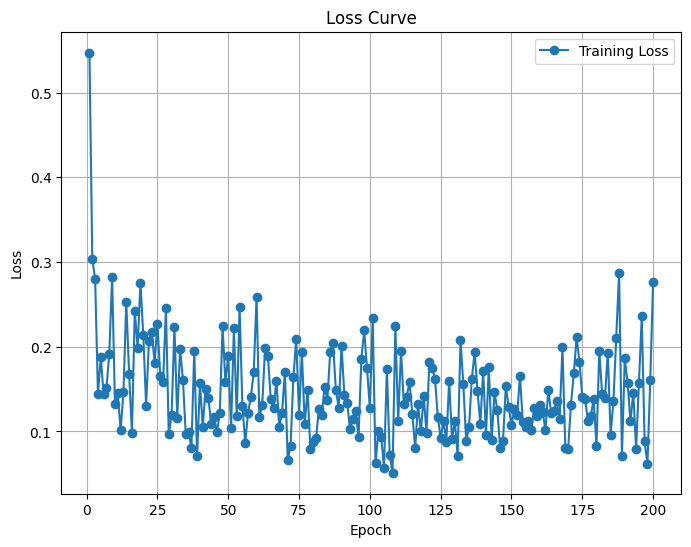

Predicted value for the first sample: 1.8779
Training Loss Scaling Unreversed: 0.14151065051555634
Training Loss Scaling Reversed: 1023.2031860351562


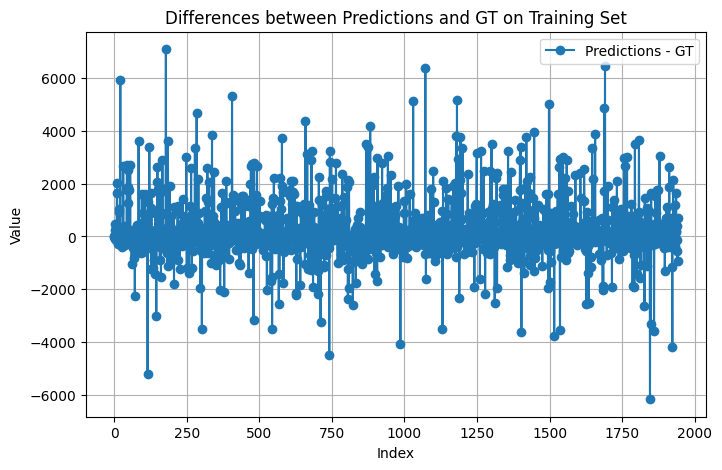

Predicted value for the first sample: 2.7907
Validation Loss Scaling Unreversed: 0.13854801654815674
Validation Loss Scaling Reversed: 1001.7817993164062


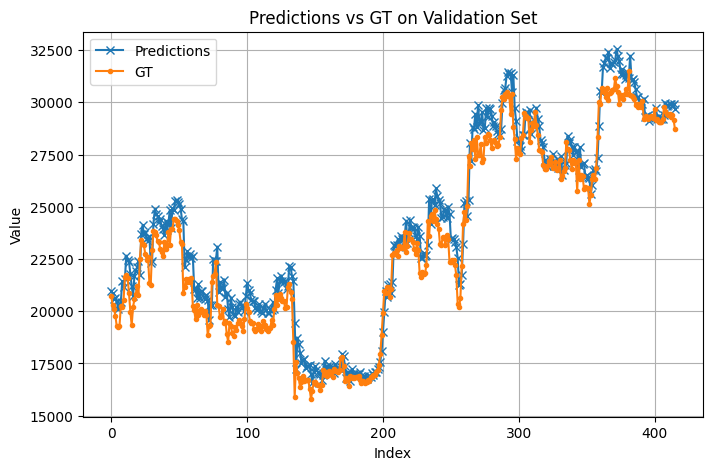

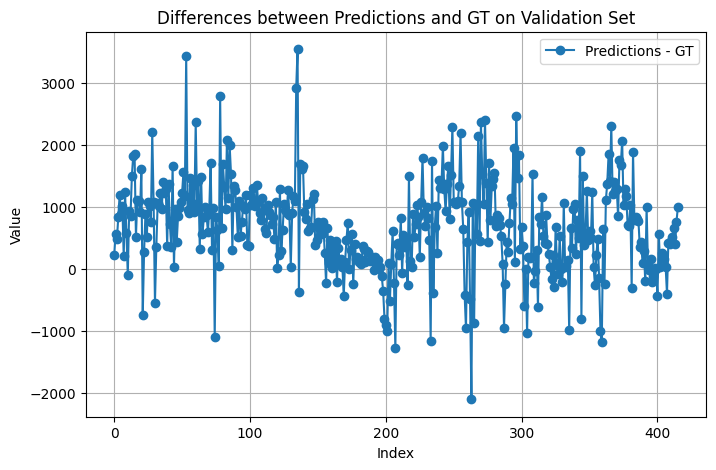

Return: 0.3830301761627197
Max Drawdown: -0.24115169048309326
Epoch [5/200], Loss: 0.3333
Epoch [10/200], Loss: 0.1243
Epoch [15/200], Loss: 0.1434
Epoch [20/200], Loss: 0.2169
Epoch [25/200], Loss: 0.2700
Epoch [30/200], Loss: 0.1404
Epoch [35/200], Loss: 0.3497
Epoch [40/200], Loss: 0.3206
Epoch [45/200], Loss: 0.2510
Epoch [50/200], Loss: 0.1532
Epoch [55/200], Loss: 0.2397
Epoch [60/200], Loss: 0.1336
Epoch [65/200], Loss: 0.1469
Epoch [70/200], Loss: 0.0596
Epoch [75/200], Loss: 0.0775
Epoch [80/200], Loss: 0.1559
Epoch [85/200], Loss: 0.1297
Epoch [90/200], Loss: 0.2037
Epoch [95/200], Loss: 0.1615
Epoch [100/200], Loss: 0.1516
Epoch [105/200], Loss: 0.2494
Epoch [110/200], Loss: 0.0908
Epoch [115/200], Loss: 0.0794
Epoch [120/200], Loss: 0.1284
Epoch [125/200], Loss: 0.1197
Epoch [130/200], Loss: 0.0696
Epoch [135/200], Loss: 0.1752
Epoch [140/200], Loss: 0.1627
Epoch [145/200], Loss: 0.1949
Epoch [150/200], Loss: 0.1626
Epoch [155/200], Loss: 0.1124
Epoch [160/200], Loss: 0.125

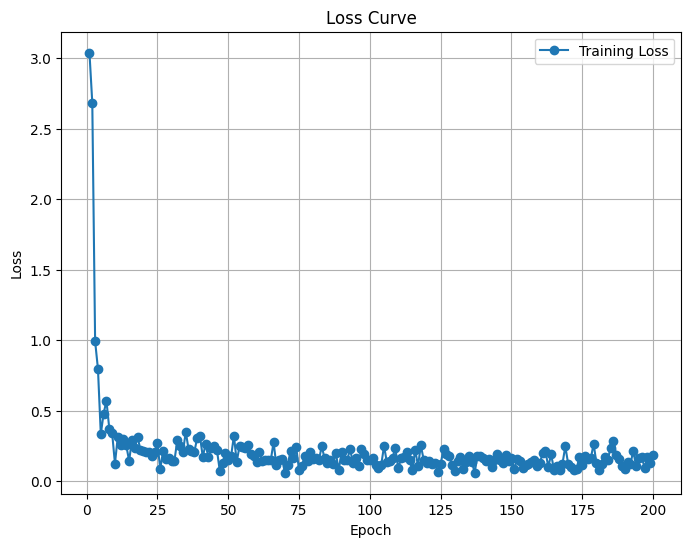

Predicted value for the first sample: 1.7877
Training Loss Scaling Unreversed: 0.14925162494182587
Training Loss Scaling Reversed: 1079.1749267578125


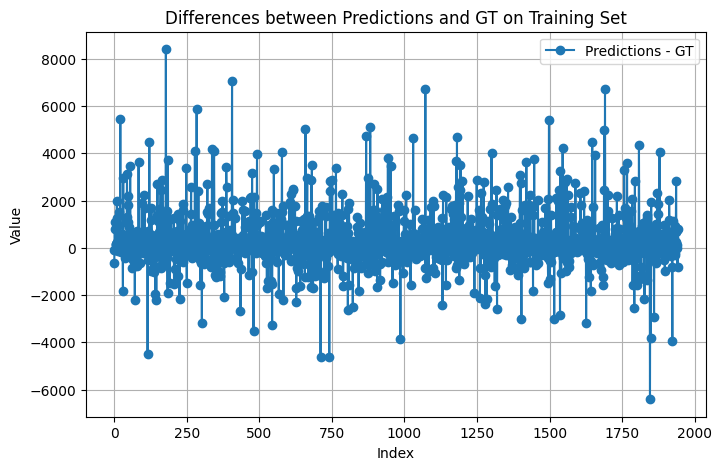

Predicted value for the first sample: 2.9439
Validation Loss Scaling Unreversed: 0.11515624821186066
Validation Loss Scaling Reversed: 832.6458129882812


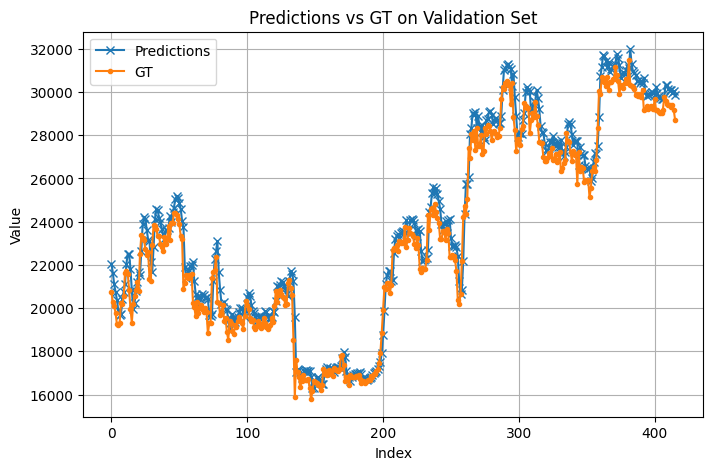

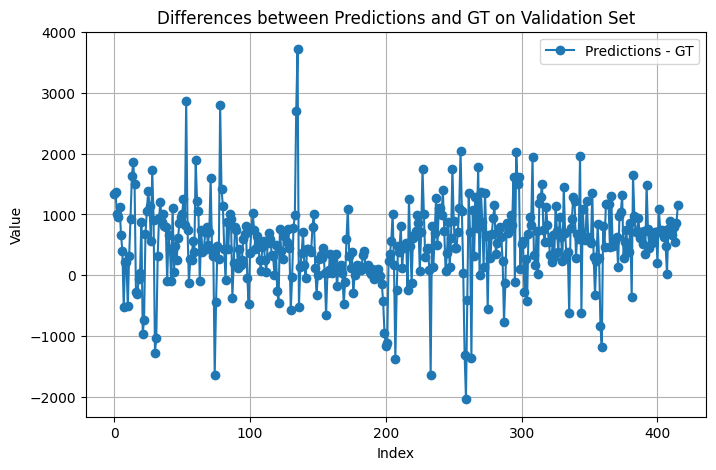

Return: 0.5430183410644531
Max Drawdown: -0.23116916418075562
Epoch [5/200], Loss: 2.8490
Epoch [10/200], Loss: 3.0334
Epoch [15/200], Loss: 1.4549
Epoch [20/200], Loss: 1.1484
Epoch [25/200], Loss: 0.5346
Epoch [30/200], Loss: 0.8915
Epoch [35/200], Loss: 0.4806
Epoch [40/200], Loss: 0.4039
Epoch [45/200], Loss: 0.2785
Epoch [50/200], Loss: 0.7025
Epoch [55/200], Loss: 0.2249
Epoch [60/200], Loss: 0.4709
Epoch [65/200], Loss: 0.5616
Epoch [70/200], Loss: 0.2990
Epoch [75/200], Loss: 0.4054
Epoch [80/200], Loss: 0.2766
Epoch [85/200], Loss: 0.3910
Epoch [90/200], Loss: 0.3091
Epoch [95/200], Loss: 0.2194
Epoch [100/200], Loss: 0.3361
Epoch [105/200], Loss: 0.3785
Epoch [110/200], Loss: 0.1873
Epoch [115/200], Loss: 0.2208
Epoch [120/200], Loss: 0.3194
Epoch [125/200], Loss: 0.2505
Epoch [130/200], Loss: 0.3474
Epoch [135/200], Loss: 0.2632
Epoch [140/200], Loss: 0.3291
Epoch [145/200], Loss: 0.2506
Epoch [150/200], Loss: 0.1808
Epoch [155/200], Loss: 0.1961
Epoch [160/200], Loss: 0.201

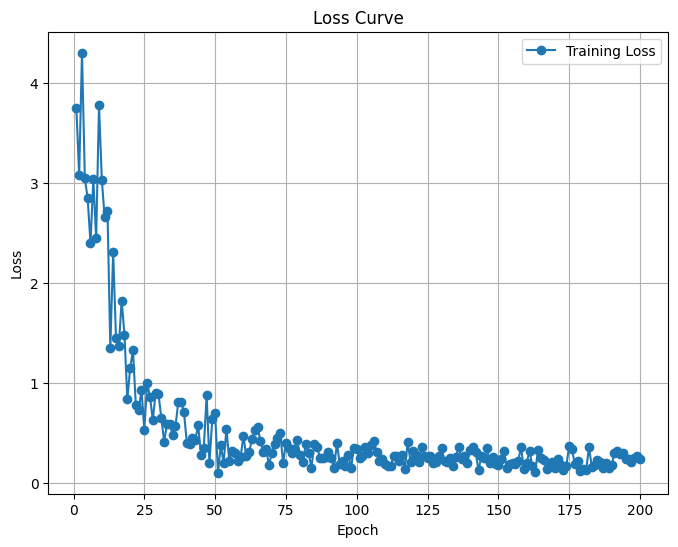

Predicted value for the first sample: 2.0074
Training Loss Scaling Unreversed: 0.21681761741638184
Training Loss Scaling Reversed: 1567.7156982421875


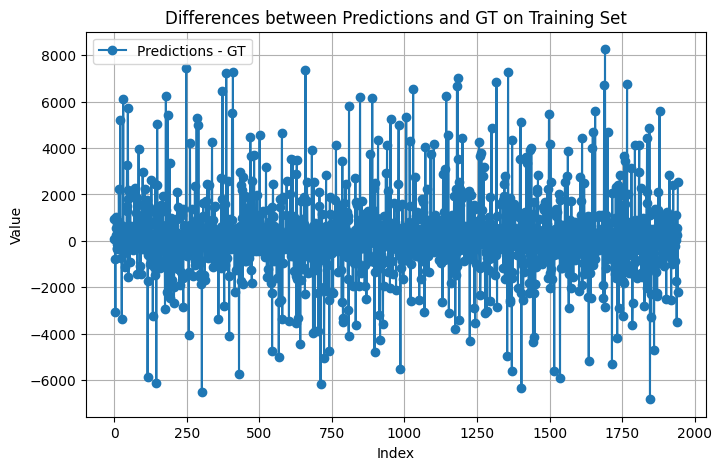

Predicted value for the first sample: 2.8066
Validation Loss Scaling Unreversed: 0.1556616574525833
Validation Loss Scaling Reversed: 1125.523193359375


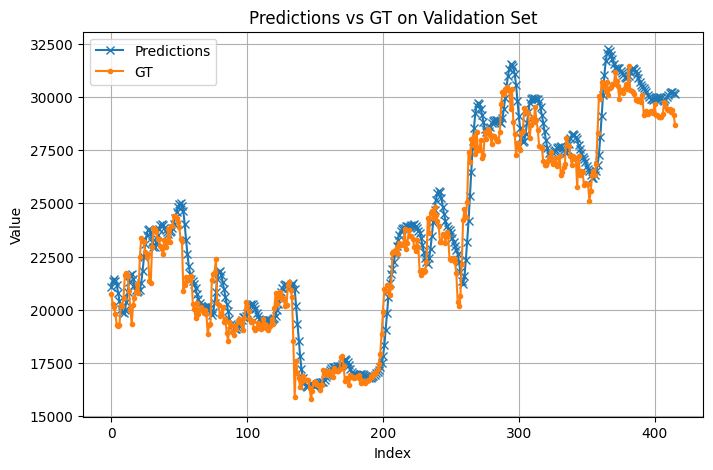

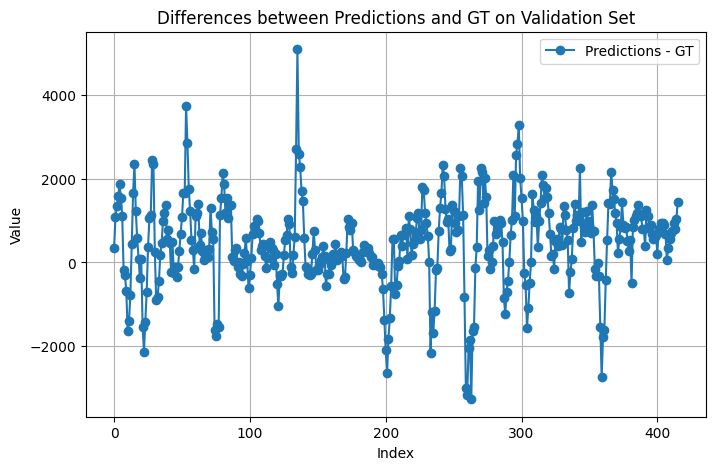

Return: -0.13426387310028076
Max Drawdown: -0.4317193329334259
Epoch [5/200], Loss: 0.1508
Epoch [10/200], Loss: 0.1748
Epoch [15/200], Loss: 0.2535
Epoch [20/200], Loss: 0.2083
Epoch [25/200], Loss: 0.1655
Epoch [30/200], Loss: 0.2477
Epoch [35/200], Loss: 0.2382
Epoch [40/200], Loss: 0.1249
Epoch [45/200], Loss: 0.1069
Epoch [50/200], Loss: 0.2342
Epoch [55/200], Loss: 0.0922
Epoch [60/200], Loss: 0.1161
Epoch [65/200], Loss: 0.1536
Epoch [70/200], Loss: 0.1247
Epoch [75/200], Loss: 0.1329
Epoch [80/200], Loss: 0.0945
Epoch [85/200], Loss: 0.1144
Epoch [90/200], Loss: 0.1426
Epoch [95/200], Loss: 0.1211
Epoch [100/200], Loss: 0.1143
Epoch [105/200], Loss: 0.1223
Epoch [110/200], Loss: 0.1472
Epoch [115/200], Loss: 0.1548
Epoch [120/200], Loss: 0.1858
Epoch [125/200], Loss: 0.0886
Epoch [130/200], Loss: 0.1181
Epoch [135/200], Loss: 0.1289
Epoch [140/200], Loss: 0.1840
Epoch [145/200], Loss: 0.0690
Epoch [150/200], Loss: 0.2040
Epoch [155/200], Loss: 0.1062
Epoch [160/200], Loss: 0.17

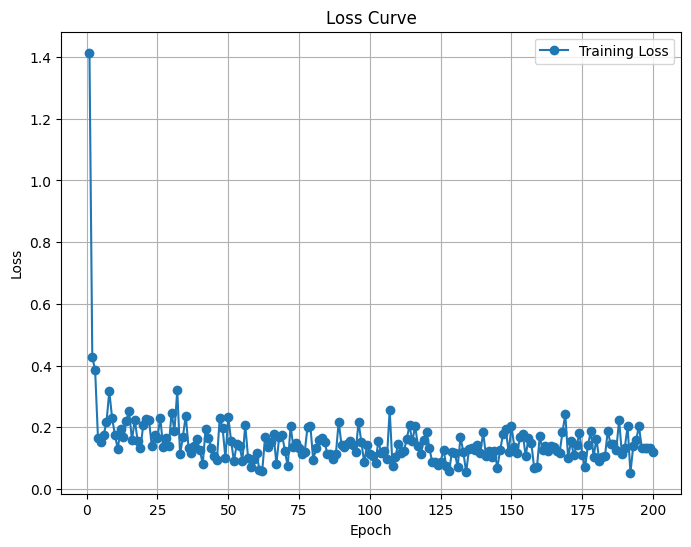

Predicted value for the first sample: 1.8524
Training Loss Scaling Unreversed: 0.14790669083595276
Training Loss Scaling Reversed: 1069.4503173828125


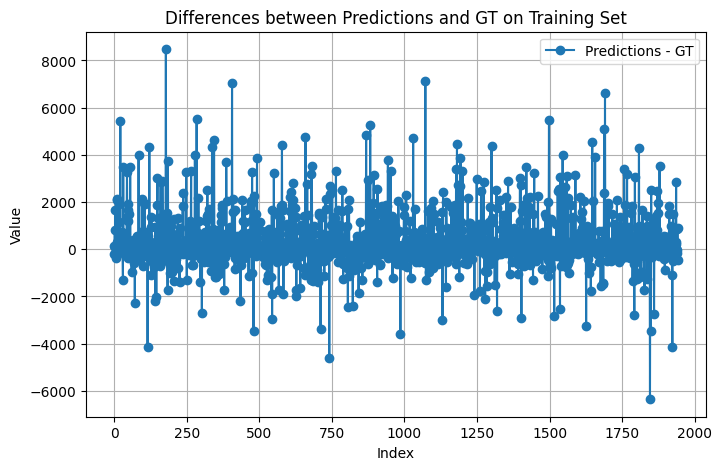

Predicted value for the first sample: 2.8043
Validation Loss Scaling Unreversed: 0.10529285669326782
Validation Loss Scaling Reversed: 761.3278198242188


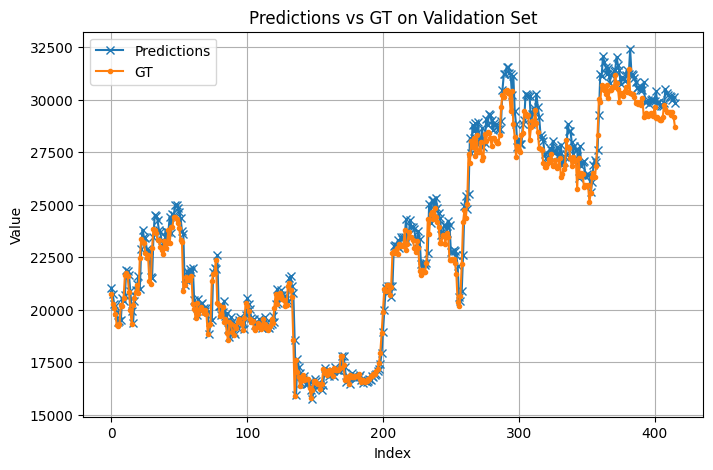

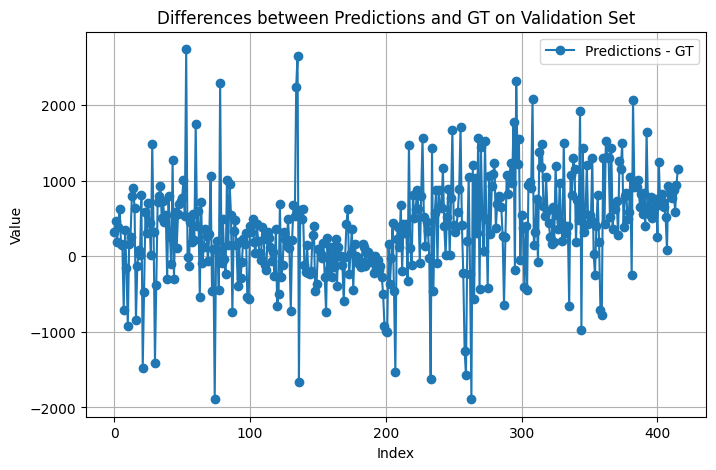

Return: 0.41963446140289307
Max Drawdown: -0.18795084953308105
Epoch [5/200], Loss: 1.3609
Epoch [10/200], Loss: 0.2078
Epoch [15/200], Loss: 0.2830
Epoch [20/200], Loss: 0.2007
Epoch [25/200], Loss: 0.2750
Epoch [30/200], Loss: 0.1596
Epoch [35/200], Loss: 0.1626
Epoch [40/200], Loss: 0.1509
Epoch [45/200], Loss: 0.2639
Epoch [50/200], Loss: 0.2518
Epoch [55/200], Loss: 0.1085
Epoch [60/200], Loss: 0.1854
Epoch [65/200], Loss: 0.2209
Epoch [70/200], Loss: 0.3385
Epoch [75/200], Loss: 0.1249
Epoch [80/200], Loss: 0.2677
Epoch [85/200], Loss: 0.1835
Epoch [90/200], Loss: 0.1987
Epoch [95/200], Loss: 0.1225
Epoch [100/200], Loss: 0.2649
Epoch [105/200], Loss: 0.2854
Epoch [110/200], Loss: 0.1781
Epoch [115/200], Loss: 0.1552
Epoch [120/200], Loss: 0.2215
Epoch [125/200], Loss: 0.2198
Epoch [130/200], Loss: 0.1523
Epoch [135/200], Loss: 0.1197
Epoch [140/200], Loss: 0.1632
Epoch [145/200], Loss: 0.0854
Epoch [150/200], Loss: 0.0850
Epoch [155/200], Loss: 0.2345
Epoch [160/200], Loss: 0.08

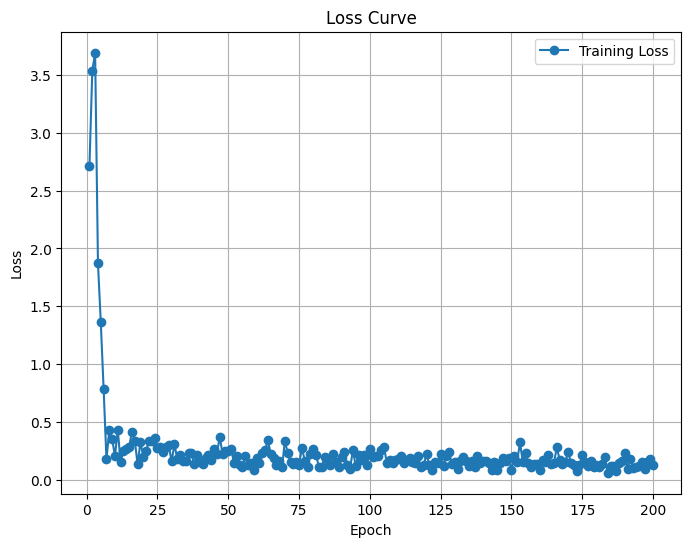

Predicted value for the first sample: 1.8265
Training Loss Scaling Unreversed: 0.1413566917181015
Training Loss Scaling Reversed: 1022.0899658203125


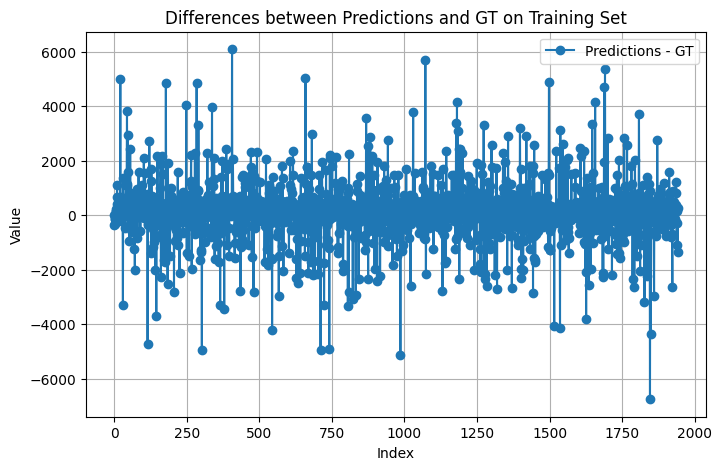

Predicted value for the first sample: 2.9131
Validation Loss Scaling Unreversed: 0.10637006908655167
Validation Loss Scaling Reversed: 769.1167602539062


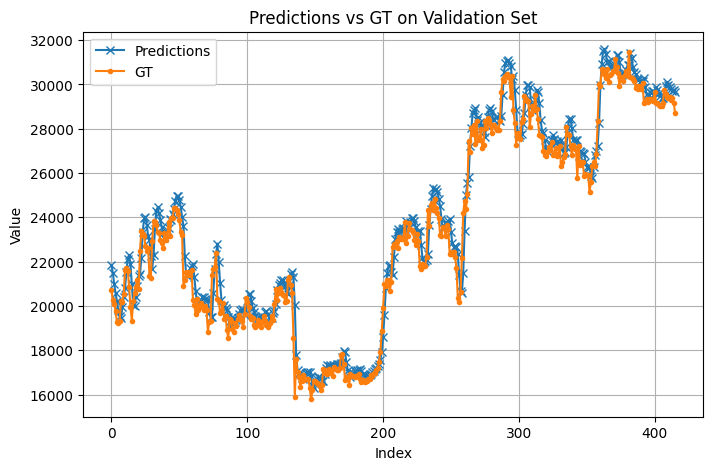

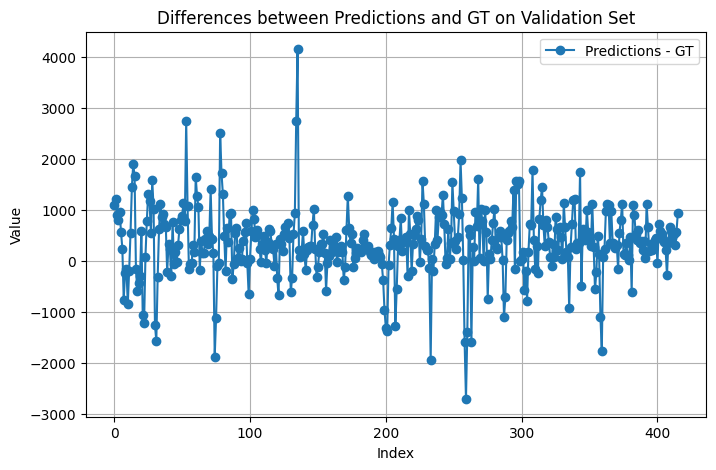

Return: 0.268169641494751
Max Drawdown: -0.2035241276025772
Epoch [5/200], Loss: 2.8459
Epoch [10/200], Loss: 3.1444
Epoch [15/200], Loss: 2.8709
Epoch [20/200], Loss: 3.0032
Epoch [25/200], Loss: 2.4724
Epoch [30/200], Loss: 1.6204
Epoch [35/200], Loss: 1.2351
Epoch [40/200], Loss: 1.1616
Epoch [45/200], Loss: 0.4020
Epoch [50/200], Loss: 0.3728
Epoch [55/200], Loss: 0.9034
Epoch [60/200], Loss: 0.2921
Epoch [65/200], Loss: 0.8493
Epoch [70/200], Loss: 0.6786
Epoch [75/200], Loss: 0.6232
Epoch [80/200], Loss: 0.4294
Epoch [85/200], Loss: 0.4910
Epoch [90/200], Loss: 0.3033
Epoch [95/200], Loss: 0.5999
Epoch [100/200], Loss: 0.2838
Epoch [105/200], Loss: 0.5804
Epoch [110/200], Loss: 0.5512
Epoch [115/200], Loss: 0.4173
Epoch [120/200], Loss: 0.2050
Epoch [125/200], Loss: 0.3356
Epoch [130/200], Loss: 0.5421
Epoch [135/200], Loss: 0.2636
Epoch [140/200], Loss: 0.3172
Epoch [145/200], Loss: 0.2867
Epoch [150/200], Loss: 0.3287
Epoch [155/200], Loss: 0.3008
Epoch [160/200], Loss: 0.1726


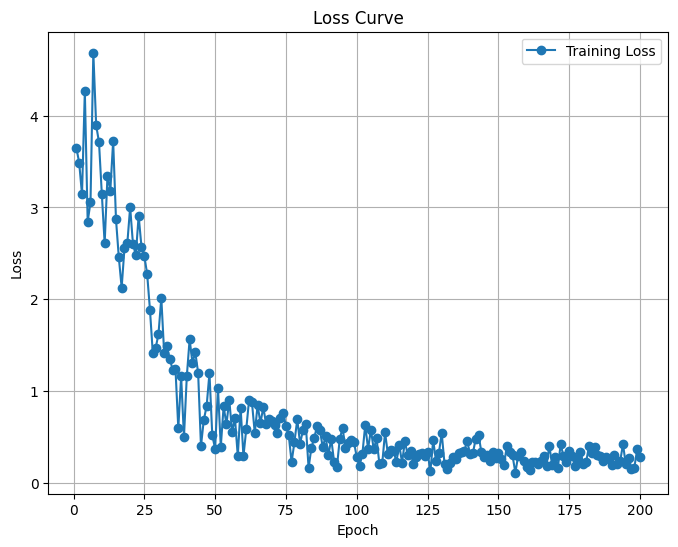

Predicted value for the first sample: 2.0949
Training Loss Scaling Unreversed: 0.2557550370693207
Training Loss Scaling Reversed: 1849.255615234375


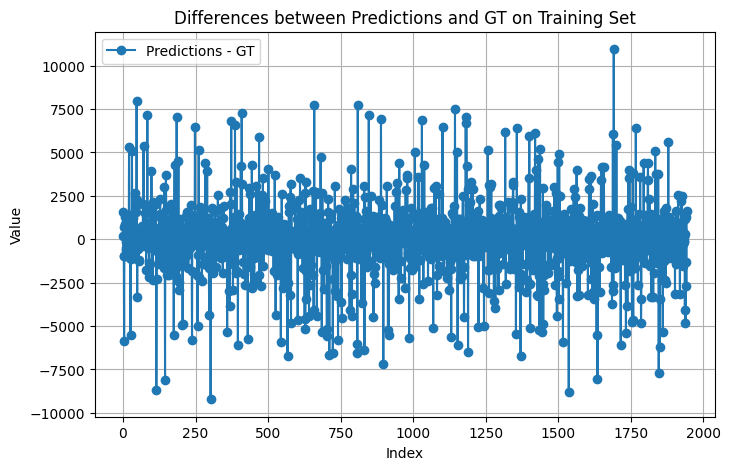

Predicted value for the first sample: 2.7487
Validation Loss Scaling Unreversed: 0.17027442157268524
Validation Loss Scaling Reversed: 1231.1817626953125


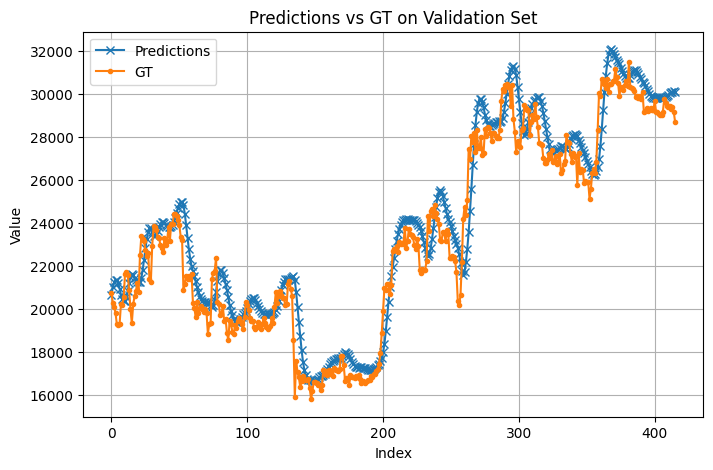

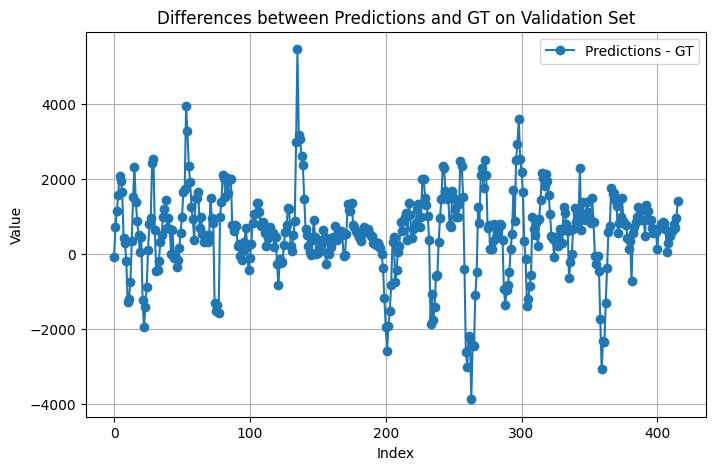

Return: -0.1208832859992981
Max Drawdown: -0.3874386250972748
Epoch [5/200], Loss: 0.2441
Epoch [10/200], Loss: 0.1658
Epoch [15/200], Loss: 0.2824
Epoch [20/200], Loss: 0.1050
Epoch [25/200], Loss: 0.1602
Epoch [30/200], Loss: 0.1067
Epoch [35/200], Loss: 0.2300
Epoch [40/200], Loss: 0.2649
Epoch [45/200], Loss: 0.1568
Epoch [50/200], Loss: 0.1526
Epoch [55/200], Loss: 0.2149
Epoch [60/200], Loss: 0.0754
Epoch [65/200], Loss: 0.1091
Epoch [70/200], Loss: 0.2028
Epoch [75/200], Loss: 0.1286
Epoch [80/200], Loss: 0.1065
Epoch [85/200], Loss: 0.1051
Epoch [90/200], Loss: 0.2047
Epoch [95/200], Loss: 0.1114
Epoch [100/200], Loss: 0.2247
Epoch [105/200], Loss: 0.2450
Epoch [110/200], Loss: 0.1099
Epoch [115/200], Loss: 0.1446
Epoch [120/200], Loss: 0.1946
Epoch [125/200], Loss: 0.1721
Epoch [130/200], Loss: 0.1266
Epoch [135/200], Loss: 0.1588
Epoch [140/200], Loss: 0.1735
Epoch [145/200], Loss: 0.1520
Epoch [150/200], Loss: 0.0738
Epoch [155/200], Loss: 0.1534
Epoch [160/200], Loss: 0.144

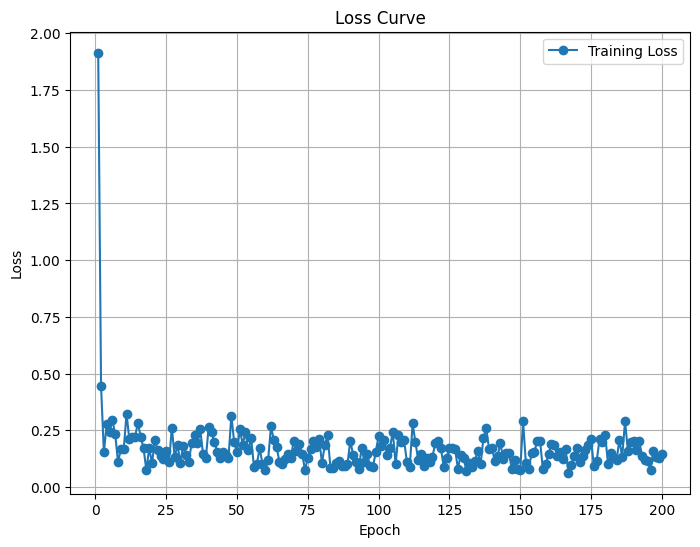

Predicted value for the first sample: 1.8421
Training Loss Scaling Unreversed: 0.13615626096725464
Training Loss Scaling Reversed: 984.4878540039062


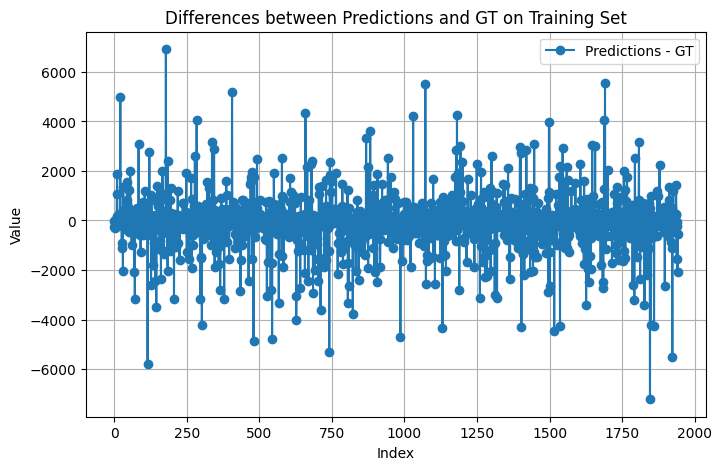

Predicted value for the first sample: 2.8433
Validation Loss Scaling Unreversed: 0.09037605673074722
Validation Loss Scaling Reversed: 653.4708251953125


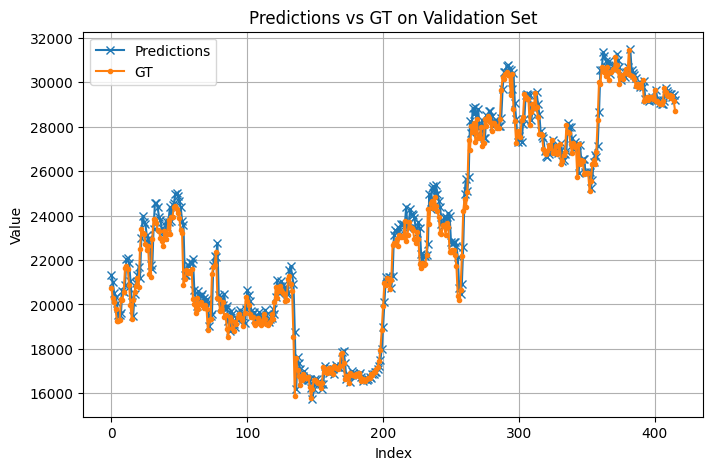

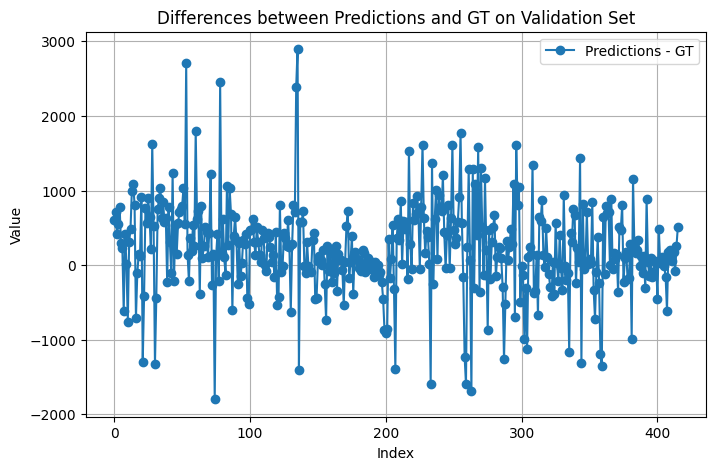

Return: 0.30906128883361816
Max Drawdown: -0.22838807106018066
Epoch [5/200], Loss: 1.3403
Epoch [10/200], Loss: 0.6492
Epoch [15/200], Loss: 0.2671
Epoch [20/200], Loss: 0.4231
Epoch [25/200], Loss: 0.1875
Epoch [30/200], Loss: 0.3095
Epoch [35/200], Loss: 0.2712
Epoch [40/200], Loss: 0.3439
Epoch [45/200], Loss: 0.1866
Epoch [50/200], Loss: 0.1388
Epoch [55/200], Loss: 0.1963
Epoch [60/200], Loss: 0.2892
Epoch [65/200], Loss: 0.2290
Epoch [70/200], Loss: 0.2494
Epoch [75/200], Loss: 0.1473
Epoch [80/200], Loss: 0.1503
Epoch [85/200], Loss: 0.0675
Epoch [90/200], Loss: 0.1455
Epoch [95/200], Loss: 0.0879
Epoch [100/200], Loss: 0.1674
Epoch [105/200], Loss: 0.1182
Epoch [110/200], Loss: 0.2050
Epoch [115/200], Loss: 0.2442
Epoch [120/200], Loss: 0.2281
Epoch [125/200], Loss: 0.1227
Epoch [130/200], Loss: 0.1828
Epoch [135/200], Loss: 0.1533
Epoch [140/200], Loss: 0.1702
Epoch [145/200], Loss: 0.0709
Epoch [150/200], Loss: 0.1636
Epoch [155/200], Loss: 0.2441
Epoch [160/200], Loss: 0.23

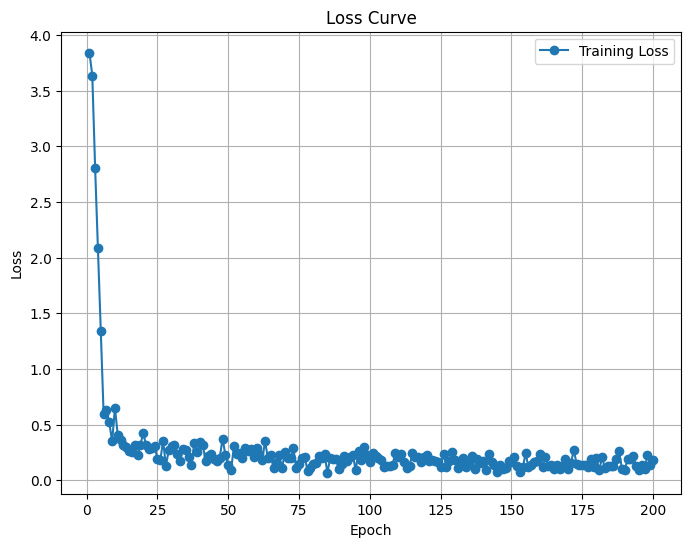

Predicted value for the first sample: 1.8033
Training Loss Scaling Unreversed: 0.1444397121667862
Training Loss Scaling Reversed: 1044.3819580078125


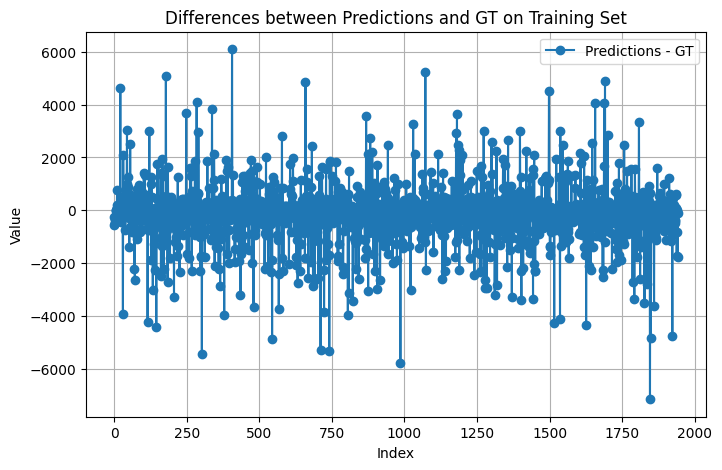

Predicted value for the first sample: 2.8701
Validation Loss Scaling Unreversed: 0.09759297966957092
Validation Loss Scaling Reversed: 705.6533813476562


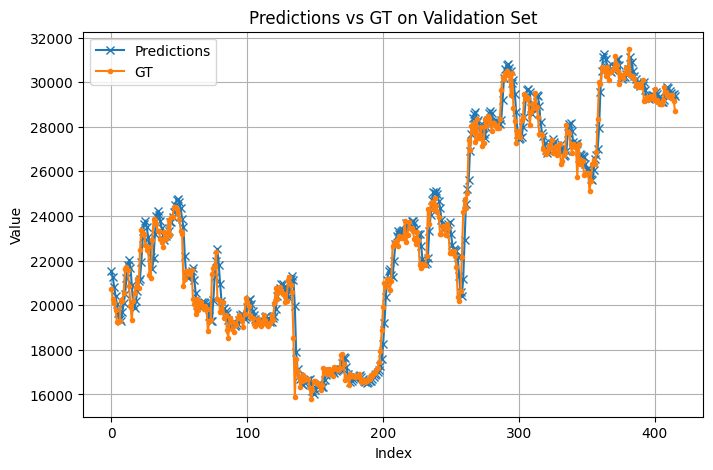

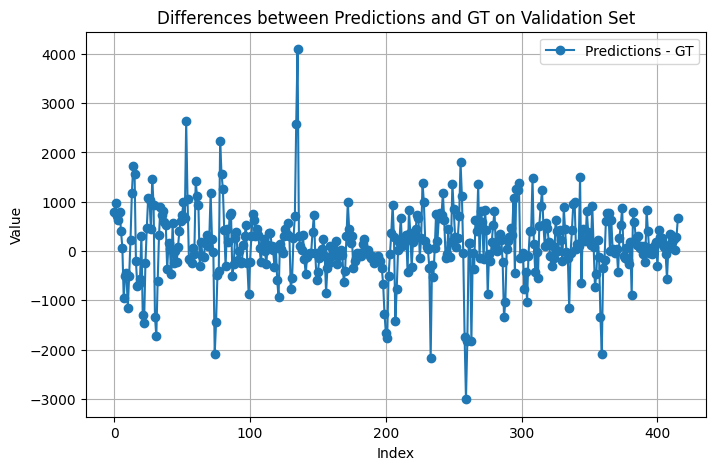

Return: 0.1308497190475464
Max Drawdown: -0.23084703087806702
Epoch [5/200], Loss: 2.6145
Epoch [10/200], Loss: 2.4772
Epoch [15/200], Loss: 2.6830
Epoch [20/200], Loss: 2.3238
Epoch [25/200], Loss: 2.0644
Epoch [30/200], Loss: 0.6886
Epoch [35/200], Loss: 1.1844
Epoch [40/200], Loss: 0.5738
Epoch [45/200], Loss: 0.8527
Epoch [50/200], Loss: 0.7433
Epoch [55/200], Loss: 0.5143
Epoch [60/200], Loss: 0.7953
Epoch [65/200], Loss: 0.8323
Epoch [70/200], Loss: 0.1838
Epoch [75/200], Loss: 0.2951
Epoch [80/200], Loss: 0.6020
Epoch [85/200], Loss: 0.4090
Epoch [90/200], Loss: 0.4604
Epoch [95/200], Loss: 0.3314
Epoch [100/200], Loss: 0.3053
Epoch [105/200], Loss: 0.4161
Epoch [110/200], Loss: 0.4227
Epoch [115/200], Loss: 0.2631
Epoch [120/200], Loss: 0.2072
Epoch [125/200], Loss: 0.1809
Epoch [130/200], Loss: 0.3376
Epoch [135/200], Loss: 0.3042
Epoch [140/200], Loss: 0.2415
Epoch [145/200], Loss: 0.2388
Epoch [150/200], Loss: 0.1923
Epoch [155/200], Loss: 0.2439
Epoch [160/200], Loss: 0.189

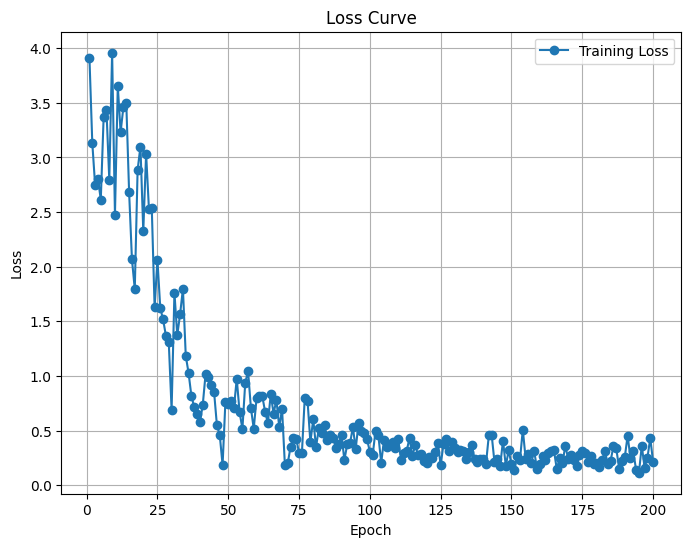

Predicted value for the first sample: 2.1064
Training Loss Scaling Unreversed: 0.2694661021232605
Training Loss Scaling Reversed: 1948.394775390625


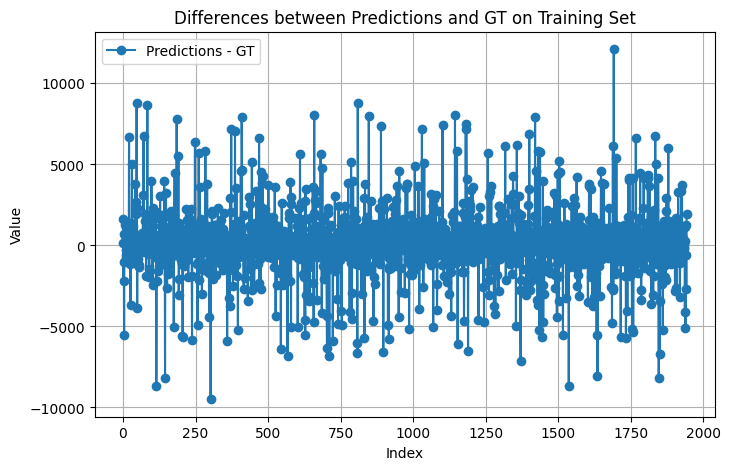

Predicted value for the first sample: 2.7684
Validation Loss Scaling Unreversed: 0.18698424100875854
Validation Loss Scaling Reversed: 1352.003662109375


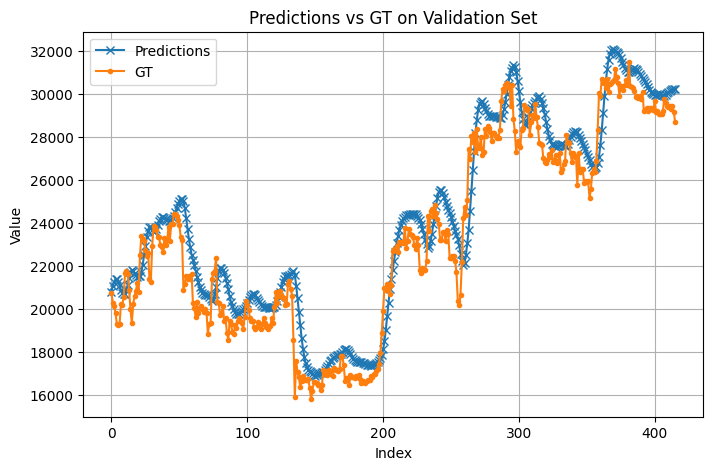

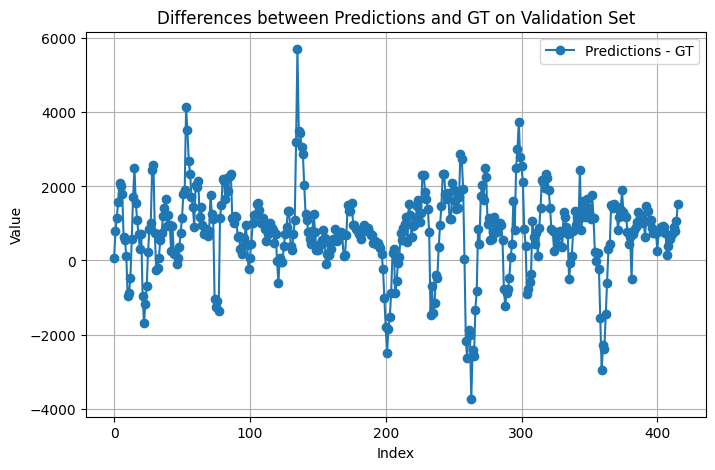

Return: -0.1344606876373291
Max Drawdown: -0.33040592074394226
Epoch [5/200], Loss: 0.2335
Epoch [10/200], Loss: 0.2340
Epoch [15/200], Loss: 0.2388
Epoch [20/200], Loss: 0.2294
Epoch [25/200], Loss: 0.3025
Epoch [30/200], Loss: 0.1749
Epoch [35/200], Loss: 0.1505
Epoch [40/200], Loss: 0.2282
Epoch [45/200], Loss: 0.2136
Epoch [50/200], Loss: 0.1992
Epoch [55/200], Loss: 0.1048
Epoch [60/200], Loss: 0.0801
Epoch [65/200], Loss: 0.1225
Epoch [70/200], Loss: 0.1466
Epoch [75/200], Loss: 0.1584
Epoch [80/200], Loss: 0.2402
Epoch [85/200], Loss: 0.1584
Epoch [90/200], Loss: 0.1024
Epoch [95/200], Loss: 0.2624
Epoch [100/200], Loss: 0.0798
Epoch [105/200], Loss: 0.1627
Epoch [110/200], Loss: 0.1387
Epoch [115/200], Loss: 0.2031
Epoch [120/200], Loss: 0.1368
Epoch [125/200], Loss: 0.1227
Epoch [130/200], Loss: 0.1090
Epoch [135/200], Loss: 0.0997
Epoch [140/200], Loss: 0.1092
Epoch [145/200], Loss: 0.1858
Epoch [150/200], Loss: 0.1802
Epoch [155/200], Loss: 0.1518
Epoch [160/200], Loss: 0.26

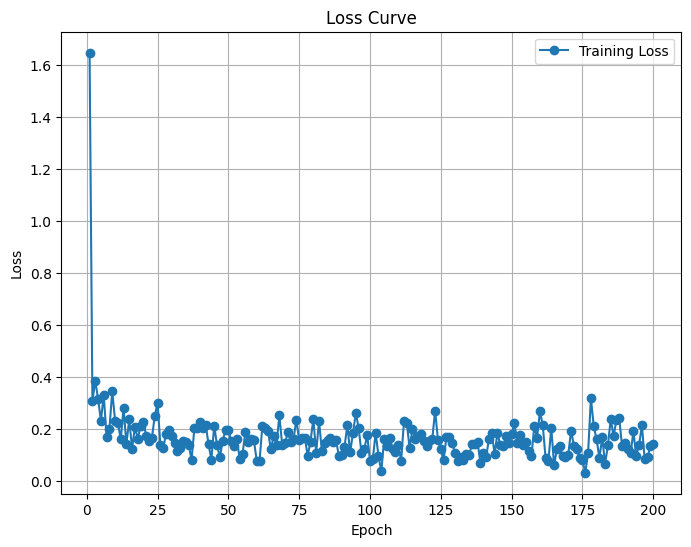

Predicted value for the first sample: 1.8457
Training Loss Scaling Unreversed: 0.13685934245586395
Training Loss Scaling Reversed: 989.5715942382812


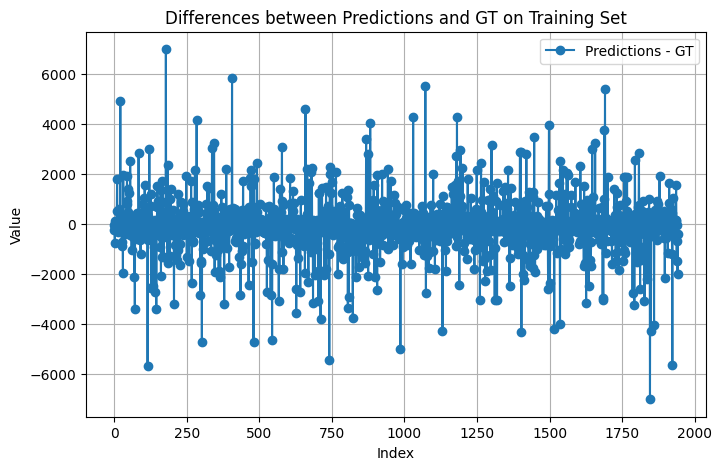

Predicted value for the first sample: 2.8149
Validation Loss Scaling Unreversed: 0.11104350537061691
Validation Loss Scaling Reversed: 802.9083251953125


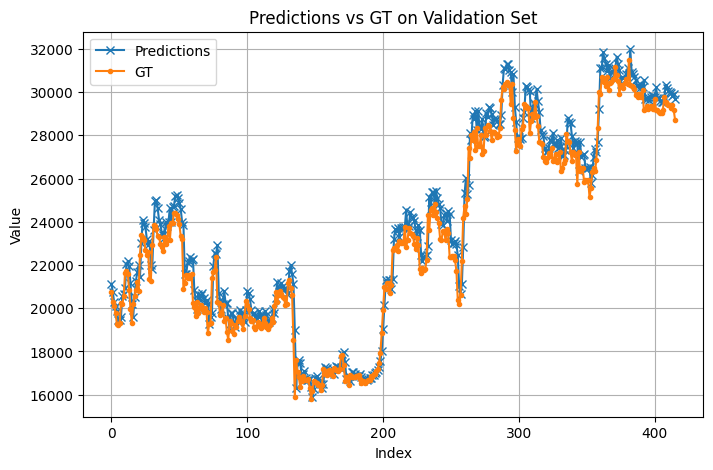

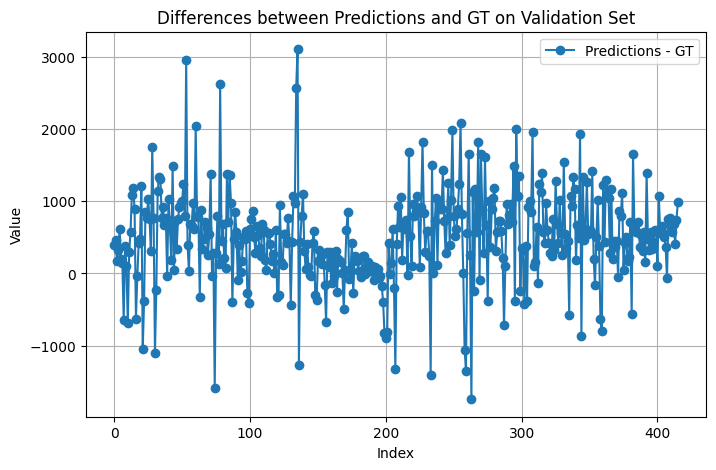

Return: 0.4093794822692871
Max Drawdown: -0.1683393269777298
Epoch [5/200], Loss: 1.1051
Epoch [10/200], Loss: 0.3176
Epoch [15/200], Loss: 0.1887
Epoch [20/200], Loss: 0.3083
Epoch [25/200], Loss: 0.2584
Epoch [30/200], Loss: 0.1091
Epoch [35/200], Loss: 0.3343
Epoch [40/200], Loss: 0.2362
Epoch [45/200], Loss: 0.2326
Epoch [50/200], Loss: 0.1436
Epoch [55/200], Loss: 0.2049
Epoch [60/200], Loss: 0.2010
Epoch [65/200], Loss: 0.1954
Epoch [70/200], Loss: 0.1049
Epoch [75/200], Loss: 0.1616
Epoch [80/200], Loss: 0.2289
Epoch [85/200], Loss: 0.2194
Epoch [90/200], Loss: 0.2092
Epoch [95/200], Loss: 0.1164
Epoch [100/200], Loss: 0.1343
Epoch [105/200], Loss: 0.1243
Epoch [110/200], Loss: 0.1038
Epoch [115/200], Loss: 0.2197
Epoch [120/200], Loss: 0.1794
Epoch [125/200], Loss: 0.1241
Epoch [130/200], Loss: 0.2728
Epoch [135/200], Loss: 0.2386
Epoch [140/200], Loss: 0.2259
Epoch [145/200], Loss: 0.1548
Epoch [150/200], Loss: 0.0863
Epoch [155/200], Loss: 0.2523
Epoch [160/200], Loss: 0.1416

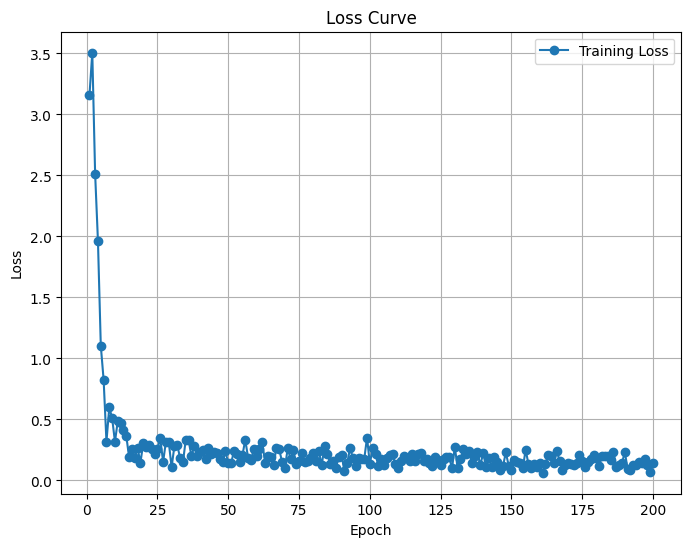

Predicted value for the first sample: 1.8030
Training Loss Scaling Unreversed: 0.154709130525589
Training Loss Scaling Reversed: 1118.6357421875


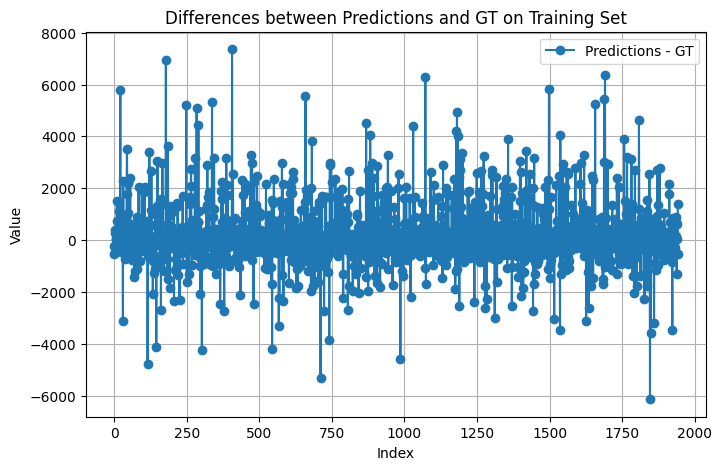

Predicted value for the first sample: 2.9306
Validation Loss Scaling Unreversed: 0.12391343712806702
Validation Loss Scaling Reversed: 895.9653930664062


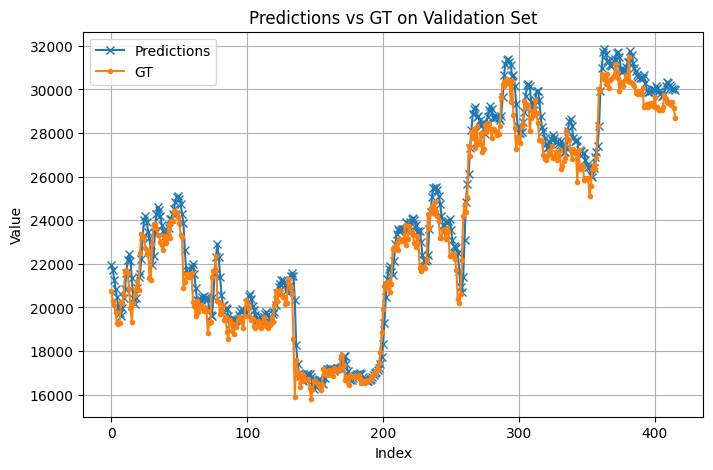

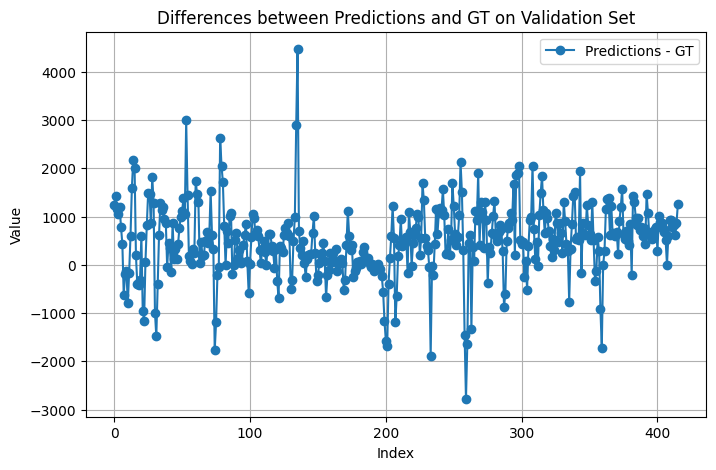

Return: 0.27465593814849854
Max Drawdown: -0.21966759860515594
Epoch [5/200], Loss: 2.5679
Epoch [10/200], Loss: 2.8201
Epoch [15/200], Loss: 2.5753
Epoch [20/200], Loss: 3.2140
Epoch [25/200], Loss: 1.9481
Epoch [30/200], Loss: 1.3715
Epoch [35/200], Loss: 0.8928
Epoch [40/200], Loss: 1.0991
Epoch [45/200], Loss: 0.5931
Epoch [50/200], Loss: 0.6998
Epoch [55/200], Loss: 0.2566
Epoch [60/200], Loss: 0.6654
Epoch [65/200], Loss: 0.5046
Epoch [70/200], Loss: 0.1917
Epoch [75/200], Loss: 0.5779
Epoch [80/200], Loss: 0.5045
Epoch [85/200], Loss: 0.3790
Epoch [90/200], Loss: 0.3971
Epoch [95/200], Loss: 0.3622
Epoch [100/200], Loss: 0.3835
Epoch [105/200], Loss: 0.4249
Epoch [110/200], Loss: 0.5372
Epoch [115/200], Loss: 0.2339
Epoch [120/200], Loss: 0.2344
Epoch [125/200], Loss: 0.1766
Epoch [130/200], Loss: 0.3375
Epoch [135/200], Loss: 0.3217
Epoch [140/200], Loss: 0.3317
Epoch [145/200], Loss: 0.2888
Epoch [150/200], Loss: 0.3916
Epoch [155/200], Loss: 0.3793
Epoch [160/200], Loss: 0.34

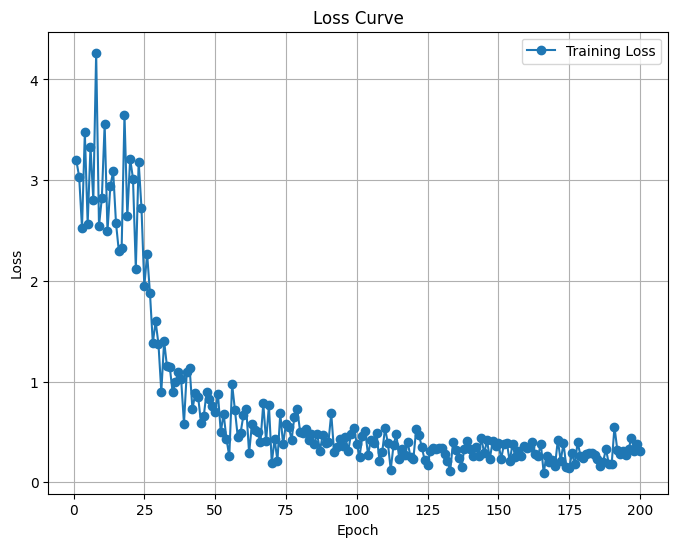

Predicted value for the first sample: 2.0679
Training Loss Scaling Unreversed: 0.26412510871887207
Training Loss Scaling Reversed: 1909.776123046875


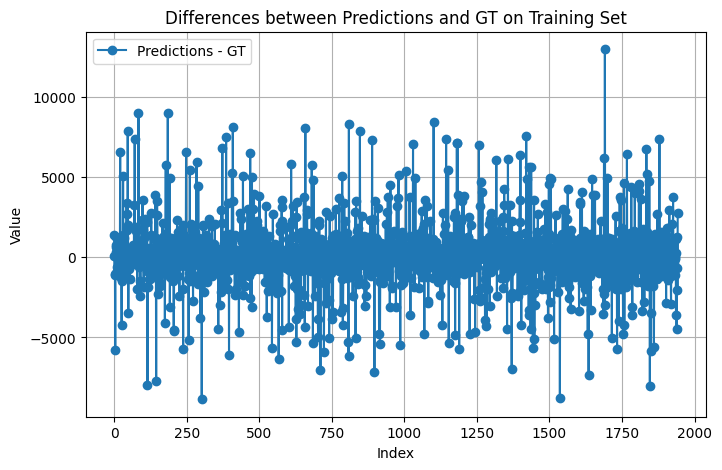

Predicted value for the first sample: 2.7651
Validation Loss Scaling Unreversed: 0.17598234117031097
Validation Loss Scaling Reversed: 1272.4534912109375


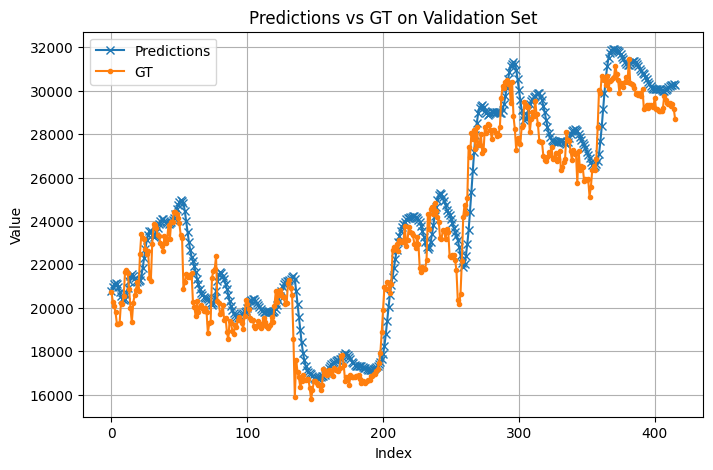

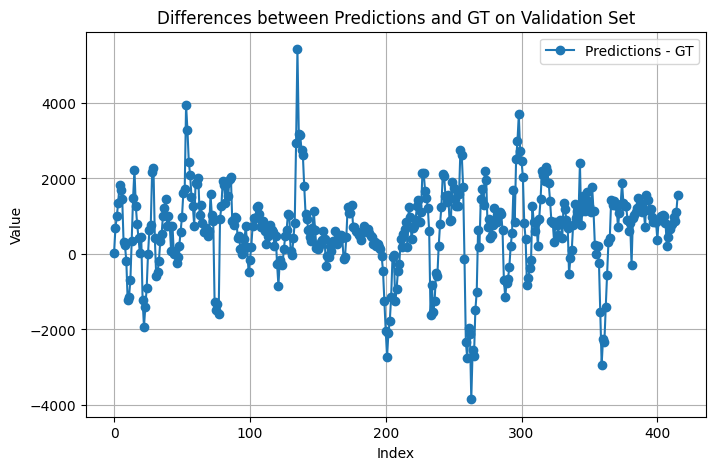

Return: -0.07538020610809326
Max Drawdown: -0.3265615403652191
Epoch [5/200], Loss: 0.1536
Epoch [10/200], Loss: 0.2894
Epoch [15/200], Loss: 0.1640
Epoch [20/200], Loss: 0.0746
Epoch [25/200], Loss: 0.1994
Epoch [30/200], Loss: 0.1129
Epoch [35/200], Loss: 0.1961
Epoch [40/200], Loss: 0.0369
Epoch [45/200], Loss: 0.0624
Epoch [50/200], Loss: 0.1051
Epoch [55/200], Loss: 0.2139
Epoch [60/200], Loss: 0.1124
Epoch [65/200], Loss: 0.3247
Epoch [70/200], Loss: 0.0663
Epoch [75/200], Loss: 0.0324
Epoch [80/200], Loss: 0.0492
Epoch [85/200], Loss: 0.0982
Epoch [90/200], Loss: 0.0110
Epoch [95/200], Loss: 0.1517
Epoch [100/200], Loss: 0.0097
Epoch [105/200], Loss: 0.2874
Epoch [110/200], Loss: 0.0176
Epoch [115/200], Loss: 0.0744
Epoch [120/200], Loss: 0.0483
Epoch [125/200], Loss: 0.0514
Epoch [130/200], Loss: 0.0907
Epoch [135/200], Loss: 0.0336
Epoch [140/200], Loss: 0.0740
Epoch [145/200], Loss: 0.1232
Epoch [150/200], Loss: 0.1658
Epoch [155/200], Loss: 0.3445
Epoch [160/200], Loss: 0.03

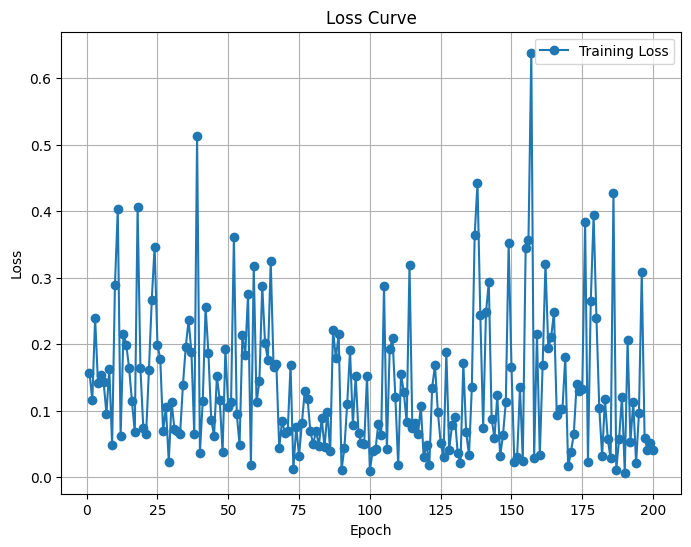

Predicted value for the first sample: 1.8374
Training Loss Scaling Unreversed: 0.12114781886339188
Training Loss Scaling Reversed: 875.9682006835938


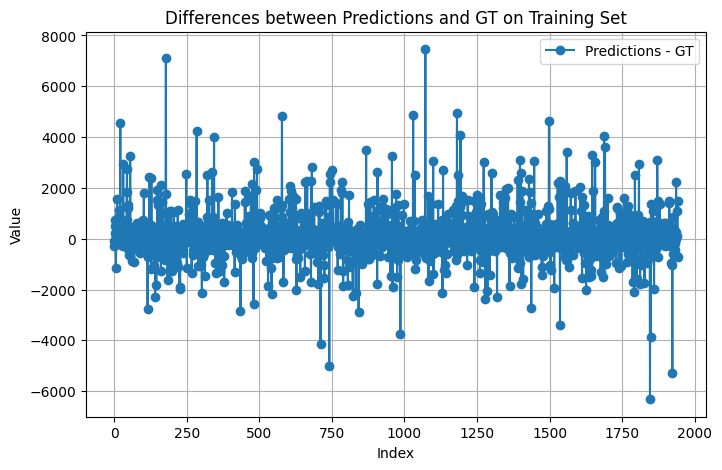

Predicted value for the first sample: 2.7019
Validation Loss Scaling Unreversed: 0.16355000436306
Validation Loss Scaling Reversed: 1182.5604248046875


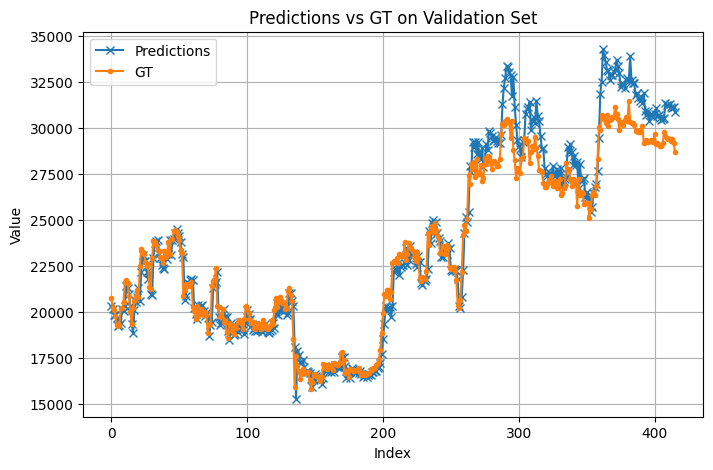

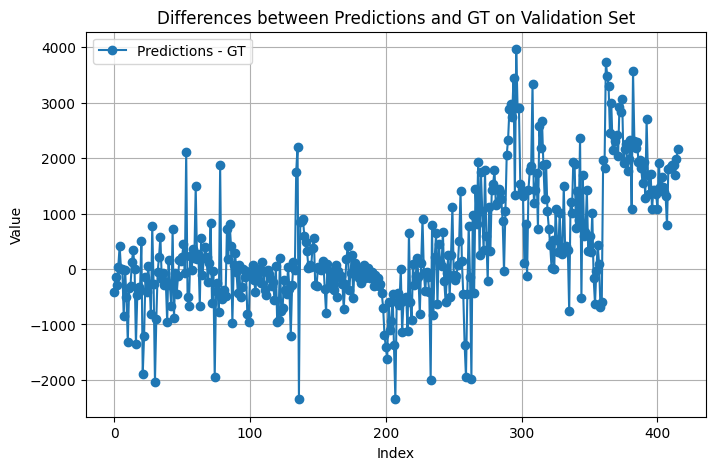

Return: 0.7095043659210205
Max Drawdown: -0.23187407851219177
Epoch [5/200], Loss: 0.4455
Epoch [10/200], Loss: 0.1028
Epoch [15/200], Loss: 0.1720
Epoch [20/200], Loss: 0.2270
Epoch [25/200], Loss: 0.1706
Epoch [30/200], Loss: 0.0420
Epoch [35/200], Loss: 0.0350
Epoch [40/200], Loss: 0.0482
Epoch [45/200], Loss: 0.0176
Epoch [50/200], Loss: 0.0963
Epoch [55/200], Loss: 0.1224
Epoch [60/200], Loss: 0.1150
Epoch [65/200], Loss: 0.1160
Epoch [70/200], Loss: 0.1459
Epoch [75/200], Loss: 0.0519
Epoch [80/200], Loss: 0.0895
Epoch [85/200], Loss: 0.0468
Epoch [90/200], Loss: 0.1757
Epoch [95/200], Loss: 0.0801
Epoch [100/200], Loss: 0.0359
Epoch [105/200], Loss: 0.3857
Epoch [110/200], Loss: 0.0594
Epoch [115/200], Loss: 0.0756
Epoch [120/200], Loss: 0.0403
Epoch [125/200], Loss: 0.3743
Epoch [130/200], Loss: 0.0799
Epoch [135/200], Loss: 0.2394
Epoch [140/200], Loss: 0.0789
Epoch [145/200], Loss: 0.0757
Epoch [150/200], Loss: 0.1378
Epoch [155/200], Loss: 0.0284
Epoch [160/200], Loss: 0.024

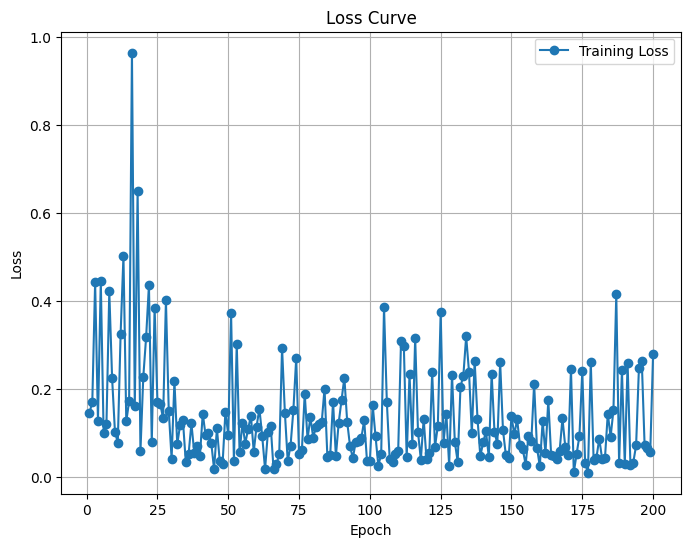

Predicted value for the first sample: 1.8532
Training Loss Scaling Unreversed: 0.1406293511390686
Training Loss Scaling Reversed: 1016.8309326171875


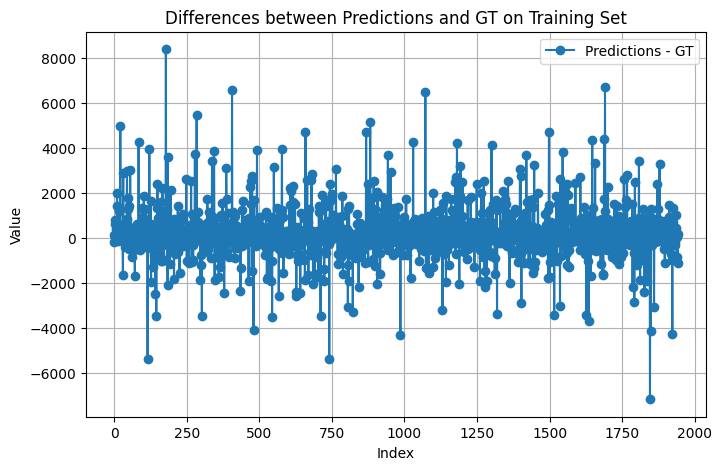

Predicted value for the first sample: 2.8799
Validation Loss Scaling Unreversed: 0.12697182595729828
Validation Loss Scaling Reversed: 918.0792846679688


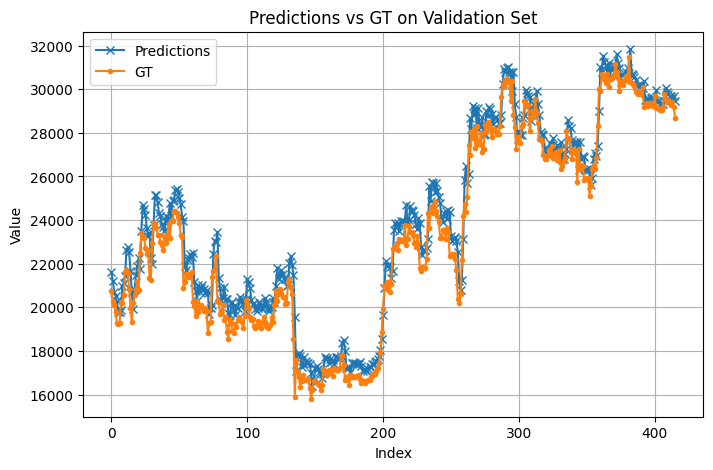

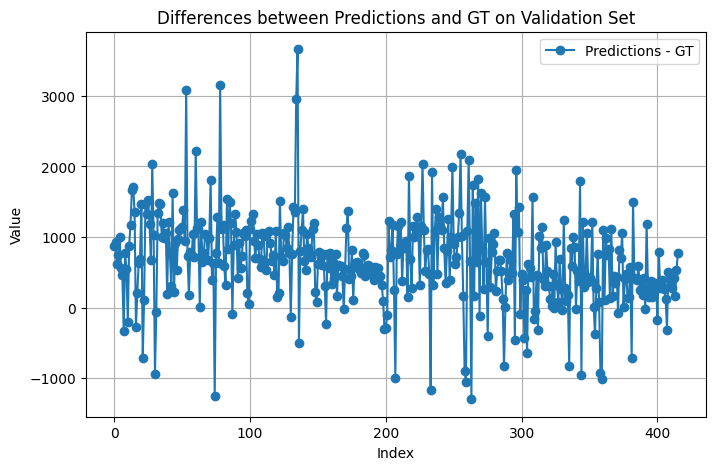

Return: 0.39483213424682617
Max Drawdown: -0.18096832931041718
Epoch [5/200], Loss: 3.2491
Epoch [10/200], Loss: 2.6439
Epoch [15/200], Loss: 0.3670
Epoch [20/200], Loss: 0.0594
Epoch [25/200], Loss: 0.0897
Epoch [30/200], Loss: 0.1644
Epoch [35/200], Loss: 0.4489
Epoch [40/200], Loss: 1.5801
Epoch [45/200], Loss: 1.3487
Epoch [50/200], Loss: 0.1376
Epoch [55/200], Loss: 0.3087
Epoch [60/200], Loss: 0.6071
Epoch [65/200], Loss: 1.3785
Epoch [70/200], Loss: 0.3605
Epoch [75/200], Loss: 0.4703
Epoch [80/200], Loss: 0.2852
Epoch [85/200], Loss: 0.1719
Epoch [90/200], Loss: 1.2893
Epoch [95/200], Loss: 0.0823
Epoch [100/200], Loss: 0.0615
Epoch [105/200], Loss: 0.1354
Epoch [110/200], Loss: 0.2470
Epoch [115/200], Loss: 0.0212
Epoch [120/200], Loss: 0.0938
Epoch [125/200], Loss: 0.2993
Epoch [130/200], Loss: 0.1242
Epoch [135/200], Loss: 0.1099
Epoch [140/200], Loss: 0.6845
Epoch [145/200], Loss: 0.0216
Epoch [150/200], Loss: 0.1812
Epoch [155/200], Loss: 0.1242
Epoch [160/200], Loss: 0.10

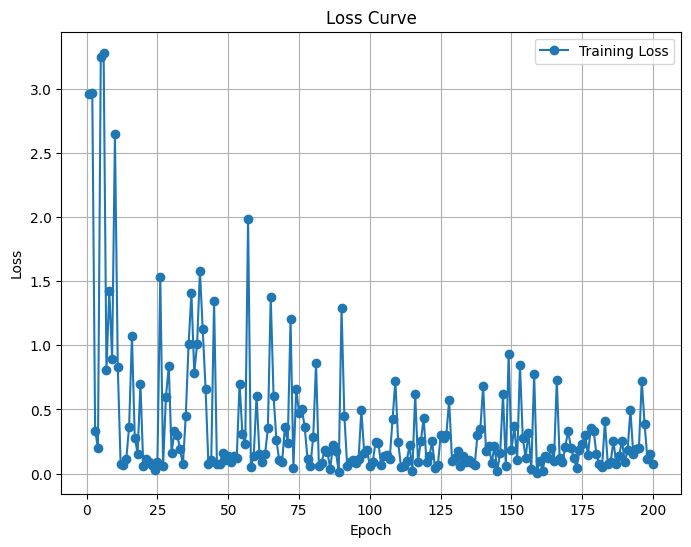

Predicted value for the first sample: 2.0019
Training Loss Scaling Unreversed: 0.24436792731285095
Training Loss Scaling Reversed: 1766.9205322265625


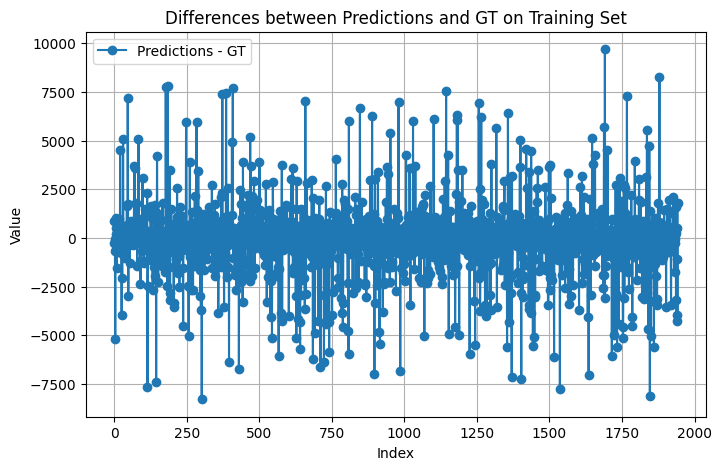

Predicted value for the first sample: 2.9107
Validation Loss Scaling Unreversed: 0.16555601358413696
Validation Loss Scaling Reversed: 1197.0650634765625


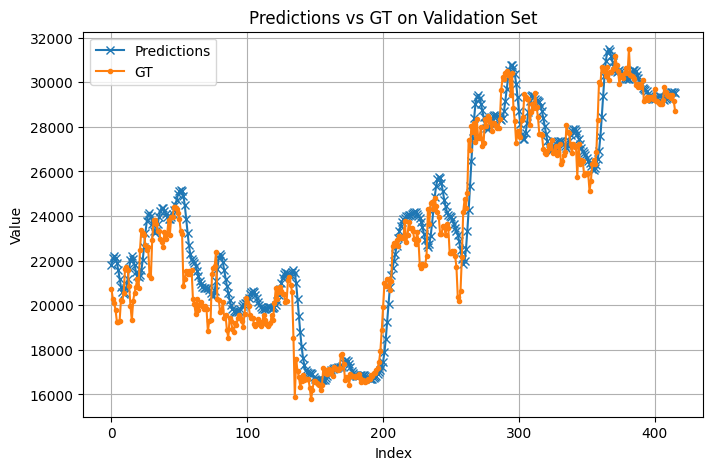

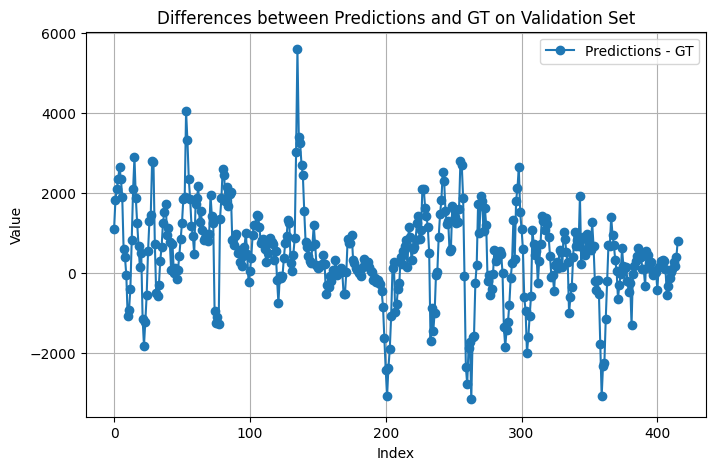

Return: -0.07307940721511841
Max Drawdown: -0.40308505296707153
Epoch [5/200], Loss: 0.2723
Epoch [10/200], Loss: 0.2227
Epoch [15/200], Loss: 0.1398
Epoch [20/200], Loss: 0.0738
Epoch [25/200], Loss: 0.7347
Epoch [30/200], Loss: 0.0680
Epoch [35/200], Loss: 0.1161
Epoch [40/200], Loss: 0.1588
Epoch [45/200], Loss: 0.1685
Epoch [50/200], Loss: 0.2849
Epoch [55/200], Loss: 0.0456
Epoch [60/200], Loss: 0.5203
Epoch [65/200], Loss: 0.4116
Epoch [70/200], Loss: 0.4368
Epoch [75/200], Loss: 0.0223
Epoch [80/200], Loss: 0.0514
Epoch [85/200], Loss: 0.2198
Epoch [90/200], Loss: 0.0239
Epoch [95/200], Loss: 0.1945
Epoch [100/200], Loss: 0.0951
Epoch [105/200], Loss: 0.1580
Epoch [110/200], Loss: 0.1700
Epoch [115/200], Loss: 0.1259
Epoch [120/200], Loss: 0.1743
Epoch [125/200], Loss: 0.0512
Epoch [130/200], Loss: 0.1059
Epoch [135/200], Loss: 0.0398
Epoch [140/200], Loss: 0.0525
Epoch [145/200], Loss: 0.1255
Epoch [150/200], Loss: 0.1355
Epoch [155/200], Loss: 0.5551
Epoch [160/200], Loss: 0.1

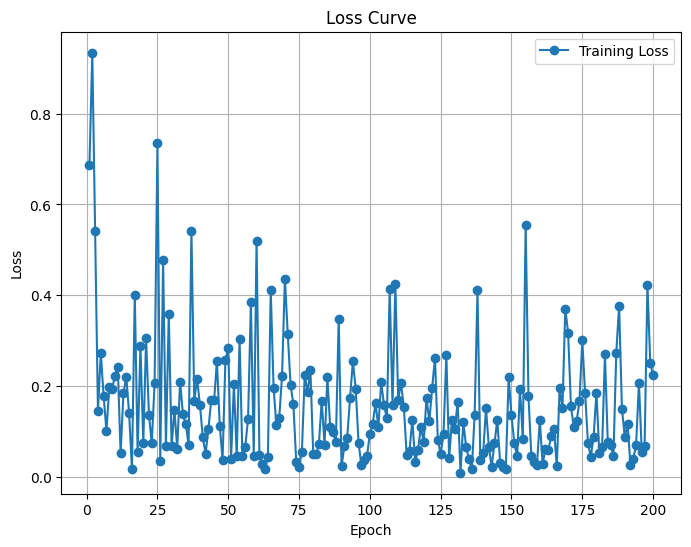

Predicted value for the first sample: 1.7332
Training Loss Scaling Unreversed: 0.14188987016677856
Training Loss Scaling Reversed: 1025.9451904296875


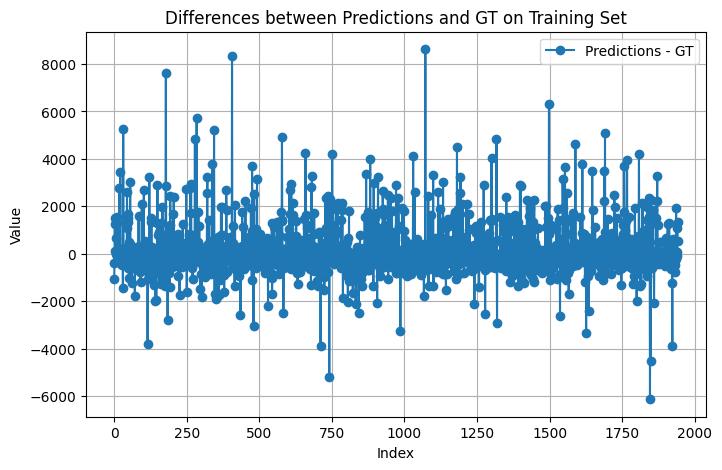

Predicted value for the first sample: 2.7987
Validation Loss Scaling Unreversed: 0.4690791666507721
Validation Loss Scaling Reversed: 3391.7119140625


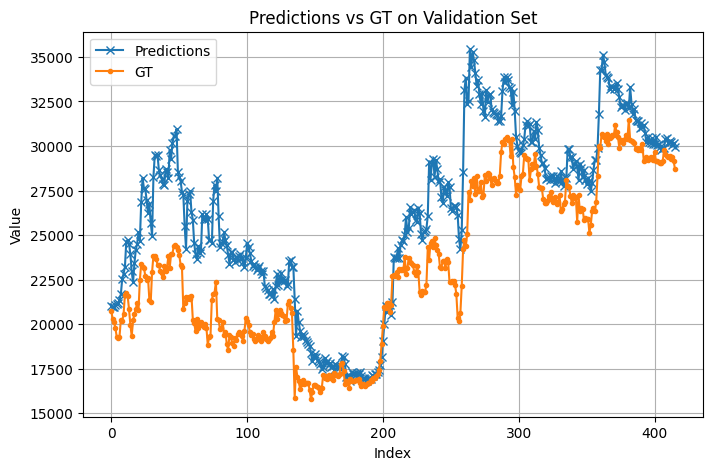

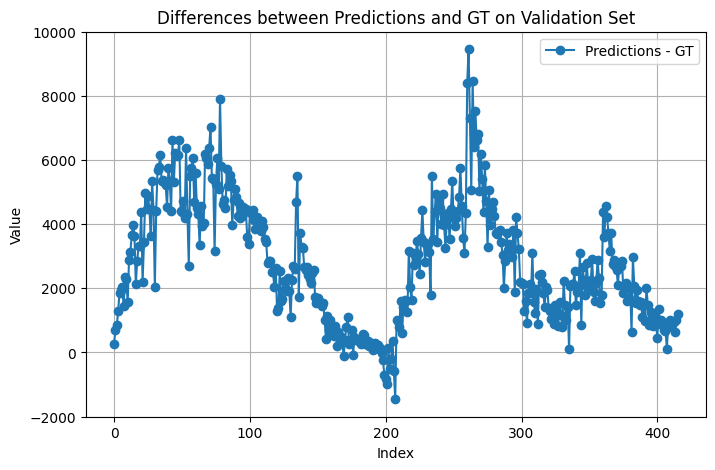

Return: 0.21405231952667236
Max Drawdown: -0.26131725311279297
Epoch [5/200], Loss: 0.0859
Epoch [10/200], Loss: 0.7529
Epoch [15/200], Loss: 0.1955
Epoch [20/200], Loss: 0.0864
Epoch [25/200], Loss: 0.6542
Epoch [30/200], Loss: 0.0360
Epoch [35/200], Loss: 0.3493
Epoch [40/200], Loss: 0.0384
Epoch [45/200], Loss: 0.0897
Epoch [50/200], Loss: 0.1982
Epoch [55/200], Loss: 0.0419
Epoch [60/200], Loss: 0.2213
Epoch [65/200], Loss: 0.1783
Epoch [70/200], Loss: 0.3194
Epoch [75/200], Loss: 0.2859
Epoch [80/200], Loss: 0.0593
Epoch [85/200], Loss: 0.0337
Epoch [90/200], Loss: 0.3594
Epoch [95/200], Loss: 0.1192
Epoch [100/200], Loss: 0.0795
Epoch [105/200], Loss: 0.0660
Epoch [110/200], Loss: 0.1010
Epoch [115/200], Loss: 0.0732
Epoch [120/200], Loss: 0.0582
Epoch [125/200], Loss: 0.2598
Epoch [130/200], Loss: 0.2055
Epoch [135/200], Loss: 0.0421
Epoch [140/200], Loss: 0.0293
Epoch [145/200], Loss: 0.0237
Epoch [150/200], Loss: 0.0546
Epoch [155/200], Loss: 0.0508
Epoch [160/200], Loss: 0.27

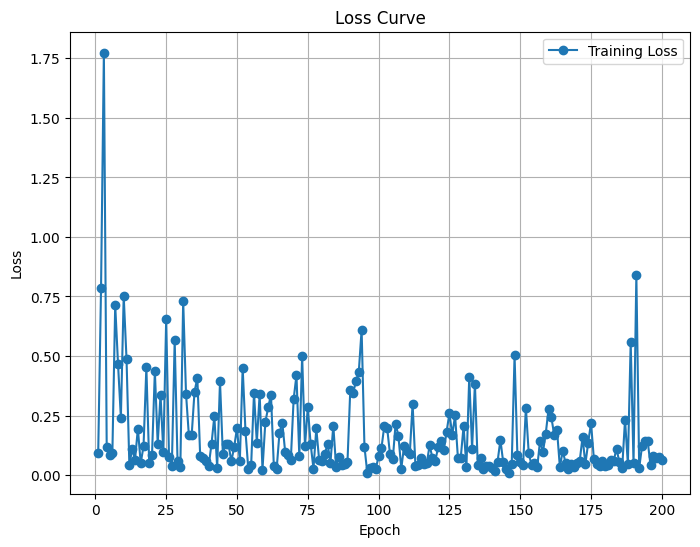

Predicted value for the first sample: 1.8294
Training Loss Scaling Unreversed: 0.1490342766046524
Training Loss Scaling Reversed: 1077.6033935546875


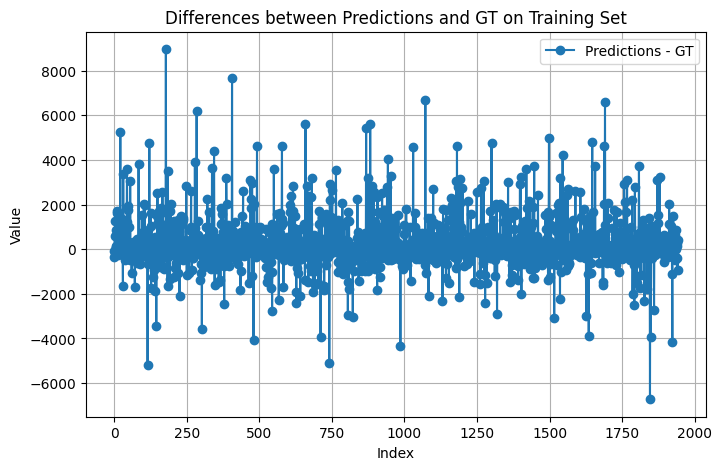

Predicted value for the first sample: 3.0470
Validation Loss Scaling Unreversed: 0.20744754374027252
Validation Loss Scaling Reversed: 1499.96484375


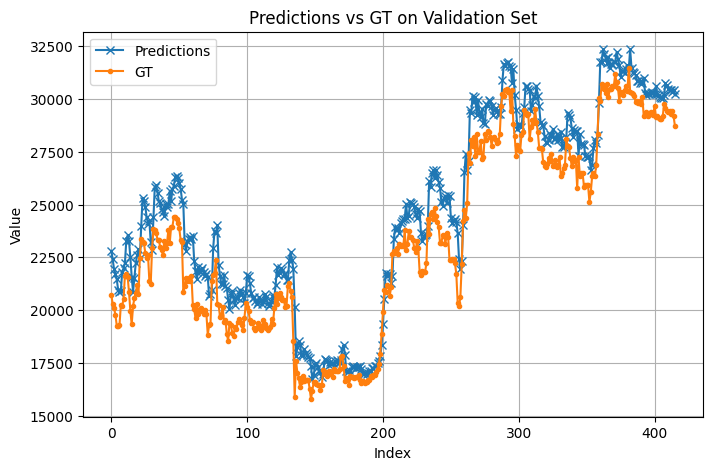

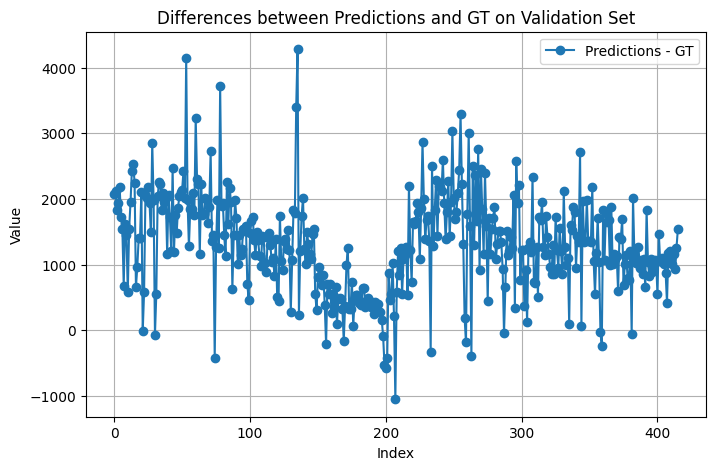

Return: 0.4366534948348999
Max Drawdown: -0.22624008357524872
Epoch [5/200], Loss: 1.5932
Epoch [10/200], Loss: 0.5369
Epoch [15/200], Loss: 0.5788
Epoch [20/200], Loss: 1.3485
Epoch [25/200], Loss: 0.4410
Epoch [30/200], Loss: 1.5706
Epoch [35/200], Loss: 0.0835
Epoch [40/200], Loss: 0.0875
Epoch [45/200], Loss: 0.7532
Epoch [50/200], Loss: 0.5535
Epoch [55/200], Loss: 0.2019
Epoch [60/200], Loss: 0.7672
Epoch [65/200], Loss: 0.0833
Epoch [70/200], Loss: 0.5064
Epoch [75/200], Loss: 0.7369
Epoch [80/200], Loss: 0.0960
Epoch [85/200], Loss: 0.2293
Epoch [90/200], Loss: 0.2001
Epoch [95/200], Loss: 0.8034
Epoch [100/200], Loss: 0.4133
Epoch [105/200], Loss: 0.3048
Epoch [110/200], Loss: 0.1468
Epoch [115/200], Loss: 0.0862
Epoch [120/200], Loss: 0.3666
Epoch [125/200], Loss: 0.0471
Epoch [130/200], Loss: 0.3082
Epoch [135/200], Loss: 0.0940
Epoch [140/200], Loss: 0.2623
Epoch [145/200], Loss: 0.1023
Epoch [150/200], Loss: 0.1886
Epoch [155/200], Loss: 0.0606
Epoch [160/200], Loss: 0.329

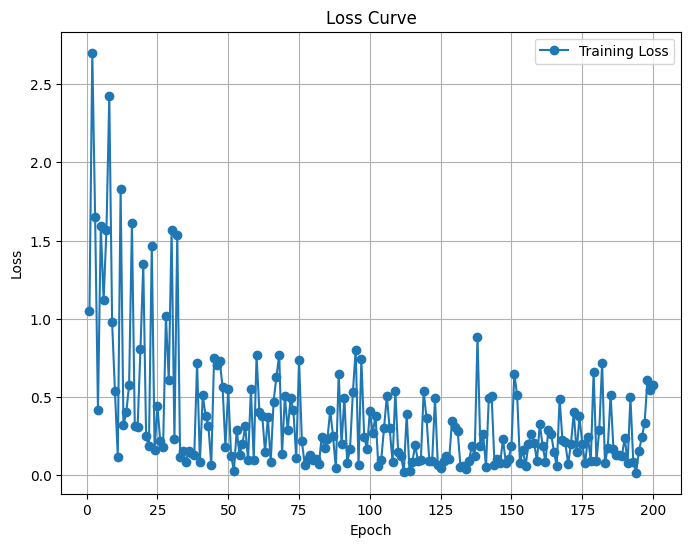

Predicted value for the first sample: 2.0455
Training Loss Scaling Unreversed: 0.2581848204135895
Training Loss Scaling Reversed: 1866.8245849609375


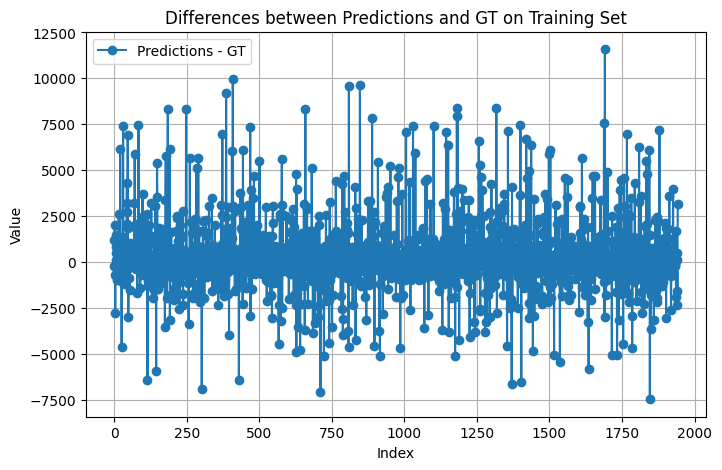

Predicted value for the first sample: 2.9349
Validation Loss Scaling Unreversed: 0.2580007016658783
Validation Loss Scaling Reversed: 1865.4932861328125


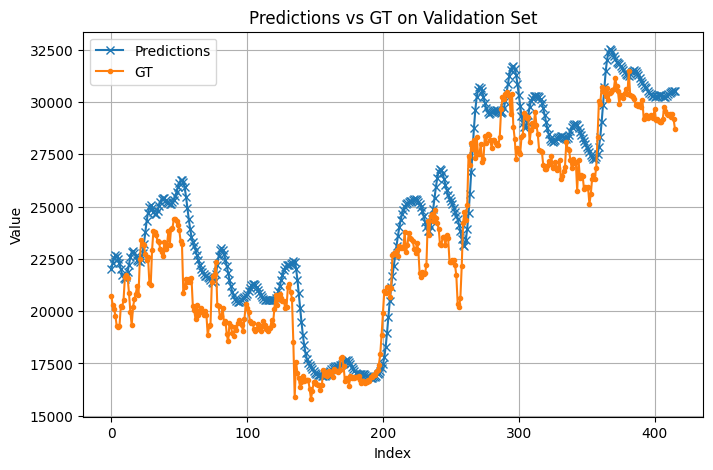

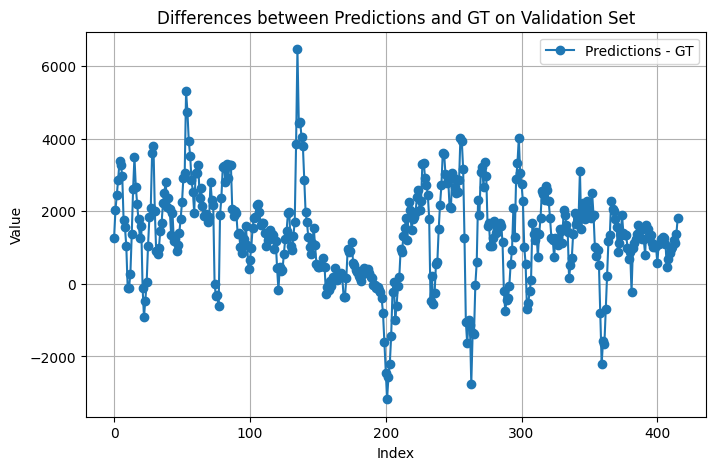

Return: -0.056115806102752686
Max Drawdown: -0.3275419771671295
Epoch [5/200], Loss: 0.1060


KeyboardInterrupt: 

In [ ]:
df = pd.read_excel("/content/drive/MyDrive/24fall_dlProject/Fine-Tuning_Logs.xlsx", sheet_name=None)

for index, row in df["lstm_close"].iterrows():
  if not pd.isna(row["Val_loss_unreversed"]):
    continue

  batch_size = int(row["Batch_size"])
  hidden_size = int(row["Hidden_size"])
  num_layers = int(row["Num_layers"])
  dropout = float(row["Dropout"])
  learning_rate = float(row["Learning_rate"])

  v_loss, v_lossr, t_loss, t_lossr, ret, max_drawdown = train_model(batch_size, hidden_size, num_layers, dropout, learning_rate)
  df["lstm_close"].at[index, "Val_loss_unreversed"] = v_loss.item()
  df["lstm_close"].at[index, "Val_loss_reversed"] = v_lossr.item()
  df["lstm_close"].at[index, "Train_loss_unreversed"] = t_loss.item()
  df["lstm_close"].at[index, "Train_loss_reversed"] = t_lossr.item()
  df["lstm_close"].at[index, "Return"] = ret
  df["lstm_close"].at[index, "Max_drawdown"] = max_drawdown
  df["lstm_close"].to_excel("/content/drive/MyDrive/24fall_dlProject/Fine-Tuning_LSTM_Close_Price.xlsx", sheet_name="lstm_close", index=False)